# Signal Processing Using EEG + EMG dataset

One of the most widely used method to analyze EEG data is to decompose the signal into functionally distinct frequency bands, such as delta (0.5–4 Hz), theta (4–8 Hz), alpha (8–12 Hz), beta (12–30 Hz), and gamma (30–100 Hz).

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install statsmodels --upgrade

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 9.8 MB 14.5 MB/s 
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.12.2
    Uninstalling statsmodels-0.12.2:
      Successfully uninstalled statsmodels-0.12.2


In [ ]:
!pip install mne

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 7.5 MB 14.2 MB/s 


In [ ]:
!pip install Boruta

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 56 kB 2.7 MB/s 


# **Data Preparation**

Use the dataset of the results of lifting 330g object from WS_P1_S1 </br>
There are 12 trials in total for lifting 330g object and we combine the results of the 12 trails into a single array </br>
All results of trials that are using in this analysis have the same parameters (i.e., 330g and sandpaper), but are in different channels </br>
</br>
All the EEG results of the trials are scaled (i.e., (trial_start_time - trial_end_time) / no. of recording) </br>
For the 1st trial: (11.4280 - 2.0020) / 4714 = 0.002 </br>
For the 2nd trial: (17.9820 - 9.1140) / 4435 = 0.002 </br>
For the 3rd trial: (57.7380 - 49.2180) / 4261 = 0.002 </br>
For the 4th trial: (65.0160 - 56.5840) / 4217 = 0.002 </br>
For the 5th trial: (71.3320 - 62.5260) / 4403 = 0.002 </br>
For the 6th trial: (78.6880 - 70.2040) / 4243 = 0.002 </br>
For the 7th trial: (121.3460 - 112.8660) / 4241 = 0.002 </br>
For the 8th trial: (177.7660 - 169.0280) / 4370 = 0.002 </br>
For the 9th trial: (219.9620 - 211.6280) / 4168 = 0.002 </br>
For the 10th trial: (226.7880 - 218.4840) / 4153 = 0.002 </br>
For the 11th trial: (232.8780 - 224.4820) / 4199 = 0.002 </br>
For the 12th trial: (240.6640 - 232.1300) / 4268 = 0.002 </br>
Thus, it is aligned with the results that the EEG data has a sampling frequency of 500 Hz

</br>
All the EMG results of the trials are scaled (i.e., (trial_start_time - trial_end_time) / no. of recording) </br>
For the 1st trial: (11.4280 - 2.0020) / 37712 = 0.00025 </br>
For the 2nd trial: (17.9820 - 9.1140) / 35480 = 0.00025 </br>
For the 3rd trial: (57.7380 - 49.2180) / 34088 = 0.00025 </br>
For the 4th trial: (65.0160 - 56.5840) / 33736 = 0.00025 </br>
For the 5th trial: (71.3320 - 62.5260) / 35224 = 0.00025 </br>
For the 6th trial: (78.6880 - 70.2040) / 33944 = 0.00025 </br>
For the 7th trial: (121.3460 - 112.8660) / 33928 = 0.00025 </br>
For the 8th trial: (177.7660 - 169.0280) / 34960 = 0.00025 </br>
For the 9th trial: (219.9620 - 211.6280) / 33344 = 0.00025 </br>
For the 10th trial: (226.7880 - 218.4840) / 33224 = 0.00025 </br>
For the 11th trial: (232.8780 - 224.4820) / 33592 = 0.00025 </br>
For the 12th trial: (240.6640 - 232.1300) / 34144 = 0.00025 </br>
Thus, it is aligned with the results that the EMG data has a sampling frequency of 4000 Hz

In [ ]:
import numpy as np
# EEG
C3_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/1#330gP1S1C3.txt')
C3_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/2#330gP1S1C3.txt')
C3_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/3#330gP1S1C3.txt')
C3_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/4#330gP1S1C3.txt')
C3_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/5#330gP1S1C3.txt')
C3_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/6#330gP1S1C3.txt')
C3_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/7#330gP1S1C3.txt')
C3_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/8#330gP1S1C3.txt')
C3_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/9#330gP1S1C3.txt')
C3_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/10#330gP1S1C3.txt')
C3_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/11#330gP1S1C3.txt')
C3_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C3/12#330gP1S1C3.txt')
dataC3 = np.concatenate((C3_1, C3_2, C3_3, C3_4, C3_5, C3_6, C3_7, C3_8, C3_9, C3_10, C3_11, C3_12))

C4_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/1#330gP1S1C4.txt')
C4_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/2#330gP1S1C4.txt')
C4_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/3#330gP1S1C4.txt')
C4_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/4#330gP1S1C4.txt')
C4_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/5#330gP1S1C4.txt')
C4_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/6#330gP1S1C4.txt')
C4_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/7#330gP1S1C4.txt')
C4_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/8#330gP1S1C4.txt')
C4_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/9#330gP1S1C4.txt')
C4_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/10#330gP1S1C4.txt')
C4_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/11#330gP1S1C4.txt')
C4_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1C4/12#330gP1S1C4.txt')
dataC4 = np.concatenate((C4_1, C4_2, C4_3, C4_4, C4_5, C4_6, C4_7, C4_8, C4_9, C4_10, C4_11, C4_12))

Cz_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/1#330gP1S1Cz.txt')
Cz_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/2#330gP1S1Cz.txt')
Cz_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/3#330gP1S1Cz.txt')
Cz_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/4#330gP1S1Cz.txt')
Cz_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/5#330gP1S1Cz.txt')
Cz_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/6#330gP1S1Cz.txt')
Cz_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/7#330gP1S1Cz.txt')
Cz_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/8#330gP1S1Cz.txt')
Cz_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/9#330gP1S1Cz.txt')
Cz_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/10#330gP1S1Cz.txt')
Cz_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/11#330gP1S1Cz.txt')
Cz_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Cz/12#330gP1S1Cz.txt')
dataCz = np.concatenate((Cz_1, Cz_2, Cz_3, Cz_4, Cz_5, Cz_6, Cz_7, Cz_8, Cz_9, Cz_10, Cz_11, Cz_12))

CP1_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/1#330gP1S1CP1.txt')
CP1_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/2#330gP1S1CP1.txt')
CP1_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/3#330gP1S1CP1.txt')
CP1_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/4#330gP1S1CP1.txt')
CP1_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/5#330gP1S1CP1.txt')
CP1_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/6#330gP1S1CP1.txt')
CP1_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/7#330gP1S1CP1.txt')
CP1_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/8#330gP1S1CP1.txt')
CP1_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/9#330gP1S1CP1.txt')
CP1_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/10#330gP1S1CP1.txt')
CP1_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/11#330gP1S1CP1.txt')
CP1_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP1/12#330gP1S1CP1.txt')
dataCP1 = np.concatenate((CP1_1, CP1_2, CP1_3, CP1_4, CP1_5, CP1_6, CP1_7, CP1_8, CP1_9, CP1_10, CP1_11, CP1_12))

CP2_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/1#330gP1S1CP2.txt')
CP2_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/2#330gP1S1CP2.txt')
CP2_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/3#330gP1S1CP2.txt')
CP2_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/4#330gP1S1CP2.txt')
CP2_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/5#330gP1S1CP2.txt')
CP2_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/6#330gP1S1CP2.txt')
CP2_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/7#330gP1S1CP2.txt')
CP2_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/8#330gP1S1CP2.txt')
CP2_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/9#330gP1S1CP2.txt')
CP2_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/10#330gP1S1CP2.txt')
CP2_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/11#330gP1S1CP2.txt')
CP2_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP2/12#330gP1S1CP2.txt')
dataCP2 = np.concatenate((CP2_1, CP2_2, CP2_3, CP2_4, CP2_5, CP2_6, CP2_7, CP2_8, CP2_9, CP2_10, CP2_11, CP2_12))

CP5_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/1#330gP1S1CP5.txt')
CP5_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/2#330gP1S1CP5.txt')
CP5_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/3#330gP1S1CP5.txt')
CP5_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/4#330gP1S1CP5.txt')
CP5_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/5#330gP1S1CP5.txt')
CP5_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/6#330gP1S1CP5.txt')
CP5_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/7#330gP1S1CP5.txt')
CP5_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/8#330gP1S1CP5.txt')
CP5_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/9#330gP1S1CP5.txt')
CP5_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/10#330gP1S1CP5.txt')
CP5_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/11#330gP1S1CP5.txt')
CP5_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP5/12#330gP1S1CP5.txt')
dataCP5 = np.concatenate((CP5_1, CP5_2, CP5_3, CP5_4, CP5_5, CP5_6, CP5_7, CP5_8, CP5_9, CP5_10, CP5_11, CP5_12))

CP6_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/1#330gP1S1CP6.txt')
CP6_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/2#330gP1S1CP6.txt')
CP6_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/3#330gP1S1CP6.txt')
CP6_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/4#330gP1S1CP6.txt')
CP6_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/5#330gP1S1CP6.txt')
CP6_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/6#330gP1S1CP6.txt')
CP6_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/7#330gP1S1CP6.txt')
CP6_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/8#330gP1S1CP6.txt')
CP6_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/9#330gP1S1CP6.txt')
CP6_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/10#330gP1S1CP6.txt')
CP6_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/11#330gP1S1CP6.txt')
CP6_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CP6/12#330gP1S1CP6.txt')
dataCP6 = np.concatenate((CP6_1, CP6_2, CP6_3, CP6_4, CP6_5, CP6_6, CP6_7, CP6_8, CP6_9, CP6_10, CP6_11, CP6_12))

# EMG
AD_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/1#330gP1S1AD.txt')
AD_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/2#330gP1S1AD.txt')
AD_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/3#330gP1S1AD.txt')
AD_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/4#330gP1S1AD.txt')
AD_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/5#330gP1S1AD.txt')
AD_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/6#330gP1S1AD.txt')
AD_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/7#330gP1S1AD.txt')
AD_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/8#330gP1S1AD.txt')
AD_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/9#330gP1S1AD.txt')
AD_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/10#330gP1S1AD.txt')
AD_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/11#330gP1S1AD.txt')
AD_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1AnteriorDeltoid/12#330gP1S1AD.txt')
dataAnteriorDeltoid = np.concatenate((AD_1, AD_2, AD_3, AD_4, AD_5, AD_6, AD_7, AD_8, AD_9, AD_10, AD_11, AD_12))

B_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/1#330gP1S1B.txt')
B_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/2#330gP1S1B.txt')
B_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/3#330gP1S1B.txt')
B_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/4#330gP1S1B.txt')
B_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/5#330gP1S1B.txt')
B_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/6#330gP1S1B.txt')
B_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/7#330gP1S1B.txt')
B_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/8#330gP1S1B.txt')
B_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/9#330gP1S1B.txt')
B_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/10#330gP1S1B.txt')
B_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/11#330gP1S1B.txt')
B_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1Brachoradial/12#330gP1S1B.txt')
dataBrachoradial = np.concatenate((B_1, B_2, B_3, B_4, B_5, B_6, B_7, B_8, B_9, B_10, B_11, B_12))

FD_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/1#330gP1S1FD.txt')
FD_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/2#330gP1S1FD.txt')
FD_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/3#330gP1S1FD.txt')
FD_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/4#330gP1S1FD.txt')
FD_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/5#330gP1S1FD.txt')
FD_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/6#330gP1S1FD.txt')
FD_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/7#330gP1S1FD.txt')
FD_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/8#330gP1S1FD.txt')
FD_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/9#330gP1S1FD.txt')
FD_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/10#330gP1S1FD.txt')
FD_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/11#330gP1S1FD.txt')
FD_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FlexorDigitorum/12#330gP1S1FD.txt')
dataFlexorDigitorum = np.concatenate((FD_1, FD_2, FD_3, FD_4, FD_5, FD_6, FD_7, FD_8, FD_9, FD_10, FD_11, FD_12))

CED_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
CED_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1CommomExtensorDigitorum/1#330gP1S1CED.txt')
dataCommonExtensorDigitorum = np.concatenate((CED_1, CED_2, CED_3, CED_4, CED_5, CED_6, CED_7, CED_8, CED_9, CED_10, CED_11, CED_12))

FDI_1 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/1#330gP1S1FDI.txt')
FDI_2 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/2#330gP1S1FDI.txt')
FDI_3 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/3#330gP1S1FDI.txt')
FDI_4 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/4#330gP1S1FDI.txt')
FDI_5 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/5#330gP1S1FDI.txt')
FDI_6 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/6#330gP1S1FDI.txt')
FDI_7 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/7#330gP1S1FDI.txt')
FDI_8 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/8#330gP1S1FDI.txt')
FDI_9 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/9#330gP1S1FDI.txt')
FDI_10 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/10#330gP1S1FDI.txt')
FDI_11 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/11#330gP1S1FDI.txt')
FDI_12 = np.loadtxt('/content/drive/MyDrive/UROP/signal processing python/330gP1S1FirstDorsalInterosseus/12#330gP1S1FDI.txt')
dataFirstDorsalInterosseus = np.concatenate((FDI_1, FDI_2, FDI_3, FDI_4, FDI_5, FDI_6, FDI_7, FDI_8, FDI_9, FDI_10, FDI_11, FDI_12))

# ***Guassian noise***

In [ ]:
import numpy as np

scaling_factor_eeg = 50
scaling_factor_emg = 0.01
C3_12_noisy = C3_12 + np.random.normal(0,1,len(C3_12)) * scaling_factor_eeg
C4_12_noisy = C4_12 + np.random.normal(0,1,len(C4_12)) * scaling_factor_eeg
Cz_12_noisy = Cz_12 + np.random.normal(0,1,len(Cz_12)) * scaling_factor_eeg
CP1_12_noisy = CP1_12 + np.random.normal(0,1,len(CP1_12)) * scaling_factor_eeg
CP2_12_noisy = CP2_12 + np.random.normal(0,1,len(CP2_12)) * scaling_factor_eeg
CP5_12_noisy = CP5_12 + np.random.normal(0,1,len(CP5_12)) * scaling_factor_eeg
CP6_12_noisy = CP6_12 + np.random.normal(0,1,len(CP6_12)) * scaling_factor_eeg
AD_12_noisy = AD_12 + np.random.normal(0,1,len(AD_12)) * scaling_factor_emg
B_12_noisy = B_12 + np.random.normal(0,1,len(B_12)) * scaling_factor_emg
FD_12_noisy = FD_12 + np.random.normal(0,1,len(FD_12)) * scaling_factor_emg
CED_12_noisy = CED_12 + np.random.normal(0,1,len(CED_12)) * scaling_factor_emg
FDI_12_noisy = FDI_12 + np.random.normal(0,1,len(FDI_12)) * scaling_factor_emg

In [ ]:
C3 = [C3_1, C3_2, C3_3, C3_4, C3_5, C3_6, C3_7, C3_8, C3_9, C3_10, C3_11, C3_12, C3_12_noisy]
C4 = [C4_1, C4_2, C4_3, C4_4, C4_5, C4_6, C4_7, C4_8, C4_9, C4_10, C4_11, C4_12, C4_12_noisy]
Cz = [Cz_1, Cz_2, Cz_3, Cz_4, Cz_5, Cz_6, Cz_7, Cz_8, Cz_9, Cz_10, Cz_11, Cz_12, Cz_12_noisy]
CP1 = [CP1_1, CP1_2, CP1_3, CP1_4, CP1_5, CP1_6, CP1_7, CP1_8, CP1_9, CP1_10, CP1_11, CP1_12, CP1_12_noisy]
CP2 = [CP2_1, CP2_2, CP2_3, CP2_4, CP2_5, CP2_6, CP2_7, CP2_8, CP2_9, CP2_10, CP2_11, CP2_12, CP2_12_noisy]
CP5 = [CP5_1, CP5_2, CP5_3, CP5_4, CP5_5, CP5_6, CP5_7, CP5_8, CP5_9, CP5_10, CP5_11, CP5_12, CP5_12_noisy]
CP6 = [CP6_1, CP6_2, CP6_3, CP6_4, CP6_5, CP6_6, CP6_7, CP6_8, CP6_9, CP6_10, CP6_11, CP6_12, CP6_12_noisy]
AD = [AD_1, AD_2, AD_3, AD_4, AD_5, AD_6, AD_7, AD_8, AD_9, AD_10, AD_11, AD_12, AD_12_noisy]
B = [B_1, B_2, B_3, B_4, B_5, B_6, B_7, B_8, B_9, B_10, B_11, B_12, B_12_noisy]
FD = [FD_1, FD_2, FD_3, FD_4, FD_5, FD_6, FD_7, FD_8, FD_9, FD_10, FD_11, FD_12, FD_12_noisy]
CED = [CED_1, CED_2, CED_3, CED_4, CED_5, CED_6, CED_7, CED_8, CED_9, CED_10, CED_11, CED_12, CED_12_noisy]
FDI = [FDI_1, FDI_2, FDI_3, FDI_4, FDI_5, FDI_6, FDI_7, FDI_8, FDI_9, FDI_10, FDI_11, FDI_12, FDI_12_noisy]

dataa = CP6
total = 0
for x in range(13):
  fluctuation = 0
  test = dataa[x]
  for i in range(len(test)-1):
    temp = test[i+1] - test[i]
    fluctuation += abs(temp)

  fluctuation = fluctuation/len(test)
  print(fluctuation)
  if x != 12:
    total += fluctuation
  else:
    total = total / 12
    print(' ')
    print(total)
    print(fluctuation/total)

    


34.52672889266016
33.38669673055242
24.370570288664634
25.233815508655443
27.119464001816944
24.901484798491634
25.077340249941052
52.67322654462242
60.77975047984645
82.75752468095352
36.425339366515836
35.4383786316776
69.44498978426483
 
38.55752668119984
1.8010748033308197


# **Data visualisation for EEG in time domain**

Using the dataset of the results of lifting 330g objects from participant 1 series 1 (WS_P1_S1) </br>
Plot data from C3, Cz, C4, CP1, CP2, CP6, CP5 channels respectively


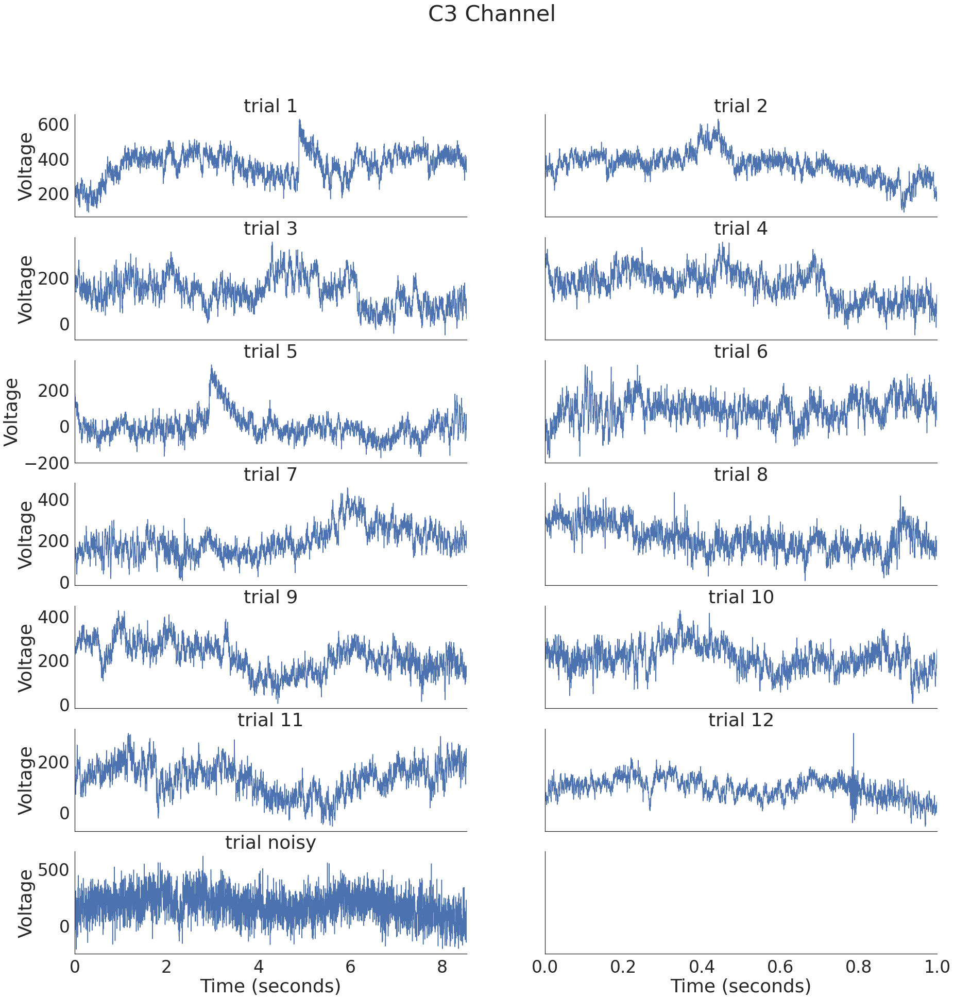

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(font_scale = 3, style = 'white')

sf = 500.
C3 = [C3_1, C3_2, C3_3, C3_4, C3_5, C3_6, C3_7, C3_8, C3_9, C3_10, C3_11, C3_12, C3_12_noisy]
C4 = [C4_1, C4_2, C4_3, C4_4, C4_5, C4_6, C4_7, C4_8, C4_9, C4_10, C4_11, C4_12, C4_12_noisy]
Cz = [Cz_1, Cz_2, Cz_3, Cz_4, Cz_5, Cz_6, Cz_7, Cz_8, Cz_9, Cz_10, Cz_11, Cz_12, Cz_12_noisy]
CP1 = [CP1_1, CP1_2, CP1_3, CP1_4, CP1_5, CP1_6, CP1_7, CP1_8, CP1_9, CP1_10, CP1_11, CP1_12, CP1_12_noisy]
CP2 = [CP2_1, CP2_2, CP2_3, CP2_4, CP2_5, CP2_6, CP2_7, CP2_8, CP2_9, CP2_10, CP2_11, CP2_12, CP2_12_noisy]
CP5 = [CP5_1, CP5_2, CP5_3, CP5_4, CP5_5, CP5_6, CP5_7, CP5_8, CP5_9, CP5_10, CP5_11, CP5_12, CP5_12_noisy]
CP6 = [CP6_1, CP6_2, CP6_3, CP6_4, CP6_5, CP6_6, CP6_7, CP6_8, CP6_9, CP6_10, CP6_11, CP6_12, CP6_12_noisy]

time_C3 = []

for x in C3:
  time_C3.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(7, 2, figsize = (30, 30))
fig.suptitle('C3 Channel')
axs[0, 0].plot(time_C3[0], C3[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_C3[0].min(), time_C3[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_C3[1], C3[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_C3[1].min(), time_C3[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_C3[2], C3[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_C3[2].min(), time_C3[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_C3[3], C3[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_C3[3].min(), time_C3[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_C3[4], C3[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_C3[4].min(), time_C3[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_C3[5], C3[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_C3[5].min(), time_C3[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_C3[6], C3[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_C3[6].min(), time_C3[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_C3[7], C3[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_C3[7].min(), time_C3[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_C3[8], C3[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_C3[8].min(), time_C3[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_C3[9], C3[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_C3[9].min(), time_C3[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_C3[10], C3[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_C3[10].min(), time_C3[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_C3[11], C3[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_C3[11].min(), time_C3[11].max()])
axs[5, 1].set_title('trial 12')
axs[6, 0].plot(time_C3[12], C3[12], lw = 1.5, color = 'b')
axs[6, 0].set_xlim([time_C3[12].min(), time_C3[12].max()])
axs[6, 0].set_title('trial noisy')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/C3 time domain.png')

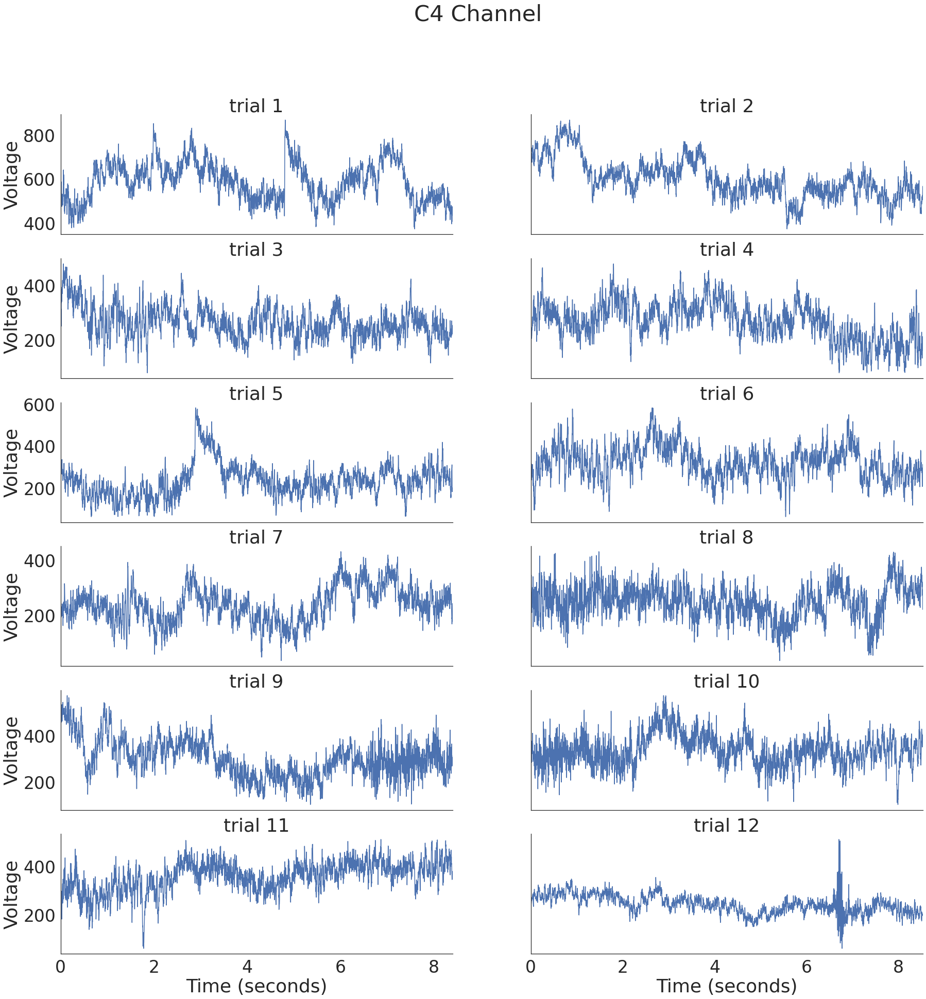

In [ ]:
time_C4 = []

for x in C4:
  time_C4.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('C4 Channel')
axs[0, 0].plot(time_C4[0], C4[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_C4[0].min(), time_C4[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_C4[1], C4[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_C4[1].min(), time_C4[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_C4[2], C4[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_C4[2].min(), time_C4[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_C4[3], C4[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_C4[3].min(), time_C4[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_C4[4], C4[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_C4[4].min(), time_C4[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_C4[5], C4[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_C4[5].min(), time_C4[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_C4[6], C4[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_C4[6].min(), time_C4[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_C4[7], C4[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_C4[7].min(), time_C4[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_C4[8], C4[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_C4[8].min(), time_C4[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_C4[9], C4[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_C4[9].min(), time_C4[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_C4[10], C4[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_C4[10].min(), time_C4[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_C4[11], C4[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_C4[11].min(), time_C4[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/C4 time domain.png')

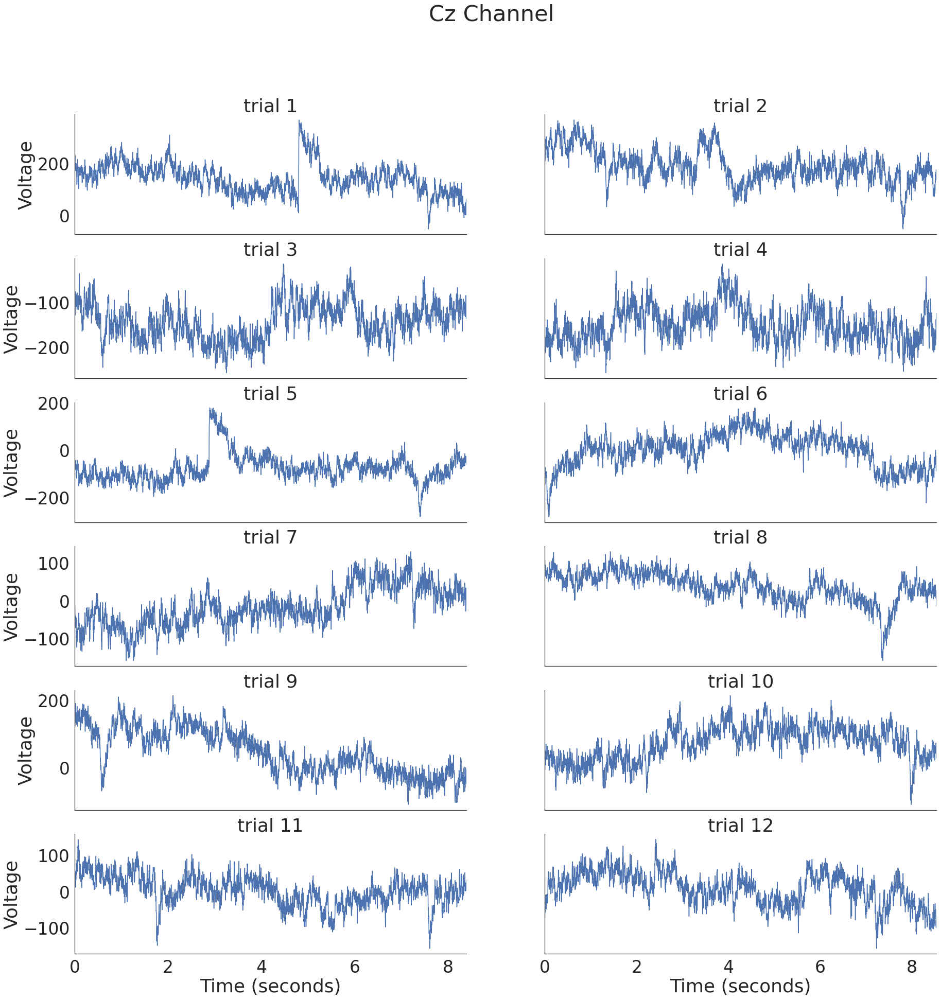

In [ ]:
time_Cz = []

for x in Cz:
  time_Cz.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Cz Channel')
axs[0, 0].plot(time_Cz[0], Cz[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_Cz[0].min(), time_Cz[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_Cz[1], Cz[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_Cz[1].min(), time_Cz[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_Cz[2], Cz[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_Cz[2].min(), time_Cz[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_Cz[3], Cz[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_Cz[3].min(), time_Cz[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_Cz[4], Cz[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_Cz[4].min(), time_Cz[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_Cz[5], Cz[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_Cz[5].min(), time_Cz[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_Cz[6], Cz[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_Cz[6].min(), time_Cz[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_Cz[7], Cz[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_Cz[7].min(), time_Cz[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_Cz[8], Cz[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_Cz[8].min(), time_Cz[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_Cz[9], Cz[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_Cz[9].min(), time_Cz[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_Cz[10], Cz[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_Cz[10].min(), time_Cz[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_Cz[11], Cz[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_Cz[11].min(), time_Cz[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/Cz time domain.png')

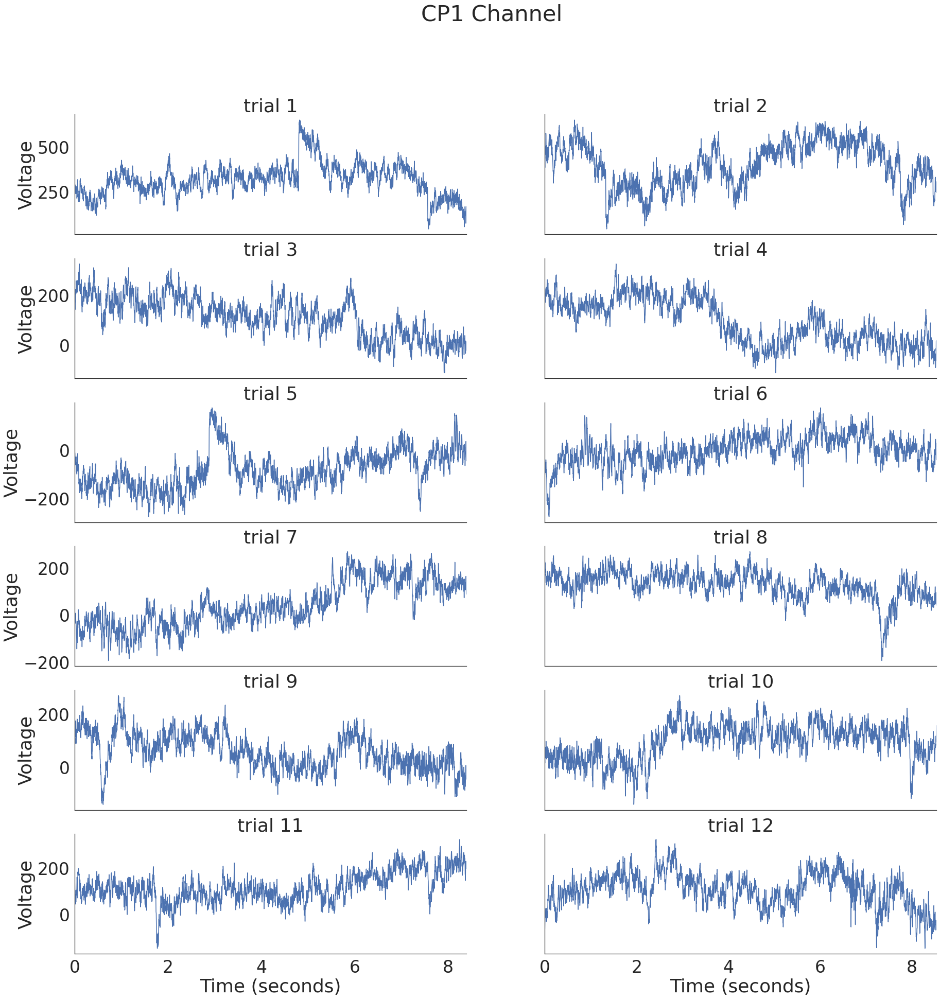

In [ ]:
time_CP1 = []

for x in CP1:
  time_CP1.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('CP1 Channel')
axs[0, 0].plot(time_CP1[0], CP1[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_CP1[0].min(), time_CP1[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_CP1[1], CP1[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_CP1[1].min(), time_CP1[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_CP1[2], CP1[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_CP1[2].min(), time_CP1[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_CP1[3], CP1[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_CP1[3].min(), time_CP1[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_CP1[4], CP1[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_CP1[4].min(), time_CP1[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_CP1[5], CP1[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_CP1[5].min(), time_CP1[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_CP1[6], CP1[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_CP1[6].min(), time_CP1[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_CP1[7], CP1[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_CP1[7].min(), time_CP1[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_CP1[8], CP1[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_CP1[8].min(), time_CP1[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_CP1[9], CP1[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_CP1[9].min(), time_CP1[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_CP1[10], CP1[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_CP1[10].min(), time_CP1[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_CP1[11], CP1[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_CP1[11].min(), time_CP1[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CP1 time domain.png')

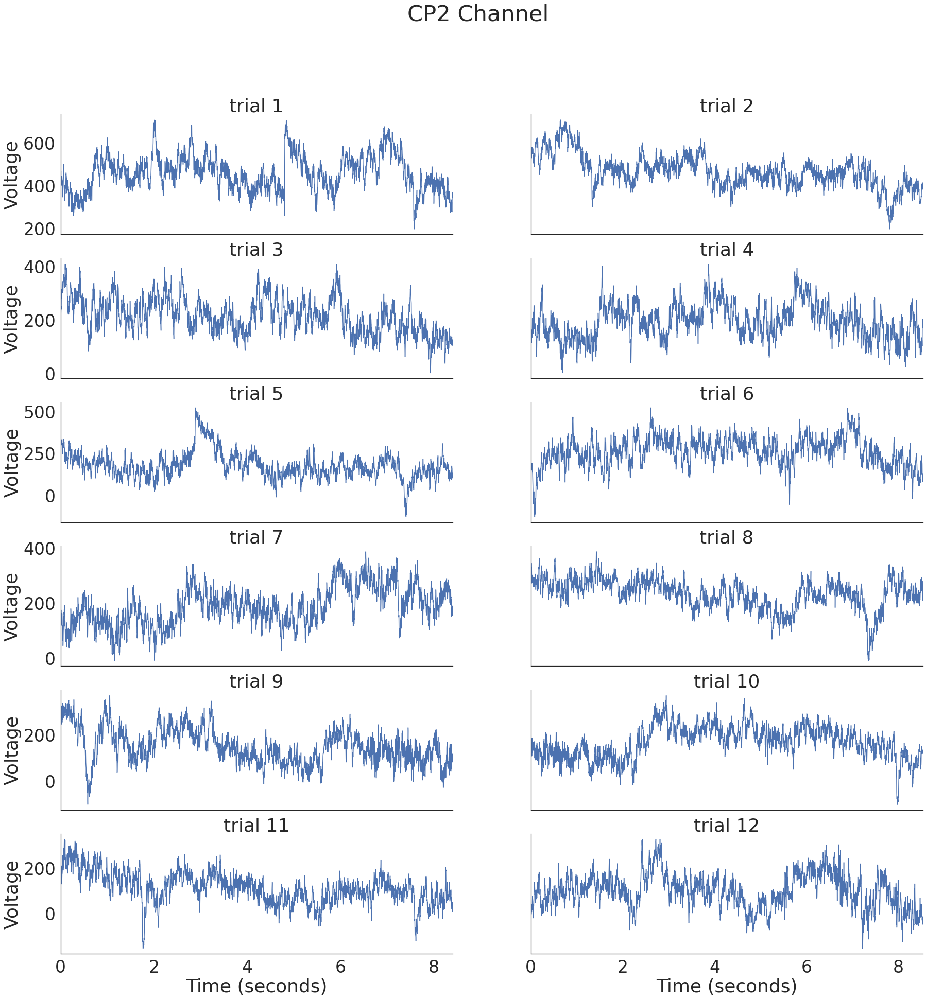

In [ ]:
time_CP2 = []

for x in CP2:
  time_CP2.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('CP2 Channel')
axs[0, 0].plot(time_CP2[0], CP2[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_CP2[0].min(), time_CP2[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_CP2[1], CP2[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_CP2[1].min(), time_CP2[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_CP2[2], CP2[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_CP2[2].min(), time_CP2[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_CP2[3], CP2[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_CP2[3].min(), time_CP2[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_CP2[4], CP2[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_CP2[4].min(), time_CP2[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_CP2[5], CP2[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_CP2[5].min(), time_CP2[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_CP2[6], CP2[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_CP2[6].min(), time_CP2[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_CP2[7], CP2[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_CP2[7].min(), time_CP2[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_CP2[8], CP2[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_CP2[8].min(), time_CP2[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_CP2[9], CP2[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_CP2[9].min(), time_CP2[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_CP2[10], CP2[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_CP2[10].min(), time_CP2[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_CP2[11], CP2[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_CP2[11].min(), time_CP2[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CP2 time domain.png')

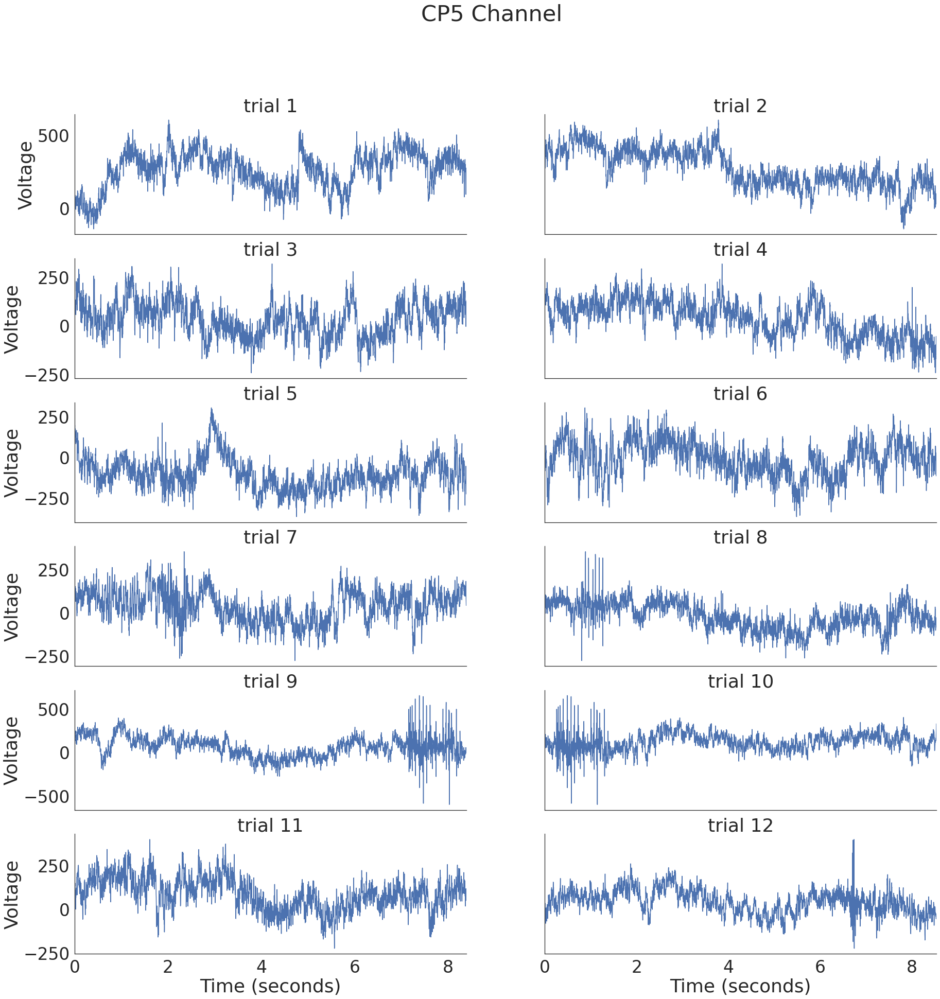

In [ ]:
time_CP5 = []

for x in CP5:
  time_CP5.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('CP5 Channel')
axs[0, 0].plot(time_CP5[0], CP5[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_CP5[0].min(), time_CP5[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_CP5[1], CP5[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_CP5[1].min(), time_CP5[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_CP5[2], CP5[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_CP5[2].min(), time_CP5[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_CP5[3], CP5[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_CP5[3].min(), time_CP5[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_CP5[4], CP5[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_CP5[4].min(), time_CP5[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_CP5[5], CP5[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_CP5[5].min(), time_CP5[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_CP5[6], CP5[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_CP5[6].min(), time_CP5[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_CP5[7], CP5[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_CP5[7].min(), time_CP5[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_CP5[8], CP5[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_CP5[8].min(), time_CP5[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_CP5[9], CP5[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_CP5[9].min(), time_CP5[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_CP5[10], CP5[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_CP5[10].min(), time_CP5[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_CP5[11], CP5[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_CP5[11].min(), time_CP5[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CP5 time domain.png')

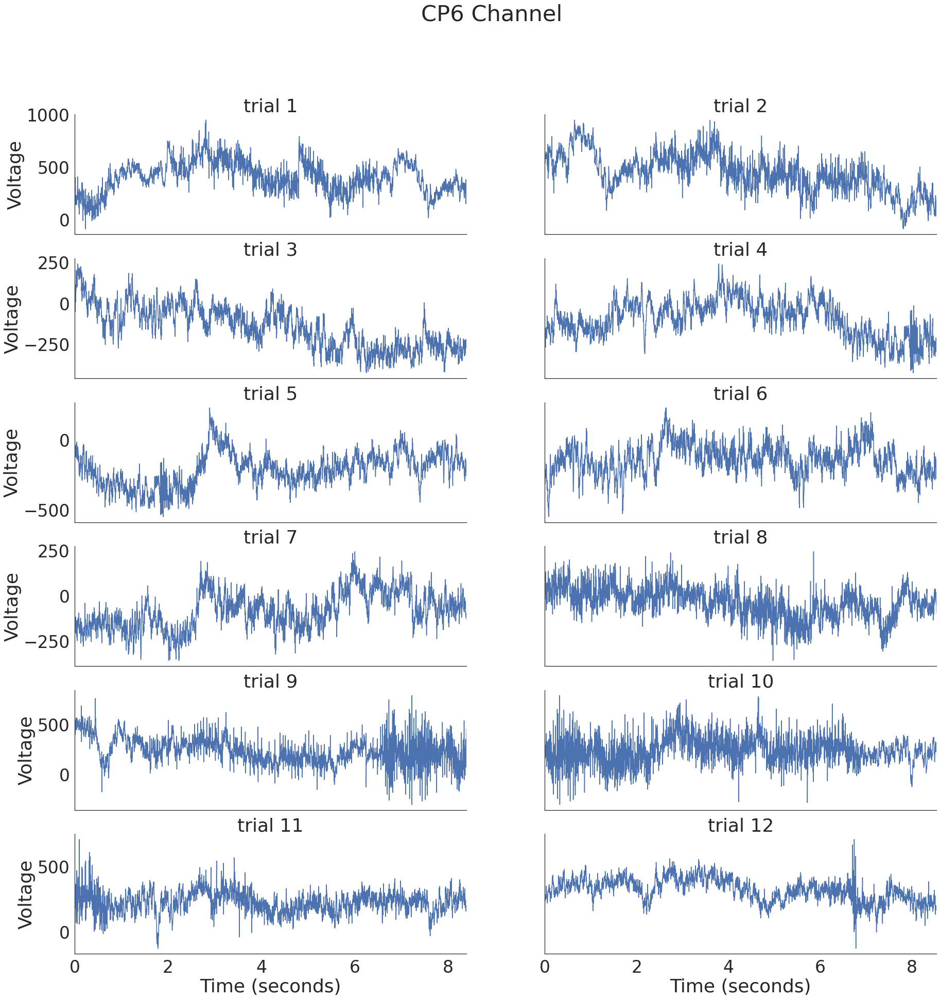

In [ ]:
time_CP6 = []

for x in CP6:
  time_CP6.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('CP6 Channel')
axs[0, 0].plot(time_CP6[0], CP6[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_CP6[0].min(), time_CP6[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_CP6[1], CP6[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_CP6[1].min(), time_CP6[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_CP6[2], CP6[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_CP6[2].min(), time_CP6[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_CP6[3], CP6[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_CP6[3].min(), time_CP6[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_CP6[4], CP6[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_CP6[4].min(), time_CP6[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_CP6[5], CP6[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_CP6[5].min(), time_CP6[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_CP6[6], CP6[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_CP6[6].min(), time_CP6[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_CP6[7], CP6[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_CP6[7].min(), time_CP6[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_CP6[8], CP6[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_CP6[8].min(), time_CP6[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_CP6[9], CP6[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_CP6[9].min(), time_CP6[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_CP6[10], CP6[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_CP6[10].min(), time_CP6[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_CP6[11], CP6[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_CP6[11].min(), time_CP6[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CP6 time domain.png')

# **Data visualisation for EEG in frequency domain**

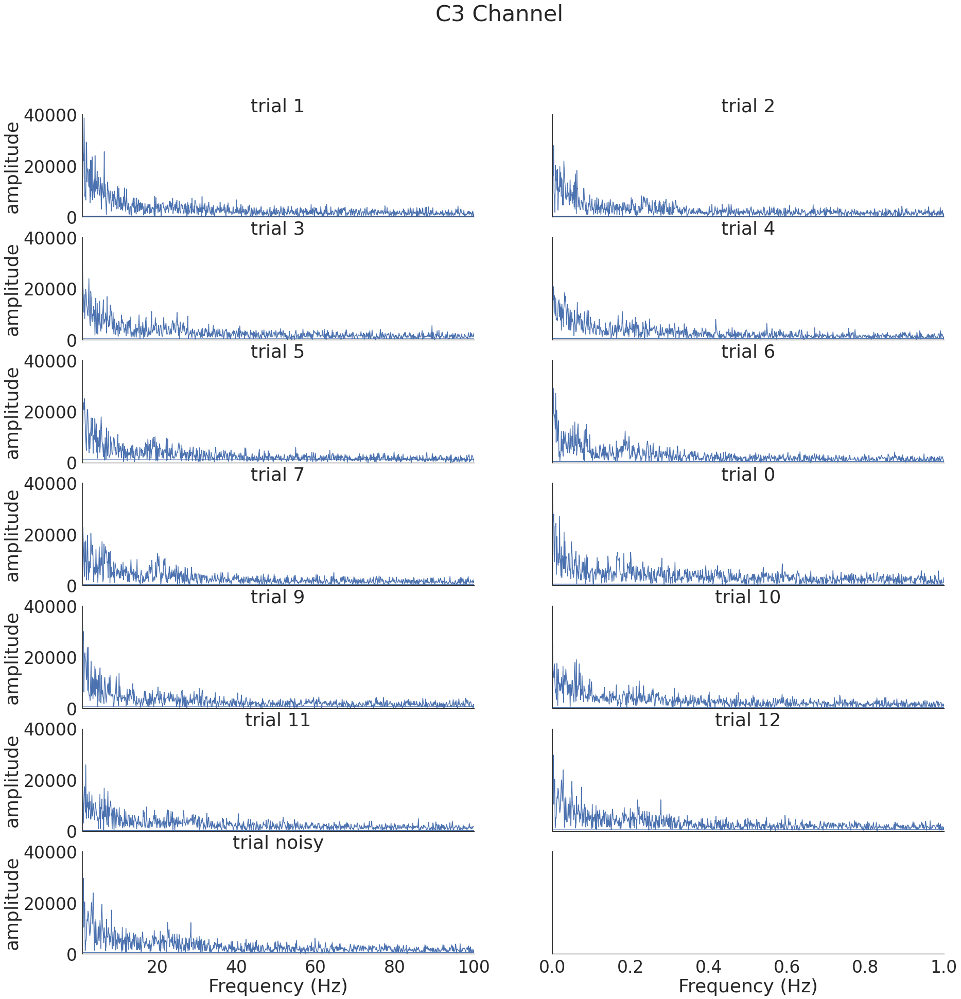

In [ ]:
from scipy.fft import fft, fftfreq
sf = 500.

C3 = [C3_1, C3_2, C3_3, C3_4, C3_5, C3_6, C3_7, C3_8, C3_9, C3_10, C3_11, C3_12, C3_12_noisy]
C4 = [C4_1, C4_2, C4_3, C4_4, C4_5, C4_6, C4_7, C4_8, C4_9, C4_10, C4_11, C4_12, C4_12_noisy]
Cz = [Cz_1, Cz_2, Cz_3, Cz_4, Cz_5, Cz_6, Cz_7, Cz_8, Cz_9, Cz_10, Cz_11, Cz_12, Cz_12_noisy]
CP1 = [CP1_1, CP1_2, CP1_3, CP1_4, CP1_5, CP1_6, CP1_7, CP1_8, CP1_9, CP1_10, CP1_11, CP1_12, CP1_12_noisy]
CP2 = [CP2_1, CP2_2, CP2_3, CP2_4, CP2_5, CP2_6, CP2_7, CP2_8, CP2_9, CP2_10, CP2_11, CP2_12, CP2_12_noisy]
CP5 = [CP5_1, CP5_2, CP5_3, CP5_4, CP5_5, CP5_6, CP5_7, CP5_8, CP5_9, CP5_10, CP5_11, CP5_12, CP5_12_noisy]
CP6 = [CP6_1, CP6_2, CP6_3, CP6_4, CP6_5, CP6_6, CP6_7, CP6_8, CP6_9, CP6_10, CP6_11, CP6_12, CP6_12_noisy]

amplitude_C3 = []
frequency_C3 = []

for x in C3:
  amplitude = np.abs(fft(x))
  frequency = fftfreq(len(x), 1/sf)
  amplitude_C3.append(amplitude)
  frequency_C3.append(frequency)

fig, axs = plt.subplots(7, 2, figsize = (30, 30))
fig.suptitle('C3 Channel')
axs[0, 0].plot(frequency_C3[0], amplitude_C3[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 100])
axs[0, 0].set_ylim([0, 40000])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_C3[1], amplitude_C3[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 100])
axs[0, 1].set_ylim([0, 40000])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_C3[2], amplitude_C3[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 100])
axs[1, 0].set_ylim([0, 40000])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_C3[3], amplitude_C3[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 100])
axs[1, 1].set_ylim([0, 40000])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_C3[4], amplitude_C3[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 100])
axs[2, 0].set_ylim([0, 40000])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_C3[5], amplitude_C3[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 100])
axs[2, 1].set_ylim([0, 40000])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_C3[6], amplitude_C3[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 100])
axs[3, 0].set_ylim([0, 40000])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_C3[7], amplitude_C3[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 100])
axs[3, 1].set_ylim([0, 40000])
axs[3, 1].set_title('trial 0')
axs[4, 0].plot(frequency_C3[8], amplitude_C3[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 100])
axs[4, 0].set_ylim([0, 40000])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_C3[9], amplitude_C3[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 100])
axs[4, 1].set_ylim([0, 40000])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_C3[10], amplitude_C3[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 100])
axs[5, 0].set_ylim([0, 40000])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_C3[11], amplitude_C3[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 100])
axs[5, 1].set_ylim([0, 40000])
axs[5, 1].set_title('trial 12')
axs[6, 0].plot(frequency_C3[12], amplitude_C3[12], lw = 1.5, color = 'b')
axs[6, 0].set_xlim([1, 100])
axs[6, 0].set_ylim([0, 40000])
axs[6, 0].set_title('trial noisy')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/C3 frequency domain.png')

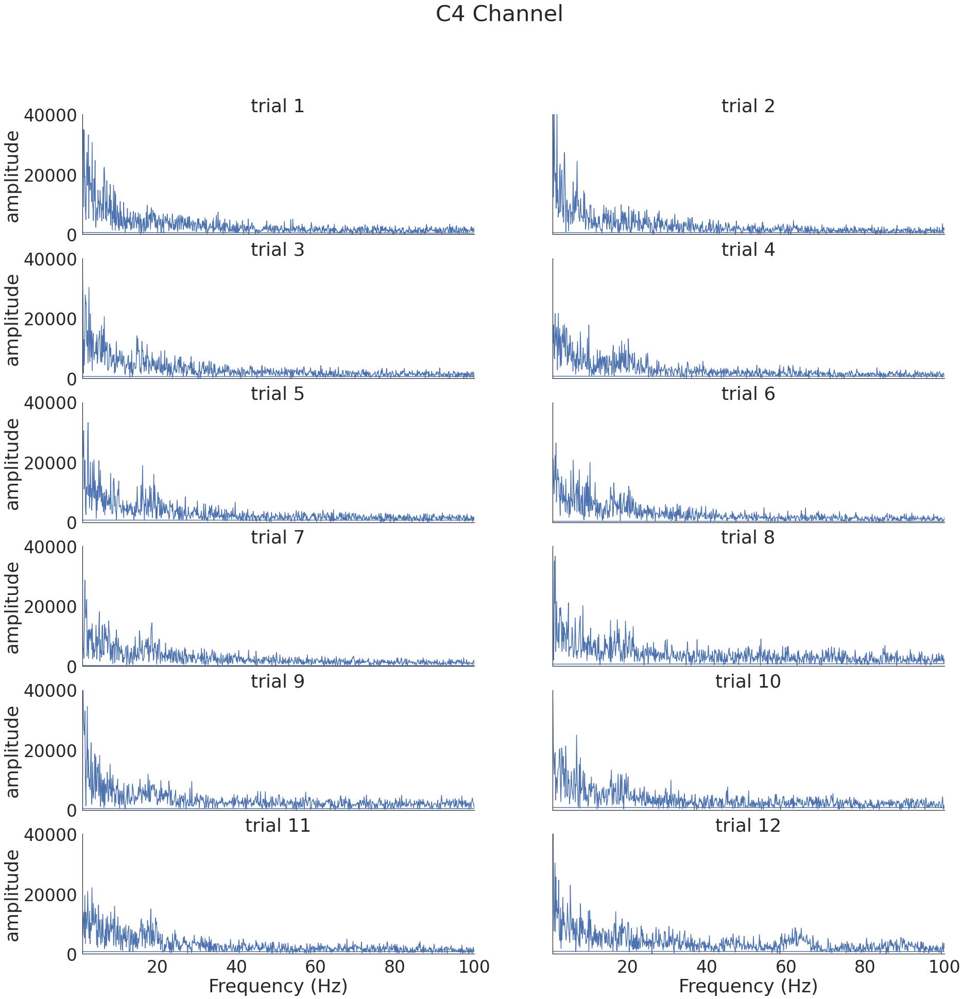

In [ ]:
amplitude_C4 = []
frequency_C4 = []

for x in C4:
  amplitude = np.abs(fft(x))
  frequency = fftfreq(len(x), 1/sf)
  amplitude_C4.append(amplitude)
  frequency_C4.append(frequency)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('C4 Channel')
axs[0, 0].plot(frequency_C4[0], amplitude_C4[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 100])
axs[0, 0].set_ylim([0, 40000])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_C4[1], amplitude_C4[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 100])
axs[0, 1].set_ylim([0, 40000])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_C4[2], amplitude_C4[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 100])
axs[1, 0].set_ylim([0, 40000])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_C4[3], amplitude_C4[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 100])
axs[1, 1].set_ylim([0, 40000])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_C4[4], amplitude_C4[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 100])
axs[2, 0].set_ylim([0, 40000])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_C4[5], amplitude_C4[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 100])
axs[2, 1].set_ylim([0, 40000])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_C4[6], amplitude_C4[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 100])
axs[3, 0].set_ylim([0, 40000])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_C4[7], amplitude_C4[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 100])
axs[3, 1].set_ylim([0, 40000])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(frequency_C4[8], amplitude_C4[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 100])
axs[4, 0].set_ylim([0, 40000])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_C4[9], amplitude_C4[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 100])
axs[4, 1].set_ylim([0, 40000])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_C4[10], amplitude_C4[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 100])
axs[5, 0].set_ylim([0, 40000])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_C4[11], amplitude_C4[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 100])
axs[5, 1].set_ylim([0, 40000])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/C4 frequency domain.png')

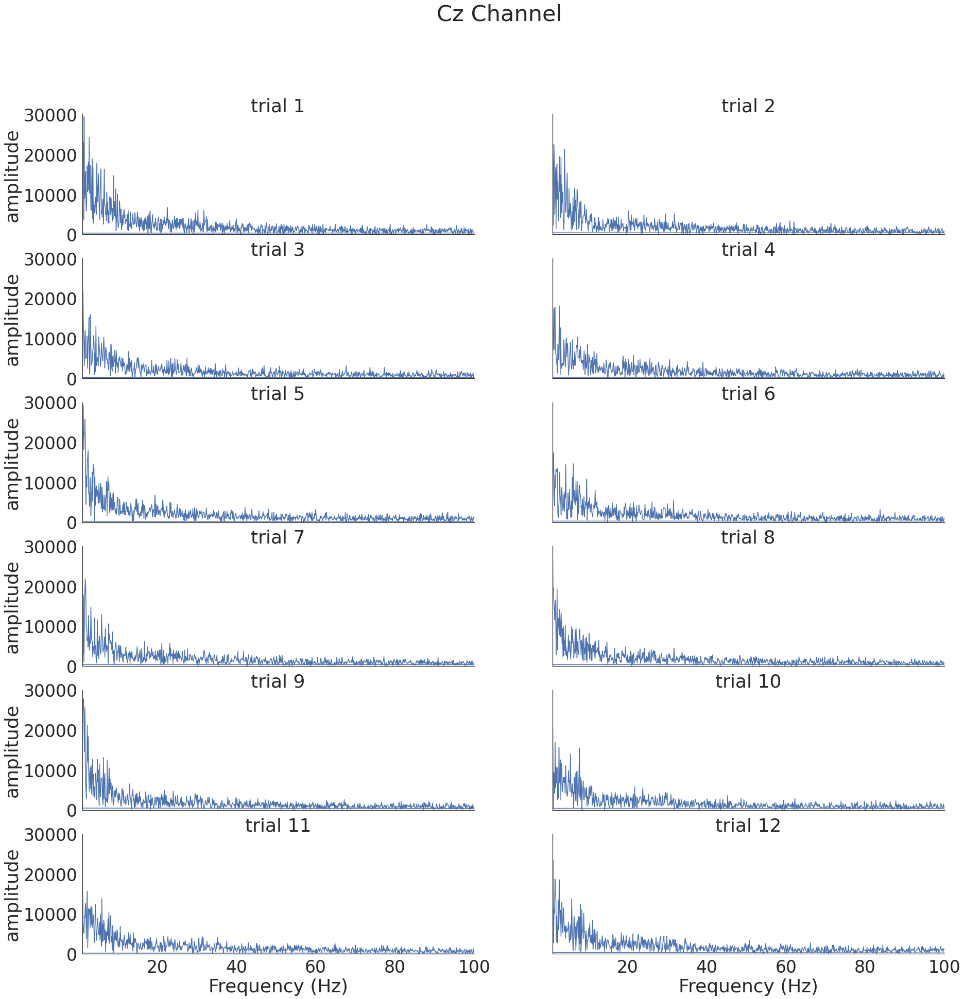

In [ ]:
amplitude_Cz = []
frequency_Cz = []

for x in Cz:
  amplitude = np.abs(fft(x))
  frequency = fftfreq(len(x), 1/sf)
  amplitude_Cz.append(amplitude)
  frequency_Cz.append(frequency)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Cz Channel')
axs[0, 0].plot(frequency_Cz[0], amplitude_Cz[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 100])
axs[0, 0].set_ylim([0, 30000])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_Cz[1], amplitude_Cz[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 100])
axs[0, 1].set_ylim([0, 30000])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_Cz[2], amplitude_Cz[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 100])
axs[1, 0].set_ylim([0, 30000])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_Cz[3], amplitude_Cz[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 100])
axs[1, 1].set_ylim([0, 30000])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_Cz[4], amplitude_Cz[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 100])
axs[2, 0].set_ylim([0, 30000])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_Cz[5], amplitude_Cz[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 100])
axs[2, 1].set_ylim([0, 30000])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_Cz[6], amplitude_Cz[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 100])
axs[3, 0].set_ylim([0, 30000])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_Cz[7], amplitude_Cz[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 100])
axs[3, 1].set_ylim([0, 30000])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(frequency_Cz[8], amplitude_Cz[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 100])
axs[4, 0].set_ylim([0, 30000])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_Cz[9], amplitude_Cz[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 100])
axs[4, 1].set_ylim([0, 30000])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_Cz[10], amplitude_Cz[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 100])
axs[5, 0].set_ylim([0, 30000])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_Cz[11], amplitude_Cz[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 100])
axs[5, 1].set_ylim([0, 30000])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/Cz frequency domain.png')

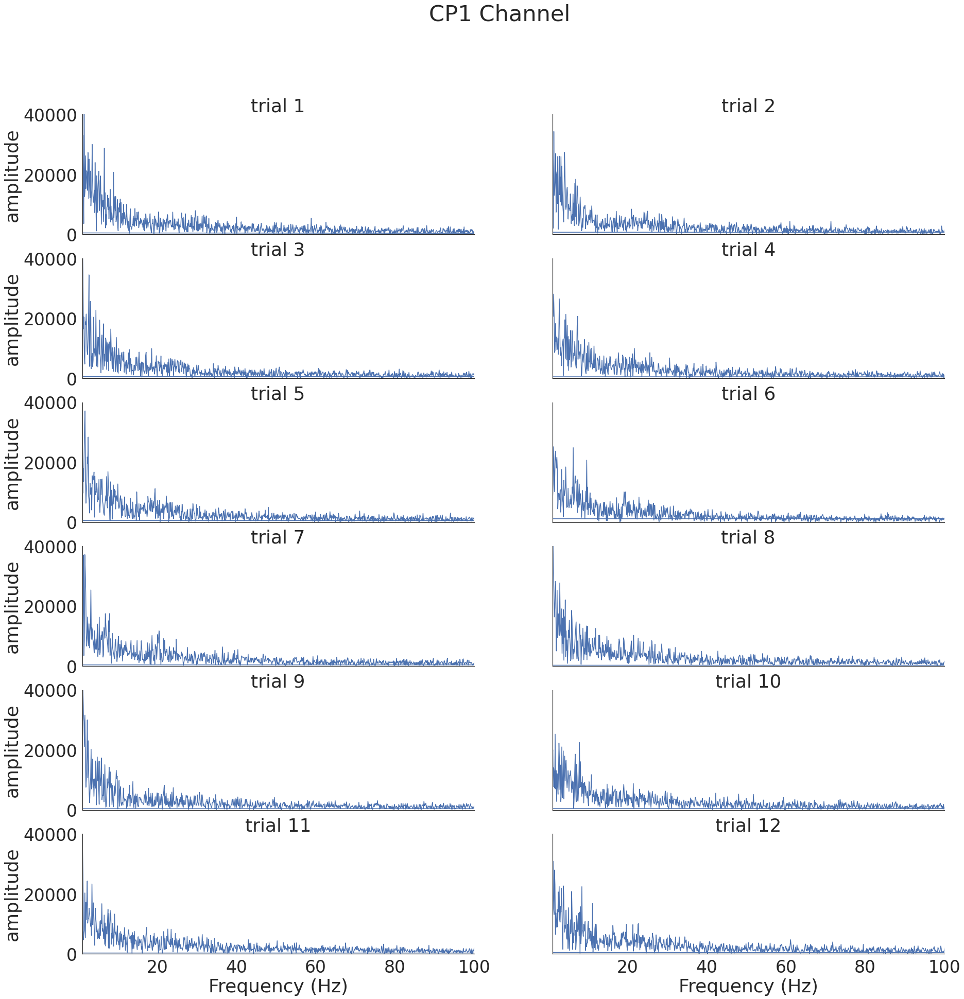

In [ ]:
amplitude_CP1 = []
frequency_CP1 = []

for x in CP1:
  amplitude = np.abs(fft(x))
  frequency = fftfreq(len(x), 1/sf)
  amplitude_CP1.append(amplitude)
  frequency_CP1.append(frequency)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('CP1 Channel')
axs[0, 0].plot(frequency_CP1[0], amplitude_CP1[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 100])
axs[0, 0].set_ylim([0, 40000])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_CP1[1], amplitude_CP1[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 100])
axs[0, 1].set_ylim([0, 40000])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_CP1[2], amplitude_CP1[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 100])
axs[1, 0].set_ylim([0, 40000])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_CP1[3], amplitude_CP1[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 100])
axs[1, 1].set_ylim([0, 40000])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_CP1[4], amplitude_CP1[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 100])
axs[2, 0].set_ylim([0, 40000])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_CP1[5], amplitude_CP1[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 100])
axs[2, 1].set_ylim([0, 40000])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_CP1[6], amplitude_CP1[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 100])
axs[3, 0].set_ylim([0, 40000])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_CP1[7], amplitude_CP1[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 100])
axs[3, 1].set_ylim([0, 40000])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(frequency_CP1[8], amplitude_CP1[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 100])
axs[4, 0].set_ylim([0, 40000])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_CP1[9], amplitude_CP1[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 100])
axs[4, 1].set_ylim([0, 40000])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_CP1[10], amplitude_CP1[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 100])
axs[5, 0].set_ylim([0, 40000])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_CP1[11], amplitude_CP1[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 100])
axs[5, 1].set_ylim([0, 40000])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CP1 frequency domain.png')

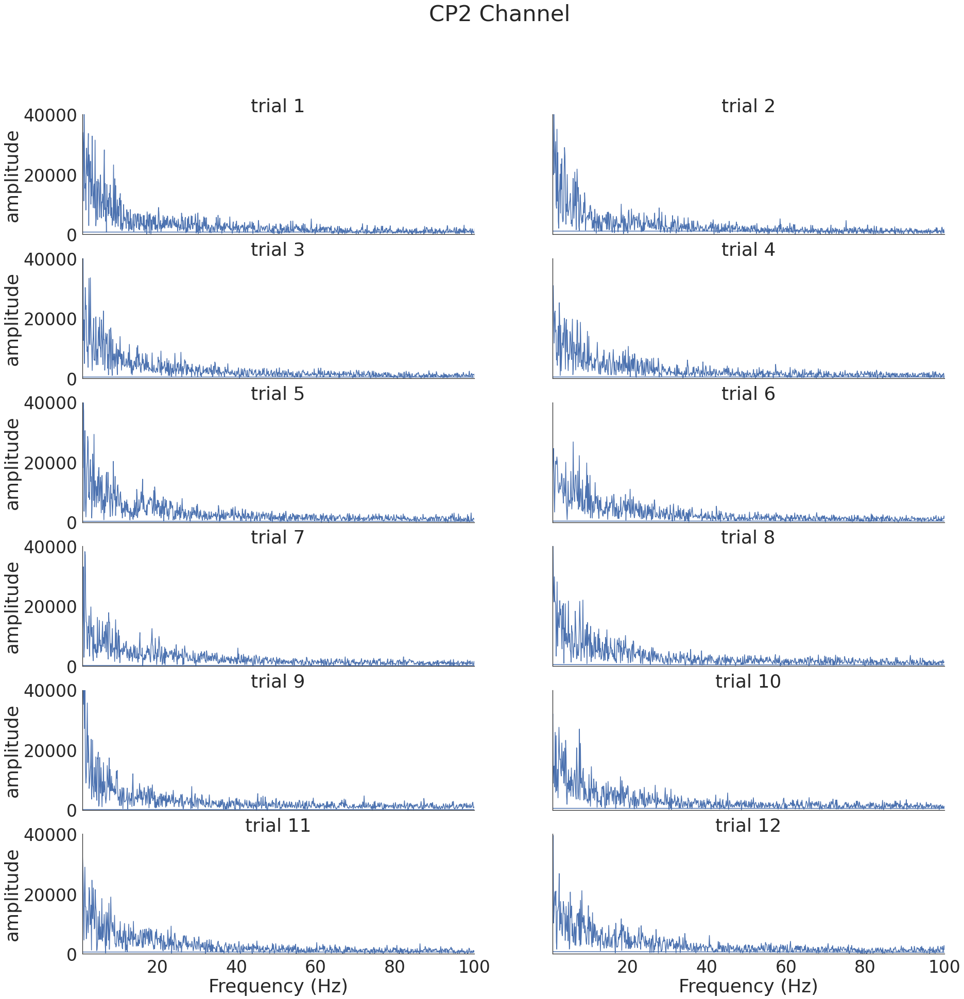

In [ ]:
amplitude_CP2 = []
frequency_CP2 = []

for x in CP2:
  amplitude = np.abs(fft(x))
  frequency = fftfreq(len(x), 1/sf)
  amplitude_CP2.append(amplitude)
  frequency_CP2.append(frequency)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('CP2 Channel')
axs[0, 0].plot(frequency_CP2[0], amplitude_CP2[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 100])
axs[0, 0].set_ylim([0, 40000])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_CP2[1], amplitude_CP2[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 100])
axs[0, 1].set_ylim([0, 40000])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_CP2[2], amplitude_CP2[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 100])
axs[1, 0].set_ylim([0, 40000])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_CP2[3], amplitude_CP2[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 100])
axs[1, 1].set_ylim([0, 40000])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_CP2[4], amplitude_CP2[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 100])
axs[2, 0].set_ylim([0, 40000])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_CP2[5], amplitude_CP2[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 100])
axs[2, 1].set_ylim([0, 40000])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_CP2[6], amplitude_CP2[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 100])
axs[3, 0].set_ylim([0, 40000])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_CP2[7], amplitude_CP2[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 100])
axs[3, 1].set_ylim([0, 40000])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(frequency_CP2[8], amplitude_CP2[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 100])
axs[4, 0].set_ylim([0, 40000])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_CP2[9], amplitude_CP2[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 100])
axs[4, 1].set_ylim([0, 40000])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_CP2[10], amplitude_CP2[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 100])
axs[5, 0].set_ylim([0, 40000])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_CP2[11], amplitude_CP2[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 100])
axs[5, 1].set_ylim([0, 40000])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CP2 frequency domain.png')

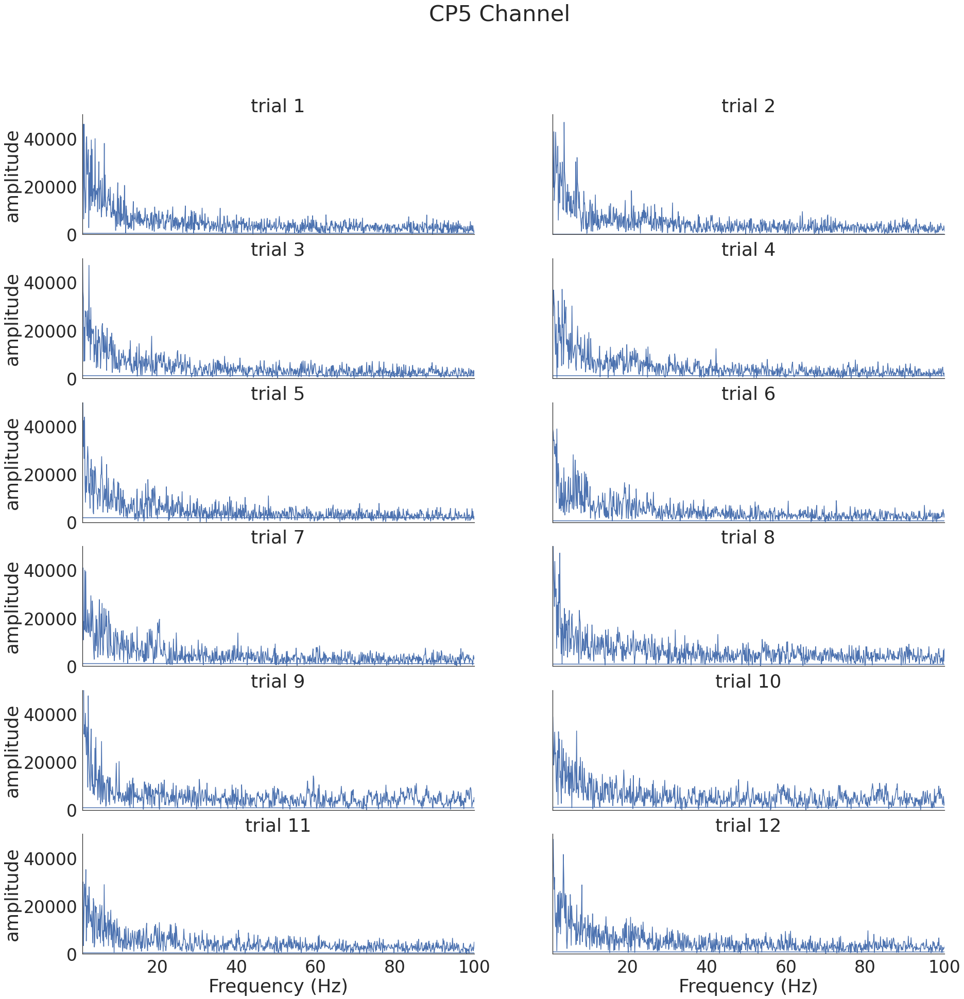

In [ ]:
amplitude_CP5 = []
frequency_CP5 = []

for x in CP5:
  amplitude = np.abs(fft(x))
  frequency = fftfreq(len(x), 1/sf)
  amplitude_CP5.append(amplitude)
  frequency_CP5.append(frequency)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('CP5 Channel')
axs[0, 0].plot(frequency_CP5[0], amplitude_CP5[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 100])
axs[0, 0].set_ylim([0, 50000])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_CP5[1], amplitude_CP5[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 100])
axs[0, 1].set_ylim([0, 50000])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_CP5[2], amplitude_CP5[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 100])
axs[1, 0].set_ylim([0, 50000])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_CP5[3], amplitude_CP5[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 100])
axs[1, 1].set_ylim([0, 50000])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_CP5[4], amplitude_CP5[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 100])
axs[2, 0].set_ylim([0, 50000])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_CP5[5], amplitude_CP5[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 100])
axs[2, 1].set_ylim([0, 50000])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_CP5[6], amplitude_CP5[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 100])
axs[3, 0].set_ylim([0, 50000])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_CP5[7], amplitude_CP5[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 100])
axs[3, 1].set_ylim([0, 50000])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(frequency_CP5[8], amplitude_CP5[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 100])
axs[4, 0].set_ylim([0, 50000])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_CP5[9], amplitude_CP5[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 100])
axs[4, 1].set_ylim([0, 50000])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_CP5[10], amplitude_CP5[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 100])
axs[5, 0].set_ylim([0, 50000])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_CP5[11], amplitude_CP5[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 100])
axs[5, 1].set_ylim([0, 50000])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CP5 frequency domain.png')

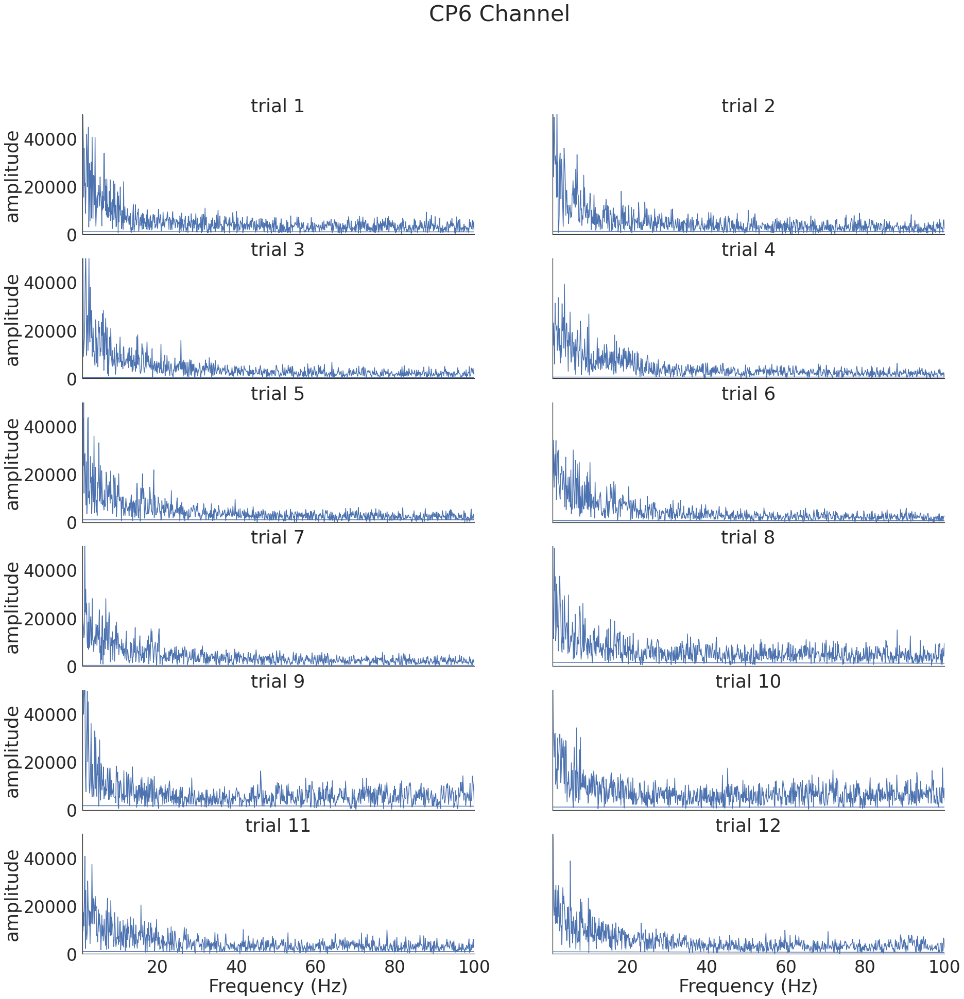

In [ ]:
amplitude_CP6 = []
frequency_CP6 = []

for x in CP6:
  amplitude = np.abs(fft(x))
  frequency = fftfreq(len(x), 1/sf)
  amplitude_CP6.append(amplitude)
  frequency_CP6.append(frequency)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('CP6 Channel')
axs[0, 0].plot(frequency_CP6[0], amplitude_CP6[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 100])
axs[0, 0].set_ylim([0, 50000])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_CP6[1], amplitude_CP6[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 100])
axs[0, 1].set_ylim([0, 50000])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_CP6[2], amplitude_CP6[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 100])
axs[1, 0].set_ylim([0, 50000])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_CP6[3], amplitude_CP6[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 100])
axs[1, 1].set_ylim([0, 50000])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_CP6[4], amplitude_CP6[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 100])
axs[2, 0].set_ylim([0, 50000])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_CP6[5], amplitude_CP6[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 100])
axs[2, 1].set_ylim([0, 50000])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_CP6[6], amplitude_CP6[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 100])
axs[3, 0].set_ylim([0, 50000])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_CP6[7], amplitude_CP6[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 100])
axs[3, 1].set_ylim([0, 50000])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(frequency_CP6[8], amplitude_CP6[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 100])
axs[4, 0].set_ylim([0, 50000])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_CP6[9], amplitude_CP6[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 100])
axs[4, 1].set_ylim([0, 50000])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_CP6[10], amplitude_CP6[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 100])
axs[5, 0].set_ylim([0, 50000])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_CP6[11], amplitude_CP6[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 100])
axs[5, 1].set_ylim([0, 50000])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CP6 frequency domain.png')

# **Spectrogram for EEG**

In [ ]:
def spectrogram_plot(data, index):
  from scipy import signal
  from scipy.fft import fftshift
  import matplotlib.pyplot as plt
  fs = 500
  x = data
  f, t, Sxx = signal.spectrogram(x, fs)
  plt.pcolormesh(t, f, Sxx, shading='gouraud')
  plt.ylabel('Frequency [Hz]')
  plt.xlabel('Time [sec]')
  plt.ylim([1, 100])
  plt.title('trial ' + str(index))
  plt.colorbar()
  plt.savefig('/content/drive/MyDrive/UROP/plotting/trail ' + str(index) + '.png')
  plt.show()

In [ ]:
# C3 = [C3_1[0:2000], C3_2[0:2000], C3_3[0:2000], C3_4[0:2000], C3_5[0:2000], C3_6[0:2000], C3_7[0:2000], C3_8[0:2000], C3_9[0:2000], C3_10[0:2000], C3_11[0:2000], C3_12[0:2000]]
# C4 = [C4_1[0:2000], C4_2[0:2000], C4_3[0:2000], C4_4[0:2000], C4_5[0:2000], C4_6[0:2000], C4_7[0:2000], C4_8[0:2000], C4_9[0:2000], C4_10[0:2000], C4_11[0:2000], C4_12[0:2000]]
# Cz = [Cz_1[0:2000], Cz_2[0:2000], Cz_3[0:2000], Cz_4[0:2000], Cz_5[0:2000], Cz_6[0:2000], Cz_7[0:2000], Cz_8[0:2000], Cz_9[0:2000], Cz_10[0:2000], Cz_11[0:2000], Cz_12[0:2000]]
# CP1 = [CP1_1[0:2000], CP1_2[0:2000], CP1_3[0:2000], CP1_4[0:2000], CP1_5[0:2000], CP1_6[0:2000], CP1_7[0:2000], CP1_8[0:2000], CP1_9[0:2000], CP1_10[0:2000], CP1_11[0:2000], CP1_12[0:2000]]
# CP2 = [CP2_1[0:2000], CP2_2[0:2000], CP2_3[0:2000], CP2_4[0:2000], CP2_5[0:2000], CP2_6[0:2000], CP2_7[0:2000], CP2_8[0:2000], CP2_9[0:2000], CP2_10[0:2000], CP2_11[0:2000], CP2_12[0:2000]]
# CP5 = [CP5_1[0:2000], CP5_2[0:2000], CP5_3[0:2000], CP5_4[0:2000], CP5_5[0:2000], CP5_6[0:2000], CP5_7[0:2000], CP5_8[0:2000], CP5_9[0:2000], CP5_10[0:2000], CP5_11[0:2000], CP5_12[0:2000]]
# CP6 = [CP6_1[0:2000], CP6_2[0:2000], CP6_3[0:2000], CP6_4[0:2000], CP6_5[0:2000], CP6_6[0:2000], CP6_7[0:2000], CP6_8[0:2000], CP6_9[0:2000], CP6_10[0:2000], CP6_11[0:2000], CP6_12[0:2000]]

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(font_scale = 1.2, style = 'white')

C3 = [C3_1, C3_2, C3_3, C3_4, C3_5, C3_6, C3_7, C3_8, C3_9, C3_10, C3_11, C3_12]
C4 = [C4_1, C4_2, C4_3, C4_4, C4_5, C4_6, C4_7, C4_8, C4_9, C4_10, C4_11, C4_12]
Cz = [Cz_1, Cz_2, Cz_3, Cz_4, Cz_5, Cz_6, Cz_7, Cz_8, Cz_9, Cz_10, Cz_11, Cz_12]
CP1 = [CP1_1, CP1_2, CP1_3, CP1_4, CP1_5, CP1_6, CP1_7, CP1_8, CP1_9, CP1_10, CP1_11, CP1_12]
CP2 = [CP2_1, CP2_2, CP2_3, CP2_4, CP2_5, CP2_6, CP2_7, CP2_8, CP2_9, CP2_10, CP2_11, CP2_12]
CP5 = [CP5_1, CP5_2, CP5_3, CP5_4, CP5_5, CP5_6, CP5_7, CP5_8, CP5_9, CP5_10, CP5_11, CP5_12]
CP6 = [CP6_1, CP6_2, CP6_3, CP6_4, CP6_5, CP6_6, CP6_7, CP6_8, CP6_9, CP6_10, CP6_11, CP6_12]

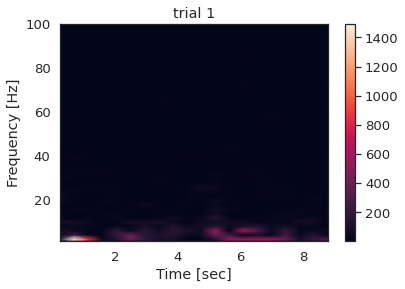

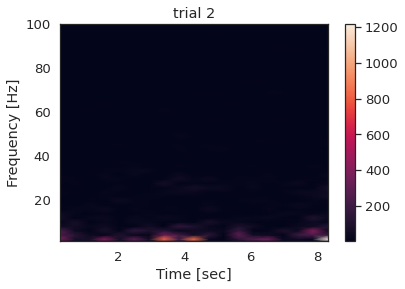

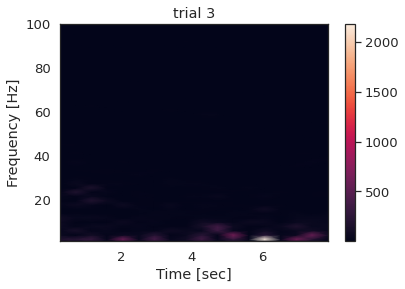

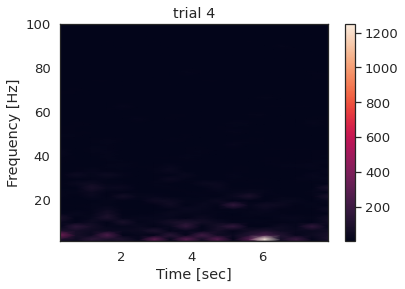

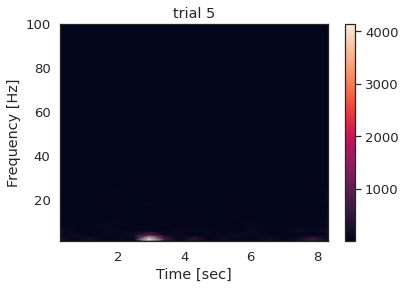

...

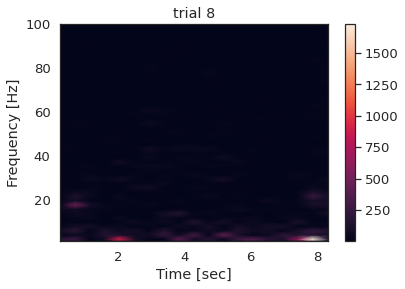

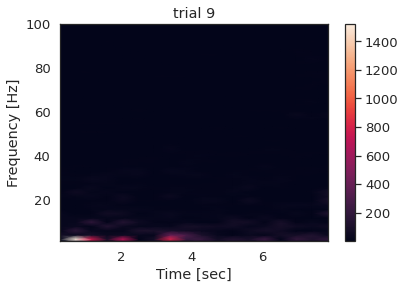

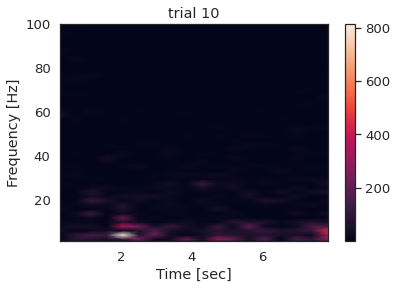

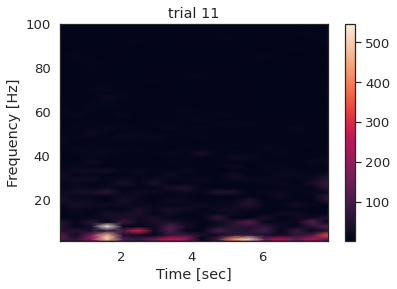

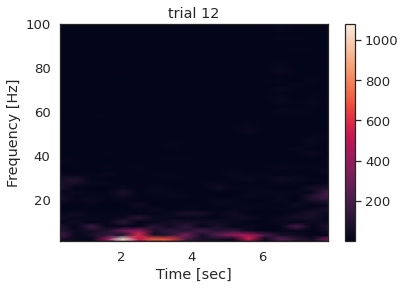

In [ ]:
# C3
for x in range(12):
  spectrogram_plot(C3[x], x+1)

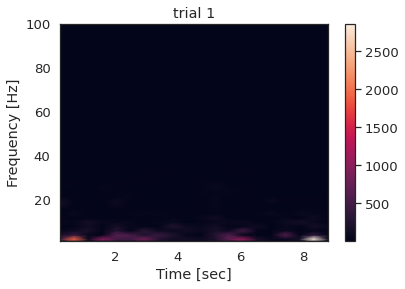

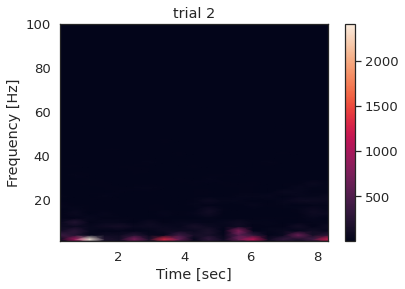

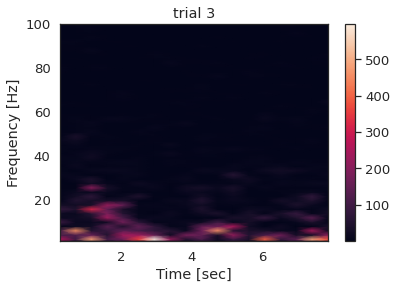

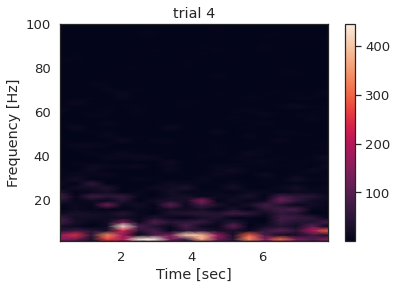

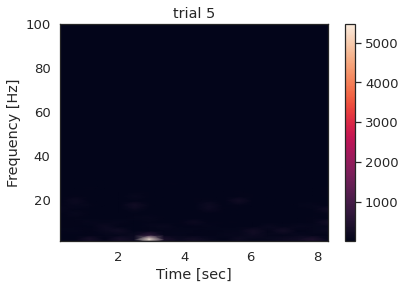

...

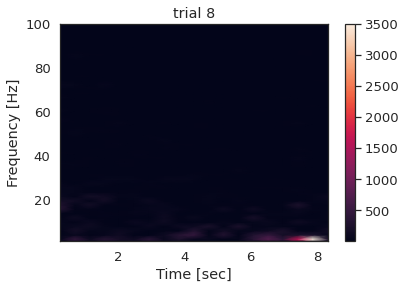

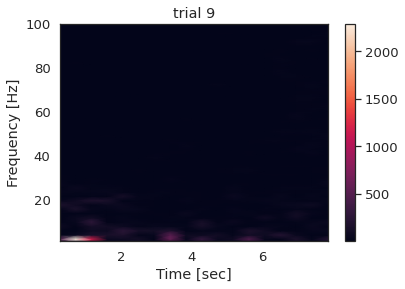

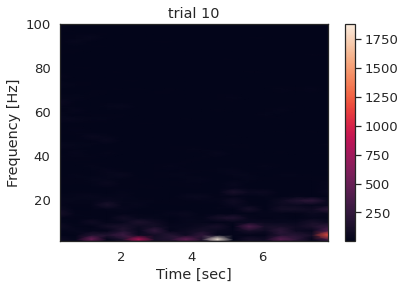

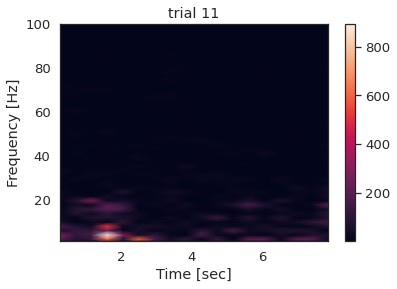

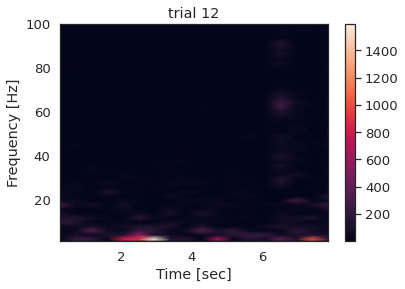

In [ ]:
# C4
for x in range(12):
  spectrogram_plot(C4[x], x+1)

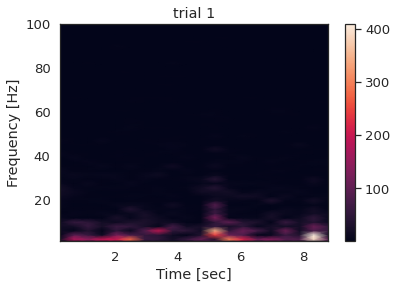

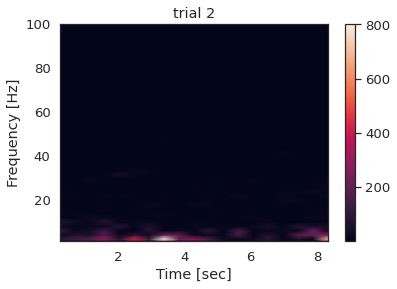

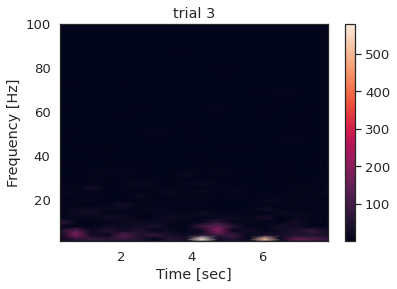

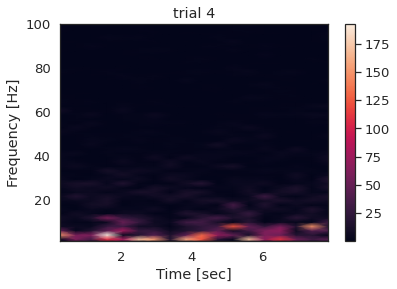

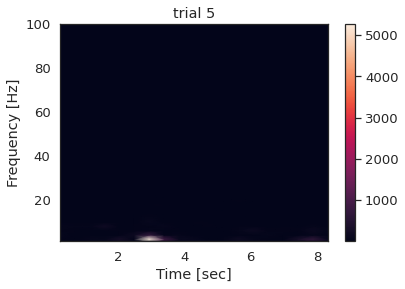

...

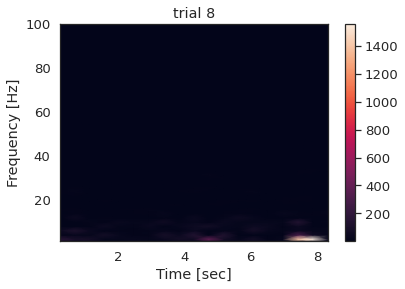

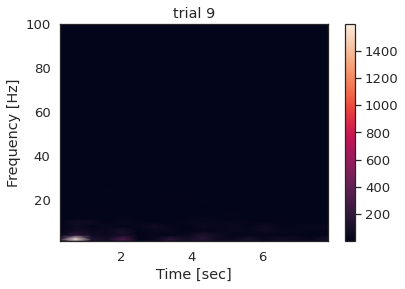

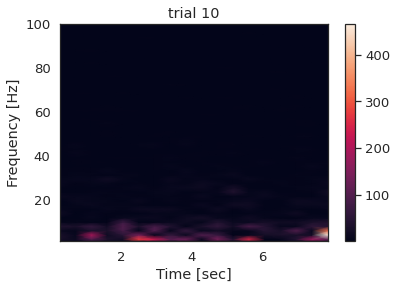

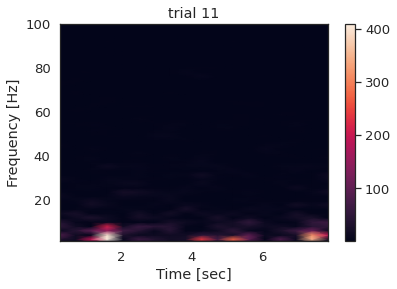

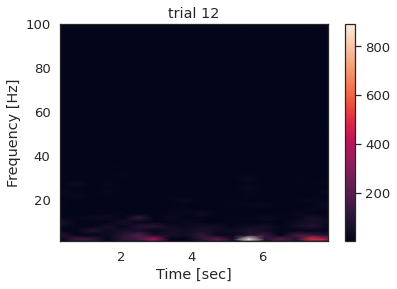

In [ ]:
# Cz
for x in range(12):
  spectrogram_plot(Cz[x], x+1)

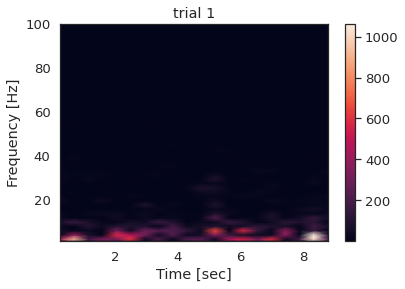

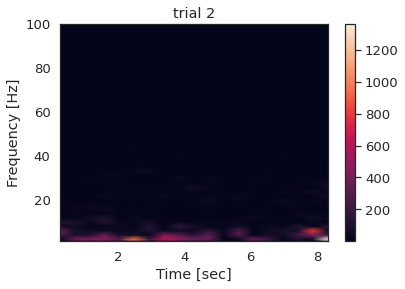

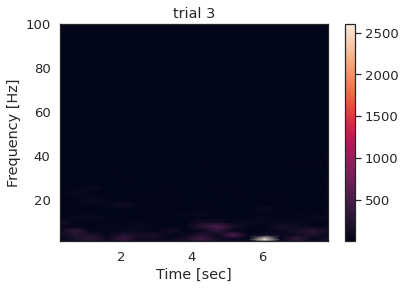

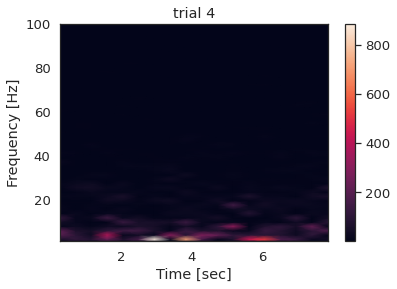

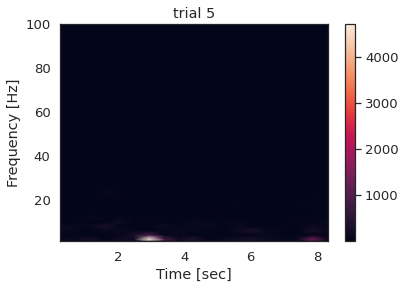

...

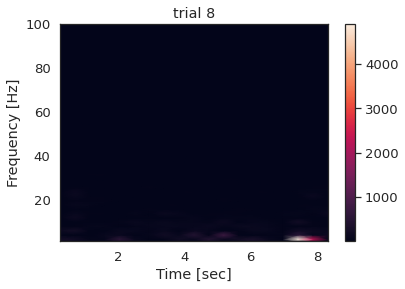

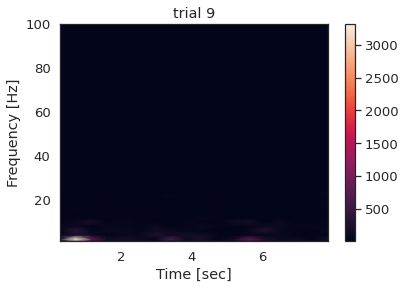

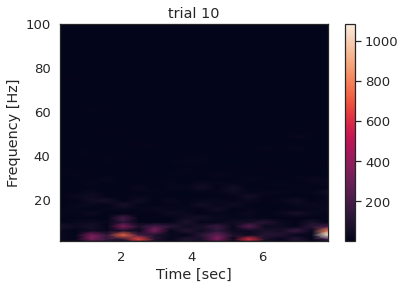

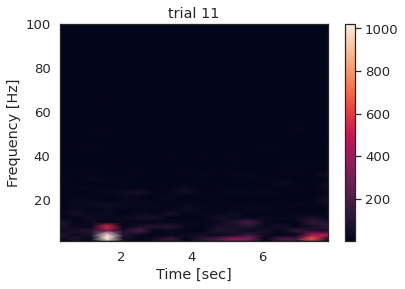

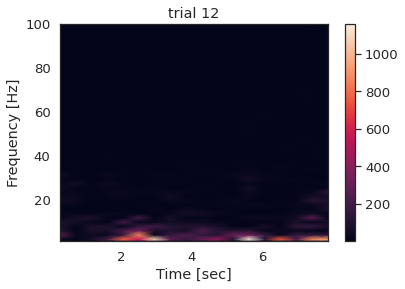

In [ ]:
# CP1
for x in range(12):
  spectrogram_plot(CP1[x] ,x+1)

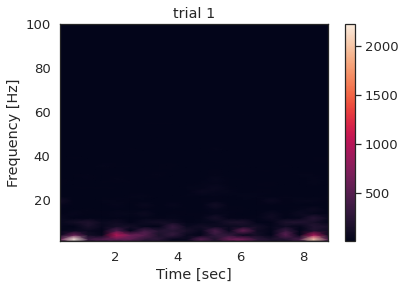

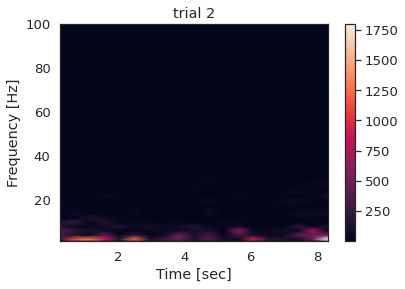

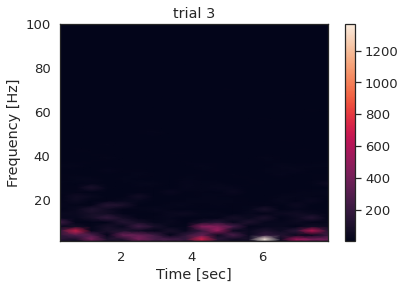

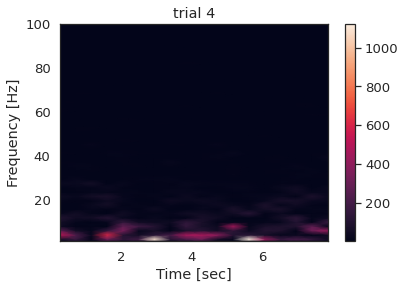

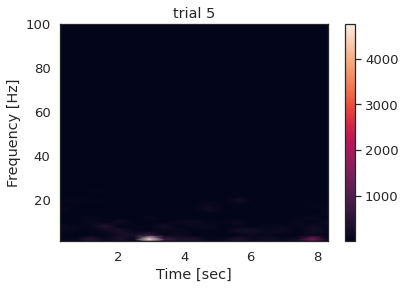

...

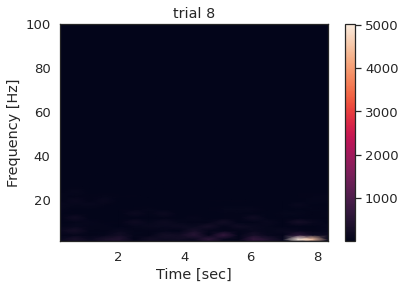

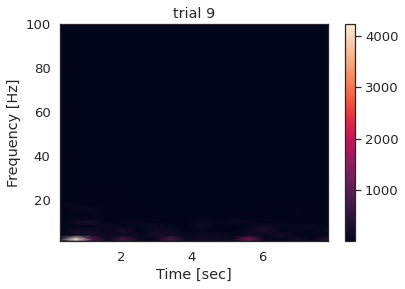

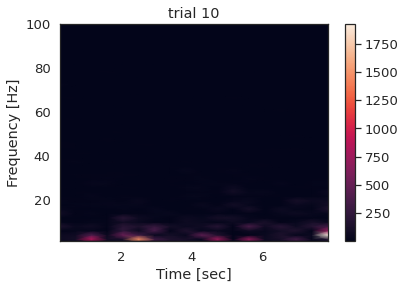

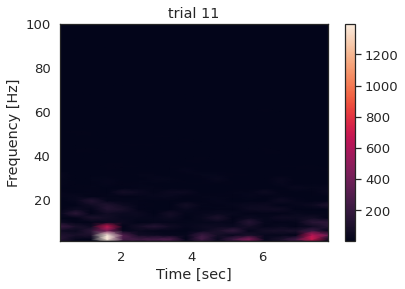

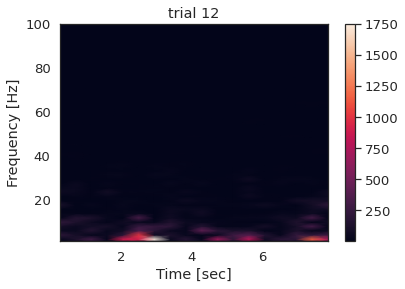

In [ ]:
# CP2
for x in range(12):
  spectrogram_plot(CP2[x], x+1)

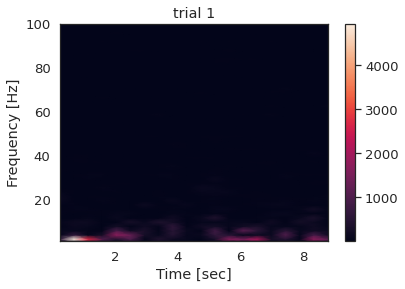

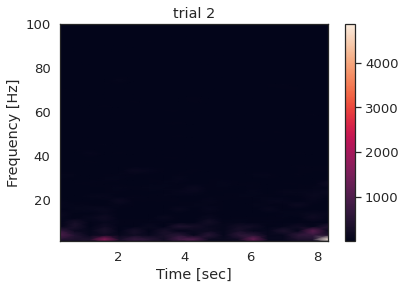

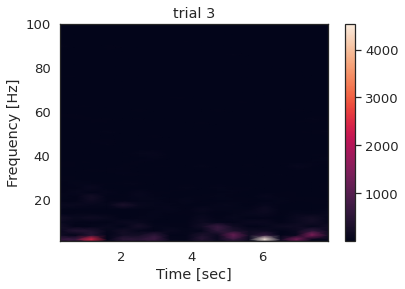

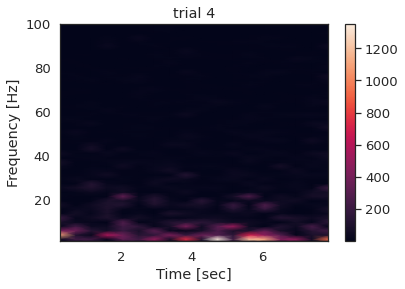

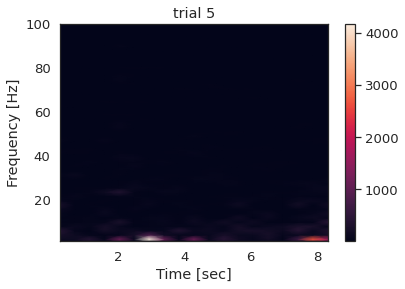

...

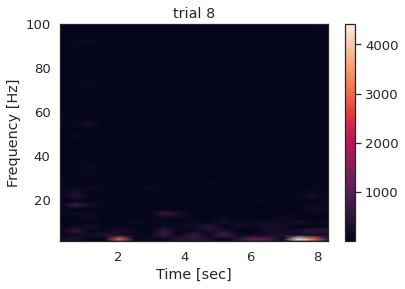

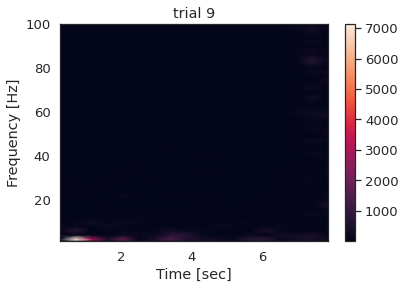

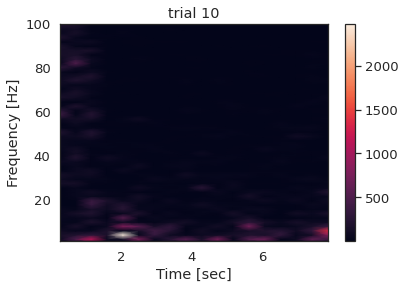

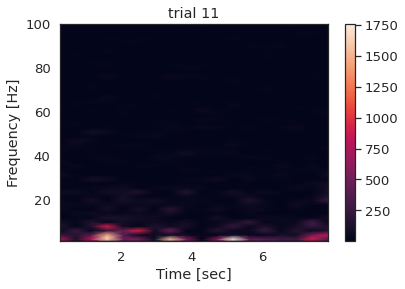

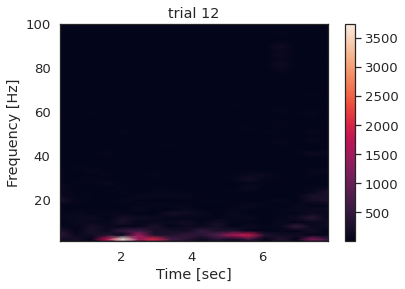

In [ ]:
# CP5
for x in range(12):
  spectrogram_plot(CP5[x], x+1)

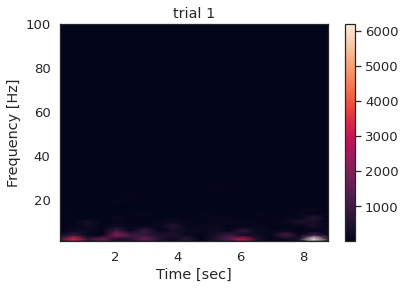

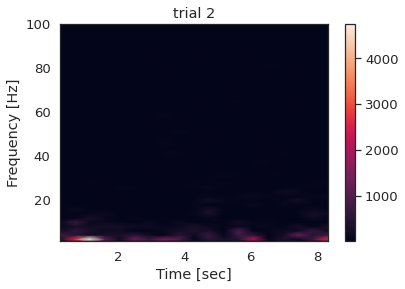

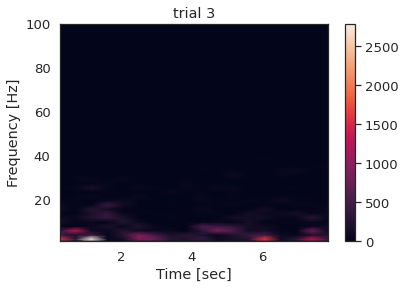

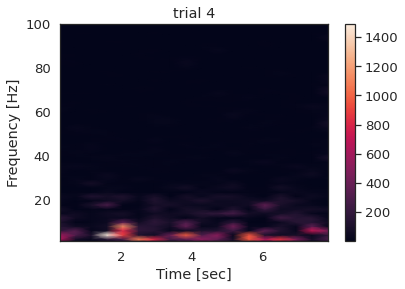

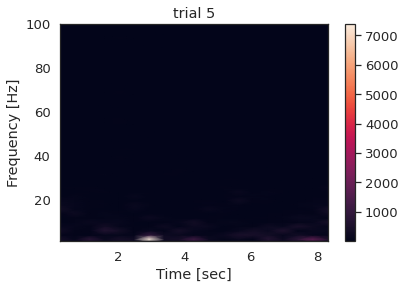

...

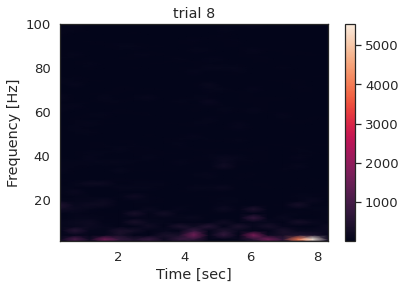

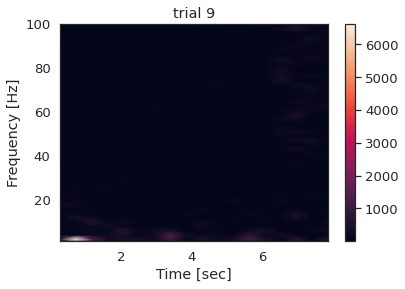

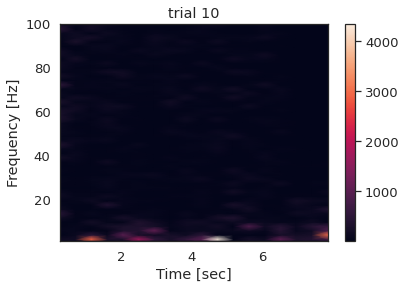

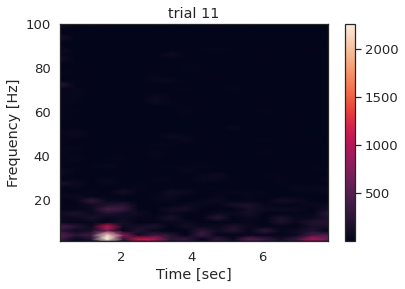

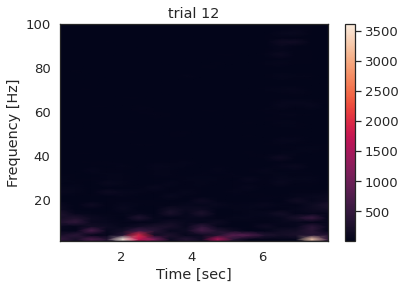

In [ ]:
# CP6
for x in range(12):
  spectrogram_plot(CP6[x], x+1)

# **Time and Frequency domain feature**

In [ ]:
def bandpower(data, sf, band, method='welch', window_sec=None, relative=False):
    from scipy.signal import welch
    from scipy.integrate import simps

    band = np.asarray(band)
    low, high = band

    # Compute the modified periodogram (Welch)
    if method == 'welch':
        if window_sec is not None:
            nperseg = window_sec * sf
        else:
            nperseg = (2 / low) * sf

        freqs, psd = welch(data, sf, nperseg=nperseg)

    # Frequency resolution
    freq_res = freqs[1] - freqs[0]

    # Find index of band in frequency vector
    idx_band = np.logical_and(freqs >= low, freqs <= high)

    # Integral approximation of the spectrum using parabola (Simpson's rule)
    bp = simps(psd[idx_band], dx=freq_res)

    if relative:
        bp /= simps(psd, dx=freq_res)
    return bp

In [ ]:
# calculate standard deviation of data in a given window size
def standard_deviation(data):
  import math
  import numpy as np
  length = len(data)
  sf = 500
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  std = [0] * length
  i = 0
  for x in range(length):
    std[x] = np.std(data[i:i+window])
    i = i + overlap
  return std

In [ ]:
# calculate mean absolute of data in a given window size
def mean_absolute(data):
  import math
  import numpy as np
  length = len(data)
  sf = 500
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  average = [0] * length
  i = 0
  for x in range(length):
    average[x] = np.mean(abs(data[i:i+window]))
    i = i + overlap
  return average

In [ ]:
# calculate variance of data in a given window size
def variance(data):
  import math
  import numpy as np
  length = len(data)
  sf = 500
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  var = [0] * length
  i = 0
  for x in range(length):
    var[x] = np.var(data[i:i+window])
    i = i + overlap
  return var

In [ ]:
# calculate bandpower of data in a given window size of 0.1s
def subbandpower_alpha(data):
  import math
  length = len(data)
  sf = 500
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  sbp = [0] * length
  i = 0
  for x in range(length):
    sbp[x] = bandpower(data[i:i+window], sf, [8, 12], 'welch')
    i = i + overlap
  return sbp

In [ ]:
# calculate bandpower of data in a given window size of 0.1s
def subbandpower_beta(data):
  import math
  length = len(data)
  sf = 500
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  sbp = [0] * length
  i = 0
  for x in range(length):
    sbp[x] = bandpower(data[i:i+window], sf, [12, 30], 'welch')
    i = i + overlap
  return sbp

In [ ]:
# calculate max power spectral density of data in a given window size of 0.1s
def max_psd(data):
  from scipy import signal
  import numpy as np
  import math
  length = len(data)
  sf = 500
  win = 0.5 * sf
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  psd_max = [0] * length
  i = 0

  for x in range(length):
    freqs, psd = signal.welch(data[i:i+window], sf, nperseg = win)

    # remove low frequency component (f < 1 Hz)
    for j in range(len(freqs)):
      if freqs[j] < 1:
        psd[j] = 0

    psd_max[x] = abs(np.max(psd))
    i = i + overlap
  
  return psd_max

In [ ]:
# calculate frequency of data with the peak amplitude in a given window size of 0.1s
def peak_frequency(data):
  from scipy.fft import fft, fftfreq
  import numpy as np
  import math
  length = len(data)
  sf = 500
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  peakf = [0] * length
  i = 0

  for x in range(length):
    amplitude = np.abs(fft(data[i:i+window]))
    frequency = fftfreq(len(data[i:i+window]), 1/sf)

    # remove low frequency component (f < 1 Hz)
    for j in range(len(frequency)):
      if frequency[j] < 1:
        amplitude[j] = 0

    max_amplitude = np.max(amplitude)
    location = 0
    for y in range(len(amplitude)):
      if (max_amplitude == amplitude[y]):
        location = y
        break
    peakf[x] = frequency[location]
    i = i + overlap
  
  return peakf

In [ ]:
# calculate spectral energy of data in a given window size of 0.1s
def spectral_energy(data):
  from scipy.fft import fft, fftfreq
  import numpy as np
  import math
  length = len(data)
  sf = 500
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  energy = [0] * length
  i = 0

  for x in range(length):
    amplitude = np.abs(fft(data[i:i+window]))
    frequency = fftfreq(len(data[i:i+window]), 1/sf)
    energy[x] = sum(np.square(amplitude))
    i = i + overlap
  
  return energy

In [ ]:
# calculate wavelet coefficients for discrete wavelet transform
def discrete_wavelet(data):
  import math
  import numpy as np
  import pywt
  length = len(data)
  sf = 500
  window = int(sf * 0.1)
  overlap = 10
  length = int((length - window) / overlap)
  averageA = [0] * length
  averageD = [0] * length
  i = 0
  for x in range(length):
    (cA, cD) = pywt.dwt(data[i:i+window], 'db1')
    averageA[x] = np.mean(abs(cA))
    averageD[x] = np.mean(abs(cD))
    # averageA[x] = np.sum(cA)
    # averageD[x] = np.sum(cD)
    i = i + overlap
  return averageA, averageD

In [ ]:
C3_rest = [C3_1[0:1143], C3_2[0:1228], C3_3[0:1142], C3_4[0:1141], C3_5[0:1262], C3_6[0:1141], C3_7[0:1212], C3_8[0:1221], C3_9[0:1147], C3_10[0:1149], C3_11[0:1187], C3_12[0:1189], C3_12_noisy[0:1189]]
C3_forward = [C3_1[1143:1841], C3_2[1228:1658], C3_3[1142:1536], C3_4[1141:1522], C3_5[1262:1647], C3_6[1141:1529], C3_7[1212:1555], C3_8[1221:1620], C3_9[1147:1475], C3_10[1149:1480], C3_11[1187:1499], C3_12[1189:1540], C3_12_noisy[1189:1540]]
C3_finger = [C3_1[1841:3734], C3_2[1658:3426], C3_3[1536:3336], C3_4[1522:3164], C3_5[1647:3333], C3_6[1529:3196], C3_7[1555:3277], C3_8[1620:3295], C3_9[1475:3188], C3_10[1480:3237], C3_11[1499:3334], C3_12[1540:3173], C3_12_noisy[1540:3173]]
C3_backward = [C3_1[3734:4037], C3_2[3426:3705], C3_3[3336:3625], C3_4[3164:3435], C3_5[3333:3569], C3_6[3196:3448], C3_7[3277:3541], C3_8[3295:3597], C3_9[3188:3496], C3_10[3237:3505], C3_11[3334:3622], C3_12[3173:3470], C3_12_noisy[3173:3470]]

C4_rest = [C4_1[0:1143], C4_2[0:1228], C4_3[0:1142], C4_4[0:1141], C4_5[0:1262], C4_6[0:1141], C4_7[0:1212], C4_8[0:1221], C4_9[0:1147], C4_10[0:1149], C4_11[0:1187], C4_12[0:1189], C4_12_noisy[0:1189]]
C4_forward = [C4_1[1143:1841], C4_2[1228:1658], C4_3[1142:1536], C4_4[1141:1522], C4_5[1262:1647], C4_6[1141:1529], C4_7[1212:1555], C4_8[1221:1620], C4_9[1147:1475], C4_10[1149:1480], C4_11[1187:1499], C4_12[1189:1540], C4_12_noisy[1189:1540]]
C4_finger = [C4_1[1841:3734], C4_2[1658:3426], C4_3[1536:3336], C4_4[1522:3164], C4_5[1647:3333], C4_6[1529:3196], C4_7[1555:3277], C4_8[1620:3295], C4_9[1475:3188], C4_10[1480:3237], C4_11[1499:3334], C4_12[1540:3173], C4_12_noisy[1540:3173]]
C4_backward = [C4_1[3734:4037], C4_2[3426:3705], C4_3[3336:3625], C4_4[3164:3435], C4_5[3333:3569], C4_6[3196:3448], C4_7[3277:3541], C4_8[3295:3597], C4_9[3188:3496], C4_10[3237:3505], C4_11[3334:3622], C4_12[3173:3470], C4_12_noisy[3173:3470]]

Cz_rest = [Cz_1[0:1143], Cz_2[0:1228], Cz_3[0:1142], Cz_4[0:1141], Cz_5[0:1262], Cz_6[0:1141], Cz_7[0:1212], Cz_8[0:1221], Cz_9[0:1147], Cz_10[0:1149], Cz_11[0:1187], Cz_12[0:1189], Cz_12_noisy[0:1189]]
Cz_forward = [Cz_1[1143:1841], Cz_2[1228:1658], Cz_3[1142:1536], Cz_4[1141:1522], Cz_5[1262:1647], Cz_6[1141:1529], Cz_7[1212:1555], Cz_8[1221:1620], Cz_9[1147:1475], Cz_10[1149:1480], Cz_11[1187:1499], Cz_12[1189:1540], Cz_12_noisy[1189:1540]]
Cz_finger = [Cz_1[1841:3734], Cz_2[1658:3426], Cz_3[1536:3336], Cz_4[1522:3164], Cz_5[1647:3333], Cz_6[1529:3196], Cz_7[1555:3277], Cz_8[1620:3295], Cz_9[1475:3188], Cz_10[1480:3237], Cz_11[1499:3334], Cz_12[1540:3173], Cz_12_noisy[1540:3173]]
Cz_backward = [Cz_1[3734:4037], Cz_2[3426:3705], Cz_3[3336:3625], Cz_4[3164:3435], Cz_5[3333:3569], Cz_6[3196:3448], Cz_7[3277:3541], Cz_8[3295:3597], Cz_9[3188:3496], Cz_10[3237:3505], Cz_11[3334:3622], Cz_12[3173:3470], Cz_12_noisy[3173:3470]]

CP1_rest = [CP1_1[0:1143], CP1_2[0:1228], CP1_3[0:1142], CP1_4[0:1141], CP1_5[0:1262], CP1_6[0:1141], CP1_7[0:1212], CP1_8[0:1221], CP1_9[0:1147], CP1_10[0:1149], CP1_11[0:1187], CP1_12[0:1189], CP1_12_noisy[0:1189]]
CP1_forward = [CP1_1[1143:1841], CP1_2[1228:1658], CP1_3[1142:1536], CP1_4[1141:1522], CP1_5[1262:1647], CP1_6[1141:1529], CP1_7[1212:1555], CP1_8[1221:1620], CP1_9[1147:1475], CP1_10[1149:1480], CP1_11[1187:1499], CP1_12[1189:1540], CP1_12_noisy[1189:1540]]
CP1_finger = [CP1_1[1841:3734], CP1_2[1658:3426], CP1_3[1536:3336], CP1_4[1522:3164], CP1_5[1647:3333], CP1_6[1529:3196], CP1_7[1555:3277], CP1_8[1620:3295], CP1_9[1475:3188], CP1_10[1480:3237], CP1_11[1499:3334], CP1_12[1540:3173], CP1_12_noisy[1540:3173]]
CP1_backward = [CP1_1[3734:4037], CP1_2[3426:3705], CP1_3[3336:3625], CP1_4[3164:3435], CP1_5[3333:3569], CP1_6[3196:3448], CP1_7[3277:3541], CP1_8[3295:3597], CP1_9[3188:3496], CP1_10[3237:3505], CP1_11[3334:3622], CP1_12[3173:3470], CP1_12_noisy[3173:3470]]

CP2_rest = [CP2_1[0:1143], CP2_2[0:1228], CP2_3[0:1142], CP2_4[0:1141], CP2_5[0:1262], CP2_6[0:1141], CP2_7[0:1212], CP2_8[0:1221], CP2_9[0:1147], CP2_10[0:1149], CP2_11[0:1187], CP2_12[0:1189], CP2_12_noisy[0:1189]]
CP2_forward = [CP2_1[1143:1841], CP2_2[1228:1658], CP2_3[1142:1536], CP2_4[1141:1522], CP2_5[1262:1647], CP2_6[1141:1529], CP2_7[1212:1555], CP2_8[1221:1620], CP2_9[1147:1475], CP2_10[1149:1480], CP2_11[1187:1499], CP2_12[1189:1540], CP2_12_noisy[1189:1540]]
CP2_finger = [CP2_1[1841:3734], CP2_2[1658:3426], CP2_3[1536:3336], CP2_4[1522:3164], CP2_5[1647:3333], CP2_6[1529:3196], CP2_7[1555:3277], CP2_8[1620:3295], CP2_9[1475:3188], CP2_10[1480:3237], CP2_11[1499:3334], CP2_12[1540:3173], CP2_12_noisy[1540:3173]]
CP2_backward = [CP2_1[3734:4037], CP2_2[3426:3705], CP2_3[3336:3625], CP2_4[3164:3435], CP2_5[3333:3569], CP2_6[3196:3448], CP2_7[3277:3541], CP2_8[3295:3597], CP2_9[3188:3496], CP2_10[3237:3505], CP2_11[3334:3622], CP2_12[3173:3470], CP2_12_noisy[3173:3470]]

CP5_rest = [CP5_1[0:1143], CP5_2[0:1228], CP5_3[0:1142], CP5_4[0:1141], CP5_5[0:1262], CP5_6[0:1141], CP5_7[0:1212], CP5_8[0:1221], CP5_9[0:1147], CP5_10[0:1149], CP5_11[0:1187], CP5_12[0:1189], CP5_12_noisy[0:1189]]
CP5_forward = [CP5_1[1143:1841], CP5_2[1228:1658], CP5_3[1142:1536], CP5_4[1141:1522], CP5_5[1262:1647], CP5_6[1141:1529], CP5_7[1212:1555], CP5_8[1221:1620], CP5_9[1147:1475], CP5_10[1149:1480], CP5_11[1187:1499], CP5_12[1189:1540], CP5_12_noisy[1189:1540]]
CP5_finger = [CP5_1[1841:3734], CP5_2[1658:3426], CP5_3[1536:3336], CP5_4[1522:3164], CP5_5[1647:3333], CP5_6[1529:3196], CP5_7[1555:3277], CP5_8[1620:3295], CP5_9[1475:3188], CP5_10[1480:3237], CP5_11[1499:3334], CP5_12[1540:3173], CP5_12_noisy[1540:3173]]
CP5_backward = [CP5_1[3734:4037], CP5_2[3426:3705], CP5_3[3336:3625], CP5_4[3164:3435], CP5_5[3333:3569], CP5_6[3196:3448], CP5_7[3277:3541], CP5_8[3295:3597], CP5_9[3188:3496], CP5_10[3237:3505], CP5_11[3334:3622], CP5_12[3173:3470], CP5_12_noisy[3173:3470]]

CP6_rest = [CP6_1[0:1143], CP6_2[0:1228], CP6_3[0:1142], CP6_4[0:1141], CP6_5[0:1262], CP6_6[0:1141], CP6_7[0:1212], CP6_8[0:1221], CP6_9[0:1147], CP6_10[0:1149], CP6_11[0:1187], CP6_12[0:1189], CP6_12_noisy[0:1189]]
CP6_forward = [CP6_1[1143:1841], CP6_2[1228:1658], CP6_3[1142:1536], CP6_4[1141:1522], CP6_5[1262:1647], CP6_6[1141:1529], CP6_7[1212:1555], CP6_8[1221:1620], CP6_9[1147:1475], CP6_10[1149:1480], CP6_11[1187:1499], CP6_12[1189:1540], CP6_12_noisy[1189:1540]]
CP6_finger = [CP6_1[1841:3734], CP6_2[1658:3426], CP6_3[1536:3336], CP6_4[1522:3164], CP6_5[1647:3333], CP6_6[1529:3196], CP6_7[1555:3277], CP6_8[1620:3295], CP6_9[1475:3188], CP6_10[1480:3237], CP6_11[1499:3334], CP6_12[1540:3173], CP6_12_noisy[1540:3173]]
CP6_backward = [CP6_1[3734:4037], CP6_2[3426:3705], CP6_3[3336:3625], CP6_4[3164:3435], CP6_5[3333:3569], CP6_6[3196:3448], CP6_7[3277:3541], CP6_8[3295:3597], CP6_9[3188:3496], CP6_10[3237:3505], CP6_11[3334:3622], CP6_12[3173:3470], CP6_12_noisy[3173:3470]]

In [ ]:
C3_rest_alphapower = []
C3_forward_alphapower = []
C3_finger_alphapower = []
C3_backward_alphapower = []
C3_rest_betapower = []
C3_forward_betapower = []
C3_finger_betapower = []
C3_backward_betapower = []
C3_rest_maxpsd = []
C3_forward_maxpsd = []
C3_finger_maxpsd = []
C3_backward_maxpsd = []
C3_rest_peakf = []
C3_forward_peakf = []
C3_finger_peakf = []
C3_backward_peakf = []
C3_rest_se = []
C3_forward_se = []
C3_finger_se = []
C3_backward_se = []
C3_rest_std = []
C3_forward_std = []
C3_finger_std = []
C3_backward_std = []
C3_rest_mean = []
C3_forward_mean = []
C3_finger_mean = []
C3_backward_mean = []
C3_rest_var = []
C3_forward_var = []
C3_finger_var = []
C3_backward_var = []
C3_rest_cA = []
C3_forward_cA = []
C3_finger_cA = []
C3_backward_cA = []
C3_rest_cD = []
C3_forward_cD = []
C3_finger_cD = []
C3_backward_cD = []

C4_rest_alphapower = []
C4_forward_alphapower = []
C4_finger_alphapower = []
C4_backward_alphapower = []
C4_rest_betapower = []
C4_forward_betapower = []
C4_finger_betapower = []
C4_backward_betapower = []
C4_rest_maxpsd = []
C4_forward_maxpsd = []
C4_finger_maxpsd = []
C4_backward_maxpsd = []
C4_rest_peakf = []
C4_forward_peakf = []
C4_finger_peakf = []
C4_backward_peakf = []
C4_rest_se = []
C4_forward_se = []
C4_finger_se = []
C4_backward_se = []
C4_rest_std = []
C4_forward_std = []
C4_finger_std = []
C4_backward_std = []
C4_rest_mean = []
C4_forward_mean = []
C4_finger_mean = []
C4_backward_mean = []
C4_rest_var = []
C4_forward_var = []
C4_finger_var = []
C4_backward_var = []
C4_rest_cA = []
C4_forward_cA = []
C4_finger_cA = []
C4_backward_cA = []
C4_rest_cD = []
C4_forward_cD = []
C4_finger_cD = []
C4_backward_cD = []

Cz_rest_alphapower = []
Cz_forward_alphapower = []
Cz_finger_alphapower = []
Cz_backward_alphapower = []
Cz_rest_betapower = []
Cz_forward_betapower = []
Cz_finger_betapower = []
Cz_backward_betapower = []
Cz_rest_maxpsd = []
Cz_forward_maxpsd = []
Cz_finger_maxpsd = []
Cz_backward_maxpsd = []
Cz_rest_peakf = []
Cz_forward_peakf = []
Cz_finger_peakf = []
Cz_backward_peakf = []
Cz_rest_se = []
Cz_forward_se = []
Cz_finger_se = []
Cz_backward_se = []
Cz_rest_std = []
Cz_forward_std = []
Cz_finger_std = []
Cz_backward_std = []
Cz_rest_mean = []
Cz_forward_mean = []
Cz_finger_mean = []
Cz_backward_mean = []
Cz_rest_var = []
Cz_forward_var = []
Cz_finger_var = []
Cz_backward_var = []
Cz_rest_cA = []
Cz_forward_cA = []
Cz_finger_cA = []
Cz_backward_cA = []
Cz_rest_cD = []
Cz_forward_cD = []
Cz_finger_cD = []
Cz_backward_cD = []

CP1_rest_alphapower = []
CP1_forward_alphapower = []
CP1_finger_alphapower = []
CP1_backward_alphapower = []
CP1_rest_betapower = []
CP1_forward_betapower = []
CP1_finger_betapower = []
CP1_backward_betapower = []
CP1_rest_maxpsd = []
CP1_forward_maxpsd = []
CP1_finger_maxpsd = []
CP1_backward_maxpsd = []
CP1_rest_peakf = []
CP1_forward_peakf = []
CP1_finger_peakf = []
CP1_backward_peakf = []
CP1_rest_se = []
CP1_forward_se = []
CP1_finger_se = []
CP1_backward_se = []
CP1_rest_std = []
CP1_forward_std = []
CP1_finger_std = []
CP1_backward_std = []
CP1_rest_mean = []
CP1_forward_mean = []
CP1_finger_mean = []
CP1_backward_mean = []
CP1_rest_var = []
CP1_forward_var = []
CP1_finger_var = []
CP1_backward_var = []
CP1_rest_cA = []
CP1_forward_cA = []
CP1_finger_cA = []
CP1_backward_cA = []
CP1_rest_cD = []
CP1_forward_cD = []
CP1_finger_cD = []
CP1_backward_cD = []

CP2_rest_alphapower = []
CP2_forward_alphapower = []
CP2_finger_alphapower = []
CP2_backward_alphapower = []
CP2_rest_betapower = []
CP2_forward_betapower = []
CP2_finger_betapower = []
CP2_backward_betapower = []
CP2_rest_maxpsd = []
CP2_forward_maxpsd = []
CP2_finger_maxpsd = []
CP2_backward_maxpsd = []
CP2_rest_peakf = []
CP2_forward_peakf = []
CP2_finger_peakf = []
CP2_backward_peakf = []
CP2_rest_se = []
CP2_forward_se = []
CP2_finger_se = []
CP2_backward_se = []
CP2_rest_std = []
CP2_forward_std = []
CP2_finger_std = []
CP2_backward_std = []
CP2_rest_mean = []
CP2_forward_mean = []
CP2_finger_mean = []
CP2_backward_mean = []
CP2_rest_var = []
CP2_forward_var = []
CP2_finger_var = []
CP2_backward_var = []
CP2_rest_cA = []
CP2_forward_cA = []
CP2_finger_cA = []
CP2_backward_cA = []
CP2_rest_cD = []
CP2_forward_cD = []
CP2_finger_cD = []
CP2_backward_cD = []

CP5_rest_alphapower = []
CP5_forward_alphapower = []
CP5_finger_alphapower = []
CP5_backward_alphapower = []
CP5_rest_betapower = []
CP5_forward_betapower = []
CP5_finger_betapower = []
CP5_backward_betapower = []
CP5_rest_maxpsd = []
CP5_forward_maxpsd = []
CP5_finger_maxpsd = []
CP5_backward_maxpsd = []
CP5_rest_peakf = []
CP5_forward_peakf = []
CP5_finger_peakf = []
CP5_backward_peakf = []
CP5_rest_se = []
CP5_forward_se = []
CP5_finger_se = []
CP5_backward_se = []
CP5_rest_std = []
CP5_forward_std = []
CP5_finger_std = []
CP5_backward_std = []
CP5_rest_mean = []
CP5_forward_mean = []
CP5_finger_mean = []
CP5_backward_mean = []
CP5_rest_var = []
CP5_forward_var = []
CP5_finger_var = []
CP5_backward_var = []
CP5_rest_cA = []
CP5_forward_cA = []
CP5_finger_cA = []
CP5_backward_cA = []
CP5_rest_cD = []
CP5_forward_cD = []
CP5_finger_cD = []
CP5_backward_cD = []

CP6_rest_alphapower = []
CP6_forward_alphapower = []
CP6_finger_alphapower = []
CP6_backward_alphapower = []
CP6_rest_betapower = []
CP6_forward_betapower = []
CP6_finger_betapower = []
CP6_backward_betapower = []
CP6_rest_maxpsd = []
CP6_forward_maxpsd = []
CP6_finger_maxpsd = []
CP6_backward_maxpsd = []
CP6_rest_peakf = []
CP6_forward_peakf = []
CP6_finger_peakf = []
CP6_backward_peakf = []
CP6_rest_se = []
CP6_forward_se = []
CP6_finger_se = []
CP6_backward_se = []
CP6_rest_std = []
CP6_forward_std = []
CP6_finger_std = []
CP6_backward_std = []
CP6_rest_mean = []
CP6_forward_mean = []
CP6_finger_mean = []
CP6_backward_mean = []
CP6_rest_var = []
CP6_forward_var = []
CP6_finger_var = []
CP6_backward_var = []
CP6_rest_cA = []
CP6_forward_cA = []
CP6_finger_cA = []
CP6_backward_cA = []
CP6_rest_cD = []
CP6_forward_cD = []
CP6_finger_cD = []
CP6_backward_cD = []

for x in range(13):
  C3_rest_alphapower.extend(subbandpower_alpha(C3_rest[x]))
  C3_forward_alphapower.extend(subbandpower_alpha(C3_forward[x]))
  C3_finger_alphapower.extend(subbandpower_alpha(C3_finger[x]))
  C3_backward_alphapower.extend(subbandpower_alpha(C3_backward[x]))
  C3_rest_betapower.extend(subbandpower_beta(C3_rest[x]))
  C3_forward_betapower.extend(subbandpower_beta(C3_forward[x]))
  C3_finger_betapower.extend(subbandpower_beta(C3_finger[x]))
  C3_backward_betapower.extend(subbandpower_beta(C3_backward[x]))
  C3_rest_maxpsd.extend(max_psd(C3_rest[x]))
  C3_forward_maxpsd.extend(max_psd(C3_forward[x]))
  C3_finger_maxpsd.extend(max_psd(C3_finger[x]))
  C3_backward_maxpsd.extend(max_psd(C3_backward[x]))
  C3_rest_peakf.extend(peak_frequency(C3_rest[x]))
  C3_forward_peakf.extend(peak_frequency(C3_forward[x]))
  C3_finger_peakf.extend(peak_frequency(C3_finger[x]))
  C3_backward_peakf.extend(peak_frequency(C3_backward[x]))
  C3_rest_se.extend(spectral_energy(C3_rest[x]))
  C3_forward_se.extend(spectral_energy(C3_forward[x]))
  C3_finger_se.extend(spectral_energy(C3_finger[x]))
  C3_backward_se.extend(spectral_energy(C3_backward[x]))
  C3_rest_std.extend(standard_deviation(C3_rest[x]))
  C3_forward_std.extend(standard_deviation(C3_forward[x]))
  C3_finger_std.extend(standard_deviation(C3_finger[x]))
  C3_backward_std.extend(standard_deviation(C3_backward[x]))
  C3_rest_mean.extend(mean_absolute(C3_rest[x]))
  C3_forward_mean.extend(mean_absolute(C3_forward[x]))
  C3_finger_mean.extend(mean_absolute(C3_finger[x]))
  C3_backward_mean.extend(mean_absolute(C3_backward[x]))
  C3_rest_var.extend(variance(C3_rest[x]))
  C3_forward_var.extend(variance(C3_forward[x]))
  C3_finger_var.extend(variance(C3_finger[x]))
  C3_backward_var.extend(variance(C3_backward[x]))
  tempA, tempD = discrete_wavelet(C3_rest[x])
  C3_rest_cA.extend(tempA)
  C3_rest_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(C3_forward[x])
  C3_forward_cA.extend(tempA)
  C3_forward_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(C3_finger[x])
  C3_finger_cA.extend(tempA)
  C3_finger_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(C3_backward[x])
  C3_backward_cA.extend(tempA)
  C3_backward_cD.extend(tempD)

  C4_rest_alphapower.extend(subbandpower_alpha(C4_rest[x]))
  C4_forward_alphapower.extend(subbandpower_alpha(C4_forward[x]))
  C4_finger_alphapower.extend(subbandpower_alpha(C4_finger[x]))
  C4_backward_alphapower.extend(subbandpower_alpha(C4_backward[x]))
  C4_rest_betapower.extend(subbandpower_beta(C4_rest[x]))
  C4_forward_betapower.extend(subbandpower_beta(C4_forward[x]))
  C4_finger_betapower.extend(subbandpower_beta(C4_finger[x]))
  C4_backward_betapower.extend(subbandpower_beta(C4_backward[x]))
  C4_rest_maxpsd.extend(max_psd(C4_rest[x]))
  C4_forward_maxpsd.extend(max_psd(C4_forward[x]))
  C4_finger_maxpsd.extend(max_psd(C4_finger[x]))
  C4_backward_maxpsd.extend(max_psd(C4_backward[x]))
  C4_rest_peakf.extend(peak_frequency(C4_rest[x]))
  C4_forward_peakf.extend(peak_frequency(C4_forward[x]))
  C4_finger_peakf.extend(peak_frequency(C4_finger[x]))
  C4_backward_peakf.extend(peak_frequency(C4_backward[x]))
  C4_rest_se.extend(spectral_energy(C4_rest[x]))
  C4_forward_se.extend(spectral_energy(C4_forward[x]))
  C4_finger_se.extend(spectral_energy(C4_finger[x]))
  C4_backward_se.extend(spectral_energy(C4_backward[x]))
  C4_rest_std.extend(standard_deviation(C4_rest[x]))
  C4_forward_std.extend(standard_deviation(C4_forward[x]))
  C4_finger_std.extend(standard_deviation(C4_finger[x]))
  C4_backward_std.extend(standard_deviation(C4_backward[x]))
  C4_rest_mean.extend(mean_absolute(C4_rest[x]))
  C4_forward_mean.extend(mean_absolute(C4_forward[x]))
  C4_finger_mean.extend(mean_absolute(C4_finger[x]))
  C4_backward_mean.extend(mean_absolute(C4_backward[x]))
  C4_rest_var.extend(variance(C4_rest[x]))
  C4_forward_var.extend(variance(C4_forward[x]))
  C4_finger_var.extend(variance(C4_finger[x]))
  C4_backward_var.extend(variance(C4_backward[x]))
  tempA, tempD = discrete_wavelet(C4_rest[x])
  C4_rest_cA.extend(tempA)
  C4_rest_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(C4_forward[x])
  C4_forward_cA.extend(tempA)
  C4_forward_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(C4_finger[x])
  C4_finger_cA.extend(tempA)
  C4_finger_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(C4_backward[x])
  C4_backward_cA.extend(tempA)
  C4_backward_cD.extend(tempD)

  Cz_rest_alphapower.extend(subbandpower_alpha(Cz_rest[x]))
  Cz_forward_alphapower.extend(subbandpower_alpha(Cz_forward[x]))
  Cz_finger_alphapower.extend(subbandpower_alpha(Cz_finger[x]))
  Cz_backward_alphapower.extend(subbandpower_alpha(Cz_backward[x]))
  Cz_rest_betapower.extend(subbandpower_beta(Cz_rest[x]))
  Cz_forward_betapower.extend(subbandpower_beta(Cz_forward[x]))
  Cz_finger_betapower.extend(subbandpower_beta(Cz_finger[x]))
  Cz_backward_betapower.extend(subbandpower_beta(Cz_backward[x]))
  Cz_rest_maxpsd.extend(max_psd(Cz_rest[x]))
  Cz_forward_maxpsd.extend(max_psd(Cz_forward[x]))
  Cz_finger_maxpsd.extend(max_psd(Cz_finger[x]))
  Cz_backward_maxpsd.extend(max_psd(Cz_backward[x]))
  Cz_rest_peakf.extend(peak_frequency(Cz_rest[x]))
  Cz_forward_peakf.extend(peak_frequency(Cz_forward[x]))
  Cz_finger_peakf.extend(peak_frequency(Cz_finger[x]))
  Cz_backward_peakf.extend(peak_frequency(Cz_backward[x]))
  Cz_rest_se.extend(spectral_energy(Cz_rest[x]))
  Cz_forward_se.extend(spectral_energy(Cz_forward[x]))
  Cz_finger_se.extend(spectral_energy(Cz_finger[x]))
  Cz_backward_se.extend(spectral_energy(Cz_backward[x]))
  Cz_rest_std.extend(standard_deviation(Cz_rest[x]))
  Cz_forward_std.extend(standard_deviation(Cz_forward[x]))
  Cz_finger_std.extend(standard_deviation(Cz_finger[x]))
  Cz_backward_std.extend(standard_deviation(Cz_backward[x]))
  Cz_rest_mean.extend(mean_absolute(Cz_rest[x]))
  Cz_forward_mean.extend(mean_absolute(Cz_forward[x]))
  Cz_finger_mean.extend(mean_absolute(Cz_finger[x]))
  Cz_backward_mean.extend(mean_absolute(Cz_backward[x]))
  Cz_rest_var.extend(variance(Cz_rest[x]))
  Cz_forward_var.extend(variance(Cz_forward[x]))
  Cz_finger_var.extend(variance(Cz_finger[x]))
  Cz_backward_var.extend(variance(Cz_backward[x]))
  tempA, tempD = discrete_wavelet(Cz_rest[x])
  Cz_rest_cA.extend(tempA)
  Cz_rest_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(Cz_forward[x])
  Cz_forward_cA.extend(tempA)
  Cz_forward_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(Cz_finger[x])
  Cz_finger_cA.extend(tempA)
  Cz_finger_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(Cz_backward[x])
  Cz_backward_cA.extend(tempA)
  Cz_backward_cD.extend(tempD)

  CP1_rest_alphapower.extend(subbandpower_alpha(CP1_rest[x]))
  CP1_forward_alphapower.extend(subbandpower_alpha(CP1_forward[x]))
  CP1_finger_alphapower.extend(subbandpower_alpha(CP1_finger[x]))
  CP1_backward_alphapower.extend(subbandpower_alpha(CP1_backward[x]))
  CP1_rest_betapower.extend(subbandpower_beta(CP1_rest[x]))
  CP1_forward_betapower.extend(subbandpower_beta(CP1_forward[x]))
  CP1_finger_betapower.extend(subbandpower_beta(CP1_finger[x]))
  CP1_backward_betapower.extend(subbandpower_beta(CP1_backward[x]))
  CP1_rest_maxpsd.extend(max_psd(CP1_rest[x]))
  CP1_forward_maxpsd.extend(max_psd(CP1_forward[x]))
  CP1_finger_maxpsd.extend(max_psd(CP1_finger[x]))
  CP1_backward_maxpsd.extend(max_psd(CP1_backward[x]))
  CP1_rest_peakf.extend(peak_frequency(CP1_rest[x]))
  CP1_forward_peakf.extend(peak_frequency(CP1_forward[x]))
  CP1_finger_peakf.extend(peak_frequency(CP1_finger[x]))
  CP1_backward_peakf.extend(peak_frequency(CP1_backward[x]))
  CP1_rest_se.extend(spectral_energy(CP1_rest[x]))
  CP1_forward_se.extend(spectral_energy(CP1_forward[x]))
  CP1_finger_se.extend(spectral_energy(CP1_finger[x]))
  CP1_backward_se.extend(spectral_energy(CP1_backward[x]))
  CP1_rest_std.extend(standard_deviation(CP1_rest[x]))
  CP1_forward_std.extend(standard_deviation(CP1_forward[x]))
  CP1_finger_std.extend(standard_deviation(CP1_finger[x]))
  CP1_backward_std.extend(standard_deviation(CP1_backward[x]))
  CP1_rest_mean.extend(mean_absolute(CP1_rest[x]))
  CP1_forward_mean.extend(mean_absolute(CP1_forward[x]))
  CP1_finger_mean.extend(mean_absolute(CP1_finger[x]))
  CP1_backward_mean.extend(mean_absolute(CP1_backward[x]))
  CP1_rest_var.extend(variance(CP1_rest[x]))
  CP1_forward_var.extend(variance(CP1_forward[x]))
  CP1_finger_var.extend(variance(CP1_finger[x]))
  CP1_backward_var.extend(variance(CP1_backward[x]))
  tempA, tempD = discrete_wavelet(CP1_rest[x])
  CP1_rest_cA.extend(tempA)
  CP1_rest_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP1_forward[x])
  CP1_forward_cA.extend(tempA)
  CP1_forward_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP1_finger[x])
  CP1_finger_cA.extend(tempA)
  CP1_finger_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP1_backward[x])
  CP1_backward_cA.extend(tempA)
  CP1_backward_cD.extend(tempD)

  CP2_rest_alphapower.extend(subbandpower_alpha(CP2_rest[x]))
  CP2_forward_alphapower.extend(subbandpower_alpha(CP2_forward[x]))
  CP2_finger_alphapower.extend(subbandpower_alpha(CP2_finger[x]))
  CP2_backward_alphapower.extend(subbandpower_alpha(CP2_backward[x]))
  CP2_rest_betapower.extend(subbandpower_beta(CP2_rest[x]))
  CP2_forward_betapower.extend(subbandpower_beta(CP2_forward[x]))
  CP2_finger_betapower.extend(subbandpower_beta(CP2_finger[x]))
  CP2_backward_betapower.extend(subbandpower_beta(CP2_backward[x]))
  CP2_rest_maxpsd.extend(max_psd(CP2_rest[x]))
  CP2_forward_maxpsd.extend(max_psd(CP2_forward[x]))
  CP2_finger_maxpsd.extend(max_psd(CP2_finger[x]))
  CP2_backward_maxpsd.extend(max_psd(CP2_backward[x]))
  CP2_rest_peakf.extend(peak_frequency(CP2_rest[x]))
  CP2_forward_peakf.extend(peak_frequency(CP2_forward[x]))
  CP2_finger_peakf.extend(peak_frequency(CP2_finger[x]))
  CP2_backward_peakf.extend(peak_frequency(CP2_backward[x]))
  CP2_rest_se.extend(spectral_energy(CP2_rest[x]))
  CP2_forward_se.extend(spectral_energy(CP2_forward[x]))
  CP2_finger_se.extend(spectral_energy(CP2_finger[x]))
  CP2_backward_se.extend(spectral_energy(CP2_backward[x]))
  CP2_rest_std.extend(standard_deviation(CP2_rest[x]))
  CP2_forward_std.extend(standard_deviation(CP2_forward[x]))
  CP2_finger_std.extend(standard_deviation(CP2_finger[x]))
  CP2_backward_std.extend(standard_deviation(CP2_backward[x]))
  CP2_rest_mean.extend(mean_absolute(CP2_rest[x]))
  CP2_forward_mean.extend(mean_absolute(CP2_forward[x]))
  CP2_finger_mean.extend(mean_absolute(CP2_finger[x]))
  CP2_backward_mean.extend(mean_absolute(CP2_backward[x]))
  CP2_rest_var.extend(variance(CP2_rest[x]))
  CP2_forward_var.extend(variance(CP2_forward[x]))
  CP2_finger_var.extend(variance(CP2_finger[x]))
  CP2_backward_var.extend(variance(CP2_backward[x]))
  tempA, tempD = discrete_wavelet(CP2_rest[x])
  CP2_rest_cA.extend(tempA)
  CP2_rest_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP2_forward[x])
  CP2_forward_cA.extend(tempA)
  CP2_forward_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP2_finger[x])
  CP2_finger_cA.extend(tempA)
  CP2_finger_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP2_backward[x])
  CP2_backward_cA.extend(tempA)
  CP2_backward_cD.extend(tempD)

  CP5_rest_alphapower.extend(subbandpower_alpha(CP5_rest[x]))
  CP5_forward_alphapower.extend(subbandpower_alpha(CP5_forward[x]))
  CP5_finger_alphapower.extend(subbandpower_alpha(CP5_finger[x]))
  CP5_backward_alphapower.extend(subbandpower_alpha(CP5_backward[x]))
  CP5_rest_betapower.extend(subbandpower_beta(CP5_rest[x]))
  CP5_forward_betapower.extend(subbandpower_beta(CP5_forward[x]))
  CP5_finger_betapower.extend(subbandpower_beta(CP5_finger[x]))
  CP5_backward_betapower.extend(subbandpower_beta(CP5_backward[x]))
  CP5_rest_maxpsd.extend(max_psd(CP5_rest[x]))
  CP5_forward_maxpsd.extend(max_psd(CP5_forward[x]))
  CP5_finger_maxpsd.extend(max_psd(CP5_finger[x]))
  CP5_backward_maxpsd.extend(max_psd(CP5_backward[x]))
  CP5_rest_peakf.extend(peak_frequency(CP5_rest[x]))
  CP5_forward_peakf.extend(peak_frequency(CP5_forward[x]))
  CP5_finger_peakf.extend(peak_frequency(CP5_finger[x]))
  CP5_backward_peakf.extend(peak_frequency(CP5_backward[x]))
  CP5_rest_se.extend(spectral_energy(CP5_rest[x]))
  CP5_forward_se.extend(spectral_energy(CP5_forward[x]))
  CP5_finger_se.extend(spectral_energy(CP5_finger[x]))
  CP5_backward_se.extend(spectral_energy(CP5_backward[x]))
  CP5_rest_std.extend(standard_deviation(CP5_rest[x]))
  CP5_forward_std.extend(standard_deviation(CP5_forward[x]))
  CP5_finger_std.extend(standard_deviation(CP5_finger[x]))
  CP5_backward_std.extend(standard_deviation(CP5_backward[x]))
  CP5_rest_mean.extend(mean_absolute(CP5_rest[x]))
  CP5_forward_mean.extend(mean_absolute(CP5_forward[x]))
  CP5_finger_mean.extend(mean_absolute(CP5_finger[x]))
  CP5_backward_mean.extend(mean_absolute(CP5_backward[x]))
  CP5_rest_var.extend(variance(CP5_rest[x]))
  CP5_forward_var.extend(variance(CP5_forward[x]))
  CP5_finger_var.extend(variance(CP5_finger[x]))
  CP5_backward_var.extend(variance(CP5_backward[x]))
  tempA, tempD = discrete_wavelet(CP5_rest[x])
  CP5_rest_cA.extend(tempA)
  CP5_rest_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP5_forward[x])
  CP5_forward_cA.extend(tempA)
  CP5_forward_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP5_finger[x])
  CP5_finger_cA.extend(tempA)
  CP5_finger_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP5_backward[x])
  CP5_backward_cA.extend(tempA)
  CP5_backward_cD.extend(tempD)

  CP6_rest_alphapower.extend(subbandpower_alpha(CP6_rest[x]))
  CP6_forward_alphapower.extend(subbandpower_alpha(CP6_forward[x]))
  CP6_finger_alphapower.extend(subbandpower_alpha(CP6_finger[x]))
  CP6_backward_alphapower.extend(subbandpower_alpha(CP6_backward[x]))
  CP6_rest_betapower.extend(subbandpower_beta(CP6_rest[x]))
  CP6_forward_betapower.extend(subbandpower_beta(CP6_forward[x]))
  CP6_finger_betapower.extend(subbandpower_beta(CP6_finger[x]))
  CP6_backward_betapower.extend(subbandpower_beta(CP6_backward[x]))
  CP6_rest_maxpsd.extend(max_psd(CP6_rest[x]))
  CP6_forward_maxpsd.extend(max_psd(CP6_forward[x]))
  CP6_finger_maxpsd.extend(max_psd(CP6_finger[x]))
  CP6_backward_maxpsd.extend(max_psd(CP6_backward[x]))
  CP6_rest_peakf.extend(peak_frequency(CP6_rest[x]))
  CP6_forward_peakf.extend(peak_frequency(CP6_forward[x]))
  CP6_finger_peakf.extend(peak_frequency(CP6_finger[x]))
  CP6_backward_peakf.extend(peak_frequency(CP6_backward[x]))
  CP6_rest_se.extend(spectral_energy(CP6_rest[x]))
  CP6_forward_se.extend(spectral_energy(CP6_forward[x]))
  CP6_finger_se.extend(spectral_energy(CP6_finger[x]))
  CP6_backward_se.extend(spectral_energy(CP6_backward[x]))
  CP6_rest_std.extend(standard_deviation(CP6_rest[x]))
  CP6_forward_std.extend(standard_deviation(CP6_forward[x]))
  CP6_finger_std.extend(standard_deviation(CP6_finger[x]))
  CP6_backward_std.extend(standard_deviation(CP6_backward[x]))
  CP6_rest_mean.extend(mean_absolute(CP6_rest[x]))
  CP6_forward_mean.extend(mean_absolute(CP6_forward[x]))
  CP6_finger_mean.extend(mean_absolute(CP6_finger[x]))
  CP6_backward_mean.extend(mean_absolute(CP6_backward[x]))
  CP6_rest_var.extend(variance(CP6_rest[x]))
  CP6_forward_var.extend(variance(CP6_forward[x]))
  CP6_finger_var.extend(variance(CP6_finger[x]))
  CP6_backward_var.extend(variance(CP6_backward[x]))
  tempA, tempD = discrete_wavelet(CP6_rest[x])
  CP6_rest_cA.extend(tempA)
  CP6_rest_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP6_forward[x])
  CP6_forward_cA.extend(tempA)
  CP6_forward_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP6_finger[x])
  CP6_finger_cA.extend(tempA)
  CP6_finger_cD.extend(tempD)
  tempA, tempD = discrete_wavelet(CP6_backward[x])
  CP6_backward_cA.extend(tempA)
  CP6_backward_cD.extend(tempD)

/usr/local/lib/python3.7/dist-packages/scipy/signal/spectral.py:1966: UserWarning: nperseg = 125 is greater than input length  = 50, using nperseg = 50
  .format(nperseg, input_length))
/usr/local/lib/python3.7/dist-packages/scipy/signal/spectral.py:1966: UserWarning: nperseg = 83 is greater than input length  = 50, using nperseg = 50
  .format(nperseg, input_length))
/usr/local/lib/python3.7/dist-packages/scipy/signal/spectral.py:1966: UserWarning: nperseg = 250 is greater than input length  = 50, using nperseg = 50
  .format(nperseg, input_length))


In [ ]:
length_rest_noisy = 1351
length_forward_noisy = 409
length_finger_noisy = 2014
length_backward_noisy = 269

# length_rest = 1238
# length_forward = 379
# length_finger = 1856
# length_backward = 245

length_rest = 1351
length_forward = 409
length_finger = 2014
length_backward = 269

In [ ]:
C3_alphapower = np.concatenate((C3_rest_alphapower[0:length_rest], C3_forward_alphapower[0:length_forward], C3_finger_alphapower[0:length_finger], C3_backward_alphapower[0:length_backward]))
C3_betapower = np.concatenate((C3_rest_betapower[0:length_rest], C3_forward_betapower[0:length_forward], C3_finger_betapower[0:length_finger], C3_backward_betapower[0:length_backward]))
C3_maxpsd = np.concatenate((C3_rest_maxpsd[0:length_rest], C3_forward_maxpsd[0:length_forward], C3_finger_maxpsd[0:length_finger], C3_backward_maxpsd[0:length_backward]))
C3_peakf = np.concatenate((C3_rest_peakf[0:length_rest], C3_forward_peakf[0:length_forward], C3_finger_peakf[0:length_finger], C3_backward_peakf[0:length_backward]))
C3_se = np.concatenate((C3_rest_se[0:length_rest], C3_forward_se[0:length_forward], C3_finger_se[0:length_finger], C3_backward_se[0:length_backward]))
C3_std = np.concatenate((C3_rest_std[0:length_rest], C3_forward_std[0:length_forward], C3_finger_std[0:length_finger], C3_backward_std[0:length_backward]))
C3_mean = np.concatenate((C3_rest_mean[0:length_rest], C3_forward_mean[0:length_forward], C3_finger_mean[0:length_finger], C3_backward_mean[0:length_backward]))
C3_var = np.concatenate((C3_rest_var[0:length_rest], C3_forward_var[0:length_forward], C3_finger_var[0:length_finger], C3_backward_var[0:length_backward]))
C3_cA = np.concatenate((C3_rest_cA[0:length_rest], C3_forward_cA[0:length_forward], C3_finger_cA[0:length_finger], C3_backward_cA[0:length_backward]))
C3_cD = np.concatenate((C3_rest_cD[0:length_rest], C3_forward_cD[0:length_forward], C3_finger_cD[0:length_finger], C3_backward_cD[0:length_backward]))

C4_alphapower = np.concatenate((C4_rest_alphapower[0:length_rest], C4_forward_alphapower[0:length_forward], C4_finger_alphapower[0:length_finger], C4_backward_alphapower[0:length_backward]))
C4_betapower = np.concatenate((C4_rest_betapower[0:length_rest], C4_forward_betapower[0:length_forward], C4_finger_betapower[0:length_finger], C4_backward_betapower[0:length_backward]))
C4_maxpsd = np.concatenate((C4_rest_maxpsd[0:length_rest], C4_forward_maxpsd[0:length_forward], C4_finger_maxpsd[0:length_finger], C4_backward_maxpsd[0:length_backward]))
C4_peakf = np.concatenate((C4_rest_peakf[0:length_rest], C4_forward_peakf[0:length_forward], C4_finger_peakf[0:length_finger], C4_backward_peakf[0:length_backward]))
C4_se = np.concatenate((C4_rest_se[0:length_rest], C4_forward_se[0:length_forward], C4_finger_se[0:length_finger], C4_backward_se[0:length_backward]))
C4_std = np.concatenate((C4_rest_std[0:length_rest], C4_forward_std[0:length_forward], C4_finger_std[0:length_finger], C4_backward_std[0:length_backward]))
C4_mean = np.concatenate((C4_rest_mean[0:length_rest], C4_forward_mean[0:length_forward], C4_finger_mean[0:length_finger], C4_backward_mean[0:length_backward]))
C4_var = np.concatenate((C4_rest_var[0:length_rest], C4_forward_var[0:length_forward], C4_finger_var[0:length_finger], C4_backward_var[0:length_backward]))
C4_cA = np.concatenate((C4_rest_cA[0:length_rest], C4_forward_cA[0:length_forward], C4_finger_cA[0:length_finger], C4_backward_cA[0:length_backward]))
C4_cD = np.concatenate((C4_rest_cD[0:length_rest], C4_forward_cD[0:length_forward], C4_finger_cD[0:length_finger], C4_backward_cD[0:length_backward]))

Cz_alphapower = np.concatenate((Cz_rest_alphapower[0:length_rest], Cz_forward_alphapower[0:length_forward], Cz_finger_alphapower[0:length_finger], Cz_backward_alphapower[0:length_backward]))
Cz_betapower = np.concatenate((Cz_rest_betapower[0:length_rest], Cz_forward_betapower[0:length_forward], Cz_finger_betapower[0:length_finger], Cz_backward_betapower[0:length_backward]))
Cz_maxpsd = np.concatenate((Cz_rest_maxpsd[0:length_rest], Cz_forward_maxpsd[0:length_forward], Cz_finger_maxpsd[0:length_finger], Cz_backward_maxpsd[0:length_backward]))
Cz_peakf = np.concatenate((Cz_rest_peakf[0:length_rest], Cz_forward_peakf[0:length_forward], Cz_finger_peakf[0:length_finger], Cz_backward_peakf[0:length_backward]))
Cz_se = np.concatenate((Cz_rest_se[0:length_rest], Cz_forward_se[0:length_forward], Cz_finger_se[0:length_finger], Cz_backward_se[0:length_backward]))
Cz_std = np.concatenate((Cz_rest_std[0:length_rest], Cz_forward_std[0:length_forward], Cz_finger_std[0:length_finger], Cz_backward_std[0:length_backward]))
Cz_mean = np.concatenate((Cz_rest_mean[0:length_rest], Cz_forward_mean[0:length_forward], Cz_finger_mean[0:length_finger], Cz_backward_mean[0:length_backward]))
Cz_var = np.concatenate((Cz_rest_var[0:length_rest], Cz_forward_var[0:length_forward], Cz_finger_var[0:length_finger], Cz_backward_var[0:length_backward]))
Cz_cA = np.concatenate((Cz_rest_cA[0:length_rest], Cz_forward_cA[0:length_forward], Cz_finger_cA[0:length_finger], Cz_backward_cA[0:length_backward]))
Cz_cD = np.concatenate((Cz_rest_cD[0:length_rest], Cz_forward_cD[0:length_forward], Cz_finger_cD[0:length_finger], Cz_backward_cD[0:length_backward]))

CP1_alphapower = np.concatenate((CP1_rest_alphapower[0:length_rest], CP1_forward_alphapower[0:length_forward], CP1_finger_alphapower[0:length_finger], CP1_backward_alphapower[0:length_backward]))
CP1_betapower = np.concatenate((CP1_rest_betapower[0:length_rest], CP1_forward_betapower[0:length_forward], CP1_finger_betapower[0:length_finger], CP1_backward_betapower[0:length_backward]))
CP1_maxpsd = np.concatenate((CP1_rest_maxpsd[0:length_rest], CP1_forward_maxpsd[0:length_forward], CP1_finger_maxpsd[0:length_finger], CP1_backward_maxpsd[0:length_backward]))
CP1_peakf = np.concatenate((CP1_rest_peakf[0:length_rest], CP1_forward_peakf[0:length_forward], CP1_finger_peakf[0:length_finger], CP1_backward_peakf[0:length_backward]))
CP1_se = np.concatenate((CP1_rest_se[0:length_rest], CP1_forward_se[0:length_forward], CP1_finger_se[0:length_finger], CP1_backward_se[0:length_backward]))
CP1_std = np.concatenate((CP1_rest_std[0:length_rest], CP1_forward_std[0:length_forward], CP1_finger_std[0:length_finger], CP1_backward_std[0:length_backward]))
CP1_mean = np.concatenate((CP1_rest_mean[0:length_rest], CP1_forward_mean[0:length_forward], CP1_finger_mean[0:length_finger], CP1_backward_mean[0:length_backward]))
CP1_var = np.concatenate((CP1_rest_var[0:length_rest], CP1_forward_var[0:length_forward], CP1_finger_var[0:length_finger], CP1_backward_var[0:length_backward]))
CP1_cA = np.concatenate((CP1_rest_cA[0:length_rest], CP1_forward_cA[0:length_forward], CP1_finger_cA[0:length_finger], CP1_backward_cA[0:length_backward]))
CP1_cD = np.concatenate((CP1_rest_cD[0:length_rest], CP1_forward_cD[0:length_forward], CP1_finger_cD[0:length_finger], CP1_backward_cD[0:length_backward]))

CP2_alphapower = np.concatenate((CP2_rest_alphapower[0:length_rest], CP2_forward_alphapower[0:length_forward], CP2_finger_alphapower[0:length_finger], CP2_backward_alphapower[0:length_backward]))
CP2_betapower = np.concatenate((CP2_rest_betapower[0:length_rest], CP2_forward_betapower[0:length_forward], CP2_finger_betapower[0:length_finger], CP2_backward_betapower[0:length_backward]))
CP2_maxpsd = np.concatenate((CP2_rest_maxpsd[0:length_rest], CP2_forward_maxpsd[0:length_forward], CP2_finger_maxpsd[0:length_finger], CP2_backward_maxpsd[0:length_backward]))
CP2_peakf = np.concatenate((CP2_rest_peakf[0:length_rest], CP2_forward_peakf[0:length_forward], CP2_finger_peakf[0:length_finger], CP2_backward_peakf[0:length_backward]))
CP2_se = np.concatenate((CP2_rest_se[0:length_rest], CP2_forward_se[0:length_forward], CP2_finger_se[0:length_finger], CP2_backward_se[0:length_backward]))
CP2_std = np.concatenate((CP2_rest_std[0:length_rest], CP2_forward_std[0:length_forward], CP2_finger_std[0:length_finger], CP2_backward_std[0:length_backward]))
CP2_mean = np.concatenate((CP2_rest_mean[0:length_rest], CP2_forward_mean[0:length_forward], CP2_finger_mean[0:length_finger], CP2_backward_mean[0:length_backward]))
CP2_var = np.concatenate((CP2_rest_var[0:length_rest], CP2_forward_var[0:length_forward], CP2_finger_var[0:length_finger], CP2_backward_var[0:length_backward]))
CP2_cA = np.concatenate((CP2_rest_cA[0:length_rest], CP2_forward_cA[0:length_forward], CP2_finger_cA[0:length_finger], CP2_backward_cA[0:length_backward]))
CP2_cD = np.concatenate((CP2_rest_cD[0:length_rest], CP2_forward_cD[0:length_forward], CP2_finger_cD[0:length_finger], CP2_backward_cD[0:length_backward]))

CP5_alphapower = np.concatenate((CP5_rest_alphapower[0:length_rest], CP5_forward_alphapower[0:length_forward], CP5_finger_alphapower[0:length_finger], CP5_backward_alphapower[0:length_backward]))
CP5_betapower = np.concatenate((CP5_rest_betapower[0:length_rest], CP5_forward_betapower[0:length_forward], CP5_finger_betapower[0:length_finger], CP5_backward_betapower[0:length_backward]))
CP5_maxpsd = np.concatenate((CP5_rest_maxpsd[0:length_rest], CP5_forward_maxpsd[0:length_forward], CP5_finger_maxpsd[0:length_finger], CP5_backward_maxpsd[0:length_backward]))
CP5_peakf = np.concatenate((CP5_rest_peakf[0:length_rest], CP5_forward_peakf[0:length_forward], CP5_finger_peakf[0:length_finger], CP5_backward_peakf[0:length_backward]))
CP5_se = np.concatenate((CP5_rest_se[0:length_rest], CP5_forward_se[0:length_forward], CP5_finger_se[0:length_finger], CP5_backward_se[0:length_backward]))
CP5_std = np.concatenate((CP5_rest_std[0:length_rest], CP5_forward_std[0:length_forward], CP5_finger_std[0:length_finger], CP5_backward_std[0:length_backward]))
CP5_mean = np.concatenate((CP5_rest_mean[0:length_rest], CP5_forward_mean[0:length_forward], CP5_finger_mean[0:length_finger], CP5_backward_mean[0:length_backward]))
CP5_var = np.concatenate((CP5_rest_var[0:length_rest], CP5_forward_var[0:length_forward], CP5_finger_var[0:length_finger], CP5_backward_var[0:length_backward]))
CP5_cA = np.concatenate((CP5_rest_cA[0:length_rest], CP5_forward_cA[0:length_forward], CP5_finger_cA[0:length_finger], CP5_backward_cA[0:length_backward]))
CP5_cD = np.concatenate((CP5_rest_cD[0:length_rest], CP5_forward_cD[0:length_forward], CP5_finger_cD[0:length_finger], CP5_backward_cD[0:length_backward]))

CP6_alphapower = np.concatenate((CP6_rest_alphapower[0:length_rest], CP6_forward_alphapower[0:length_forward], CP6_finger_alphapower[0:length_finger], CP6_backward_alphapower[0:length_backward]))
CP6_betapower = np.concatenate((CP6_rest_betapower[0:length_rest], CP6_forward_betapower[0:length_forward], CP6_finger_betapower[0:length_finger], CP6_backward_betapower[0:length_backward]))
CP6_maxpsd = np.concatenate((CP6_rest_maxpsd[0:length_rest], CP6_forward_maxpsd[0:length_forward], CP6_finger_maxpsd[0:length_finger], CP6_backward_maxpsd[0:length_backward]))
CP6_peakf = np.concatenate((CP6_rest_peakf[0:length_rest], CP6_forward_peakf[0:length_forward], CP6_finger_peakf[0:length_finger], CP6_backward_peakf[0:length_backward]))
CP6_se = np.concatenate((CP6_rest_se[0:length_rest], CP6_forward_se[0:length_forward], CP6_finger_se[0:length_finger], CP6_backward_se[0:length_backward]))
CP6_std = np.concatenate((CP6_rest_std[0:length_rest], CP6_forward_std[0:length_forward], CP6_finger_std[0:length_finger], CP6_backward_std[0:length_backward]))
CP6_mean = np.concatenate((CP6_rest_mean[0:length_rest], CP6_forward_mean[0:length_forward], CP6_finger_mean[0:length_finger], CP6_backward_mean[0:length_backward]))
CP6_var = np.concatenate((CP6_rest_var[0:length_rest], CP6_forward_var[0:length_forward], CP6_finger_var[0:length_finger], CP6_backward_var[0:length_backward]))
CP6_cA = np.concatenate((CP6_rest_cA[0:length_rest], CP6_forward_cA[0:length_forward], CP6_finger_cA[0:length_finger], CP6_backward_cA[0:length_backward]))
CP6_cD = np.concatenate((CP6_rest_cD[0:length_rest], CP6_forward_cD[0:length_forward], CP6_finger_cD[0:length_finger], CP6_backward_cD[0:length_backward]))

In [ ]:
C3_alphapower_clean = np.concatenate((C3_rest_alphapower[length_rest:length_rest_noisy], C3_forward_alphapower[length_forward:length_forward_noisy], C3_finger_alphapower[length_finger:length_finger_noisy], C3_backward_alphapower[length_backward:length_backward_noisy]))
C3_betapower_clean = np.concatenate((C3_rest_betapower[length_rest:length_rest_noisy], C3_forward_betapower[length_forward:length_forward_noisy], C3_finger_betapower[length_finger:length_finger_noisy], C3_backward_betapower[length_backward:length_backward_noisy]))
C3_maxpsd_clean = np.concatenate((C3_rest_maxpsd[length_rest:length_rest_noisy], C3_forward_maxpsd[length_forward:length_forward_noisy], C3_finger_maxpsd[length_finger:length_finger_noisy], C3_backward_maxpsd[length_backward:length_backward_noisy]))
C3_peakf_clean = np.concatenate((C3_rest_peakf[length_rest:length_rest_noisy], C3_forward_peakf[length_forward:length_forward_noisy], C3_finger_peakf[length_finger:length_finger_noisy], C3_backward_peakf[length_backward:length_backward_noisy]))
C3_se_clean = np.concatenate((C3_rest_se[length_rest:length_rest_noisy], C3_forward_se[length_forward:length_forward_noisy], C3_finger_se[length_finger:length_finger_noisy], C3_backward_se[length_backward:length_backward_noisy]))
C3_std_clean = np.concatenate((C3_rest_std[length_rest:length_rest_noisy], C3_forward_std[length_forward:length_forward_noisy], C3_finger_std[length_finger:length_finger_noisy], C3_backward_std[length_backward:length_backward_noisy]))
C3_mean_clean = np.concatenate((C3_rest_mean[length_rest:length_rest_noisy], C3_forward_mean[length_forward:length_forward_noisy], C3_finger_mean[length_finger:length_finger_noisy], C3_backward_mean[length_backward:length_backward_noisy]))
C3_var_clean = np.concatenate((C3_rest_var[length_rest:length_rest_noisy], C3_forward_var[length_forward:length_forward_noisy], C3_finger_var[length_finger:length_finger_noisy], C3_backward_var[length_backward:length_backward_noisy]))
C3_cA_clean = np.concatenate((C3_rest_cA[length_rest:length_rest_noisy], C3_forward_cA[length_forward:length_forward_noisy], C3_finger_cA[length_finger:length_finger_noisy], C3_backward_cA[length_backward:length_backward_noisy]))
C3_cD_clean = np.concatenate((C3_rest_cD[length_rest:length_rest_noisy], C3_forward_cD[length_forward:length_forward_noisy], C3_finger_cD[length_finger:length_finger_noisy], C3_backward_cD[length_backward:length_backward_noisy]))

C4_alphapower_clean = np.concatenate((C4_rest_alphapower[length_rest:length_rest_noisy], C4_forward_alphapower[length_forward:length_forward_noisy], C4_finger_alphapower[length_finger:length_finger_noisy], C4_backward_alphapower[length_backward:length_backward_noisy]))
C4_betapower_clean = np.concatenate((C4_rest_betapower[length_rest:length_rest_noisy], C4_forward_betapower[length_forward:length_forward_noisy], C4_finger_betapower[length_finger:length_finger_noisy], C4_backward_betapower[length_backward:length_backward_noisy]))
C4_maxpsd_clean = np.concatenate((C4_rest_maxpsd[length_rest:length_rest_noisy], C4_forward_maxpsd[length_forward:length_forward_noisy], C4_finger_maxpsd[length_finger:length_finger_noisy], C4_backward_maxpsd[length_backward:length_backward_noisy]))
C4_peakf_clean = np.concatenate((C4_rest_peakf[length_rest:length_rest_noisy], C4_forward_peakf[length_forward:length_forward_noisy], C4_finger_peakf[length_finger:length_finger_noisy], C4_backward_peakf[length_backward:length_backward_noisy]))
C4_se_clean = np.concatenate((C4_rest_se[length_rest:length_rest_noisy], C4_forward_se[length_forward:length_forward_noisy], C4_finger_se[length_finger:length_finger_noisy], C4_backward_se[length_backward:length_backward_noisy]))
C4_std_clean = np.concatenate((C4_rest_std[length_rest:length_rest_noisy], C4_forward_std[length_forward:length_forward_noisy], C4_finger_std[length_finger:length_finger_noisy], C4_backward_std[length_backward:length_backward_noisy]))
C4_mean_clean = np.concatenate((C4_rest_mean[length_rest:length_rest_noisy], C4_forward_mean[length_forward:length_forward_noisy], C4_finger_mean[length_finger:length_finger_noisy], C4_backward_mean[length_backward:length_backward_noisy]))
C4_var_clean = np.concatenate((C4_rest_var[length_rest:length_rest_noisy], C4_forward_var[length_forward:length_forward_noisy], C4_finger_var[length_finger:length_finger_noisy], C4_backward_var[length_backward:length_backward_noisy]))
C4_cA_clean = np.concatenate((C4_rest_cA[length_rest:length_rest_noisy], C4_forward_cA[length_forward:length_forward_noisy], C4_finger_cA[length_finger:length_finger_noisy], C4_backward_cA[length_backward:length_backward_noisy]))
C4_cD_clean = np.concatenate((C4_rest_cD[length_rest:length_rest_noisy], C4_forward_cD[length_forward:length_forward_noisy], C4_finger_cD[length_finger:length_finger_noisy], C4_backward_cD[length_backward:length_backward_noisy]))

Cz_alphapower_clean = np.concatenate((Cz_rest_alphapower[length_rest:length_rest_noisy], Cz_forward_alphapower[length_forward:length_forward_noisy], Cz_finger_alphapower[length_finger:length_finger_noisy], Cz_backward_alphapower[length_backward:length_backward_noisy]))
Cz_betapower_clean = np.concatenate((Cz_rest_betapower[length_rest:length_rest_noisy], Cz_forward_betapower[length_forward:length_forward_noisy], Cz_finger_betapower[length_finger:length_finger_noisy], Cz_backward_betapower[length_backward:length_backward_noisy]))
Cz_maxpsd_clean = np.concatenate((Cz_rest_maxpsd[length_rest:length_rest_noisy], Cz_forward_maxpsd[length_forward:length_forward_noisy], Cz_finger_maxpsd[length_finger:length_finger_noisy], Cz_backward_maxpsd[length_backward:length_backward_noisy]))
Cz_peakf_clean = np.concatenate((Cz_rest_peakf[length_rest:length_rest_noisy], Cz_forward_peakf[length_forward:length_forward_noisy], Cz_finger_peakf[length_finger:length_finger_noisy], Cz_backward_peakf[length_backward:length_backward_noisy]))
Cz_se_clean = np.concatenate((Cz_rest_se[length_rest:length_rest_noisy], Cz_forward_se[length_forward:length_forward_noisy], Cz_finger_se[length_finger:length_finger_noisy], Cz_backward_se[length_backward:length_backward_noisy]))
Cz_std_clean = np.concatenate((Cz_rest_std[length_rest:length_rest_noisy], Cz_forward_std[length_forward:length_forward_noisy], Cz_finger_std[length_finger:length_finger_noisy], Cz_backward_std[length_backward:length_backward_noisy]))
Cz_mean_clean = np.concatenate((Cz_rest_mean[length_rest:length_rest_noisy], Cz_forward_mean[length_forward:length_forward_noisy], Cz_finger_mean[length_finger:length_finger_noisy], Cz_backward_mean[length_backward:length_backward_noisy]))
Cz_var_clean = np.concatenate((Cz_rest_var[length_rest:length_rest_noisy], Cz_forward_var[length_forward:length_forward_noisy], Cz_finger_var[length_finger:length_finger_noisy], Cz_backward_var[length_backward:length_backward_noisy]))
Cz_cA_clean = np.concatenate((Cz_rest_cA[length_rest:length_rest_noisy], Cz_forward_cA[length_forward:length_forward_noisy], Cz_finger_cA[length_finger:length_finger_noisy], Cz_backward_cA[length_backward:length_backward_noisy]))
Cz_cD_clean = np.concatenate((Cz_rest_cD[length_rest:length_rest_noisy], Cz_forward_cD[length_forward:length_forward_noisy], Cz_finger_cD[length_finger:length_finger_noisy], Cz_backward_cD[length_backward:length_backward_noisy]))

CP1_alphapower_clean = np.concatenate((CP1_rest_alphapower[length_rest:length_rest_noisy], CP1_forward_alphapower[length_forward:length_forward_noisy], CP1_finger_alphapower[length_finger:length_finger_noisy], CP1_backward_alphapower[length_backward:length_backward_noisy]))
CP1_betapower_clean = np.concatenate((CP1_rest_betapower[length_rest:length_rest_noisy], CP1_forward_betapower[length_forward:length_forward_noisy], CP1_finger_betapower[length_finger:length_finger_noisy], CP1_backward_betapower[length_backward:length_backward_noisy]))
CP1_maxpsd_clean = np.concatenate((CP1_rest_maxpsd[length_rest:length_rest_noisy], CP1_forward_maxpsd[length_forward:length_forward_noisy], CP1_finger_maxpsd[length_finger:length_finger_noisy], CP1_backward_maxpsd[length_backward:length_backward_noisy]))
CP1_peakf_clean = np.concatenate((CP1_rest_peakf[length_rest:length_rest_noisy], CP1_forward_peakf[length_forward:length_forward_noisy], CP1_finger_peakf[length_finger:length_finger_noisy], CP1_backward_peakf[length_backward:length_backward_noisy]))
CP1_se_clean = np.concatenate((CP1_rest_se[length_rest:length_rest_noisy], CP1_forward_se[length_forward:length_forward_noisy], CP1_finger_se[length_finger:length_finger_noisy], CP1_backward_se[length_backward:length_backward_noisy]))
CP1_std_clean = np.concatenate((CP1_rest_std[length_rest:length_rest_noisy], CP1_forward_std[length_forward:length_forward_noisy], CP1_finger_std[length_finger:length_finger_noisy], CP1_backward_std[length_backward:length_backward_noisy]))
CP1_mean_clean = np.concatenate((CP1_rest_mean[length_rest:length_rest_noisy], CP1_forward_mean[length_forward:length_forward_noisy], CP1_finger_mean[length_finger:length_finger_noisy], CP1_backward_mean[length_backward:length_backward_noisy]))
CP1_var_clean = np.concatenate((CP1_rest_var[length_rest:length_rest_noisy], CP1_forward_var[length_forward:length_forward_noisy], CP1_finger_var[length_finger:length_finger_noisy], CP1_backward_var[length_backward:length_backward_noisy]))
CP1_cA_clean = np.concatenate((CP1_rest_cA[length_rest:length_rest_noisy], CP1_forward_cA[length_forward:length_forward_noisy], CP1_finger_cA[length_finger:length_finger_noisy], CP1_backward_cA[length_backward:length_backward_noisy]))
CP1_cD_clean = np.concatenate((CP1_rest_cD[length_rest:length_rest_noisy], CP1_forward_cD[length_forward:length_forward_noisy], CP1_finger_cD[length_finger:length_finger_noisy], CP1_backward_cD[length_backward:length_backward_noisy]))

CP2_alphapower_clean = np.concatenate((CP2_rest_alphapower[length_rest:length_rest_noisy], CP2_forward_alphapower[length_forward:length_forward_noisy], CP2_finger_alphapower[length_finger:length_finger_noisy], CP2_backward_alphapower[length_backward:length_backward_noisy]))
CP2_betapower_clean = np.concatenate((CP2_rest_betapower[length_rest:length_rest_noisy], CP2_forward_betapower[length_forward:length_forward_noisy], CP2_finger_betapower[length_finger:length_finger_noisy], CP2_backward_betapower[length_backward:length_backward_noisy]))
CP2_maxpsd_clean = np.concatenate((CP2_rest_maxpsd[length_rest:length_rest_noisy], CP2_forward_maxpsd[length_forward:length_forward_noisy], CP2_finger_maxpsd[length_finger:length_finger_noisy], CP2_backward_maxpsd[length_backward:length_backward_noisy]))
CP2_peakf_clean = np.concatenate((CP2_rest_peakf[length_rest:length_rest_noisy], CP2_forward_peakf[length_forward:length_forward_noisy], CP2_finger_peakf[length_finger:length_finger_noisy], CP2_backward_peakf[length_backward:length_backward_noisy]))
CP2_se_clean = np.concatenate((CP2_rest_se[length_rest:length_rest_noisy], CP2_forward_se[length_forward:length_forward_noisy], CP2_finger_se[length_finger:length_finger_noisy], CP2_backward_se[length_backward:length_backward_noisy]))
CP2_std_clean = np.concatenate((CP2_rest_std[length_rest:length_rest_noisy], CP2_forward_std[length_forward:length_forward_noisy], CP2_finger_std[length_finger:length_finger_noisy], CP2_backward_std[length_backward:length_backward_noisy]))
CP2_mean_clean = np.concatenate((CP2_rest_mean[length_rest:length_rest_noisy], CP2_forward_mean[length_forward:length_forward_noisy], CP2_finger_mean[length_finger:length_finger_noisy], CP2_backward_mean[length_backward:length_backward_noisy]))
CP2_var_clean = np.concatenate((CP2_rest_var[length_rest:length_rest_noisy], CP2_forward_var[length_forward:length_forward_noisy], CP2_finger_var[length_finger:length_finger_noisy], CP2_backward_var[length_backward:length_backward_noisy]))
CP2_cA_clean = np.concatenate((CP2_rest_cA[length_rest:length_rest_noisy], CP2_forward_cA[length_forward:length_forward_noisy], CP2_finger_cA[length_finger:length_finger_noisy], CP2_backward_cA[length_backward:length_backward_noisy]))
CP2_cD_clean = np.concatenate((CP2_rest_cD[length_rest:length_rest_noisy], CP2_forward_cD[length_forward:length_forward_noisy], CP2_finger_cD[length_finger:length_finger_noisy], CP2_backward_cD[length_backward:length_backward_noisy]))

CP5_alphapower_clean = np.concatenate((CP5_rest_alphapower[length_rest:length_rest_noisy], CP5_forward_alphapower[length_forward:length_forward_noisy], CP5_finger_alphapower[length_finger:length_finger_noisy], CP5_backward_alphapower[length_backward:length_backward_noisy]))
CP5_betapower_clean = np.concatenate((CP5_rest_betapower[length_rest:length_rest_noisy], CP5_forward_betapower[length_forward:length_forward_noisy], CP5_finger_betapower[length_finger:length_finger_noisy], CP5_backward_betapower[length_backward:length_backward_noisy]))
CP5_maxpsd_clean = np.concatenate((CP5_rest_maxpsd[length_rest:length_rest_noisy], CP5_forward_maxpsd[length_forward:length_forward_noisy], CP5_finger_maxpsd[length_finger:length_finger_noisy], CP5_backward_maxpsd[length_backward:length_backward_noisy]))
CP5_peakf_clean = np.concatenate((CP5_rest_peakf[length_rest:length_rest_noisy], CP5_forward_peakf[length_forward:length_forward_noisy], CP5_finger_peakf[length_finger:length_finger_noisy], CP5_backward_peakf[length_backward:length_backward_noisy]))
CP5_se_clean = np.concatenate((CP5_rest_se[length_rest:length_rest_noisy], CP5_forward_se[length_forward:length_forward_noisy], CP5_finger_se[length_finger:length_finger_noisy], CP5_backward_se[length_backward:length_backward_noisy]))
CP5_std_clean = np.concatenate((CP5_rest_std[length_rest:length_rest_noisy], CP5_forward_std[length_forward:length_forward_noisy], CP5_finger_std[length_finger:length_finger_noisy], CP5_backward_std[length_backward:length_backward_noisy]))
CP5_mean_clean = np.concatenate((CP5_rest_mean[length_rest:length_rest_noisy], CP5_forward_mean[length_forward:length_forward_noisy], CP5_finger_mean[length_finger:length_finger_noisy], CP5_backward_mean[length_backward:length_backward_noisy]))
CP5_var_clean = np.concatenate((CP5_rest_var[length_rest:length_rest_noisy], CP5_forward_var[length_forward:length_forward_noisy], CP5_finger_var[length_finger:length_finger_noisy], CP5_backward_var[length_backward:length_backward_noisy]))
CP5_cA_clean = np.concatenate((CP5_rest_cA[length_rest:length_rest_noisy], CP5_forward_cA[length_forward:length_forward_noisy], CP5_finger_cA[length_finger:length_finger_noisy], CP5_backward_cA[length_backward:length_backward_noisy]))
CP5_cD_clean = np.concatenate((CP5_rest_cD[length_rest:length_rest_noisy], CP5_forward_cD[length_forward:length_forward_noisy], CP5_finger_cD[length_finger:length_finger_noisy], CP5_backward_cD[length_backward:length_backward_noisy]))

CP6_alphapower_clean = np.concatenate((CP6_rest_alphapower[length_rest:length_rest_noisy], CP6_forward_alphapower[length_forward:length_forward_noisy], CP6_finger_alphapower[length_finger:length_finger_noisy], CP6_backward_alphapower[length_backward:length_backward_noisy]))
CP6_betapower_clean = np.concatenate((CP6_rest_betapower[length_rest:length_rest_noisy], CP6_forward_betapower[length_forward:length_forward_noisy], CP6_finger_betapower[length_finger:length_finger_noisy], CP6_backward_betapower[length_backward:length_backward_noisy]))
CP6_maxpsd_clean = np.concatenate((CP6_rest_maxpsd[length_rest:length_rest_noisy], CP6_forward_maxpsd[length_forward:length_forward_noisy], CP6_finger_maxpsd[length_finger:length_finger_noisy], CP6_backward_maxpsd[length_backward:length_backward_noisy]))
CP6_peakf_clean = np.concatenate((CP6_rest_peakf[length_rest:length_rest_noisy], CP6_forward_peakf[length_forward:length_forward_noisy], CP6_finger_peakf[length_finger:length_finger_noisy], CP6_backward_peakf[length_backward:length_backward_noisy]))
CP6_se_clean = np.concatenate((CP6_rest_se[length_rest:length_rest_noisy], CP6_forward_se[length_forward:length_forward_noisy], CP6_finger_se[length_finger:length_finger_noisy], CP6_backward_se[length_backward:length_backward_noisy]))
CP6_std_clean = np.concatenate((CP6_rest_std[length_rest:length_rest_noisy], CP6_forward_std[length_forward:length_forward_noisy], CP6_finger_std[length_finger:length_finger_noisy], CP6_backward_std[length_backward:length_backward_noisy]))
CP6_mean_clean = np.concatenate((CP6_rest_mean[length_rest:length_rest_noisy], CP6_forward_mean[length_forward:length_forward_noisy], CP6_finger_mean[length_finger:length_finger_noisy], CP6_backward_mean[length_backward:length_backward_noisy]))
CP6_var_clean = np.concatenate((CP6_rest_var[length_rest:length_rest_noisy], CP6_forward_var[length_forward:length_forward_noisy], CP6_finger_var[length_finger:length_finger_noisy], CP6_backward_var[length_backward:length_backward_noisy]))
CP6_cA_clean = np.concatenate((CP6_rest_cA[length_rest:length_rest_noisy], CP6_forward_cA[length_forward:length_forward_noisy], CP6_finger_cA[length_finger:length_finger_noisy], CP6_backward_cA[length_backward:length_backward_noisy]))
CP6_cD_clean = np.concatenate((CP6_rest_cD[length_rest:length_rest_noisy], CP6_forward_cD[length_forward:length_forward_noisy], CP6_finger_cD[length_finger:length_finger_noisy], CP6_backward_cD[length_backward:length_backward_noisy]))

In [ ]:
C3_alphapower_noisy = np.concatenate((C3_rest_alphapower[length_rest_noisy:], C3_forward_alphapower[length_forward_noisy:], C3_finger_alphapower[length_finger_noisy:], C3_backward_alphapower[length_backward_noisy:]))
C3_betapower_noisy = np.concatenate((C3_rest_betapower[length_rest_noisy:], C3_forward_betapower[length_forward_noisy:], C3_finger_betapower[length_finger_noisy:], C3_backward_betapower[length_backward_noisy:]))
C3_maxpsd_noisy = np.concatenate((C3_rest_maxpsd[length_rest_noisy:], C3_forward_maxpsd[length_forward_noisy:], C3_finger_maxpsd[length_finger_noisy:], C3_backward_maxpsd[length_backward_noisy:]))
C3_peakf_noisy = np.concatenate((C3_rest_peakf[length_rest_noisy:], C3_forward_peakf[length_forward_noisy:], C3_finger_peakf[length_finger_noisy:], C3_backward_peakf[length_backward_noisy:]))
C3_se_noisy = np.concatenate((C3_rest_se[length_rest_noisy:], C3_forward_se[length_forward_noisy:], C3_finger_se[length_finger_noisy:], C3_backward_se[length_backward_noisy:]))
C3_std_noisy = np.concatenate((C3_rest_std[length_rest_noisy:], C3_forward_std[length_forward_noisy:], C3_finger_std[length_finger_noisy:], C3_backward_std[length_backward_noisy:]))
C3_mean_noisy = np.concatenate((C3_rest_mean[length_rest_noisy:], C3_forward_mean[length_forward_noisy:], C3_finger_mean[length_finger_noisy:], C3_backward_mean[length_backward_noisy:]))
C3_var_noisy = np.concatenate((C3_rest_var[length_rest_noisy:], C3_forward_var[length_forward_noisy:], C3_finger_var[length_finger_noisy:], C3_backward_var[length_backward_noisy:]))
C3_cA_noisy = np.concatenate((C3_rest_cA[length_rest_noisy:], C3_forward_cA[length_forward_noisy:], C3_finger_cA[length_finger_noisy:], C3_backward_cA[length_backward_noisy:]))
C3_cD_noisy = np.concatenate((C3_rest_cD[length_rest_noisy:], C3_forward_cD[length_forward_noisy:], C3_finger_cD[length_finger_noisy:], C3_backward_cD[length_backward_noisy:]))

C4_alphapower_noisy = np.concatenate((C4_rest_alphapower[length_rest_noisy:], C4_forward_alphapower[length_forward_noisy:], C4_finger_alphapower[length_finger_noisy:], C4_backward_alphapower[length_backward_noisy:]))
C4_betapower_noisy = np.concatenate((C4_rest_betapower[length_rest_noisy:], C4_forward_betapower[length_forward_noisy:], C4_finger_betapower[length_finger_noisy:], C4_backward_betapower[length_backward_noisy:]))
C4_maxpsd_noisy = np.concatenate((C4_rest_maxpsd[length_rest_noisy:], C4_forward_maxpsd[length_forward_noisy:], C4_finger_maxpsd[length_finger_noisy:], C4_backward_maxpsd[length_backward_noisy:]))
C4_peakf_noisy = np.concatenate((C4_rest_peakf[length_rest_noisy:], C4_forward_peakf[length_forward_noisy:], C4_finger_peakf[length_finger_noisy:], C4_backward_peakf[length_backward_noisy:]))
C4_se_noisy = np.concatenate((C4_rest_se[length_rest_noisy:], C4_forward_se[length_forward_noisy:], C4_finger_se[length_finger_noisy:], C4_backward_se[length_backward_noisy:]))
C4_std_noisy = np.concatenate((C4_rest_std[length_rest_noisy:], C4_forward_std[length_forward_noisy:], C4_finger_std[length_finger_noisy:], C4_backward_std[length_backward_noisy:]))
C4_mean_noisy = np.concatenate((C4_rest_mean[length_rest_noisy:], C4_forward_mean[length_forward_noisy:], C4_finger_mean[length_finger_noisy:], C4_backward_mean[length_backward_noisy:]))
C4_var_noisy = np.concatenate((C4_rest_var[length_rest_noisy:], C4_forward_var[length_forward_noisy:], C4_finger_var[length_finger_noisy:], C4_backward_var[length_backward_noisy:]))
C4_cA_noisy = np.concatenate((C4_rest_cA[length_rest_noisy:], C4_forward_cA[length_forward_noisy:], C4_finger_cA[length_finger_noisy:], C4_backward_cA[length_backward_noisy:]))
C4_cD_noisy = np.concatenate((C4_rest_cD[length_rest_noisy:], C4_forward_cD[length_forward_noisy:], C4_finger_cD[length_finger_noisy:], C4_backward_cD[length_backward_noisy:]))

Cz_alphapower_noisy = np.concatenate((Cz_rest_alphapower[length_rest_noisy:], Cz_forward_alphapower[length_forward_noisy:], Cz_finger_alphapower[length_finger_noisy:], Cz_backward_alphapower[length_backward_noisy:]))
Cz_betapower_noisy = np.concatenate((Cz_rest_betapower[length_rest_noisy:], Cz_forward_betapower[length_forward_noisy:], Cz_finger_betapower[length_finger_noisy:], Cz_backward_betapower[length_backward_noisy:]))
Cz_maxpsd_noisy = np.concatenate((Cz_rest_maxpsd[length_rest_noisy:], Cz_forward_maxpsd[length_forward_noisy:], Cz_finger_maxpsd[length_finger_noisy:], Cz_backward_maxpsd[length_backward_noisy:]))
Cz_peakf_noisy = np.concatenate((Cz_rest_peakf[length_rest_noisy:], Cz_forward_peakf[length_forward_noisy:], Cz_finger_peakf[length_finger_noisy:], Cz_backward_peakf[length_backward_noisy:]))
Cz_se_noisy = np.concatenate((Cz_rest_se[length_rest_noisy:], Cz_forward_se[length_forward_noisy:], Cz_finger_se[length_finger_noisy:], Cz_backward_se[length_backward_noisy:]))
Cz_std_noisy = np.concatenate((Cz_rest_std[length_rest_noisy:], Cz_forward_std[length_forward_noisy:], Cz_finger_std[length_finger_noisy:], Cz_backward_std[length_backward_noisy:]))
Cz_mean_noisy = np.concatenate((Cz_rest_mean[length_rest_noisy:], Cz_forward_mean[length_forward_noisy:], Cz_finger_mean[length_finger_noisy:], Cz_backward_mean[length_backward_noisy:]))
Cz_var_noisy = np.concatenate((Cz_rest_var[length_rest_noisy:], Cz_forward_var[length_forward_noisy:], Cz_finger_var[length_finger_noisy:], Cz_backward_var[length_backward_noisy:]))
Cz_cA_noisy = np.concatenate((Cz_rest_cA[length_rest_noisy:], Cz_forward_cA[length_forward_noisy:], Cz_finger_cA[length_finger_noisy:], Cz_backward_cA[length_backward_noisy:]))
Cz_cD_noisy = np.concatenate((Cz_rest_cD[length_rest_noisy:], Cz_forward_cD[length_forward_noisy:], Cz_finger_cD[length_finger_noisy:], Cz_backward_cD[length_backward_noisy:]))

CP1_alphapower_noisy = np.concatenate((CP1_rest_alphapower[length_rest_noisy:], CP1_forward_alphapower[length_forward_noisy:], CP1_finger_alphapower[length_finger_noisy:], CP1_backward_alphapower[length_backward_noisy:]))
CP1_betapower_noisy = np.concatenate((CP1_rest_betapower[length_rest_noisy:], CP1_forward_betapower[length_forward_noisy:], CP1_finger_betapower[length_finger_noisy:], CP1_backward_betapower[length_backward_noisy:]))
CP1_maxpsd_noisy = np.concatenate((CP1_rest_maxpsd[length_rest_noisy:], CP1_forward_maxpsd[length_forward_noisy:], CP1_finger_maxpsd[length_finger_noisy:], CP1_backward_maxpsd[length_backward_noisy:]))
CP1_peakf_noisy = np.concatenate((CP1_rest_peakf[length_rest_noisy:], CP1_forward_peakf[length_forward_noisy:], CP1_finger_peakf[length_finger_noisy:], CP1_backward_peakf[length_backward_noisy:]))
CP1_se_noisy = np.concatenate((CP1_rest_se[length_rest_noisy:], CP1_forward_se[length_forward_noisy:], CP1_finger_se[length_finger_noisy:], CP1_backward_se[length_backward_noisy:]))
CP1_std_noisy = np.concatenate((CP1_rest_std[length_rest_noisy:], CP1_forward_std[length_forward_noisy:], CP1_finger_std[length_finger_noisy:], CP1_backward_std[length_backward_noisy:]))
CP1_mean_noisy = np.concatenate((CP1_rest_mean[length_rest_noisy:], CP1_forward_mean[length_forward_noisy:], CP1_finger_mean[length_finger_noisy:], CP1_backward_mean[length_backward_noisy:]))
CP1_var_noisy = np.concatenate((CP1_rest_var[length_rest_noisy:], CP1_forward_var[length_forward_noisy:], CP1_finger_var[length_finger_noisy:], CP1_backward_var[length_backward_noisy:]))
CP1_cA_noisy = np.concatenate((CP1_rest_cA[length_rest_noisy:], CP1_forward_cA[length_forward_noisy:], CP1_finger_cA[length_finger_noisy:], CP1_backward_cA[length_backward_noisy:]))
CP1_cD_noisy = np.concatenate((CP1_rest_cD[length_rest_noisy:], CP1_forward_cD[length_forward_noisy:], CP1_finger_cD[length_finger_noisy:], CP1_backward_cD[length_backward_noisy:]))

CP2_alphapower_noisy = np.concatenate((CP2_rest_alphapower[length_rest_noisy:], CP2_forward_alphapower[length_forward_noisy:], CP2_finger_alphapower[length_finger_noisy:], CP2_backward_alphapower[length_backward_noisy:]))
CP2_betapower_noisy = np.concatenate((CP2_rest_betapower[length_rest_noisy:], CP2_forward_betapower[length_forward_noisy:], CP2_finger_betapower[length_finger_noisy:], CP2_backward_betapower[length_backward_noisy:]))
CP2_maxpsd_noisy = np.concatenate((CP2_rest_maxpsd[length_rest_noisy:], CP2_forward_maxpsd[length_forward_noisy:], CP2_finger_maxpsd[length_finger_noisy:], CP2_backward_maxpsd[length_backward_noisy:]))
CP2_peakf_noisy = np.concatenate((CP2_rest_peakf[length_rest_noisy:], CP2_forward_peakf[length_forward_noisy:], CP2_finger_peakf[length_finger_noisy:], CP2_backward_peakf[length_backward_noisy:]))
CP2_se_noisy = np.concatenate((CP2_rest_se[length_rest_noisy:], CP2_forward_se[length_forward_noisy:], CP2_finger_se[length_finger_noisy:], CP2_backward_se[length_backward_noisy:]))
CP2_std_noisy = np.concatenate((CP2_rest_std[length_rest_noisy:], CP2_forward_std[length_forward_noisy:], CP2_finger_std[length_finger_noisy:], CP2_backward_std[length_backward_noisy:]))
CP2_mean_noisy = np.concatenate((CP2_rest_mean[length_rest_noisy:], CP2_forward_mean[length_forward_noisy:], CP2_finger_mean[length_finger_noisy:], CP2_backward_mean[length_backward_noisy:]))
CP2_var_noisy = np.concatenate((CP2_rest_var[length_rest_noisy:], CP2_forward_var[length_forward_noisy:], CP2_finger_var[length_finger_noisy:], CP2_backward_var[length_backward_noisy:]))
CP2_cA_noisy = np.concatenate((CP2_rest_cA[length_rest_noisy:], CP2_forward_cA[length_forward_noisy:], CP2_finger_cA[length_finger_noisy:], CP2_backward_cA[length_backward_noisy:]))
CP2_cD_noisy = np.concatenate((CP2_rest_cD[length_rest_noisy:], CP2_forward_cD[length_forward_noisy:], CP2_finger_cD[length_finger_noisy:], CP2_backward_cD[length_backward_noisy:]))

CP5_alphapower_noisy = np.concatenate((CP5_rest_alphapower[length_rest_noisy:], CP5_forward_alphapower[length_forward_noisy:], CP5_finger_alphapower[length_finger_noisy:], CP5_backward_alphapower[length_backward_noisy:]))
CP5_betapower_noisy = np.concatenate((CP5_rest_betapower[length_rest_noisy:], CP5_forward_betapower[length_forward_noisy:], CP5_finger_betapower[length_finger_noisy:], CP5_backward_betapower[length_backward_noisy:]))
CP5_maxpsd_noisy = np.concatenate((CP5_rest_maxpsd[length_rest_noisy:], CP5_forward_maxpsd[length_forward_noisy:], CP5_finger_maxpsd[length_finger_noisy:], CP5_backward_maxpsd[length_backward_noisy:]))
CP5_peakf_noisy = np.concatenate((CP5_rest_peakf[length_rest_noisy:], CP5_forward_peakf[length_forward_noisy:], CP5_finger_peakf[length_finger_noisy:], CP5_backward_peakf[length_backward_noisy:]))
CP5_se_noisy = np.concatenate((CP5_rest_se[length_rest_noisy:], CP5_forward_se[length_forward_noisy:], CP5_finger_se[length_finger_noisy:], CP5_backward_se[length_backward_noisy:]))
CP5_std_noisy = np.concatenate((CP5_rest_std[length_rest_noisy:], CP5_forward_std[length_forward_noisy:], CP5_finger_std[length_finger_noisy:], CP5_backward_std[length_backward_noisy:]))
CP5_mean_noisy = np.concatenate((CP5_rest_mean[length_rest_noisy:], CP5_forward_mean[length_forward_noisy:], CP5_finger_mean[length_finger_noisy:], CP5_backward_mean[length_backward_noisy:]))
CP5_var_noisy = np.concatenate((CP5_rest_var[length_rest_noisy:], CP5_forward_var[length_forward_noisy:], CP5_finger_var[length_finger_noisy:], CP5_backward_var[length_backward_noisy:]))
CP5_cA_noisy = np.concatenate((CP5_rest_cA[length_rest_noisy:], CP5_forward_cA[length_forward_noisy:], CP5_finger_cA[length_finger_noisy:], CP5_backward_cA[length_backward_noisy:]))
CP5_cD_noisy = np.concatenate((CP5_rest_cD[length_rest_noisy:], CP5_forward_cD[length_forward_noisy:], CP5_finger_cD[length_finger_noisy:], CP5_backward_cD[length_backward_noisy:]))

CP6_alphapower_noisy = np.concatenate((CP6_rest_alphapower[length_rest_noisy:], CP6_forward_alphapower[length_forward_noisy:], CP6_finger_alphapower[length_finger_noisy:], CP6_backward_alphapower[length_backward_noisy:]))
CP6_betapower_noisy = np.concatenate((CP6_rest_betapower[length_rest_noisy:], CP6_forward_betapower[length_forward_noisy:], CP6_finger_betapower[length_finger_noisy:], CP6_backward_betapower[length_backward_noisy:]))
CP6_maxpsd_noisy = np.concatenate((CP6_rest_maxpsd[length_rest_noisy:], CP6_forward_maxpsd[length_forward_noisy:], CP6_finger_maxpsd[length_finger_noisy:], CP6_backward_maxpsd[length_backward_noisy:]))
CP6_peakf_noisy = np.concatenate((CP6_rest_peakf[length_rest_noisy:], CP6_forward_peakf[length_forward_noisy:], CP6_finger_peakf[length_finger_noisy:], CP6_backward_peakf[length_backward_noisy:]))
CP6_se_noisy = np.concatenate((CP6_rest_se[length_rest_noisy:], CP6_forward_se[length_forward_noisy:], CP6_finger_se[length_finger_noisy:], CP6_backward_se[length_backward_noisy:]))
CP6_std_noisy = np.concatenate((CP6_rest_std[length_rest_noisy:], CP6_forward_std[length_forward_noisy:], CP6_finger_std[length_finger_noisy:], CP6_backward_std[length_backward_noisy:]))
CP6_mean_noisy = np.concatenate((CP6_rest_mean[length_rest_noisy:], CP6_forward_mean[length_forward_noisy:], CP6_finger_mean[length_finger_noisy:], CP6_backward_mean[length_backward_noisy:]))
CP6_var_noisy = np.concatenate((CP6_rest_var[length_rest_noisy:], CP6_forward_var[length_forward_noisy:], CP6_finger_var[length_finger_noisy:], CP6_backward_var[length_backward_noisy:]))
CP6_cA_noisy = np.concatenate((CP6_rest_cA[length_rest_noisy:], CP6_forward_cA[length_forward_noisy:], CP6_finger_cA[length_finger_noisy:], CP6_backward_cA[length_backward_noisy:]))
CP6_cD_noisy = np.concatenate((CP6_rest_cD[length_rest_noisy:], CP6_forward_cD[length_forward_noisy:], CP6_finger_cD[length_finger_noisy:], CP6_backward_cD[length_backward_noisy:]))

# **Features selection for time and frequency domain features**

In [ ]:
import numpy as np
import pandas as pd
import time
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn import metrics
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from boruta import BorutaPy
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

In [ ]:
import pandas as pd
label_f = ['stationary'] * len(C3_rest_betapower) + ['forward'] * len(C3_forward_betapower) + ['finger'] * len(C3_finger_betapower) + ['backward'] * len(C3_backward_betapower)
tempData_f = np.column_stack((C3_cA, C4_cA, Cz_cA, CP1_cA, CP2_cA, CP5_cA, CP6_cA, C3_cD, C4_cD, Cz_cD, CP1_cD, CP2_cD, CP5_cD, CP6_cD, C3_alphapower, C4_alphapower, Cz_alphapower, CP1_alphapower, CP2_alphapower, CP5_alphapower, CP6_alphapower, C3_betapower, C4_betapower, Cz_betapower, CP1_betapower, CP2_betapower, CP5_betapower, CP6_betapower, C3_maxpsd, C4_maxpsd, Cz_maxpsd, CP1_maxpsd, CP2_maxpsd, CP5_maxpsd, CP6_maxpsd, C3_peakf, C4_peakf, Cz_peakf, CP1_peakf, CP2_peakf, CP5_peakf, CP6_peakf, C3_se, C4_se, Cz_se, CP1_se, CP2_se, CP5_se, CP6_se, C3_mean, C4_mean, Cz_mean, CP1_mean, CP2_mean, CP5_mean, CP6_mean, C3_std, C4_std, Cz_std, CP1_std, CP2_std, CP5_std, CP6_std, C3_var, C4_var, Cz_var, CP1_var, CP2_var, CP5_var, CP6_var, label_f))
data_f = pd.DataFrame(tempData_f, columns = ['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'Cz_cD', 'CP1_cD', 'CP2_cD', 'CP5_cD', 'CP6_cD', 'C3_alphapower', 'C4_alphapower', 'Cz_alphapower', 'CP1_alphapower', 'CP2_alphapower', 'CP5_alphapower', 'CP6_alphapower', 'C3_betapower', 'C4_betapower', 'Cz_betapower', 'CP1_betapower', 'CP2_betapower', 'CP5_betapower', 'CP6_betapower', 'C3_maxpsd', 'C4_maxpsd', 'Cz_maxpsd', 'CP1_maxpsd', 'CP2_maxpsd', 'CP5_maxpsd', 'CP6_maxpsd', 'C3_peakf', 'C4_peakf', 'Cz_peakf', 'CP1_peakf', 'CP2_peakf', 'CP5_peakf', 'CP6_peakf', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C3_std', 'C4_std', 'Cz_std', 'CP1_std', 'CP2_std', 'CP5_std', 'CP6_std', 'C3_var', 'C4_var', 'Cz_var', 'CP1_var', 'CP2_var', 'CP5_var', 'CP6_var', 'status'])
pd.set_option('max_columns', None)
print(data_f)

                   C3_cA               C4_cA               Cz_cA  \
0     294.94838056853274   745.8562327955703    244.630662019298   
1      281.9093315234528   730.3281678807137  234.08062884399467   
2     281.34364609850354   735.9284535877113  230.43195785307208   
3      281.9941843371952   737.5123727775691  237.02219305373075   
4     290.05520164272184   726.1703800073369  227.40554082959375   
...                  ...                 ...                 ...   
4038  208.96419597624856  395.49896485325974   47.80041840821062   
4039  216.54438067056833  327.75813521558854  42.765818126162394   
4040  226.72671831965462  322.01642815235374  33.941125496954285   
4041  226.30245425094273     295.08980192477   28.70853531617383   
4042  232.12901412791985    286.208540753067  22.712269811711913   

                  CP1_cA              CP2_cA              CP5_cA  \
0      354.9676041556468   583.6742214626238   63.66789457803674   
1     343.90845409788926    569.418948753903   

In [ ]:
Label = preprocessing.LabelEncoder()
status = Label.fit_transform(data_f['status'])

X_train = data_f[data_f.columns[0:70]]
y_train = data_f['status']

scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)

# Boruta algorithm
rf = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=20)

# define Boruta feature selection method
feat_selector = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=1)

# find all relevant features - 5 features should be selected
feat_selector.fit(X_train, y_train)

# check selected features - first 5 features are selected
print(feat_selector.support_)

# check ranking of features
print(feat_selector.ranking_)

print(feat_selector.n_features_)

# call transform() on X to filter it down to selected features
X_filtered = feat_selector.transform(X_train)
print(X_filtered.shape)

feature_names = ['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'Cz_cD', 'CP1_cD', 'CP2_cD', 'CP5_cD', 'CP6_cD', 'C3_alphapower', 'C4_alphapower', 'Cz_alphapower', 'CP1_alphapower', 'CP2_alphapower', 'CP5_alphapower', 'CP6_alphapower', 'C3_betapower', 'C4_betapower', 'Cz_betapower', 'CP1_betapower', 'CP2_betapower', 'CP5_betapower', 'CP6_betapower', 'C3_maxpsd', 'C4_maxpsd', 'Cz_maxpsd', 'CP1_maxpsd', 'CP2_maxpsd', 'CP5_maxpsd', 'CP6_maxpsd', 'C3_peakf', 'C4_peakf', 'Cz_peakf', 'CP1_peakf', 'CP2_peakf', 'CP5_peakf', 'CP6_peakf', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C3_std', 'C4_std', 'Cz_std', 'CP1_std', 'CP2_std', 'CP5_std', 'CP6_std', 'C3_var', 'C4_var', 'Cz_var', 'CP1_var', 'CP2_var', 'CP5_var', 'CP6_var', 'status']

# print out the name of the selected features
features_boruta = [feature_names[i] for i, x in enumerate(feat_selector.support_) if x]
print(features_boruta)

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	70
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	70
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	70
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	70
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	70
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	70
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	70
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	45
Tentative: 	11
Rejected: 	14
Iteration: 	9 / 100
Confirmed: 	45
Tentative: 	11
Rejected: 	14
Iteration: 	10 / 100
Confirmed: 	45
Tentative: 	11
Rejected: 	14
Iteration: 	11 / 100
Confirmed: 	45
Tentative: 	11
Rejected: 	14
Iteration: 	12 / 100
Confirmed: 	46
Tentative: 	10
Rejected: 	14
Iteration: 	13 / 100
Confirmed: 	46
Tentative: 	10
Rejected: 	14
Iteration: 	14 / 100
Confirmed: 	46
Tentative: 	10
Rejected: 	14
Iteration: 	15 / 100
Confirmed: 	46
Tentative: 	10
Rejected: 	14
Iteration: 	16 / 100
Confirmed: 	49
Tentative: 	

In [ ]:
Label = preprocessing.LabelEncoder()
status = Label.fit_transform(data_f['status'])

X_train = data_f[data_f.columns[0:70]]
y_train = data_f['status']

scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)

from sklearn.ensemble import RandomForestClassifier
estimator = RandomForestClassifier(max_depth=10, random_state=0)

from sklearn.feature_selection import RFE
selector = RFE(estimator, n_features_to_select=30, step=1)
selector = selector.fit(X_train, y_train)
support = selector.support_
rank = selector.ranking_
print(support)
print(rank)

column_names = list(data_f.columns.values.tolist())
features_rfe = ['0'] * 30
i = 0
for x in range(len(support)):
  if support[x] == True:
    features_rfe[i] = column_names[x]
    i = i + 1
print(features_rfe)

[ True  True  True  True  True  True  True  True  True False False False
  True  True False False False False False False False False  True False
 False False False False False False False False False False False False
 False False False False False False  True  True  True  True  True  True
  True  True  True  True  True  True  True  True False  True False False
 False  True False False  True False False False  True False]
[ 1  1  1  1  1  1  1  1  1 14  9  7  1  1 35 36 38 37 40 41 39  5  1 21
 24 25 15 23 18 10 26 19 16 22 20 32 28 34 33 31 30 29  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  3  1 27  6 11  1  2  8  1 17 12 13  1  4]
['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'CP5_cD', 'CP6_cD', 'C4_betapower', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C4_std', 'CP5_std', 'C4_var', 'CP5_var']


# **Pytorch**

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import StandardScaler    
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

from numpy import vstack
from numpy import argmax
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score
from torch import Tensor
from torch.utils.data import random_split
from torch.nn import Linear
from torch.nn import ReLU
from torch.nn import Softmax
from torch.nn import Module
from torch.optim import Adam
from torch.optim import SGD
from torch.nn import CrossEntropyLoss
from torch.nn.init import kaiming_uniform_
from torch.nn.init import xavier_uniform_

In [ ]:
import pandas as pd
label_f = ['stationary'] * len(C3_rest_betapower[0:length_rest]) + ['forward'] * len(C3_forward_betapower[0:length_forward]) + ['finger'] * len(C3_finger_betapower[0:length_finger]) + ['backward'] * len(C3_backward_betapower[0:length_backward])
tempData_f = np.column_stack((C3_cA, C4_cA, Cz_cA, CP1_cA, CP2_cA, CP5_cA, CP6_cA, C3_cD, C4_cD, Cz_cD, CP1_cD, CP2_cD, CP5_cD, CP6_cD, C3_betapower, C4_betapower, CP1_betapower, CP2_betapower, CP5_betapower, CP6_betapower, C3_maxpsd, C4_maxpsd, CP2_maxpsd, CP6_maxpsd, C3_se, C4_se, Cz_se, CP1_se, CP2_se, CP5_se, CP6_se, C3_mean, C4_mean, Cz_mean, CP1_mean, CP2_mean, CP5_mean, CP6_mean, C3_std, C4_std, CP1_std, CP2_std, CP5_std, CP6_std, C3_var, C4_var, Cz_var, CP1_var, CP2_var, CP5_var, CP6_var, label_f))
data_f = pd.DataFrame(tempData_f, columns = ['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'Cz_cD', 'CP1_cD', 'CP2_cD', 'CP5_cD', 'CP6_cD', 'C3_betapower', 'C4_betapower', 'CP1_betapower', 'CP2_betapower', 'CP5_betapower', 'CP6_betapower', 'C3_maxpsd', 'C4_maxpsd', 'CP2_maxpsd', 'CP6_maxpsd', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C3_std', 'C4_std', 'CP1_std', 'CP2_std', 'CP5_std', 'CP6_std', 'C3_var', 'C4_var', 'Cz_var', 'CP1_var', 'CP2_var', 'CP5_var', 'CP6_var', 'status'])
pd.set_option('max_columns', None)
print(data_f)

                   C3_cA               C4_cA               Cz_cA  \
0     294.94838056853274   745.8562327955703    244.630662019298   
1      281.9093315234528   730.3281678807137  234.08062884399467   
2     281.34364609850354   735.9284535877113  230.43195785307208   
3      281.9941843371952   737.5123727775691  237.02219305373075   
4     290.05520164272184   726.1703800073369  227.40554082959375   
...                  ...                 ...                 ...   
4038  208.96419597624856  395.49896485325974   47.80041840821062   
4039  216.54438067056833  327.75813521558854  42.765818126162394   
4040  226.72671831965462  322.01642815235374  33.941125496954285   
4041  226.30245425094273     295.08980192477   28.70853531617383   
4042  232.12901412791985    286.208540753067  22.712269811711913   

                  CP1_cA              CP2_cA              CP5_cA  \
0      354.9676041556468   583.6742214626238   63.66789457803674   
1     343.90845409788926    569.418948753903   

In [ ]:
import pandas as pd
label_f_noisy = ['stationary'] * len(C3_rest_betapower[length_rest_noisy:]) + ['forward'] * len(C3_forward_betapower[length_forward_noisy:]) + ['finger'] * len(C3_finger_betapower[length_finger_noisy:]) + ['backward'] * len(C3_backward_betapower[length_backward_noisy:])
tempData_f = np.column_stack((C3_cA_noisy, C4_cA_noisy, Cz_cA_noisy, CP1_cA_noisy, CP2_cA_noisy, CP5_cA_noisy, CP6_cA_noisy, C3_cD_noisy, C4_cD_noisy, Cz_cD_noisy, CP1_cD_noisy, CP2_cD_noisy, CP5_cD_noisy, CP6_cD_noisy, C3_betapower_noisy, C4_betapower_noisy, CP1_betapower_noisy, CP2_betapower_noisy, CP5_betapower_noisy, CP6_betapower_noisy, C3_maxpsd_noisy, C4_maxpsd_noisy, CP2_maxpsd_noisy, CP6_maxpsd_noisy, C3_se_noisy, C4_se_noisy, Cz_se_noisy, CP1_se_noisy, CP2_se_noisy, CP5_se_noisy, CP6_se_noisy, C3_mean_noisy, C4_mean_noisy, Cz_mean_noisy, CP1_mean_noisy, CP2_mean_noisy, CP5_mean_noisy, CP6_mean_noisy, C3_std_noisy, C4_std_noisy, CP1_std_noisy, CP2_std_noisy, CP5_std_noisy, CP6_std_noisy, C3_var_noisy, C4_var_noisy, Cz_var_noisy, CP1_var_noisy, CP2_var_noisy, CP5_var_noisy, CP6_var_noisy, label_f_noisy))
data_f_noisy = pd.DataFrame(tempData_f, columns = ['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'Cz_cD', 'CP1_cD', 'CP2_cD', 'CP5_cD', 'CP6_cD', 'C3_betapower', 'C4_betapower', 'CP1_betapower', 'CP2_betapower', 'CP5_betapower', 'CP6_betapower', 'C3_maxpsd', 'C4_maxpsd', 'CP2_maxpsd', 'CP6_maxpsd', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C3_std', 'C4_std', 'CP1_std', 'CP2_std', 'CP5_std', 'CP6_std', 'C3_var', 'C4_var', 'Cz_var', 'CP1_var', 'CP2_var', 'CP5_var', 'CP6_var', 'status_noisy'])
pd.set_option('max_columns', None)
print(data_f_noisy)

                  C3_cA               C4_cA               Cz_cA  \
0    191.10960960609071   531.0191567532361   70.08361843742264   
1    200.29964707944973   533.5571780743217   65.04972875142704   
2     211.6652374683938   540.7846827222161   57.95347092740617   
3    227.40750227625944   548.4538523307748   51.98920362501465   
4    233.05433488122333   557.4381519829474   48.25945033463813   
..                  ...                 ...                 ...   
320  197.43873763217488  403.88182719253723   56.48548161367672   
321  204.77259874120892   329.4936118401342  51.820065069121775   
322   219.5769925483889   322.5234100496755   38.93705279624247   
323  223.58962681478977   297.7649354345026   31.27149508216655   
324  236.06410290739174  280.41291544002155  33.090095237434895   

                 CP1_cA              CP2_cA              CP5_cA  \
0    212.43480829174553   60.84297354584422   82.16303987228325   
1    240.73600748741575   78.08294900845124   85.243823561181

In [ ]:
import pandas as pd
label_f_clean = ['stationary'] * len(C3_rest_betapower[length_rest:length_rest_noisy]) + ['forward'] * len(C3_forward_betapower[length_forward:length_forward_noisy]) + ['finger'] * len(C3_finger_betapower[length_finger:length_finger_noisy]) + ['backward'] * len(C3_backward_betapower[length_backward:length_backward_noisy])
tempData_f = np.column_stack((C3_cA_clean, C4_cA_clean, Cz_cA_clean, CP1_cA_clean, CP2_cA_clean, CP5_cA_clean, CP6_cA_clean, C3_cD_clean, C4_cD_clean, Cz_cD_clean, CP1_cD_clean, CP2_cD_clean, CP5_cD_clean, CP6_cD_clean, C3_betapower_clean, C4_betapower_clean, CP1_betapower_clean, CP2_betapower_clean, CP5_betapower_clean, CP6_betapower_clean, C3_maxpsd_clean, C4_maxpsd_clean, CP2_maxpsd_clean, CP6_maxpsd_clean, C3_se_clean, C4_se_clean, Cz_se_clean, CP1_se_clean, CP2_se_clean, CP5_se_clean, CP6_se_clean, C3_mean_clean, C4_mean_clean, Cz_mean_clean, CP1_mean_clean, CP2_mean_clean, CP5_mean_clean, CP6_mean_clean, C3_std_clean, C4_std_clean, CP1_std_clean, CP2_std_clean, CP5_std_clean, CP6_std_clean, C3_var_clean, C4_var_clean, Cz_var_clean, CP1_var_clean, CP2_var_clean, CP5_var_clean, CP6_var_clean, label_f_clean))
data_f_clean = pd.DataFrame(tempData_f, columns = ['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'Cz_cD', 'CP1_cD', 'CP2_cD', 'CP5_cD', 'CP6_cD', 'C3_betapower', 'C4_betapower', 'CP1_betapower', 'CP2_betapower', 'CP5_betapower', 'CP6_betapower', 'C3_maxpsd', 'C4_maxpsd', 'CP2_maxpsd', 'CP6_maxpsd', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C3_std', 'C4_std', 'CP1_std', 'CP2_std', 'CP5_std', 'CP6_std', 'C3_var', 'C4_var', 'Cz_var', 'CP1_var', 'CP2_var', 'CP5_var', 'CP6_var', 'status_clean'])
pd.set_option('max_columns', None)
print(data_f_clean)

                  C3_cA               C4_cA               Cz_cA  \
0    176.18272560044016   536.1283614956404  61.716279861961866   
1    192.50275011022572   545.9147193472621   44.18003168853549   
2     202.1759708768577   547.7531969783472  30.235885963536774   
3    231.90273995794013   553.6928939403142   17.42311108843653   
4    242.90532147320283   565.8834148479702  16.433161594775367   
..                  ...                 ...                 ...   
320  208.96419597624856  395.49896485325974   47.80041840821062   
321  216.54438067056833  327.75813521558854  42.765818126162394   
322  226.72671831965462  322.01642815235374  33.941125496954285   
323  226.30245425094273     295.08980192477   28.70853531617383   
324  232.12901412791985    286.208540753067  22.712269811711913   

                 CP1_cA              CP2_cA             CP5_cA  \
0    208.87934316250616  60.698046097053236  64.88411824167761   
1    226.89642394713937   70.99352083112939  64.48813844421315 

In [ ]:
# Hyper-parameters
sequence_length = 1
input_size = 51
hidden_size = 128
num_layers = 2
num_classes = 4
batch_size = 1
num_epochs = 2
learning_rate = 0.01

# dataset definition
class CSVDataset(Dataset):
    # load the dataset
    def __init__(self):
        # load the csv file as a dataframe
        df = data_f
        # store the inputs and outputs
        self.X = df.values[:, :-1]
        self.y = df.values[:, -1]
        # ensure input data is floats
        self.X = self.X.astype('float32')
        # label encode target and ensure the values are floats
        self.y = LabelEncoder().fit_transform(self.y)
 
    # number of rows in the dataset
    def __len__(self):
        return len(self.X)
 
    # get a row at an index
    def __getitem__(self, idx):
        return [self.X[idx], self.y[idx]]
 
    # get indexes for train and test rows
    def get_splits(self, n_test=0.2):
        # determine sizes
        test_size = round(n_test * len(self.X))
        train_size = len(self.X) - test_size
        # calculate the split
        return random_split(self, [train_size, test_size])

# prepare the dataset
def prepare_data():
    # load the dataset
    dataset = CSVDataset()
    # calculate split
    train, test = dataset.get_splits()
    # prepare data loaders
    train_dl = DataLoader(train, batch_size=batch_size, shuffle=True)
    test_dl = DataLoader(test, batch_size=batch_size, shuffle=False)
    return train_dl, test_dl

In [ ]:
# dataset definition
class CSVDatasetNoisy(Dataset):
    # load the dataset
    def __init__(self):
        # load the csv file as a dataframe
        df = data_f_noisy
        # store the inputs and outputs
        self.X = df.values[:, :-1]
        self.y = df.values[:, -1]
        # ensure input data is floats
        self.X = self.X.astype('float32')
        # label encode target and ensure the values are floats
        self.y = LabelEncoder().fit_transform(self.y)
 
    # number of rows in the dataset
    def __len__(self):
        return len(self.X)
 
    # get a row at an index
    def __getitem__(self, idx):
        return [self.X[idx], self.y[idx]]
    
    # get indexes for train and test rows
    def get_splits(self, n_test=0):
        # determine sizes
        test_size = round(n_test * len(self.X))
        train_size = len(self.X) - test_size
        # calculate the split
        return random_split(self, [train_size, test_size])

# prepare the dataset
def prepare_data_noisy():
    # load the dataset
    dataset = CSVDatasetNoisy()
    # calculate split
    train, test = dataset.get_splits()
    # prepare data loaders
    train_dl = DataLoader(train, batch_size=batch_size, shuffle=True)
    test_dl = DataLoader(test, batch_size=batch_size, shuffle=False)
    return train_dl, test_dl

In [ ]:
# dataset definition
class CSVDatasetClean(Dataset):
    # load the dataset
    def __init__(self):
        # load the csv file as a dataframe
        df = data_f_clean
        # store the inputs and outputs
        self.X = df.values[:, :-1]
        self.y = df.values[:, -1]
        # ensure input data is floats
        self.X = self.X.astype('float32')
        # label encode target and ensure the values are floats
        self.y = LabelEncoder().fit_transform(self.y)
 
    # number of rows in the dataset
    def __len__(self):
        return len(self.X)
 
    # get a row at an index
    def __getitem__(self, idx):
        return [self.X[idx], self.y[idx]]
    
    # get indexes for train and test rows
    def get_splits(self, n_test=0):
        # determine sizes
        test_size = round(n_test * len(self.X))
        train_size = len(self.X) - test_size
        # calculate the split
        return random_split(self, [train_size, test_size])

# prepare the dataset
def prepare_data_clean():
    # load the dataset
    dataset = CSVDatasetClean()
    # calculate split
    train, test = dataset.get_splits()
    # prepare data loaders
    train_dl = DataLoader(train, batch_size=batch_size, shuffle=True)
    test_dl = DataLoader(test, batch_size=batch_size, shuffle=False)
    return train_dl, test_dl

In [ ]:
# model definition
class MLP(Module):
    # define model elements
    def __init__(self, n_inputs):
        super(MLP, self).__init__()
        # input to first hidden layer
        self.hidden1 = Linear(n_inputs, 10)
        kaiming_uniform_(self.hidden1.weight, nonlinearity='relu')
        self.act1 = ReLU()
        # second hidden layer
        self.hidden2 = Linear(10, 8)
        kaiming_uniform_(self.hidden2.weight, nonlinearity='relu')
        self.act2 = ReLU()
        # third hidden layer and output
        self.hidden3 = Linear(8, 4)
        xavier_uniform_(self.hidden3.weight)
        self.act3 = Softmax(dim=1)
 
    # forward propagate input
    def forward(self, X):
        # input to first hidden layer
        X = self.hidden1(X)
        X = self.act1(X)
        # second hidden layer
        X = self.hidden2(X)
        X = self.act2(X)
        # output layer
        X = self.hidden3(X)
        X = self.act3(X)
        return X

# train the model
def train_model(train_dl, model):
    # define the optimization
    criterion = CrossEntropyLoss()
    optimizer = Adam(model.parameters(), lr=0.01)
    # enumerate epochs
    for epoch in range(500):
        print(epoch)
        # enumerate mini batches
        for i, (inputs, targets) in enumerate(train_dl):
            inputs = inputs.reshape(-1, sequence_length, input_size)
            # clear the gradients
            optimizer.zero_grad()
            # compute the model output
            yhat = model(inputs)
            # calculate loss
            loss = criterion(yhat, targets)
            # credit assignment
            loss.backward()
            # update model weights
            optimizer.step()

# evaluate the model
def evaluate_model(test_dl, model):
    predictions, actuals = list(), list()
    for i, (inputs, targets) in enumerate(test_dl):
        inputs = inputs.reshape(-1, sequence_length, input_size)
        # evaluate the model on the test set
        yhat = model(inputs)
        # retrieve numpy array
        yhat = yhat.detach().numpy()
        actual = targets.numpy()
        # convert to class labels
        yhat = argmax(yhat, axis=1)
        # reshape for stacking
        actual = actual.reshape((len(actual), 1))
        yhat = yhat.reshape((len(yhat), 1))
        # store
        predictions.append(yhat)
        actuals.append(actual)
    predictions, actuals = vstack(predictions), vstack(actuals)
    # calculate accuracy
    acc = accuracy_score(actuals, predictions)
    return acc

In [ ]:
# Recurrent neural network (many-to-one)
class RNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, num_classes):
        super(RNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, num_classes)
    
    def forward(self, x):
        # Set initial hidden and cell states 
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size) 
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size)
        
        # Forward propagate LSTM
        out, _ = self.lstm(x, (h0, c0))  # out: tensor of shape (batch_size, seq_length, hidden_size)
        
        # Decode the hidden state of the last time step
        out = self.fc(out[:, -1, :])
        return out

In [ ]:
train_loader, test_loader = prepare_data()
# define the network
# model = MLP(51)
model = RNN(input_size, hidden_size, num_layers, num_classes)
# train the model
train_model(train_loader, model)
# evaluate the model
acc = evaluate_model(test_loader, model)
print('Accuracy: %.3f' % acc)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [ ]:
torch.save(model, '/content/drive/MyDrive/UROP/signal processing python/lstm_eeg')

In [ ]:
model = RNN(input_size, hidden_size, num_layers, num_classes)
model = torch.load('/content/drive/MyDrive/UROP/signal processing python/lstm_eeg')

In [ ]:
train_noisy, test_noisy = prepare_data_noisy()
acc_noisy = evaluate_model(train_noisy, model)
print(acc_noisy)

0.8338461538461538


In [ ]:
train_clean, test_clean = prepare_data_clean()
acc_clean = evaluate_model(train_clean, model)
print(acc_clean)

0.9692307692307692


# **Classifiers using time and frequency domain features**

In [ ]:
import pandas as pd
label_f = ['stationary'] * len(C3_rest_betapower[0:length_rest]) + ['forward'] * len(C3_forward_betapower[0:length_forward]) + ['finger'] * len(C3_finger_betapower[0:length_finger]) + ['backward'] * len(C3_backward_betapower[0:length_backward])
tempData_f = np.column_stack((C3_cA, C4_cA, Cz_cA, CP1_cA, CP2_cA, CP5_cA, CP6_cA, C3_cD, C4_cD, Cz_cD, CP1_cD, CP2_cD, CP5_cD, CP6_cD, C3_betapower, C4_betapower, CP1_betapower, CP2_betapower, CP5_betapower, CP6_betapower, C3_maxpsd, C4_maxpsd, CP2_maxpsd, CP6_maxpsd, C3_se, C4_se, Cz_se, CP1_se, CP2_se, CP5_se, CP6_se, C3_mean, C4_mean, Cz_mean, CP1_mean, CP2_mean, CP5_mean, CP6_mean, C3_std, C4_std, CP1_std, CP2_std, CP5_std, CP6_std, C3_var, C4_var, Cz_var, CP1_var, CP2_var, CP5_var, CP6_var, label_f))
data_f = pd.DataFrame(tempData_f, columns = ['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'Cz_cD', 'CP1_cD', 'CP2_cD', 'CP5_cD', 'CP6_cD', 'C3_betapower', 'C4_betapower', 'CP1_betapower', 'CP2_betapower', 'CP5_betapower', 'CP6_betapower', 'C3_maxpsd', 'C4_maxpsd', 'CP2_maxpsd', 'CP6_maxpsd', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C3_std', 'C4_std', 'CP1_std', 'CP2_std', 'CP5_std', 'CP6_std', 'C3_var', 'C4_var', 'Cz_var', 'CP1_var', 'CP2_var', 'CP5_var', 'CP6_var', 'status'])
pd.set_option('max_columns', None)
print(data_f)

                   C3_cA              C4_cA               Cz_cA  \
0     294.94838056853274  745.8562327955703    244.630662019298   
1      281.9093315234528  730.3281678807137  234.08062884399467   
2     281.34364609850354  735.9284535877113  230.43195785307208   
3      281.9941843371952  737.5123727775691  237.02219305373075   
4     290.05520164272184  726.1703800073369  227.40554082959375   
...                  ...                ...                 ...   
3713  227.15098238836654  529.0572936837749  23.589082220383226   
3714  219.54251342279923   523.004459636818  25.540696936458094   
3715  201.15773711194907  511.2947713403688  24.013346289095157   
3716  199.37582802335896  515.9333918249525  19.855558415718257   
3717  207.60655095637037  529.1421464975173   18.44134485334516   

                  CP1_cA              CP2_cA              CP5_cA  \
0      354.9676041556468   583.6742214626238   63.66789457803674   
1     343.90845409788926    569.418948753903   56.851385207

In [ ]:
import pandas as pd
label_f_noisy = ['stationary'] * len(C3_rest_betapower[length_rest_noisy:]) + ['forward'] * len(C3_forward_betapower[length_forward_noisy:]) + ['finger'] * len(C3_finger_betapower[length_finger_noisy:]) + ['backward'] * len(C3_backward_betapower[length_backward_noisy:])
tempData_f = np.column_stack((C3_cA_noisy, C4_cA_noisy, Cz_cA_noisy, CP1_cA_noisy, CP2_cA_noisy, CP5_cA_noisy, CP6_cA_noisy, C3_cD_noisy, C4_cD_noisy, Cz_cD_noisy, CP1_cD_noisy, CP2_cD_noisy, CP5_cD_noisy, CP6_cD_noisy, C3_betapower_noisy, C4_betapower_noisy, CP1_betapower_noisy, CP2_betapower_noisy, CP5_betapower_noisy, CP6_betapower_noisy, C3_maxpsd_noisy, C4_maxpsd_noisy, CP2_maxpsd_noisy, CP6_maxpsd_noisy, C3_se_noisy, C4_se_noisy, Cz_se_noisy, CP1_se_noisy, CP2_se_noisy, CP5_se_noisy, CP6_se_noisy, C3_mean_noisy, C4_mean_noisy, Cz_mean_noisy, CP1_mean_noisy, CP2_mean_noisy, CP5_mean_noisy, CP6_mean_noisy, C3_std_noisy, C4_std_noisy, CP1_std_noisy, CP2_std_noisy, CP5_std_noisy, CP6_std_noisy, C3_var_noisy, C4_var_noisy, Cz_var_noisy, CP1_var_noisy, CP2_var_noisy, CP5_var_noisy, CP6_var_noisy, label_f_noisy))
data_f_noisy = pd.DataFrame(tempData_f, columns = ['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'Cz_cD', 'CP1_cD', 'CP2_cD', 'CP5_cD', 'CP6_cD', 'C3_betapower', 'C4_betapower', 'CP1_betapower', 'CP2_betapower', 'CP5_betapower', 'CP6_betapower', 'C3_maxpsd', 'C4_maxpsd', 'CP2_maxpsd', 'CP6_maxpsd', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C3_std', 'C4_std', 'CP1_std', 'CP2_std', 'CP5_std', 'CP6_std', 'C3_var', 'C4_var', 'Cz_var', 'CP1_var', 'CP2_var', 'CP5_var', 'CP6_var', 'status_noisy'])
pd.set_option('max_columns', None)
print(data_f_noisy)

                  C3_cA               C4_cA               Cz_cA  \
0    176.05912325668277   536.1387069994045   61.71484860460435   
1    192.35720639234486   545.9335133038179   44.11026674623207   
2    202.08988203677995   547.9373324900846   30.08494523671451   
3    231.93962904590674   553.8536760208171  17.250775995412862   
4    242.95189906380722   565.9956275303625   16.11686432330508   
..                  ...                 ...                 ...   
320  208.90531928174815  395.49454368685065   48.02979224537064   
321  216.61163750394192    327.735909541354   42.89673420595804   
322  226.71718069977308    322.076817334386  34.173524730630355   
323   226.3733916180781  295.31116228144435   28.75814950024814   
324   232.2421350021364   286.5129533183442  22.643354588040026   

                 CP1_cA              CP2_cA              CP5_cA  \
0    209.07304255282813   60.97051978273041   64.76505613923786   
1     227.0086782740192   71.05974871609938    64.44830708668

In [ ]:
import pandas as pd
label_f_clean = ['stationary'] * len(C3_rest_betapower[length_rest:length_rest_noisy]) + ['forward'] * len(C3_forward_betapower[length_forward:length_forward_noisy]) + ['finger'] * len(C3_finger_betapower[length_finger:length_finger_noisy]) + ['backward'] * len(C3_backward_betapower[length_backward:length_backward_noisy])
tempData_f = np.column_stack((C3_cA_clean, C4_cA_clean, Cz_cA_clean, CP1_cA_clean, CP2_cA_clean, CP5_cA_clean, CP6_cA_clean, C3_cD_clean, C4_cD_clean, Cz_cD_clean, CP1_cD_clean, CP2_cD_clean, CP5_cD_clean, CP6_cD_clean, C3_betapower_clean, C4_betapower_clean, CP1_betapower_clean, CP2_betapower_clean, CP5_betapower_clean, CP6_betapower_clean, C3_maxpsd_clean, C4_maxpsd_clean, CP2_maxpsd_clean, CP6_maxpsd_clean, C3_se_clean, C4_se_clean, Cz_se_clean, CP1_se_clean, CP2_se_clean, CP5_se_clean, CP6_se_clean, C3_mean_clean, C4_mean_clean, Cz_mean_clean, CP1_mean_clean, CP2_mean_clean, CP5_mean_clean, CP6_mean_clean, C3_std_clean, C4_std_clean, CP1_std_clean, CP2_std_clean, CP5_std_clean, CP6_std_clean, C3_var_clean, C4_var_clean, Cz_var_clean, CP1_var_clean, CP2_var_clean, CP5_var_clean, CP6_var_clean, label_f_clean))
data_f_clean = pd.DataFrame(tempData_f, columns = ['C3_cA', 'C4_cA', 'Cz_cA', 'CP1_cA', 'CP2_cA', 'CP5_cA', 'CP6_cA', 'C3_cD', 'C4_cD', 'Cz_cD', 'CP1_cD', 'CP2_cD', 'CP5_cD', 'CP6_cD', 'C3_betapower', 'C4_betapower', 'CP1_betapower', 'CP2_betapower', 'CP5_betapower', 'CP6_betapower', 'C3_maxpsd', 'C4_maxpsd', 'CP2_maxpsd', 'CP6_maxpsd', 'C3_se', 'C4_se', 'Cz_se', 'CP1_se', 'CP2_se', 'CP5_se', 'CP6_se', 'C3_mean', 'C4_mean', 'Cz_mean', 'CP1_mean', 'CP2_mean', 'CP5_mean', 'CP6_mean', 'C3_std', 'C4_std', 'CP1_std', 'CP2_std', 'CP5_std', 'CP6_std', 'C3_var', 'C4_var', 'Cz_var', 'CP1_var', 'CP2_var', 'CP5_var', 'CP6_var', 'status_clean'])
pd.set_option('max_columns', None)
print(data_f_clean)

                  C3_cA               C4_cA               Cz_cA  \
0    176.18272560044016   536.1283614956404  61.716279861961866   
1    192.50275011022572   545.9147193472621   44.18003168853549   
2     202.1759708768577   547.7531969783472  30.235885963536774   
3    231.90273995794013   553.6928939403142   17.42311108843653   
4    242.90532147320283   565.8834148479702  16.433161594775367   
..                  ...                 ...                 ...   
320  208.96419597624856  395.49896485325974   47.80041840821062   
321  216.54438067056833  327.75813521558854  42.765818126162394   
322  226.72671831965462  322.01642815235374  33.941125496954285   
323  226.30245425094273     295.08980192477   28.70853531617383   
324  232.12901412791985    286.208540753067  22.712269811711913   

                 CP1_cA              CP2_cA             CP5_cA  \
0    208.87934316250616  60.698046097053236  64.88411824167761   
1    226.89642394713937   70.99352083112939  64.48813844421315 

In [ ]:
# import pandas as pd
# label_f = ['stationary'] * len(C3_rest_cA) + ['forward'] * len(C3_forward_cA) + ['finger'] * len(C3_finger_cA) + ['backward'] * len(C3_backward_cA)
# tempData_f = np.column_stack((C3_cA, C3_cD, C3_betapower, C3_maxpsd, C3_se, C3_mean, C3_std, C3_var, label_f))
# data_f = pd.DataFrame(tempData_f, columns = ['C3_cA', 'C3_cD', 'C3_betapower', 'C3_maxpsd', 'C3_se', 'C3_mean', 'C3_std', 'C3_var', 'status'])
# pd.set_option('max_columns', None)
# print(data_f)

In [ ]:
# 10-fold cross using f1
Label = preprocessing.LabelEncoder()

X = data_f[data_f.columns[0:51]]
y = data_f['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'f1_micro')
print(scores)
print("%0.3f f1-score with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring= 'f1_micro')
print(scores)
print("%0.3f f1-score with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring= 'f1_micro')
print(scores)
print("%0.3f f1-score with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring= 'f1_micro')
print(scores)
print("%0.3f f1-score with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.35752688 0.55645161 0.38978495 0.39784946 0.6155914  0.51612903
 0.5483871  0.68817204 0.47708895 0.38544474]
0.493 f1-score with a standard deviation of 0.105


[0.41129032 0.52688172 0.33333333 0.55376344 0.47043011 0.67473118
 0.72311828 0.70430108 0.64420485 0.45822102]
0.550 f1-score with a standard deviation of 0.126


[0.42204301 0.52150538 0.4327957  0.58602151 0.54569892 0.62903226
 0.66666667 0.6827957  0.57412399 0.51212938]
0.557 f1-score with a standard deviation of 0.084


[0.41935484 0.4811828  0.37365591 0.44892473 0.53494624 0.50537634
 0.5483871  0.56451613 0.38814016 0.4393531 ]
0.470 f1-score with a standard deviation of 0.064


In [ ]:
# 10-fold cross using accuracy
Label = preprocessing.LabelEncoder()

X = data_f[data_f.columns[0:51]]
y = data_f['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring= 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring= 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring= 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.37037037 0.5308642  0.43950617 0.43069307 0.56683168 0.63613861
 0.41089109 0.68564356 0.58168317 0.2970297 ]
0.495 accuracy with a standard deviation of 0.118


[0.28148148 0.51111111 0.49876543 0.51980198 0.59653465 0.73514851
 0.66089109 0.7450495  0.53217822 0.51237624]
0.559 accuracy with a standard deviation of 0.128


[0.40740741 0.5382716  0.51851852 0.53960396 0.62376238 0.71287129
 0.57178218 0.79207921 0.57178218 0.51732673]
0.579 accuracy with a standard deviation of 0.103


[0.37037037 0.43950617 0.38271605 0.5049505  0.53712871 0.56188119
 0.56683168 0.60148515 0.50247525 0.30445545]
0.477 accuracy with a standard deviation of 0.093


In [ ]:
# 10-fold cross using precision
Label = preprocessing.LabelEncoder()

X = data_f[data_f.columns[0:51]]
y = data_f['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'precision_micro')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring= 'precision_micro')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring= 'precision_micro')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring= 'precision_micro')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.52345679 0.50617284 0.48888889 0.54207921 0.57673267 0.6980198
 0.52970297 0.56930693 0.55940594 0.47029703]
0.546 precision with a standard deviation of 0.060


[0.28148148 0.51111111 0.49876543 0.51980198 0.59653465 0.73514851
 0.66089109 0.7450495  0.53217822 0.51237624]
0.559 precision with a standard deviation of 0.128


[0.40740741 0.5382716  0.51851852 0.53960396 0.62376238 0.71287129
 0.57178218 0.79207921 0.57178218 0.51732673]
0.579 precision with a standard deviation of 0.103


[0.37037037 0.43950617 0.38271605 0.5049505  0.53712871 0.56188119
 0.56683168 0.60148515 0.50247525 0.30445545]
0.477 precision with a standard deviation of 0.093


In [ ]:
# 10-fold cross using recall
Label = preprocessing.LabelEncoder()

X = data_f[data_f.columns[0:51]]
y = data_f['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'recall_micro')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring= 'recall_micro')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring= 'recall_micro')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring= 'recall_micro')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.22962963 0.45679012 0.42716049 0.57178218 0.59158416 0.69306931
 0.50247525 0.63118812 0.51732673 0.30940594]
0.493 recall with a standard deviation of 0.136


[0.28148148 0.51111111 0.49876543 0.51980198 0.59653465 0.73514851
 0.66089109 0.7450495  0.53217822 0.51237624]
0.559 recall with a standard deviation of 0.128


[0.40740741 0.5382716  0.51851852 0.53960396 0.62376238 0.71287129
 0.57178218 0.79207921 0.57178218 0.51732673]
0.579 recall with a standard deviation of 0.103


[0.37037037 0.43950617 0.38271605 0.5049505  0.53712871 0.56188119
 0.56683168 0.60148515 0.50247525 0.30445545]
0.477 recall with a standard deviation of 0.093


In [ ]:
# mlutilayer perceptron using time and frequency domain features
start = time.time()

Label = preprocessing.LabelEncoder()
status = Label.fit_transform(data_f['status'])
status_noisy = Label.fit_transform(data_f_noisy['status_noisy'])

train, test = train_test_split(data_f, random_state = 42)
X_train = train[train.columns[0:51]]
y_train = train['status']
X_test = test[test.columns[0:51]]
y_test = test['status']
# X_train = data_f[data_f.columns[0:51]]
# y_train = data_f['status']

X_noisy = data_f_noisy[data_f_noisy.columns[0:51]]
y_noisy = data_f_noisy['status_noisy']

X_clean = data_f_clean[data_f_clean.columns[0:51]]
y_clean = data_f_clean['status_clean']

scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)
X_noisy = scaler.transform(X_noisy)
X_clean = scaler.transform(X_clean)

MLP = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
MLP.fit(X_train, y_train.values.ravel())

predictions = MLP.predict(X_test)
print(confusion_matrix(y_test, predictions))
print(classification_report(y_test, predictions))
print("Accuracy for multilayer perceptron:",metrics.accuracy_score(y_test, predictions))

end = time.time()
# print(f"Runtime of multilayer perceptron for frequency domain feature is {end - start}")

predictions_noisy = MLP.predict(X_noisy)
print(confusion_matrix(y_noisy, predictions_noisy))
print(classification_report(y_noisy, predictions_noisy))
print("Accuracy for multilayer perceptron:",metrics.accuracy_score(y_noisy, predictions_noisy))

predictions_clean = MLP.predict(X_clean)
print(confusion_matrix(y_clean, predictions_clean))
print(classification_report(y_clean, predictions_clean))
print("Accuracy for multilayer perceptron:",metrics.accuracy_score(y_clean, predictions_clean))

# display confusion matrix
# import matplotlib.pyplot as plt
# cm = confusion_matrix(y_test, predictions, labels=MLP.classes_)
# disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=MLP.classes_)
# disp.plot()
# plt.show()

[[ 39   7   2   9]
 [  2 433   5   9]
 [  0   3  75   6]
 [ 17  19   2 302]]
              precision    recall  f1-score   support

    backward       0.67      0.68      0.68        57
      finger       0.94      0.96      0.95       449
     forward       0.89      0.89      0.89        84
  stationary       0.93      0.89      0.91       340

    accuracy                           0.91       930
   macro avg       0.86      0.86      0.86       930
weighted avg       0.91      0.91      0.91       930

Accuracy for multilayer perceptron: 0.9129032258064517
[[  3  10   0  11]
 [ 39 116   0   3]
 [ 10  20   0   0]
 [ 27  84   0   2]]
              precision    recall  f1-score   support

    backward       0.04      0.12      0.06        24
      finger       0.50      0.73      0.60       158
     forward       0.00      0.00      0.00        30
  stationary       0.12      0.02      0.03       113

    accuracy                           0.37       325
   macro avg       0.17      0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classificat

[[  4  46   0  15]
 [  0 416   8  52]
 [  0  60  31  16]
 [  0 130   8 225]]
              precision    recall  f1-score   support

    backward       1.00      0.06      0.12        65
      finger       0.64      0.87      0.74       476
     forward       0.66      0.29      0.40       107
  stationary       0.73      0.62      0.67       363

    accuracy                           0.67      1011
   macro avg       0.76      0.46      0.48      1011
weighted avg       0.70      0.67      0.64      1011

Accuracy for SVM with linear kernel: 0.66864490603363


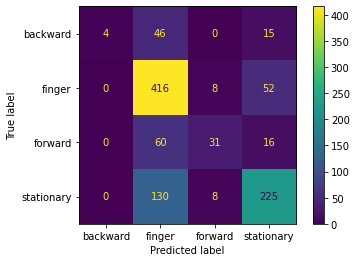

In [ ]:
# SVM with linear kernel using time and frequency domain features
startSVM = time.time()

LabelSVM = preprocessing.LabelEncoder()
statusSVM = LabelSVM.fit_transform(data_f['status'])

trainSVM, testSVM = train_test_split(data_f, random_state = 42)
X_trainSVM = trainSVM[trainSVM.columns[0:51]]
y_trainSVM = trainSVM['status']
X_testSVM = testSVM[testSVM.columns[0:51]]
y_testSVM= testSVM['status']

scalerSVM = StandardScaler()
scalerSVM.fit(X_trainSVM)
X_trainSVM = scalerSVM.transform(X_trainSVM)
X_testSVM = scalerSVM.transform(X_testSVM)

clfSVM = svm.SVC(kernel = 'linear')
clfSVM.fit(X_trainSVM, y_trainSVM.values.ravel())

predictionsSVM = clfSVM.predict(X_testSVM)
print(confusion_matrix(y_testSVM, predictionsSVM))
print(classification_report(y_testSVM, predictionsSVM))
print("Accuracy for SVM with linear kernel:",metrics.accuracy_score(y_testSVM, predictionsSVM))

endSVM = time.time()
# print(f"Runtime of SVM with linear kernel is {endSVM - startSVM}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testSVM, predictionsSVM, labels=clfSVM.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clfSVM.classes_)
disp.plot()
plt.show()

[[  4  42   0  19]
 [  0 445   3  28]
 [  0  51  38  18]
 [  0  82   0 281]]
              precision    recall  f1-score   support

    backward       1.00      0.06      0.12        65
      finger       0.72      0.93      0.81       476
     forward       0.93      0.36      0.51       107
  stationary       0.81      0.77      0.79       363

    accuracy                           0.76      1011
   macro avg       0.86      0.53      0.56      1011
weighted avg       0.79      0.76      0.73      1011

Accuracy for SVM with Radial Basis Function kernel: 0.7596439169139466


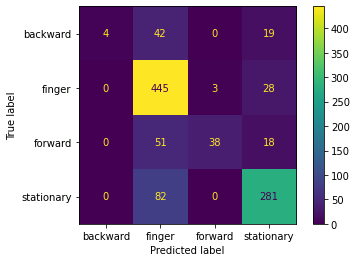

In [ ]:
# SVM with Radial Basis Function kernel using time and frequency domain features
startRBF = time.time()

LabelRBF = preprocessing.LabelEncoder()
statusRBF = LabelRBF.fit_transform(data_f['status'])

trainRBF, testRBF = train_test_split(data_f, random_state = 42)
X_trainRBF = trainRBF[trainRBF.columns[0:51]]
y_trainRBF = trainRBF['status']
X_testRBF = testRBF[testRBF.columns[0:51]]
y_testRBF = testRBF['status']

scalerRBF = StandardScaler()
scalerRBF.fit(X_trainRBF)
X_trainRBF = scalerRBF.transform(X_trainRBF)
X_testRBF = scalerRBF.transform(X_testRBF)

clfRBF = svm.SVC(kernel = 'rbf')
clfRBF.fit(X_trainRBF, y_trainRBF.values.ravel())

predictionsRBF = clfRBF.predict(X_testRBF)
print(confusion_matrix(y_testRBF, predictionsRBF))
print(classification_report(y_testRBF, predictionsRBF))
print("Accuracy for SVM with Radial Basis Function kernel:",metrics.accuracy_score(y_testRBF, predictionsRBF))

endRBF = time.time()
# print(f"Runtime of SVM with Radial Basis Function kernel is {endRBF - startRBF}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testRBF, predictionsRBF, labels=clfRBF.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clfRBF.classes_)
disp.plot()
plt.show()

[[ 42   8   0  15]
 [  7 450   6  13]
 [  3  19  78   7]
 [ 15  29   0 319]]
              precision    recall  f1-score   support

    backward       0.63      0.65      0.64        65
      finger       0.89      0.95      0.92       476
     forward       0.93      0.73      0.82       107
  stationary       0.90      0.88      0.89       363

    accuracy                           0.88      1011
   macro avg       0.84      0.80      0.81      1011
weighted avg       0.88      0.88      0.88      1011

Accuracy for kNN: 0.8793273986152325


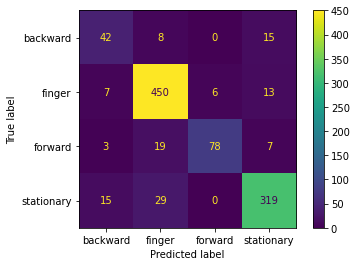

In [ ]:
# kNN using time and frequency domain features
startkNN = time.time()

LabelkNN = preprocessing.LabelEncoder()
statuskNN = LabelkNN.fit_transform(data_f['status'])

trainkNN, testkNN = train_test_split(data_f, random_state = 42)
X_trainkNN = trainkNN[trainkNN.columns[0:51]]
y_trainkNN = trainkNN['status']
X_testkNN = testkNN[testkNN.columns[0:51]]
y_testkNN = testkNN['status']

scaler = StandardScaler()
scaler.fit(X_trainkNN)
X_trainkNN = scaler.transform(X_trainkNN)
X_testkNN = scaler.transform(X_testkNN)

neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(X_trainkNN, y_trainkNN.values.ravel())

predictionskNN = neigh.predict(X_testkNN)
print(confusion_matrix(y_testkNN, predictionskNN))
print(classification_report(y_testkNN, predictionskNN))
print("Accuracy for kNN:",metrics.accuracy_score(y_testkNN, predictionskNN))

endkNN = time.time()
# print(f"Runtime of kNN is {endkNN - startkNN}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testkNN, predictionskNN, labels=neigh.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=neigh.classes_)
disp.plot()
plt.show()

# **Event-related Desynchronization (ERD) and Event-related Synchronization (ERS) for EEG data**

In [ ]:
from scipy.signal import butter, lfilter

def butter_bandpass(lowcut, highcut, fs, order):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

def smooth(y, box_pts):
    box = np.ones(box_pts)/box_pts
    y_smooth = np.convolve(y, box, mode='same')
    return y_smooth

def erders(data, lowF, highF, sf, real_order):
  from scipy.signal import savgol_filter
  import numpy as np
  erd_ers = savgol_filter(np.square(butter_bandpass_filter(data, lowF, highF, sf, order=real_order)), 51, 3)
  return erd_ers

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
sns.set(font_scale = 1.2, style = 'white')

# For C3 channel
# Define sampling frequency and time vector
sf = 500.
# timeC3_1 = np.arange(C3_1.size) / sf
# timeC3_2 = np.arange(C3_2.size) / sf
# timeC3_3 = np.arange(C3_3.size) / sf
# timeC3_4 = np.arange(C3_4.size) / sf
# timeC3_5 = np.arange(C3_5.size) / sf
# timeC3_6 = np.arange(C3_6.size) / sf
# timeC3_7 = np.arange(C3_7.size) / sf
# timeC3_8 = np.arange(C3_8.size) / sf
# timeC3_9 = np.arange(C3_9.size) / sf
# timeC3_10 = np.arange(C3_10.size) / sf
# timeC3_11 = np.arange(C3_11.size) / sf
# timeC3_12 = np.arange(C3_12.size) / sf

# For alpha frequency band
lowF = 8 
highF = 12
real_order = 5

C3_1_alpha = erders(C3_1, lowF, highF, sf, real_order)
C3_2_alpha = erders(C3_2, lowF, highF, sf, real_order)
C3_3_alpha = erders(C3_3, lowF, highF, sf, real_order)
C3_4_alpha = erders(C3_4, lowF, highF, sf, real_order)
C3_5_alpha = erders(C3_5, lowF, highF, sf, real_order)
C3_6_alpha = erders(C3_6, lowF, highF, sf, real_order)
C3_7_alpha = erders(C3_7, lowF, highF, sf, real_order)
C3_8_alpha = erders(C3_8, lowF, highF, sf, real_order)
C3_9_alpha = erders(C3_9, lowF, highF, sf, real_order)
C3_10_alpha = erders(C3_10, lowF, highF, sf, real_order)
C3_11_alpha = erders(C3_11, lowF, highF, sf, real_order)
C3_12_alpha = erders(C3_12, lowF, highF, sf, real_order)

# For beta frequency band
lowF1 = 12
highF1 = 30
C3_1_beta = erders(C3_1, lowF1, highF1, sf, real_order)
C3_2_beta = erders(C3_2, lowF1, highF1, sf, real_order)
C3_3_beta = erders(C3_3, lowF1, highF1, sf, real_order)
C3_4_beta = erders(C3_4, lowF1, highF1, sf, real_order)
C3_5_beta = erders(C3_5, lowF1, highF1, sf, real_order)
C3_6_beta = erders(C3_6, lowF1, highF1, sf, real_order)
C3_7_beta = erders(C3_7, lowF1, highF1, sf, real_order)
C3_8_beta = erders(C3_8, lowF1, highF1, sf, real_order)
C3_9_beta = erders(C3_9, lowF1, highF1, sf, real_order)
C3_10_beta = erders(C3_10, lowF1, highF1, sf, real_order)
C3_11_beta = erders(C3_11, lowF1, highF1, sf, real_order)
C3_12_beta = erders(C3_12, lowF1, highF1, sf, real_order)

# # Averaging of power samples across 12 trials for beta
# minNum = min(C3_1_filter1.size, C3_2_filter2.size, C3_3_filter3.size, C3_4_filter4.size, C3_5_filter5.size, C3_6_filter6.size, C3_7_filter7.size, C3_8_filter8.size, C3_9_filter9.size, C3_10_filter10.size, C3_11_filter11.size, C3_12_filter12.size)
# average1 = np.column_stack((C3_1_filter1[0:minNum], C3_2_filter2[0:minNum], C3_3_filter3[0:minNum], C3_4_filter4[0:minNum], C3_5_filter5[0:minNum], C3_6_filter6[0:minNum], C3_7_filter7[0:minNum], C3_8_filter8[0:minNum], C3_9_filter9[0:minNum], C3_10_filter10[0:minNum], C3_11_filter11[0:minNum], C3_12_filter12[0:minNum]))
# df1 = pd.DataFrame(average1, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# df1 = df1.assign(mean=df1.mean(axis=1))
# new1 = df1.to_numpy()
# new1 = new1.T
# new1 = new1[12]

# # Averaging of power samples across 12 trials for alpha
# minNum = min(C3_1_filter.size, C3_2_filter.size, C3_3_filter.size, C3_4_filter.size, C3_5_filter.size, C3_6_filter.size, C3_7_filter.size, C3_8_filter.size, C3_9_filter.size, C3_10_filter.size, C3_11_filter.size, C3_12_filter.size)
# average = np.column_stack((C3_1_filter[0:minNum], C3_2_filter[0:minNum], C3_3_filter[0:minNum], C3_4_filter[0:minNum], C3_5_filter[0:minNum], C3_6_filter[0:minNum], C3_7_filter[0:minNum], C3_8_filter[0:minNum], C3_9_filter[0:minNum], C3_10_filter[0:minNum], C3_11_filter[0:minNum], C3_12_filter[0:minNum]))
# df = pd.DataFrame(average, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# df = df.assign(mean=df.mean(axis=1))
# new = df.to_numpy()
# new = new.T
# new = new[12]

# # Smooth the data and plot it
# smoothData = savgol_filter(new, 51, 3) # window size 51, polynomial order 3
# smoothData1 = savgol_filter(new1, 51, 3) # window size 51, polynomial order 3

# timeFinal = np.arange(minNum) / sf
# fig, ax = plt.subplots(1, 1, figsize = (12, 4))
# plt.plot(timeFinal, smoothData, lw = 1.5, color = 'k')
# plt.plot(timeFinal, smoothData1, lw = 1.5, color = 'r')
# plt.legend(["Alpha Frequency Band", "Beta Frequency Band"])
# #plt.plot(timeFinal, smooth(new,19), 'g-', lw=2) # The other way to smooth the data
# plt.xlabel('Time (seconds)')
# plt.ylabel('Voltage')
# plt.xlim([timeFinal.min(), timeFinal.max()])
# plt.title('C3 ERD/ERS')
# sns.despine()

In [ ]:
# For C4 Channel
# timeC4_1 = np.arange(C4_1.size) / sf
# timeC4_2 = np.arange(C4_2.size) / sf
# timeC4_3 = np.arange(C4_3.size) / sf
# timeC4_4 = np.arange(C4_4.size) / sf
# timeC4_5 = np.arange(C4_5.size) / sf
# timeC4_6 = np.arange(C4_6.size) / sf
# timeC4_7 = np.arange(C4_7.size) / sf
# timeC4_8 = np.arange(C4_8.size) / sf
# timeC4_9 = np.arange(C4_9.size) / sf
# timeC4_10 = np.arange(C4_10.size) / sf
# timeC4_11 = np.arange(C4_11.size) / sf
# timeC4_12 = np.arange(C4_12.size) / sf

# For alpha frequency band
lowF = 8 
highF = 12
real_order = 5

C4_1_alpha = erders(C4_1, lowF, highF, sf, real_order)
C4_2_alpha = erders(C4_2, lowF, highF, sf, real_order)
C4_3_alpha = erders(C4_3, lowF, highF, sf, real_order)
C4_4_alpha = erders(C4_4, lowF, highF, sf, real_order)
C4_5_alpha = erders(C4_5, lowF, highF, sf, real_order)
C4_6_alpha = erders(C4_6, lowF, highF, sf, real_order)
C4_7_alpha = erders(C4_7, lowF, highF, sf, real_order)
C4_8_alpha = erders(C4_8, lowF, highF, sf, real_order)
C4_9_alpha = erders(C4_9, lowF, highF, sf, real_order)
C4_10_alpha = erders(C4_10, lowF, highF, sf, real_order)
C4_11_alpha = erders(C4_11, lowF, highF, sf, real_order)
C4_12_alpha = erders(C4_12, lowF, highF, sf, real_order)

# For beta frequency band
lowF1 = 12
highF1 = 30
C4_1_beta = erders(C4_1, lowF1, highF1, sf, real_order)
C4_2_beta = erders(C4_2, lowF1, highF1, sf, real_order)
C4_3_beta = erders(C4_3, lowF1, highF1, sf, real_order)
C4_4_beta = erders(C4_4, lowF1, highF1, sf, real_order)
C4_5_beta = erders(C4_5, lowF1, highF1, sf, real_order)
C4_6_beta = erders(C4_6, lowF1, highF1, sf, real_order)
C4_7_beta = erders(C4_7, lowF1, highF1, sf, real_order)
C4_8_beta = erders(C4_8, lowF1, highF1, sf, real_order)
C4_9_beta = erders(C4_9, lowF1, highF1, sf, real_order)
C4_10_beta = erders(C4_10, lowF1, highF1, sf, real_order)
C4_11_beta = erders(C4_11, lowF1, highF1, sf, real_order)
C4_12_beta = erders(C4_12, lowF1, highF1, sf, real_order)

# minNumC4 = min(C4_1_filter.size, C4_2_filter.size, C4_3_filter.size, C4_4_filter.size, C4_5_filter.size, C4_6_filter.size, C4_7_filter.size, C4_8_filter.size, C4_9_filter.size, C4_10_filter.size, C4_11_filter.size, C4_12_filter.size)
# averageC4 = np.column_stack((C4_1_filter[0:minNumC4], C4_2_filter[0:minNumC4], C4_3_filter[0:minNumC4], C4_4_filter[0:minNumC4], C4_5_filter[0:minNumC4], C4_6_filter[0:minNumC4], C4_7_filter[0:minNumC4], C4_8_filter[0:minNumC4], C4_9_filter[0:minNumC4], C4_10_filter[0:minNumC4], C4_11_filter[0:minNumC4], C4_12_filter[0:minNumC4]))
# dfC4 = pd.DataFrame(averageC4, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# dfC4 = dfC4.assign(mean=dfC4.mean(axis=1))
# newC4 = dfC4.to_numpy()
# newC4 = newC4.T
# newC4 = newC4[12]

# average1C4 = np.column_stack((C4_1_filter1[0:minNumC4], C4_2_filter2[0:minNumC4], C4_3_filter3[0:minNumC4], C4_4_filter4[0:minNumC4], C4_5_filter5[0:minNumC4], C4_6_filter6[0:minNumC4], C4_7_filter7[0:minNumC4], C4_8_filter8[0:minNumC4], C4_9_filter9[0:minNumC4], C4_10_filter10[0:minNumC4], C4_11_filter11[0:minNumC4], C4_12_filter12[0:minNumC4]))
# df1C4 = pd.DataFrame(average1C4, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# df1C4 = df1C4.assign(mean=df1C4.mean(axis=1))
# new1C4 = df1C4.to_numpy()
# new1C4 = new1C4.T
# new1C4 = new1C4[12]

# smoothDataC4 = savgol_filter(newC4, 51, 3) # window size 51, polynomial order 3
# smoothData1C4 = savgol_filter(new1C4, 51, 3) # window size 51, polynomial order 3

# timeFinalC4 = np.arange(minNumC4) / sf
# fig, ax = plt.subplots(1, 1, figsize = (12, 4))
# plt.plot(timeFinalC4, smoothDataC4, lw = 1.5, color = 'k')
# plt.plot(timeFinalC4, smoothData1C4, lw = 1.5, color = 'r')
# plt.legend(["Alpha Frequency Band", "Beta Frequency Band"])
# plt.xlabel('Time (seconds)')
# plt.ylabel('Voltage')
# plt.xlim([timeFinalC4.min(), timeFinalC4.max()])
# plt.title('C4 ERD/ERS')
# sns.despine()

In [ ]:
# For Cz Channel
# timeCz_1 = np.arange(Cz_1.size) / sf
# timeCz_2 = np.arange(Cz_2.size) / sf
# timeCz_3 = np.arange(Cz_3.size) / sf
# timeCz_4 = np.arange(Cz_4.size) / sf
# timeCz_5 = np.arange(Cz_5.size) / sf
# timeCz_6 = np.arange(Cz_6.size) / sf
# timeCz_7 = np.arange(Cz_7.size) / sf
# timeCz_8 = np.arange(Cz_8.size) / sf
# timeCz_9 = np.arange(Cz_9.size) / sf
# timeCz_10 = np.arange(Cz_10.size) / sf
# timeCz_11 = np.arange(Cz_11.size) / sf
# timeCz_12 = np.arange(Cz_12.size) / sf

# For alpha frequency band
lowF = 8 
highF = 12
real_order = 5

Cz_1_alpha = erders(Cz_1, lowF, highF, sf, real_order)
Cz_2_alpha = erders(Cz_2, lowF, highF, sf, real_order)
Cz_3_alpha = erders(Cz_3, lowF, highF, sf, real_order)
Cz_4_alpha = erders(Cz_4, lowF, highF, sf, real_order)
Cz_5_alpha = erders(Cz_5, lowF, highF, sf, real_order)
Cz_6_alpha = erders(Cz_6, lowF, highF, sf, real_order)
Cz_7_alpha = erders(Cz_7, lowF, highF, sf, real_order)
Cz_8_alpha = erders(Cz_8, lowF, highF, sf, real_order)
Cz_9_alpha = erders(Cz_9, lowF, highF, sf, real_order)
Cz_10_alpha = erders(Cz_10, lowF, highF, sf, real_order)
Cz_11_alpha = erders(Cz_11, lowF, highF, sf, real_order)
Cz_12_alpha = erders(Cz_12, lowF, highF, sf, real_order)

# For beta frequency band
lowF1 = 12
highF1 = 30
Cz_1_beta = erders(Cz_1, lowF1, highF1, sf, real_order)
Cz_2_beta = erders(Cz_2, lowF1, highF1, sf, real_order)
Cz_3_beta = erders(Cz_3, lowF1, highF1, sf, real_order)
Cz_4_beta = erders(Cz_4, lowF1, highF1, sf, real_order)
Cz_5_beta = erders(Cz_5, lowF1, highF1, sf, real_order)
Cz_6_beta = erders(Cz_6, lowF1, highF1, sf, real_order)
Cz_7_beta = erders(Cz_7, lowF1, highF1, sf, real_order)
Cz_8_beta = erders(Cz_8, lowF1, highF1, sf, real_order)
Cz_9_beta = erders(Cz_9, lowF1, highF1, sf, real_order)
Cz_10_beta = erders(Cz_10, lowF1, highF1, sf, real_order)
Cz_11_beta = erders(Cz_11, lowF1, highF1, sf, real_order)
Cz_12_beta = erders(Cz_12, lowF1, highF1, sf, real_order)

# Cz_1_filter = np.square(butter_bandpass_filter(Cz_1, lowF, highF, sf, order=real_order))
# Cz_2_filter = np.square(butter_bandpass_filter(Cz_2, lowF, highF, sf, order=real_order))
# Cz_3_filter = np.square(butter_bandpass_filter(Cz_3, lowF, highF, sf, order=real_order))
# Cz_4_filter = np.square(butter_bandpass_filter(Cz_4, lowF, highF, sf, order=real_order))
# Cz_5_filter = np.square(butter_bandpass_filter(Cz_5, lowF, highF, sf, order=real_order))
# Cz_6_filter = np.square(butter_bandpass_filter(Cz_6, lowF, highF, sf, order=real_order))
# Cz_7_filter = np.square(butter_bandpass_filter(Cz_7, lowF, highF, sf, order=real_order))
# Cz_8_filter = np.square(butter_bandpass_filter(Cz_8, lowF, highF, sf, order=real_order))
# Cz_9_filter = np.square(butter_bandpass_filter(Cz_9, lowF, highF, sf, order=real_order))
# Cz_10_filter = np.square(butter_bandpass_filter(Cz_10, lowF, highF, sf, order=real_order))
# Cz_11_filter = np.square(butter_bandpass_filter(Cz_11, lowF, highF, sf, order=real_order))
# Cz_12_filter = np.square(butter_bandpass_filter(Cz_12, lowF, highF, sf, order=real_order))

# Cz_1_filter1 = np.square(butter_bandpass_filter(Cz_1, lowF1, highF1, sf, order=real_order))
# Cz_2_filter2 = np.square(butter_bandpass_filter(Cz_2, lowF1, highF1, sf, order=real_order))
# Cz_3_filter3 = np.square(butter_bandpass_filter(Cz_3, lowF1, highF1, sf, order=real_order))
# Cz_4_filter4 = np.square(butter_bandpass_filter(Cz_4, lowF1, highF1, sf, order=real_order))
# Cz_5_filter5 = np.square(butter_bandpass_filter(Cz_5, lowF1, highF1, sf, order=real_order))
# Cz_6_filter6 = np.square(butter_bandpass_filter(Cz_6, lowF1, highF1, sf, order=real_order))
# Cz_7_filter7 = np.square(butter_bandpass_filter(Cz_7, lowF1, highF1, sf, order=real_order))
# Cz_8_filter8 = np.square(butter_bandpass_filter(Cz_8, lowF1, highF1, sf, order=real_order))
# Cz_9_filter9 = np.square(butter_bandpass_filter(Cz_9, lowF1, highF1, sf, order=real_order))
# Cz_10_filter10 = np.square(butter_bandpass_filter(Cz_4, lowF1, highF1, sf, order=real_order))
# Cz_11_filter11 = np.square(butter_bandpass_filter(Cz_4, lowF1, highF1, sf, order=real_order))
# Cz_12_filter12 = np.square(butter_bandpass_filter(Cz_4, lowF1, highF1, sf, order=real_order))

# minNumCz = min(Cz_1_filter.size, Cz_2_filter.size, Cz_3_filter.size, Cz_4_filter.size, Cz_5_filter.size, Cz_6_filter.size, Cz_7_filter.size, Cz_8_filter.size, Cz_9_filter.size, Cz_10_filter.size, Cz_11_filter.size, Cz_12_filter.size)
# averageCz = np.column_stack((Cz_1_filter[0:minNumCz], Cz_2_filter[0:minNumCz], Cz_3_filter[0:minNumCz], Cz_4_filter[0:minNumCz], Cz_5_filter[0:minNumCz], Cz_6_filter[0:minNumCz], Cz_7_filter[0:minNumCz], Cz_8_filter[0:minNumCz], Cz_9_filter[0:minNumCz], Cz_10_filter[0:minNumCz], Cz_11_filter[0:minNumCz], Cz_12_filter[0:minNumCz]))
# dfCz = pd.DataFrame(averageCz, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# dfCz = dfCz.assign(mean=dfCz.mean(axis=1))
# newCz = dfCz.to_numpy()
# newCz = newCz.T
# newCz = newCz[12]

# average1Cz = np.column_stack((Cz_1_filter1[0:minNumCz], Cz_2_filter2[0:minNumCz], Cz_3_filter3[0:minNumCz], Cz_4_filter4[0:minNumCz], Cz_5_filter5[0:minNumCz], Cz_6_filter6[0:minNumCz], Cz_7_filter7[0:minNumCz], Cz_8_filter8[0:minNumCz], Cz_9_filter9[0:minNumCz], Cz_10_filter10[0:minNumCz], Cz_11_filter11[0:minNumCz], Cz_12_filter12[0:minNumCz]))
# df1Cz = pd.DataFrame(average1Cz, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# df1Cz = df1Cz.assign(mean=df1Cz.mean(axis=1))
# new1Cz = df1Cz.to_numpy()
# new1Cz = new1Cz.T
# new1Cz = new1Cz[12]

# smoothDataCz = savgol_filter(newCz, 51, 3) # window size 51, polynomial order 3
# smoothData1Cz = savgol_filter(new1Cz, 51, 3) # window size 51, polynomial order 3

# timeFinalCz = np.arange(minNumCz) / sf
# fig, ax = plt.subplots(1, 1, figsize = (12, 4))
# plt.plot(timeFinalCz, smoothDataCz, lw = 1.5, color = 'k')
# plt.plot(timeFinalCz, smoothData1Cz, lw = 1.5, color = 'r')
# plt.legend(["Alpha Frequency Band", "Beta Frequency Band"])
# plt.xlabel('Time (seconds)')
# plt.ylabel('Voltage')
# plt.xlim([timeFinalCz.min(), timeFinalCz.max()])
# plt.title('Cz ERD/ERS')
# sns.despine()

In [ ]:
# For CP1 Channel
# timeCP1_1 = np.arange(CP1_1.size) / sf
# timeCP1_2 = np.arange(CP1_2.size) / sf
# timeCP1_3 = np.arange(CP1_3.size) / sf
# timeCP1_4 = np.arange(CP1_4.size) / sf
# timeCP1_5 = np.arange(CP1_5.size) / sf
# timeCP1_6 = np.arange(CP1_6.size) / sf
# timeCP1_7 = np.arange(CP1_7.size) / sf
# timeCP1_8 = np.arange(CP1_8.size) / sf
# timeCP1_9 = np.arange(CP1_9.size) / sf
# timeCP1_10 = np.arange(CP1_10.size) / sf
# timeCP1_11 = np.arange(CP1_11.size) / sf
# timeCP1_12 = np.arange(CP1_12.size) / sf

# For alpha frequency band
lowF = 8 
highF = 12
real_order = 5

CP1_1_alpha = erders(CP1_1, lowF, highF, sf, real_order)
CP1_2_alpha = erders(CP1_2, lowF, highF, sf, real_order)
CP1_3_alpha = erders(CP1_3, lowF, highF, sf, real_order)
CP1_4_alpha = erders(CP1_4, lowF, highF, sf, real_order)
CP1_5_alpha = erders(CP1_5, lowF, highF, sf, real_order)
CP1_6_alpha = erders(CP1_6, lowF, highF, sf, real_order)
CP1_7_alpha = erders(CP1_7, lowF, highF, sf, real_order)
CP1_8_alpha = erders(CP1_8, lowF, highF, sf, real_order)
CP1_9_alpha = erders(CP1_9, lowF, highF, sf, real_order)
CP1_10_alpha = erders(CP1_10, lowF, highF, sf, real_order)
CP1_11_alpha = erders(CP1_11, lowF, highF, sf, real_order)
CP1_12_alpha = erders(CP1_12, lowF, highF, sf, real_order)

# For beta frequency band
lowF1 = 12
highF1 = 30
CP1_1_beta = erders(CP1_1, lowF1, highF1, sf, real_order)
CP1_2_beta = erders(CP1_2, lowF1, highF1, sf, real_order)
CP1_3_beta = erders(CP1_3, lowF1, highF1, sf, real_order)
CP1_4_beta = erders(CP1_4, lowF1, highF1, sf, real_order)
CP1_5_beta = erders(CP1_5, lowF1, highF1, sf, real_order)
CP1_6_beta = erders(CP1_6, lowF1, highF1, sf, real_order)
CP1_7_beta = erders(CP1_7, lowF1, highF1, sf, real_order)
CP1_8_beta = erders(CP1_8, lowF1, highF1, sf, real_order)
CP1_9_beta = erders(CP1_9, lowF1, highF1, sf, real_order)
CP1_10_beta = erders(CP1_10, lowF1, highF1, sf, real_order)
CP1_11_beta = erders(CP1_11, lowF1, highF1, sf, real_order)
CP1_12_beta = erders(CP1_12, lowF1, highF1, sf, real_order)

# minNumCP1 = min(CP1_1_filter.size, CP1_2_filter.size, CP1_3_filter.size, CP1_4_filter.size, CP1_5_filter.size, CP1_6_filter.size, CP1_7_filter.size, CP1_8_filter.size, CP1_9_filter.size, CP1_10_filter.size, CP1_11_filter.size, CP1_12_filter.size)
# averageCP1 = np.column_stack((CP1_1_filter[0:minNumCP1], CP1_2_filter[0:minNumCP1], CP1_3_filter[0:minNumCP1], CP1_4_filter[0:minNumCP1], CP1_5_filter[0:minNumCP1], CP1_6_filter[0:minNumCP1], CP1_7_filter[0:minNumCP1], CP1_8_filter[0:minNumCP1], CP1_9_filter[0:minNumCP1], CP1_10_filter[0:minNumCP1], CP1_11_filter[0:minNumCP1], CP1_12_filter[0:minNumCP1]))
# dfCP1 = pd.DataFrame(averageCP1, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# dfCP1 = dfCP1.assign(mean=dfCP1.mean(axis=1))
# newCP1 = dfCP1.to_numpy()
# newCP1 = newCP1.T
# newCP1 = newCP1[12]

# average1CP1 = np.column_stack((CP1_1_filter1[0:minNumCP1], CP1_2_filter2[0:minNumCP1], CP1_3_filter3[0:minNumCP1], CP1_4_filter4[0:minNumCP1], CP1_5_filter5[0:minNumCP1], CP1_6_filter6[0:minNumCP1], CP1_7_filter7[0:minNumCP1], CP1_8_filter8[0:minNumCP1], CP1_9_filter9[0:minNumCP1], CP1_10_filter10[0:minNumCP1], CP1_11_filter11[0:minNumCP1], CP1_12_filter12[0:minNumCP1]))
# df1CP1 = pd.DataFrame(average1CP1, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# df1CP1 = df1CP1.assign(mean=df1CP1.mean(axis=1))
# new1CP1 = df1CP1.to_numpy()
# new1CP1 = new1CP1.T
# new1CP1 = new1CP1[12]

# smoothDataCP1 = savgol_filter(newCP1, 51, 3) # window size 51, polynomial order 3
# smoothData1CP1 = savgol_filter(new1CP1, 51, 3) # window size 51, polynomial order 3

# timeFinalCP1 = np.arange(minNumCP1) / sf
# fig, ax = plt.subplots(1, 1, figsize = (12, 4))
# plt.plot(timeFinalCP1, smoothDataCP1, lw = 1.5, color = 'k')
# plt.plot(timeFinalCP1, smoothData1CP1, lw = 1.5, color = 'r')
# plt.legend(["Alpha Frequency Band", "Beta Frequency Band"])
# plt.xlabel('Time (seconds)')
# plt.ylabel('Voltage')
# plt.xlim([timeFinalCP1.min(), timeFinalCP1.max()])
# plt.title('CP1 ERD/ERS')
# sns.despine()

In [ ]:
# For CP2 Channel
# timeCP2_1 = np.arange(CP2_1.size) / sf
# timeCP2_2 = np.arange(CP2_2.size) / sf
# timeCP2_3 = np.arange(CP2_3.size) / sf
# timeCP2_4 = np.arange(CP2_4.size) / sf
# timeCP2_5 = np.arange(CP2_5.size) / sf
# timeCP2_6 = np.arange(CP2_6.size) / sf
# timeCP2_7 = np.arange(CP2_7.size) / sf
# timeCP2_8 = np.arange(CP2_8.size) / sf
# timeCP2_9 = np.arange(CP2_9.size) / sf
# timeCP2_10 = np.arange(CP2_10.size) / sf
# timeCP2_11 = np.arange(CP2_11.size) / sf
# timeCP2_12 = np.arange(CP2_12.size) / sf

# For alpha frequency band
lowF = 8 
highF = 12
real_order = 5

CP2_1_alpha = erders(CP2_1, lowF, highF, sf, real_order)
CP2_2_alpha = erders(CP2_2, lowF, highF, sf, real_order)
CP2_3_alpha = erders(CP2_3, lowF, highF, sf, real_order)
CP2_4_alpha = erders(CP2_4, lowF, highF, sf, real_order)
CP2_5_alpha = erders(CP2_5, lowF, highF, sf, real_order)
CP2_6_alpha = erders(CP2_6, lowF, highF, sf, real_order)
CP2_7_alpha = erders(CP2_7, lowF, highF, sf, real_order)
CP2_8_alpha = erders(CP2_8, lowF, highF, sf, real_order)
CP2_9_alpha = erders(CP2_9, lowF, highF, sf, real_order)
CP2_10_alpha = erders(CP2_10, lowF, highF, sf, real_order)
CP2_11_alpha = erders(CP2_11, lowF, highF, sf, real_order)
CP2_12_alpha = erders(CP2_12, lowF, highF, sf, real_order)

# For beta frequency band
lowF1 = 12
highF1 = 30
CP2_1_beta = erders(CP2_1, lowF1, highF1, sf, real_order)
CP2_2_beta = erders(CP2_2, lowF1, highF1, sf, real_order)
CP2_3_beta = erders(CP2_3, lowF1, highF1, sf, real_order)
CP2_4_beta = erders(CP2_4, lowF1, highF1, sf, real_order)
CP2_5_beta = erders(CP2_5, lowF1, highF1, sf, real_order)
CP2_6_beta = erders(CP2_6, lowF1, highF1, sf, real_order)
CP2_7_beta = erders(CP2_7, lowF1, highF1, sf, real_order)
CP2_8_beta = erders(CP2_8, lowF1, highF1, sf, real_order)
CP2_9_beta = erders(CP2_9, lowF1, highF1, sf, real_order)
CP2_10_beta = erders(CP2_10, lowF1, highF1, sf, real_order)
CP2_11_beta = erders(CP2_11, lowF1, highF1, sf, real_order)
CP2_12_beta = erders(CP2_12, lowF1, highF1, sf, real_order)

# CP2_1_filter = np.square(butter_bandpass_filter(CP2_1, lowF, highF, sf, order=real_order))
# CP2_2_filter = np.square(butter_bandpass_filter(CP2_2, lowF, highF, sf, order=real_order))
# CP2_3_filter = np.square(butter_bandpass_filter(CP2_3, lowF, highF, sf, order=real_order))
# CP2_4_filter = np.square(butter_bandpass_filter(CP2_4, lowF, highF, sf, order=real_order))
# CP2_5_filter = np.square(butter_bandpass_filter(CP2_5, lowF, highF, sf, order=real_order))
# CP2_6_filter = np.square(butter_bandpass_filter(CP2_6, lowF, highF, sf, order=real_order))
# CP2_7_filter = np.square(butter_bandpass_filter(CP2_7, lowF, highF, sf, order=real_order))
# CP2_8_filter = np.square(butter_bandpass_filter(CP2_8, lowF, highF, sf, order=real_order))
# CP2_9_filter = np.square(butter_bandpass_filter(CP2_9, lowF, highF, sf, order=real_order))
# CP2_10_filter = np.square(butter_bandpass_filter(CP2_10, lowF, highF, sf, order=real_order))
# CP2_11_filter = np.square(butter_bandpass_filter(CP2_11, lowF, highF, sf, order=real_order))
# CP2_12_filter = np.square(butter_bandpass_filter(CP2_12, lowF, highF, sf, order=real_order))

# CP2_1_filter1 = np.square(butter_bandpass_filter(CP2_1, lowF1, highF1, sf, order=real_order))
# CP2_2_filter2 = np.square(butter_bandpass_filter(CP2_2, lowF1, highF1, sf, order=real_order))
# CP2_3_filter3 = np.square(butter_bandpass_filter(CP2_3, lowF1, highF1, sf, order=real_order))
# CP2_4_filter4 = np.square(butter_bandpass_filter(CP2_4, lowF1, highF1, sf, order=real_order))
# CP2_5_filter5 = np.square(butter_bandpass_filter(CP2_5, lowF1, highF1, sf, order=real_order))
# CP2_6_filter6 = np.square(butter_bandpass_filter(CP2_6, lowF1, highF1, sf, order=real_order))
# CP2_7_filter7 = np.square(butter_bandpass_filter(CP2_7, lowF1, highF1, sf, order=real_order))
# CP2_8_filter8 = np.square(butter_bandpass_filter(CP2_8, lowF1, highF1, sf, order=real_order))
# CP2_9_filter9 = np.square(butter_bandpass_filter(CP2_9, lowF1, highF1, sf, order=real_order))
# CP2_10_filter10 = np.square(butter_bandpass_filter(CP2_4, lowF1, highF1, sf, order=real_order))
# CP2_11_filter11 = np.square(butter_bandpass_filter(CP2_4, lowF1, highF1, sf, order=real_order))
# CP2_12_filter12 = np.square(butter_bandpass_filter(CP2_4, lowF1, highF1, sf, order=real_order))

# minNumCP2 = min(CP2_1_filter.size, CP2_2_filter.size, CP2_3_filter.size, CP2_4_filter.size, CP2_5_filter.size, CP2_6_filter.size, CP2_7_filter.size, CP2_8_filter.size, CP2_9_filter.size, CP2_10_filter.size, CP2_11_filter.size, CP2_12_filter.size)
# averageCP2 = np.column_stack((CP2_1_filter[0:minNumCP2], CP2_2_filter[0:minNumCP2], CP2_3_filter[0:minNumCP2], CP2_4_filter[0:minNumCP2], CP2_5_filter[0:minNumCP2], CP2_6_filter[0:minNumCP2], CP2_7_filter[0:minNumCP2], CP2_8_filter[0:minNumCP2], CP2_9_filter[0:minNumCP2], CP2_10_filter[0:minNumCP2], CP2_11_filter[0:minNumCP2], CP2_12_filter[0:minNumCP2]))
# dfCP2 = pd.DataFrame(averageCP2, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# dfCP2 = dfCP2.assign(mean=dfCP2.mean(axis=1))
# newCP2 = dfCP2.to_numpy()
# newCP2 = newCP2.T
# newCP2 = newCP2[12]

# average1CP2 = np.column_stack((CP2_1_filter1[0:minNumCP2], CP2_2_filter2[0:minNumCP2], CP2_3_filter3[0:minNumCP2], CP2_4_filter4[0:minNumCP2], CP2_5_filter5[0:minNumCP2], CP2_6_filter6[0:minNumCP2], CP2_7_filter7[0:minNumCP2], CP2_8_filter8[0:minNumCP2], CP2_9_filter9[0:minNumCP2], CP2_10_filter10[0:minNumCP2], CP2_11_filter11[0:minNumCP2], CP2_12_filter12[0:minNumCP2]))
# df1CP2 = pd.DataFrame(average1CP2, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# df1CP2 = df1CP2.assign(mean=df1CP2.mean(axis=1))
# new1CP2 = df1CP2.to_numpy()
# new1CP2 = new1CP2.T
# new1CP2 = new1CP2[12]

# smoothDataCP2 = savgol_filter(newCP2, 51, 3) # window size 51, polynomial order 3
# smoothData1CP2 = savgol_filter(new1CP2, 51, 3) # window size 51, polynomial order 3

# timeFinalCP2 = np.arange(minNumCP2) / sf
# fig, ax = plt.subplots(1, 1, figsize = (12, 4))
# plt.plot(timeFinalCP2, smoothDataCP2, lw = 1.5, color = 'k')
# plt.plot(timeFinalCP2, smoothData1CP2, lw = 1.5, color = 'r')
# plt.legend(["Alpha Frequency Band", "Beta Frequency Band"])
# plt.xlabel('Time (seconds)')
# plt.ylabel('Voltage')
# plt.xlim([timeFinalCP2.min(), timeFinalCP2.max()])
# plt.title('CP2 ERD/ERS')
# sns.despine()

In [ ]:
# # For CP5 Channel
# timeCP5_1 = np.arange(CP5_1.size) / sf
# timeCP5_2 = np.arange(CP5_2.size) / sf
# timeCP5_3 = np.arange(CP5_3.size) / sf
# timeCP5_4 = np.arange(CP5_4.size) / sf
# timeCP5_5 = np.arange(CP5_5.size) / sf
# timeCP5_6 = np.arange(CP5_6.size) / sf
# timeCP5_7 = np.arange(CP5_7.size) / sf
# timeCP5_8 = np.arange(CP5_8.size) / sf
# timeCP5_9 = np.arange(CP5_9.size) / sf
# timeCP5_10 = np.arange(CP5_10.size) / sf
# timeCP5_11 = np.arange(CP5_11.size) / sf
# timeCP5_12 = np.arange(CP5_12.size) / sf

# For alpha frequency band
lowF = 8 
highF = 12
real_order = 5

CP5_1_alpha = erders(CP5_1, lowF, highF, sf, real_order)
CP5_2_alpha = erders(CP5_2, lowF, highF, sf, real_order)
CP5_3_alpha = erders(CP5_3, lowF, highF, sf, real_order)
CP5_4_alpha = erders(CP5_4, lowF, highF, sf, real_order)
CP5_5_alpha = erders(CP5_5, lowF, highF, sf, real_order)
CP5_6_alpha = erders(CP5_6, lowF, highF, sf, real_order)
CP5_7_alpha = erders(CP5_7, lowF, highF, sf, real_order)
CP5_8_alpha = erders(CP5_8, lowF, highF, sf, real_order)
CP5_9_alpha = erders(CP5_9, lowF, highF, sf, real_order)
CP5_10_alpha = erders(CP5_10, lowF, highF, sf, real_order)
CP5_11_alpha = erders(CP5_11, lowF, highF, sf, real_order)
CP5_12_alpha = erders(CP5_12, lowF, highF, sf, real_order)

# For beta frequency band
lowF1 = 12
highF1 = 30
CP5_1_beta = erders(CP5_1, lowF1, highF1, sf, real_order)
CP5_2_beta = erders(CP5_2, lowF1, highF1, sf, real_order)
CP5_3_beta = erders(CP5_3, lowF1, highF1, sf, real_order)
CP5_4_beta = erders(CP5_4, lowF1, highF1, sf, real_order)
CP5_5_beta = erders(CP5_5, lowF1, highF1, sf, real_order)
CP5_6_beta = erders(CP5_6, lowF1, highF1, sf, real_order)
CP5_7_beta = erders(CP5_7, lowF1, highF1, sf, real_order)
CP5_8_beta = erders(CP5_8, lowF1, highF1, sf, real_order)
CP5_9_beta = erders(CP5_9, lowF1, highF1, sf, real_order)
CP5_10_beta = erders(CP5_10, lowF1, highF1, sf, real_order)
CP5_11_beta = erders(CP5_11, lowF1, highF1, sf, real_order)
CP5_12_beta = erders(CP5_12, lowF1, highF1, sf, real_order)

# CP5_1_filter = np.square(butter_bandpass_filter(CP5_1, lowF, highF, sf, order=real_order))
# CP5_2_filter = np.square(butter_bandpass_filter(CP5_2, lowF, highF, sf, order=real_order))
# CP5_3_filter = np.square(butter_bandpass_filter(CP5_3, lowF, highF, sf, order=real_order))
# CP5_4_filter = np.square(butter_bandpass_filter(CP5_4, lowF, highF, sf, order=real_order))
# CP5_5_filter = np.square(butter_bandpass_filter(CP5_5, lowF, highF, sf, order=real_order))
# CP5_6_filter = np.square(butter_bandpass_filter(CP5_6, lowF, highF, sf, order=real_order))
# CP5_7_filter = np.square(butter_bandpass_filter(CP5_7, lowF, highF, sf, order=real_order))
# CP5_8_filter = np.square(butter_bandpass_filter(CP5_8, lowF, highF, sf, order=real_order))
# CP5_9_filter = np.square(butter_bandpass_filter(CP5_9, lowF, highF, sf, order=real_order))
# CP5_10_filter = np.square(butter_bandpass_filter(CP5_10, lowF, highF, sf, order=real_order))
# CP5_11_filter = np.square(butter_bandpass_filter(CP5_11, lowF, highF, sf, order=real_order))
# CP5_12_filter = np.square(butter_bandpass_filter(CP5_12, lowF, highF, sf, order=real_order))

# CP5_1_filter1 = np.square(butter_bandpass_filter(CP5_1, lowF1, highF1, sf, order=real_order))
# CP5_2_filter2 = np.square(butter_bandpass_filter(CP5_2, lowF1, highF1, sf, order=real_order))
# CP5_3_filter3 = np.square(butter_bandpass_filter(CP5_3, lowF1, highF1, sf, order=real_order))
# CP5_4_filter4 = np.square(butter_bandpass_filter(CP5_4, lowF1, highF1, sf, order=real_order))
# CP5_5_filter5 = np.square(butter_bandpass_filter(CP5_5, lowF1, highF1, sf, order=real_order))
# CP5_6_filter6 = np.square(butter_bandpass_filter(CP5_6, lowF1, highF1, sf, order=real_order))
# CP5_7_filter7 = np.square(butter_bandpass_filter(CP5_7, lowF1, highF1, sf, order=real_order))
# CP5_8_filter8 = np.square(butter_bandpass_filter(CP5_8, lowF1, highF1, sf, order=real_order))
# CP5_9_filter9 = np.square(butter_bandpass_filter(CP5_9, lowF1, highF1, sf, order=real_order))
# CP5_10_filter10 = np.square(butter_bandpass_filter(CP5_4, lowF1, highF1, sf, order=real_order))
# CP5_11_filter11 = np.square(butter_bandpass_filter(CP5_4, lowF1, highF1, sf, order=real_order))
# CP5_12_filter12 = np.square(butter_bandpass_filter(CP5_4, lowF1, highF1, sf, order=real_order))

# minNumCP5 = min(CP5_1_filter.size, CP5_2_filter.size, CP5_3_filter.size, CP5_4_filter.size, CP5_5_filter.size, CP5_6_filter.size, CP5_7_filter.size, CP5_8_filter.size, CP5_9_filter.size, CP5_10_filter.size, CP5_11_filter.size, CP5_12_filter.size)
# averageCP5 = np.column_stack((CP5_1_filter[0:minNumCP5], CP5_2_filter[0:minNumCP5], CP5_3_filter[0:minNumCP5], CP5_4_filter[0:minNumCP5], CP5_5_filter[0:minNumCP5], CP5_6_filter[0:minNumCP5], CP5_7_filter[0:minNumCP5], CP5_8_filter[0:minNumCP5], CP5_9_filter[0:minNumCP5], CP5_10_filter[0:minNumCP5], CP5_11_filter[0:minNumCP5], CP5_12_filter[0:minNumCP5]))
# dfCP5 = pd.DataFrame(averageCP5, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# dfCP5 = dfCP5.assign(mean=dfCP5.mean(axis=1))
# newCP5 = dfCP5.to_numpy()
# newCP5 = newCP5.T
# newCP5 = newCP5[12]

# average1CP5 = np.column_stack((CP5_1_filter1[0:minNumCP5], CP5_2_filter2[0:minNumCP5], CP5_3_filter3[0:minNumCP5], CP5_4_filter4[0:minNumCP5], CP5_5_filter5[0:minNumCP5], CP5_6_filter6[0:minNumCP5], CP5_7_filter7[0:minNumCP5], CP5_8_filter8[0:minNumCP5], CP5_9_filter9[0:minNumCP5], CP5_10_filter10[0:minNumCP5], CP5_11_filter11[0:minNumCP5], CP5_12_filter12[0:minNumCP5]))
# df1CP5 = pd.DataFrame(average1CP5, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# df1CP5 = df1CP5.assign(mean=df1CP5.mean(axis=1))
# new1CP5 = df1CP5.to_numpy()
# new1CP5 = new1CP5.T
# new1CP5 = new1CP5[12]

# smoothDataCP5 = savgol_filter(newCP5, 51, 3) # window size 51, polynomial order 3
# smoothData1CP5 = savgol_filter(new1CP5, 51, 3) # window size 51, polynomial order 3

# timeFinalCP5 = np.arange(minNumCP5) / sf
# fig, ax = plt.subplots(1, 1, figsize = (12, 4))
# plt.plot(timeFinalCP5, smoothDataCP5, lw = 1.5, color = 'k')
# plt.plot(timeFinalCP5, smoothData1CP5, lw = 1.5, color = 'r')
# plt.legend(["Alpha Frequency Band", "Beta Frequency Band"])
# plt.xlabel('Time (seconds)')
# plt.ylabel('Voltage')
# plt.xlim([timeFinalCP5.min(), timeFinalCP5.max()])
# plt.title('CP5 ERD/ERS')
# sns.despine()

In [ ]:
# # For CP6 Channel
# timeCP6_1 = np.arange(CP6_1.size) / sf
# timeCP6_2 = np.arange(CP6_2.size) / sf
# timeCP6_3 = np.arange(CP6_3.size) / sf
# timeCP6_4 = np.arange(CP6_4.size) / sf
# timeCP6_5 = np.arange(CP6_5.size) / sf
# timeCP6_6 = np.arange(CP6_6.size) / sf
# timeCP6_7 = np.arange(CP6_7.size) / sf
# timeCP6_8 = np.arange(CP6_8.size) / sf
# timeCP6_9 = np.arange(CP6_9.size) / sf
# timeCP6_10 = np.arange(CP6_10.size) / sf
# timeCP6_11 = np.arange(CP6_11.size) / sf
# timeCP6_12 = np.arange(CP6_12.size) / sf
# For alpha frequency band
lowF = 8 
highF = 12
real_order = 5

CP6_1_alpha = erders(CP6_1, lowF, highF, sf, real_order)
CP6_2_alpha = erders(CP6_2, lowF, highF, sf, real_order)
CP6_3_alpha = erders(CP6_3, lowF, highF, sf, real_order)
CP6_4_alpha = erders(CP6_4, lowF, highF, sf, real_order)
CP6_5_alpha = erders(CP6_5, lowF, highF, sf, real_order)
CP6_6_alpha = erders(CP6_6, lowF, highF, sf, real_order)
CP6_7_alpha = erders(CP6_7, lowF, highF, sf, real_order)
CP6_8_alpha = erders(CP6_8, lowF, highF, sf, real_order)
CP6_9_alpha = erders(CP6_9, lowF, highF, sf, real_order)
CP6_10_alpha = erders(CP6_10, lowF, highF, sf, real_order)
CP6_11_alpha = erders(CP6_11, lowF, highF, sf, real_order)
CP6_12_alpha = erders(CP6_12, lowF, highF, sf, real_order)

# For beta frequency band
lowF1 = 12
highF1 = 30
CP6_1_beta = erders(CP6_1, lowF1, highF1, sf, real_order)
CP6_2_beta = erders(CP6_2, lowF1, highF1, sf, real_order)
CP6_3_beta = erders(CP6_3, lowF1, highF1, sf, real_order)
CP6_4_beta = erders(CP6_4, lowF1, highF1, sf, real_order)
CP6_5_beta = erders(CP6_5, lowF1, highF1, sf, real_order)
CP6_6_beta = erders(CP6_6, lowF1, highF1, sf, real_order)
CP6_7_beta = erders(CP6_7, lowF1, highF1, sf, real_order)
CP6_8_beta = erders(CP6_8, lowF1, highF1, sf, real_order)
CP6_9_beta = erders(CP6_9, lowF1, highF1, sf, real_order)
CP6_10_beta = erders(CP6_10, lowF1, highF1, sf, real_order)
CP6_11_beta = erders(CP6_11, lowF1, highF1, sf, real_order)
CP6_12_beta = erders(CP6_12, lowF1, highF1, sf, real_order)

# CP6_1_filter = np.square(butter_bandpass_filter(CP6_1, lowF, highF, sf, order=real_order))
# CP6_2_filter = np.square(butter_bandpass_filter(CP6_2, lowF, highF, sf, order=real_order))
# CP6_3_filter = np.square(butter_bandpass_filter(CP6_3, lowF, highF, sf, order=real_order))
# CP6_4_filter = np.square(butter_bandpass_filter(CP6_4, lowF, highF, sf, order=real_order))
# CP6_5_filter = np.square(butter_bandpass_filter(CP6_5, lowF, highF, sf, order=real_order))
# CP6_6_filter = np.square(butter_bandpass_filter(CP6_6, lowF, highF, sf, order=real_order))
# CP6_7_filter = np.square(butter_bandpass_filter(CP6_7, lowF, highF, sf, order=real_order))
# CP6_8_filter = np.square(butter_bandpass_filter(CP6_8, lowF, highF, sf, order=real_order))
# CP6_9_filter = np.square(butter_bandpass_filter(CP6_9, lowF, highF, sf, order=real_order))
# CP6_10_filter = np.square(butter_bandpass_filter(CP6_10, lowF, highF, sf, order=real_order))
# CP6_11_filter = np.square(butter_bandpass_filter(CP6_11, lowF, highF, sf, order=real_order))
# CP6_12_filter = np.square(butter_bandpass_filter(CP6_12, lowF, highF, sf, order=real_order))

# CP6_1_filter1 = np.square(butter_bandpass_filter(CP6_1, lowF1, highF1, sf, order=real_order))
# CP6_2_filter2 = np.square(butter_bandpass_filter(CP6_2, lowF1, highF1, sf, order=real_order))
# CP6_3_filter3 = np.square(butter_bandpass_filter(CP6_3, lowF1, highF1, sf, order=real_order))
# CP6_4_filter4 = np.square(butter_bandpass_filter(CP6_4, lowF1, highF1, sf, order=real_order))
# CP6_5_filter5 = np.square(butter_bandpass_filter(CP6_5, lowF1, highF1, sf, order=real_order))
# CP6_6_filter6 = np.square(butter_bandpass_filter(CP6_6, lowF1, highF1, sf, order=real_order))
# CP6_7_filter7 = np.square(butter_bandpass_filter(CP6_7, lowF1, highF1, sf, order=real_order))
# CP6_8_filter8 = np.square(butter_bandpass_filter(CP6_8, lowF1, highF1, sf, order=real_order))
# CP6_9_filter9 = np.square(butter_bandpass_filter(CP6_9, lowF1, highF1, sf, order=real_order))
# CP6_10_filter10 = np.square(butter_bandpass_filter(CP6_4, lowF1, highF1, sf, order=real_order))
# CP6_11_filter11 = np.square(butter_bandpass_filter(CP6_4, lowF1, highF1, sf, order=real_order))
# CP6_12_filter12 = np.square(butter_bandpass_filter(CP6_4, lowF1, highF1, sf, order=real_order))

# minNumCP6 = min(CP6_1_filter.size, CP6_2_filter.size, CP6_3_filter.size, CP6_4_filter.size, CP6_5_filter.size, CP6_6_filter.size, CP6_7_filter.size, CP6_8_filter.size, CP6_9_filter.size, CP6_10_filter.size, CP6_11_filter.size, CP6_12_filter.size)
# averageCP6 = np.column_stack((CP6_1_filter[0:minNumCP6], CP6_2_filter[0:minNumCP6], CP6_3_filter[0:minNumCP6], CP6_4_filter[0:minNumCP6], CP6_5_filter[0:minNumCP6], CP6_6_filter[0:minNumCP6], CP6_7_filter[0:minNumCP6], CP6_8_filter[0:minNumCP6], CP6_9_filter[0:minNumCP6], CP6_10_filter[0:minNumCP6], CP6_11_filter[0:minNumCP6], CP6_12_filter[0:minNumCP6]))
# dfCP6 = pd.DataFrame(averageCP6, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# dfCP6 = dfCP6.assign(mean=dfCP6.mean(axis=1))
# newCP6 = dfCP6.to_numpy()
# newCP6 = newCP6.T
# newCP6 = newCP6[12]

# average1CP6 = np.column_stack((CP6_1_filter1[0:minNumCP6], CP6_2_filter2[0:minNumCP6], CP6_3_filter3[0:minNumCP6], CP6_4_filter4[0:minNumCP6], CP6_5_filter5[0:minNumCP6], CP6_6_filter6[0:minNumCP6], CP6_7_filter7[0:minNumCP6], CP6_8_filter8[0:minNumCP6], CP6_9_filter9[0:minNumCP6], CP6_10_filter10[0:minNumCP6], CP6_11_filter11[0:minNumCP6], CP6_12_filter12[0:minNumCP6]))
# df1CP6 = pd.DataFrame(average1CP6, columns = ['trail 1', 'trail 2', 'trail 3', 'trail 4', 'trail 5', 'trail 6', 'trail 7', 'trail 8', 'trail 9', 'trail 10', 'trail 11', 'trail 12'])
# df1CP6 = df1CP6.assign(mean=df1CP6.mean(axis=1))
# new1CP6 = df1CP6.to_numpy()
# new1CP6 = new1CP6.T
# new1CP6 = new1CP6[12]

# smoothDataCP6 = savgol_filter(newCP6, 51, 3) # window size 51, polynomial order 3
# smoothData1CP6 = savgol_filter(new1CP6, 51, 3) # window size 51, polynomial order 3

# timeFinalCP6 = np.arange(minNumCP6) / sf
# fig, ax = plt.subplots(1, 1, figsize = (12, 4))
# plt.plot(timeFinalCP6, smoothDataCP6, lw = 1.5, color = 'k')
# plt.plot(timeFinalCP6, smoothData1CP6, lw = 1.5, color = 'r')
# plt.legend(["Alpha Frequency Band", "Beta Frequency Band"])
# plt.xlabel('Time (seconds)')
# plt.ylabel('Voltage')
# plt.xlim([timeFinalCP6.min(), timeFinalCP6.max()])
# plt.title('CP6 ERD/ERS')
# sns.despine()

In [ ]:
C3_alpha_rest = [C3_1_alpha[50:1000], C3_2_alpha[50:1000], C3_3_alpha[50:1000], C3_4_alpha[50:1000], C3_5_alpha[50:1000], C3_6_alpha[50:1000], C3_7_alpha[50:1000], C3_8_alpha[50:1000], C3_9_alpha[50:1000], C3_10_alpha[50:1000], C3_11_alpha[50:1000], C3_12_alpha[50:1000]]
C3_alpha_move = [C3_1_alpha[1000:2000], C3_2_alpha[1000:2000], C3_3_alpha[1000:2000], C3_4_alpha[1000:2000], C3_5_alpha[1000:2000], C3_6_alpha[1000:2000], C3_7_alpha[1000:2000], C3_8_alpha[1000:2000], C3_9_alpha[1000:2000], C3_10_alpha[1000:2000], C3_11_alpha[1000:2000], C3_12_alpha[1000:2000]]
C4_alpha_rest = [C4_1_alpha[50:1000], C4_2_alpha[50:1000], C4_3_alpha[50:1000], C4_4_alpha[50:1000], C4_5_alpha[50:1000], C4_6_alpha[50:1000], C4_7_alpha[50:1000], C4_8_alpha[50:1000], C4_9_alpha[50:1000], C4_10_alpha[50:1000], C4_11_alpha[50:1000], C4_12_alpha[50:1000]]
C4_alpha_move = [C4_1_alpha[1000:2000], C4_2_alpha[1000:2000], C4_3_alpha[1000:2000], C4_4_alpha[1000:2000], C4_5_alpha[1000:2000], C4_6_alpha[1000:2000], C4_7_alpha[1000:2000], C4_8_alpha[1000:2000], C4_9_alpha[1000:2000], C4_10_alpha[1000:2000], C4_11_alpha[1000:2000], C4_12_alpha[1000:2000]]
Cz_alpha_rest = [Cz_1_alpha[50:1000], Cz_2_alpha[50:1000], Cz_3_alpha[50:1000], Cz_4_alpha[50:1000], Cz_5_alpha[50:1000], Cz_6_alpha[50:1000], Cz_7_alpha[50:1000], Cz_8_alpha[50:1000], Cz_9_alpha[50:1000], Cz_10_alpha[50:1000], Cz_11_alpha[50:1000], Cz_12_alpha[50:1000]]
Cz_alpha_move = [Cz_1_alpha[1000:2000], Cz_2_alpha[1000:2000], Cz_3_alpha[1000:2000], Cz_4_alpha[1000:2000], Cz_5_alpha[1000:2000], Cz_6_alpha[1000:2000], Cz_7_alpha[1000:2000], Cz_8_alpha[1000:2000], Cz_9_alpha[1000:2000], Cz_10_alpha[1000:2000], Cz_11_alpha[1000:2000], Cz_12_alpha[1000:2000]]
CP1_alpha_rest = [CP1_1_alpha[50:1000], CP1_2_alpha[50:1000], CP1_3_alpha[50:1000], CP1_4_alpha[50:1000], CP1_5_alpha[50:1000], CP1_6_alpha[50:1000], CP1_7_alpha[50:1000], CP1_8_alpha[50:1000], CP1_9_alpha[50:1000], CP1_10_alpha[50:1000], CP1_11_alpha[50:1000], CP1_12_alpha[50:1000]]
CP1_alpha_move = [CP1_1_alpha[1000:2000], CP1_2_alpha[1000:2000], CP1_3_alpha[1000:2000], CP1_4_alpha[1000:2000], CP1_5_alpha[1000:2000], CP1_6_alpha[1000:2000], CP1_7_alpha[1000:2000], CP1_8_alpha[1000:2000], CP1_9_alpha[1000:2000], CP1_10_alpha[1000:2000], CP1_11_alpha[1000:2000], CP1_12_alpha[1000:2000]]
CP2_alpha_rest = [CP2_1_alpha[50:1000], CP2_2_alpha[50:1000], CP2_3_alpha[50:1000], CP2_4_alpha[50:1000], CP2_5_alpha[50:1000], CP2_6_alpha[50:1000], CP2_7_alpha[50:1000], CP2_8_alpha[50:1000], CP2_9_alpha[50:1000], CP2_10_alpha[50:1000], CP2_11_alpha[50:1000], CP2_12_alpha[50:1000]]
CP2_alpha_move = [CP2_1_alpha[1000:2000], CP2_2_alpha[1000:2000], CP2_3_alpha[1000:2000], CP2_4_alpha[1000:2000], CP2_5_alpha[1000:2000], CP2_6_alpha[1000:2000], CP2_7_alpha[1000:2000], CP2_8_alpha[1000:2000], CP2_9_alpha[1000:2000], CP2_10_alpha[1000:2000], CP2_11_alpha[1000:2000], CP2_12_alpha[1000:2000]]
CP5_alpha_rest = [CP5_1_alpha[50:1000], CP5_2_alpha[50:1000], CP5_3_alpha[50:1000], CP5_4_alpha[50:1000], CP5_5_alpha[50:1000], CP5_6_alpha[50:1000], CP5_7_alpha[50:1000], CP5_8_alpha[50:1000], CP5_9_alpha[50:1000], CP5_10_alpha[50:1000], CP5_11_alpha[50:1000], CP5_12_alpha[50:1000]]
CP5_alpha_move = [CP5_1_alpha[1000:2000], CP5_2_alpha[1000:2000], CP5_3_alpha[1000:2000], CP5_4_alpha[1000:2000], CP5_5_alpha[1000:2000], CP5_6_alpha[1000:2000], CP5_7_alpha[1000:2000], CP5_8_alpha[1000:2000], CP5_9_alpha[1000:2000], CP5_10_alpha[1000:2000], CP5_11_alpha[1000:2000], CP5_12_alpha[1000:2000]]
CP6_alpha_rest = [CP6_1_alpha[50:1000], CP6_2_alpha[50:1000], CP6_3_alpha[50:1000], CP6_4_alpha[50:1000], CP6_5_alpha[50:1000], CP6_6_alpha[50:1000], CP6_7_alpha[50:1000], CP6_8_alpha[50:1000], CP6_9_alpha[50:1000], CP6_10_alpha[50:1000], CP6_11_alpha[50:1000], CP6_12_alpha[50:1000]]
CP6_alpha_move = [CP6_1_alpha[1000:2000], CP6_2_alpha[1000:2000], CP6_3_alpha[1000:2000], CP6_4_alpha[1000:2000], CP6_5_alpha[1000:2000], CP6_6_alpha[1000:2000], CP6_7_alpha[1000:2000], CP6_8_alpha[1000:2000], CP6_9_alpha[1000:2000], CP6_10_alpha[1000:2000], CP6_11_alpha[1000:2000], CP6_12_alpha[1000:2000]]

In [ ]:
C3_beta_rest = [C3_1_beta[50:1000], C3_2_beta[50:1000], C3_3_beta[50:1000], C3_4_beta[50:1000], C3_5_beta[50:1000], C3_6_beta[50:1000], C3_7_beta[50:1000], C3_8_beta[50:1000], C3_9_beta[50:1000], C3_10_beta[50:1000], C3_11_beta[50:1000], C3_12_beta[50:1000]]
C3_beta_move = [C3_1_beta[1000:2000], C3_2_beta[1000:2000], C3_3_beta[1000:2000], C3_4_beta[1000:2000], C3_5_beta[1000:2000], C3_6_beta[1000:2000], C3_7_beta[1000:2000], C3_8_beta[1000:2000], C3_9_beta[1000:2000], C3_10_beta[1000:2000], C3_11_beta[1000:2000], C3_12_beta[1000:2000]]
C4_beta_rest = [C4_1_beta[50:1000], C4_2_beta[50:1000], C4_3_beta[50:1000], C4_4_beta[50:1000], C4_5_beta[50:1000], C4_6_beta[50:1000], C4_7_beta[50:1000], C4_8_beta[50:1000], C4_9_beta[50:1000], C4_10_beta[50:1000], C4_11_beta[50:1000], C4_12_beta[50:1000]]
C4_beta_move = [C4_1_beta[1000:2000], C4_2_beta[1000:2000], C4_3_beta[1000:2000], C4_4_beta[1000:2000], C4_5_beta[1000:2000], C4_6_beta[1000:2000], C4_7_beta[1000:2000], C4_8_beta[1000:2000], C4_9_beta[1000:2000], C4_10_beta[1000:2000], C4_11_beta[1000:2000], C4_12_beta[1000:2000]]
Cz_beta_rest = [Cz_1_beta[50:1000], Cz_2_beta[50:1000], Cz_3_beta[50:1000], Cz_4_beta[50:1000], Cz_5_beta[50:1000], Cz_6_beta[50:1000], Cz_7_beta[50:1000], Cz_8_beta[50:1000], Cz_9_beta[50:1000], Cz_10_beta[50:1000], Cz_11_beta[50:1000], Cz_12_beta[50:1000]]
Cz_beta_move = [Cz_1_beta[1000:2000], Cz_2_beta[1000:2000], Cz_3_beta[1000:2000], Cz_4_beta[1000:2000], Cz_5_beta[1000:2000], Cz_6_beta[1000:2000], Cz_7_beta[1000:2000], Cz_8_beta[1000:2000], Cz_9_beta[1000:2000], Cz_10_beta[1000:2000], Cz_11_beta[1000:2000], Cz_12_beta[1000:2000]]
CP1_beta_rest = [CP1_1_beta[50:1000], CP1_2_beta[50:1000], CP1_3_beta[50:1000], CP1_4_beta[50:1000], CP1_5_beta[50:1000], CP1_6_beta[50:1000], CP1_7_beta[50:1000], CP1_8_beta[50:1000], CP1_9_beta[50:1000], CP1_10_beta[50:1000], CP1_11_beta[50:1000], CP1_12_beta[50:1000]]
CP1_beta_move = [CP1_1_beta[1000:2000], CP1_2_beta[1000:2000], CP1_3_beta[1000:2000], CP1_4_beta[1000:2000], CP1_5_beta[1000:2000], CP1_6_beta[1000:2000], CP1_7_beta[1000:2000], CP1_8_beta[1000:2000], CP1_9_beta[1000:2000], CP1_10_beta[1000:2000], CP1_11_beta[1000:2000], CP1_12_beta[1000:2000]]
CP2_beta_rest = [CP2_1_beta[50:1000], CP2_2_beta[50:1000], CP2_3_beta[50:1000], CP2_4_beta[50:1000], CP2_5_beta[50:1000], CP2_6_beta[50:1000], CP2_7_beta[50:1000], CP2_8_beta[50:1000], CP2_9_beta[50:1000], CP2_10_beta[50:1000], CP2_11_beta[50:1000], CP2_12_beta[50:1000]]
CP2_beta_move = [CP2_1_beta[1000:2000], CP2_2_beta[1000:2000], CP2_3_beta[1000:2000], CP2_4_beta[1000:2000], CP2_5_beta[1000:2000], CP2_6_beta[1000:2000], CP2_7_beta[1000:2000], CP2_8_beta[1000:2000], CP2_9_beta[1000:2000], CP2_10_beta[1000:2000], CP2_11_beta[1000:2000], CP2_12_beta[1000:2000]]
CP5_beta_rest = [CP5_1_beta[50:1000], CP5_2_beta[50:1000], CP5_3_beta[50:1000], CP5_4_beta[50:1000], CP5_5_beta[50:1000], CP5_6_beta[50:1000], CP5_7_beta[50:1000], CP5_8_beta[50:1000], CP5_9_beta[50:1000], CP5_10_beta[50:1000], CP5_11_beta[50:1000], CP5_12_beta[50:1000]]
CP5_beta_move = [CP5_1_beta[1000:2000], CP5_2_beta[1000:2000], CP5_3_beta[1000:2000], CP5_4_beta[1000:2000], CP5_5_beta[1000:2000], CP5_6_beta[1000:2000], CP5_7_beta[1000:2000], CP5_8_beta[1000:2000], CP5_9_beta[1000:2000], CP5_10_beta[1000:2000], CP5_11_beta[1000:2000], CP5_12_beta[1000:2000]]
CP6_beta_rest = [CP6_1_beta[50:1000], CP6_2_beta[50:1000], CP6_3_beta[50:1000], CP6_4_beta[50:1000], CP6_5_beta[50:1000], CP6_6_beta[50:1000], CP6_7_beta[50:1000], CP6_8_beta[50:1000], CP6_9_beta[50:1000], CP6_10_beta[50:1000], CP6_11_beta[50:1000], CP6_12_beta[50:1000]]
CP6_beta_move = [CP6_1_beta[1000:2000], CP6_2_beta[1000:2000], CP6_3_beta[1000:2000], CP6_4_beta[1000:2000], CP6_5_beta[1000:2000], CP6_6_beta[1000:2000], CP6_7_beta[1000:2000], CP6_8_beta[1000:2000], CP6_9_beta[1000:2000], CP6_10_beta[1000:2000], CP6_11_beta[1000:2000], CP6_12_beta[1000:2000]]

In [ ]:
def flatten(t):
    return [item for sublist in t for item in sublist]

In [ ]:
C3_alpha = np.concatenate((flatten(C3_alpha_rest), flatten(C3_alpha_move)))
C4_alpha = np.concatenate((flatten(C4_alpha_rest), flatten(C4_alpha_move)))
Cz_alpha = np.concatenate((flatten(Cz_alpha_rest), flatten(Cz_alpha_move)))
CP1_alpha = np.concatenate((flatten(CP1_alpha_rest), flatten(CP1_alpha_move)))
CP2_alpha = np.concatenate((flatten(CP2_alpha_rest), flatten(CP2_alpha_move)))
CP5_alpha = np.concatenate((flatten(CP5_alpha_rest), flatten(CP5_alpha_move)))
CP6_alpha = np.concatenate((flatten(CP6_alpha_rest), flatten(CP6_alpha_move)))

C3_beta = np.concatenate((flatten(C3_beta_rest), flatten(C3_beta_move)))
C4_beta = np.concatenate((flatten(C4_beta_rest), flatten(C4_beta_move)))
Cz_beta = np.concatenate((flatten(Cz_beta_rest), flatten(Cz_beta_move)))
CP1_beta = np.concatenate((flatten(CP1_beta_rest), flatten(CP1_beta_move)))
CP2_beta = np.concatenate((flatten(CP2_beta_rest), flatten(CP2_beta_move)))
CP5_beta = np.concatenate((flatten(CP5_beta_rest), flatten(CP5_beta_move)))
CP6_beta = np.concatenate((flatten(CP6_beta_rest), flatten(CP6_beta_move)))

In [ ]:
# # Plot ERD and ERS graph after baseline correction
# import mne

# # For C3 Channel
# # Reshape 1d array to 3d array
# smoothDataNew = np.column_stack((smoothData, smoothData1))
# threeD = np.reshape(smoothDataNew.T, (1, 2, minNum))

# # Initialize an info structure
# info = mne.create_info(
#     ch_names=['C3_beta', 'C3_Beta'],
#     ch_types=['eeg', 'eeg'],
#     sfreq=sf
# )

# # Convert numpy data to mne data
# mneData = mne.EpochsArray(threeD, info)

# import copy
# mneDataCopy = copy.deepcopy(mneData)
# mneData.average().plot()

# # Baseline correction
# inteval = (1, 2)
# bc_epochs = mneDataCopy.apply_baseline(inteval)

# # Plot of baseline-corrected evoked signal
# bc_epochs.average().plot()

In [ ]:
# # For C4 Channel
# smoothDataNewC4 = np.column_stack((smoothDataC4, smoothData1C4))
# threeDC4 = np.reshape(smoothDataNewC4.T, (1, 2, minNumC4))

# infoC4 = mne.create_info(
#     ch_names=['C4_beta', 'C4_Beta'],
#     ch_types=['eeg', 'eeg'],
#     sfreq=sf
# )

# mneDataC4 = mne.EpochsArray(threeDC4, infoC4)

# mneDataCopyC4 = copy.deepcopy(mneDataC4)
# mneDataC4.average().plot()

# intevalC4 = (1, 2)
# bc_epochsC4 = mneDataCopyC4.apply_baseline(intevalC4)

# bc_epochsC4.average().plot()

In [ ]:
# # For Cz Channel
# smoothDataNewCz = np.column_stack((smoothDataCz, smoothData1Cz))
# threeDCz = np.reshape(smoothDataNewCz.T, (1, 2, minNumCz))

# infoCz = mne.create_info(
#     ch_names=['Cz_beta', 'Cz_Beta'],
#     ch_types=['eeg', 'eeg'],
#     sfreq=sf
# )

# mneDataCz = mne.EpochsArray(threeDCz, infoCz)

# mneDataCopyCz = copy.deepcopy(mneDataCz)
# mneDataCz.average().plot()

# intevalCz = (1, 2)
# bc_epochsCz = mneDataCopyCz.apply_baseline(intevalCz)

# bc_epochsCz.average().plot()

In [ ]:
# # For CP1 Channel
# smoothDataNewCP1 = np.column_stack((smoothDataCP1, smoothData1CP1))
# threeDCP1 = np.reshape(smoothDataNewCP1.T, (1, 2, minNumCP1))

# infoCP1 = mne.create_info(
#     ch_names=['CP1_beta', 'CP1_Beta'],
#     ch_types=['eeg', 'eeg'],
#     sfreq=sf
# )

# mneDataCP1 = mne.EpochsArray(threeDCP1, infoCP1)

# mneDataCopyCP1 = copy.deepcopy(mneDataCP1)
# mneDataCP1.average().plot()

# intevalCP1 = (1, 2)
# bc_epochsCP1 = mneDataCopyCP1.apply_baseline(intevalCP1)

# bc_epochsCP1.average().plot()

In [ ]:
# # For CP2 Channel
# smoothDataNewCP2 = np.column_stack((smoothDataCP2, smoothData1CP2))
# threeDCP2 = np.reshape(smoothDataNewCP2.T, (1, 2, minNumCP2))

# infoCP2 = mne.create_info(
#     ch_names=['CP2_beta', 'CP2_Beta'],
#     ch_types=['eeg', 'eeg'],
#     sfreq=sf
# )

# mneDataCP2 = mne.EpochsArray(threeDCP2, infoCP2)

# mneDataCopyCP2 = copy.deepcopy(mneDataCP2)
# mneDataCP2.average().plot()

# intevalCP2 = (1, 2)
# bc_epochsCP2 = mneDataCopyCP2.apply_baseline(intevalCP2)

# bc_epochsCP2.average().plot()

In [ ]:
# # For CP5 Channel
# smoothDataNewCP5 = np.column_stack((smoothDataCP5, smoothData1CP5))
# threeDCP5 = np.reshape(smoothDataNewCP5.T, (1, 2, minNumCP5))

# infoCP5 = mne.create_info(
#     ch_names=['CP5_beta', 'CP5_Beta'],
#     ch_types=['eeg', 'eeg'],
#     sfreq=sf
# )

# mneDataCP5 = mne.EpochsArray(threeDCP5, infoCP5)

# mneDataCopyCP5 = copy.deepcopy(mneDataCP5)
# mneDataCP5.average().plot()

# intevalCP5 = (1, 2)
# bc_epochsCP5 = mneDataCopyCP5.apply_baseline(intevalCP5)

# bc_epochsCP5.average().plot()

In [ ]:
# # For CP6 Channel
# smoothDataNewCP6 = np.column_stack((smoothDataCP6, smoothData1CP6))
# threeDCP6 = np.reshape(smoothDataNewCP6.T, (1, 2, minNumCP6))

# infoCP6 = mne.create_info(
#     ch_names=['CP6_beta', 'CP6_Beta'],
#     ch_types=['eeg', 'eeg'],
#     sfreq=sf
# )

# mneDataCP6 = mne.EpochsArray(threeDCP6, infoCP6)

# mneDataCopyCP6 = copy.deepcopy(mneDataCP6)
# mneDataCz.average().plot()

# intevalCP6 = (1, 2)
# bc_epochsCP6 = mneDataCopyCP6.apply_baseline(intevalCP6)

# bc_epochsCP6.average().plot()

# **Features selection for ERD/ERS**

In [ ]:
# label_neural = ['stationary'] * 950 + ['moving'] * 1000
# tempData = np.column_stack((smoothData[50:2000], smoothDataC4[50:2000], smoothDataCz[50:2000], smoothDataCP1[50:2000], smoothDataCP2[50:2000], smoothDataCP5[50:2000], smoothDataCP6[50:2000], smoothData1[50:2000], smoothData1C4[50:2000], smoothData1Cz[50:2000], smoothData1CP1[50:2000], smoothData1CP2[50:2000], smoothData1CP5[50:2000], smoothData1CP6[50:2000], label_neural))
# dataNeural = pd.DataFrame(tempData, columns = ['C3_alpha', 'C4_alpha', 'Cz_alpha', 'CP1_alpha', 'CP2_alpha', 'CP5_alpha', 'CP6_alpha','C3_beta', 'C4_beta', 'Cz_beta', 'CP1_beta', 'CP2_beta', 'CP5_beta', 'CP6_beta', 'status'])
# pd.set_option('max_columns', None)
# print(dataNeural)

label_neural = ['stationary'] * 950 * 12 + ['moving'] * 1000 * 12
tempData = np.column_stack((C3_alpha, C4_alpha, Cz_alpha, CP1_alpha, CP2_alpha, CP5_alpha, CP6_alpha, C3_beta, C4_beta, Cz_beta, CP1_beta, CP2_beta, CP5_beta, CP6_beta, label_neural))
dataNeural = pd.DataFrame(tempData, columns = ['C3_alpha', 'C4_alpha', 'Cz_alpha', 'CP1_alpha', 'CP2_alpha', 'CP5_alpha', 'CP6_alpha','C3_beta', 'C4_beta', 'Cz_beta', 'CP1_beta', 'CP2_beta', 'CP5_beta', 'CP6_beta', 'status'])
pd.set_option('max_columns', None)
print(dataNeural)

NameError: ignored

In [ ]:
Label = preprocessing.LabelEncoder()
status = Label.fit_transform(dataNeural['status'])

X_train = dataNeural[dataNeural.columns[0:14]]
y_train = dataNeural['status']

scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)

# Boruta algorithm
rf = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=20)

# define Boruta feature selection method
feat_selector = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=1)

# find all relevant features - 5 features should be selected
feat_selector.fit(X_train, y_train)

# check selected features - first 5 features are selected
print(feat_selector.support_)

# check ranking of features
print(feat_selector.ranking_)

print(feat_selector.n_features_)

# call transform() on X to filter it down to selected features
X_filtered = feat_selector.transform(X_train)
print(X_filtered.shape)

feature_names = ['C3_alpha', 'C4_alpha', 'Cz_alpha', 'CP1_alpha', 'CP2_alpha', 'CP5_alpha', 'CP6_alpha','C3_beta', 'C4_beta', 'Cz_beta', 'CP1_beta', 'CP2_beta', 'CP5_beta', 'CP6_beta']

# print out the name of the selected features
features_boruta = [feature_names[i] for i, x in enumerate(feat_selector.support_) if x]
print(features_boruta)

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	14
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	14
Tentative: 	0
Rejected: 	0


BorutaPy finished running.

Iteration: 	9 / 100
Confirmed: 	14
Tentative: 	0
Rejected: 	0
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True]
[1 1 1 1 1 1 1 1 1 1 1 1 1 1]
14
(23400, 14)
['C3_alpha', 'C4_alpha', 'Cz_alpha', 'CP1_alpha', 'CP2_alpha', 'CP5_alpha', 'CP6_alpha', 'C3_beta', 'C4_beta', 'Cz_beta', 'CP1_beta', 'CP2_beta', 'CP5_beta', 'CP6_beta']


In [ ]:
Label = preprocessing.LabelEncoder()
status = Label.fit_transform(dataNeural['status'])

X_train = dataNeural[dataNeural.columns[0:14]]
y_train = dataNeural['status']

scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)

from sklearn.ensemble import RandomForestClassifier
estimator = RandomForestClassifier(max_depth=10, random_state=0)

from sklearn.feature_selection import RFE
selector = RFE(estimator, n_features_to_select=7, step=1)
selector = selector.fit(X_train, y_train)
support = selector.support_
rank = selector.ranking_
print(support)
print(rank)

column_names = list(dataNeural.columns.values.tolist())
features_rfe = ['0'] * 7
i = 0
for x in range(len(support)):
  if support[x] == True:
    features_rfe[i] = column_names[x]
    i = i + 1
print(features_rfe)

[False  True  True  True  True False  True  True  True False False False
 False False]
[2 1 1 1 1 4 1 1 1 8 6 5 7 3]
['C4_alpha', 'Cz_alpha', 'CP1_alpha', 'CP2_alpha', 'CP6_alpha', 'C3_beta', 'C4_beta']


# **Classifers using ERD/ERS**





We can observe from the ERD/ERS diagrams that for 0 - 2 seconds and 2 - 4 seconds, there is obvious difference that can be observed from channels C3 and C4 but not channel Cz. Thus, we will use data of the first 4 seconds from channels C3 and C4 to train the neural network model. 0 - 2 seconds is deemed as stationary and 2 - 4 seconds is deemed as moving.

In [ ]:
# label_neural = ['stationary'] * 950 + ['moving'] * 1000
# tempData = np.column_stack((smoothData1[50:2000], smoothData1C4[50:2000], smoothData1Cz[50:2000], smoothData1CP1[50:2000], smoothData1CP2[50:2000], smoothData1CP5[50:2000], smoothData1CP6[50:2000], label_neural))
# dataNeural = pd.DataFrame(tempData, columns = ['C3', 'C4', 'Cz', 'CP1', 'CP2', 'CP5', 'CP6', 'status'])
# pd.set_option('max_columns', None)
# print(dataNeural)

# label_neural = ['stationary'] * 950 + ['moving'] * 1000
# tempData = np.column_stack((smoothData[50:2000], smoothDataC4[50:2000], smoothDataCz[50:2000], smoothDataCP1[50:2000], smoothDataCP2[50:2000], smoothDataCP5[50:2000], smoothDataCP6[50:2000], smoothData1[50:2000], smoothData1C4[50:2000], smoothData1Cz[50:2000], smoothData1CP1[50:2000], smoothData1CP2[50:2000], smoothData1CP5[50:2000], smoothData1CP6[50:2000], label_neural))
# dataNeural = pd.DataFrame(tempData, columns = ['C3_alpha', 'C4_alpha', 'Cz_alpha', 'CP1_alpha', 'CP2_alpha', 'CP5_alpha', 'CP6_alpha','C3_beta', 'C4_beta', 'Cz_beta', 'CP1_beta', 'CP2_beta', 'CP5_beta', 'CP6_beta', 'status'])
# pd.set_option('max_columns', None)
# print(dataNeural)

label_neural = ['stationary'] * 950 * 12 + ['moving'] * 1000 * 12
tempData = np.column_stack((C3_alpha, C4_alpha, Cz_alpha, CP1_alpha, CP2_alpha, CP5_alpha, CP6_alpha, C3_beta, C4_beta, Cz_beta, CP1_beta, CP2_beta, CP5_beta, CP6_beta, label_neural))
dataNeural = pd.DataFrame(tempData, columns = ['C3_alpha', 'C4_alpha', 'Cz_alpha', 'CP1_alpha', 'CP2_alpha', 'CP5_alpha', 'CP6_alpha','C3_beta', 'C4_beta', 'Cz_beta', 'CP1_beta', 'CP2_beta', 'CP5_beta', 'CP6_beta', 'status'])
pd.set_option('max_columns', None)
print(dataNeural)

                 C3_alpha            C4_alpha            Cz_alpha  \
0      14.523668563253578  106.73088917986529  16.746556900389436   
1      17.291408702283967  124.29504948182819  19.242383537097634   
2      19.888514716370906  140.04601926087278  21.401861850875118   
3      22.177689090414443   153.1089736562073  23.100702451618112   
4      24.035962471755163   162.7631766277426   24.24293035329829   
...                   ...                 ...                 ...   
23395  21.956962561569306   41.08746390558892   30.91879486903026   
23396   22.98273885032902  41.369915895525054  31.537878670577253   
23397  23.523184303069975   42.95095445808418   31.49028428711983   
23398  23.557402719947927   45.28185225503965  30.779316634910785   
23399    23.1161853652389    47.8264803567012   29.46381541113447   

                CP1_alpha            CP2_alpha           CP5_alpha  \
0      25.442666710137626    71.00514970246903  0.4325863423605604   
1       29.74870158810804    82

In [ ]:
# 10-fold cross using f1
Label = preprocessing.LabelEncoder()

X = dataNeural[dataNeural.columns[0:14]]
y = dataNeural['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'f1')
print(scores)
print("%0.3f f1 with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring = 'f1')
print(scores)
print("%0.3f f1 with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring = 'f1')
print(scores)
print("%0.3f f1 with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring = 'f1')
print(scores)
print("%0.3f f1 with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.57398631 0.56430708 0.56277056 0.57863751 0.56328856 0.7033534
 0.59120965 0.66853933 0.57840036 0.63324979]
0.602 f1 with a standard deviation of 0.047


[0.47186701 0.22412562 0.61734384 0.54285714 0.71611253 0.65762344
 0.592      0.63673891 0.41237113 0.58531646]
0.546 f1 with a standard deviation of 0.136


[0.52449568 0.43966547 0.54381572 0.55358807 0.54867257 0.68715084
 0.59002884 0.59143622 0.45538129 0.57114527]
0.551 f1 with a standard deviation of 0.067


[0.40801644 0.5708642  0.55550562 0.4943074  0.49977447 0.61998216
 0.62435233 0.62583818 0.52460539 0.63784286]
0.556 f1 with a standard deviation of 0.071


In [ ]:
# 10-fold cross using accuracy
Label = preprocessing.LabelEncoder()

X = dataNeural[dataNeural.columns[0:14]]
y = dataNeural['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring = 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring = 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring = 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.66282051 0.56282051 0.57521368 0.59444444 0.51752137 0.66410256
 0.55897436 0.60384615 0.58376068 0.63333333]
0.596 accuracy with a standard deviation of 0.044


[0.64700855 0.53547009 0.73034188 0.61709402 0.76282051 0.73034188
 0.58589744 0.6991453  0.56153846 0.65      ]
0.652 accuracy with a standard deviation of 0.074


[0.6474359  0.5991453  0.61068376 0.59059829 0.60769231 0.71282051
 0.57478632 0.60854701 0.56965812 0.63034188]
0.615 accuracy with a standard deviation of 0.039


[0.50769231 0.62863248 0.57735043 0.54444444 0.52606838 0.63589744
 0.62820513 0.64230769 0.56239316 0.66709402]
0.592 accuracy with a standard deviation of 0.052


In [ ]:
# 10-fold cross using precision
Label = preprocessing.LabelEncoder()

X = dataNeural[dataNeural.columns[0:14]]
y = dataNeural['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'precision')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring = 'precision')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring = 'precision')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring = 'precision')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.7599094  0.56547619 0.57064793 0.61789376 0.50737207 0.59924812
 0.56813417 0.62509743 0.5652968  0.66994267]
0.605 precision with a standard deviation of 0.066


[0.87028302 0.60153257 1.         0.64878049 0.85889571 0.86201991
 0.56923077 0.77318296 0.59405941 0.69221557]
0.747 precision with a standard deviation of 0.139


[0.76470588 0.68913858 0.6336056  0.59045726 0.62416107 0.73214286
 0.55633256 0.60163339 0.59379408 0.65678449]
0.644 precision with a standard deviation of 0.063


[0.49255583 0.65310734 0.56958525 0.53822314 0.51439183 0.63067151
 0.61479592 0.63810392 0.55719921 0.6785361 ]
0.589 precision with a standard deviation of 0.060


In [ ]:
# 10-fold cross using recall
Label = preprocessing.LabelEncoder()

X = dataNeural[dataNeural.columns[0:14]]
y = dataNeural['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'recall')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring = 'recall')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring = 'recall')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring = 'recall')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.49649123 0.40438596 0.56666667 0.66929825 0.55789474 0.75175439
 0.66578947 0.69298246 0.51403509 0.65964912]
0.598 recall with a standard deviation of 0.102


[0.32368421 0.1377193  0.44649123 0.46666667 0.61403509 0.53157895
 0.61666667 0.54122807 0.31578947 0.50701754]
0.450 recall with a standard deviation of 0.143


[0.39912281 0.32280702 0.47631579 0.52105263 0.48947368 0.64736842
 0.62807018 0.58157895 0.36929825 0.50526316]
0.494 recall with a standard deviation of 0.102


[0.34824561 0.50701754 0.54210526 0.45701754 0.48596491 0.60964912
 0.63421053 0.61403509 0.49561404 0.60175439]
0.530 recall with a standard deviation of 0.085


[[2977   17]
 [   5 2851]]
              precision    recall  f1-score   support

      moving       1.00      0.99      1.00      2994
  stationary       0.99      1.00      1.00      2856

    accuracy                           1.00      5850
   macro avg       1.00      1.00      1.00      5850
weighted avg       1.00      1.00      1.00      5850

Accuracy for multilayer perceptron: 0.9962393162393163


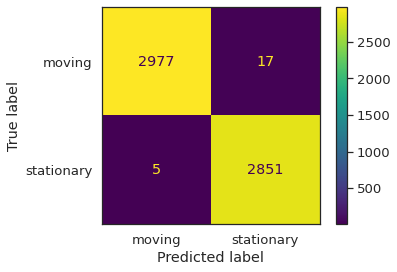

In [ ]:
# mlutilayer perceptron using ERD/ERS
start = time.time()

Label = preprocessing.LabelEncoder()
status = Label.fit_transform(dataNeural['status'])

train, test = train_test_split(dataNeural, random_state = 42)
X_train = train[train.columns[0:14]]
y_train = train['status']
X_test = test[test.columns[0:14]]
y_test = test['status']

scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

MLP = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
MLP.fit(X_train, y_train.values.ravel())

predictions = MLP.predict(X_test)
print(confusion_matrix(y_test, predictions))
print(classification_report(y_test, predictions))
print("Accuracy for multilayer perceptron:",metrics.accuracy_score(y_test, predictions))

end = time.time()
# print(f"Runtime of multilayer perceptron is {end - start}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_test, predictions, labels=MLP.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=MLP.classes_)
disp.plot()
plt.show()

# MLP_5folds = MLPClassifier(hidden_layer_sizes = (10, 10, 10), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
# scores = cross_val_score(MLP_5folds, dataNeural[dataNeural.columns[0:6]], dataNeural['status'], cv=5)
# print(scores)
# print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[[2621  373]
 [1474 1382]]
              precision    recall  f1-score   support

      moving       0.64      0.88      0.74      2994
  stationary       0.79      0.48      0.60      2856

    accuracy                           0.68      5850
   macro avg       0.71      0.68      0.67      5850
weighted avg       0.71      0.68      0.67      5850

Accuracy for SVM with linear kernel: 0.6842735042735043


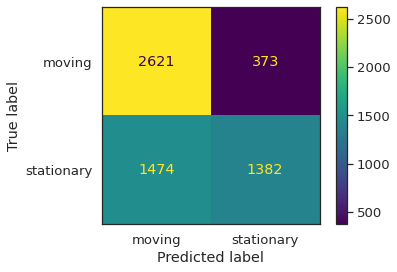

In [ ]:
# SVM with linear kernel using ERD/ERS
startSVM = time.time()

LabelSVM = preprocessing.LabelEncoder()
statusSVM = LabelSVM.fit_transform(dataNeural['status'])

trainSVM, testSVM = train_test_split(dataNeural, random_state = 42)
X_trainSVM = trainSVM[trainSVM.columns[0:14]]
y_trainSVM = trainSVM['status']
X_testSVM = testSVM[testSVM.columns[0:14]]
y_testSVM= testSVM['status']

scalerSVM = StandardScaler()
scalerSVM.fit(X_trainSVM)
X_trainSVM = scalerSVM.transform(X_trainSVM)
X_testSVM = scalerSVM.transform(X_testSVM)

clfSVM = svm.SVC(kernel = 'linear')
clfSVM.fit(X_trainSVM, y_trainSVM.values.ravel())

predictionsSVM = clfSVM.predict(X_testSVM)
print(confusion_matrix(y_testSVM, predictionsSVM))
print(classification_report(y_testSVM, predictionsSVM))
print("Accuracy for SVM with linear kernel:",metrics.accuracy_score(y_testSVM, predictionsSVM))

endSVM = time.time()
# print(f"Runtime of SVM with linear kernel is {endSVM - startSVM}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testSVM, predictionsSVM, labels=clfSVM.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clfSVM.classes_)
disp.plot()
plt.show()

# clf = svm.SVC(kernel = 'linear')
# scores = cross_val_score(clf, dataNeural[dataNeural.columns[0:6]], dataNeural['status'], cv=5)
# print(scores)
# print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[[2807  187]
 [ 877 1979]]
              precision    recall  f1-score   support

      moving       0.76      0.94      0.84      2994
  stationary       0.91      0.69      0.79      2856

    accuracy                           0.82      5850
   macro avg       0.84      0.82      0.81      5850
weighted avg       0.84      0.82      0.82      5850

Accuracy for SVM with Radial Basis Function kernel: 0.8181196581196581


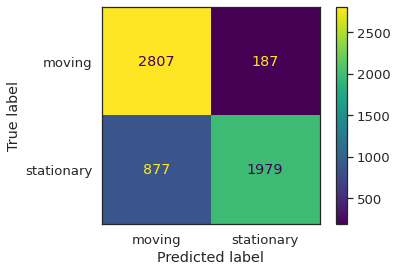

In [ ]:
# SVM with Radial Basis Function kernel using ERD/ERS
startRBF = time.time()

LabelRBF = preprocessing.LabelEncoder()
statusRBF = LabelRBF.fit_transform(dataNeural['status'])

trainRBF, testRBF = train_test_split(dataNeural, random_state = 42)
X_trainRBF = trainRBF[trainRBF.columns[0:14]]
y_trainRBF = trainRBF['status']
X_testRBF = testRBF[testRBF.columns[0:14]]
y_testRBF = testRBF['status']

scalerRBF = StandardScaler()
scalerRBF.fit(X_trainRBF)
X_trainRBF = scalerRBF.transform(X_trainRBF)
X_testRBF = scalerRBF.transform(X_testRBF)

clfRBF = svm.SVC(kernel = 'rbf')
clfRBF.fit(X_trainRBF, y_trainRBF.values.ravel())

predictionsRBF = clfRBF.predict(X_testRBF)
print(confusion_matrix(y_testRBF, predictionsRBF))
print(classification_report(y_testRBF, predictionsRBF))
print("Accuracy for SVM with Radial Basis Function kernel:",metrics.accuracy_score(y_testRBF, predictionsRBF))

endRBF = time.time()
# print(f"Runtime of SVM with Radial Basis Function kernel is {endRBF - startRBF}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testRBF, predictionsRBF, labels=clfRBF.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clfRBF.classes_)
disp.plot()
plt.show()

# clfRBF = svm.SVC(kernel = 'linear')
# scores = cross_val_score(clfRBF, dataNeural[dataNeural.columns[0:22]], dataNeural['status'], cv=5)
# print(scores)
# print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[[2990    4]
 [   2 2854]]
              precision    recall  f1-score   support

      moving       1.00      1.00      1.00      2994
  stationary       1.00      1.00      1.00      2856

    accuracy                           1.00      5850
   macro avg       1.00      1.00      1.00      5850
weighted avg       1.00      1.00      1.00      5850

Accuracy for kNN: 0.9989743589743589


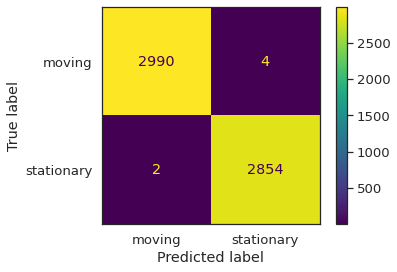

In [ ]:
# kNN using ERD/ERS
startkNN = time.time()

LabelkNN = preprocessing.LabelEncoder()
statuskNN = LabelkNN.fit_transform(dataNeural['status'])

trainkNN, testkNN = train_test_split(dataNeural, random_state = 42)
X_trainkNN = trainkNN[trainkNN.columns[0:14]]
y_trainkNN = trainkNN['status']
X_testkNN = testkNN[testkNN.columns[0:14]]
y_testkNN = testkNN['status']

scaler = StandardScaler()
scaler.fit(X_trainkNN)
X_trainkNN = scaler.transform(X_trainkNN)
X_testkNN = scaler.transform(X_testkNN)

neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(X_trainkNN, y_trainkNN.values.ravel())

predictionskNN = neigh.predict(X_testkNN)
print(confusion_matrix(y_testkNN, predictionskNN))
print(classification_report(y_testkNN, predictionskNN))
print("Accuracy for kNN:",metrics.accuracy_score(y_testkNN, predictionskNN))

endkNN = time.time()
# print(f"Runtime of kNN is {endkNN - startkNN}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testkNN, predictionskNN, labels=neigh.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=neigh.classes_)
disp.plot()
plt.show()

# neigh = KNeighborsClassifier(n_neighbors=3)
# scores = cross_val_score(neigh, dataNeural[dataNeural.columns[0:6]], dataNeural['status'], cv=5)
# print(scores)
# print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

# **This section focuses on the computation regarding Alpha frequency band for EEG data**

Plot Welch's periodogram for data from C3, Cz, C4, CP1, CP2, CP6, CP5 channels respectively for Alpha frequency band (8-12 Hz)


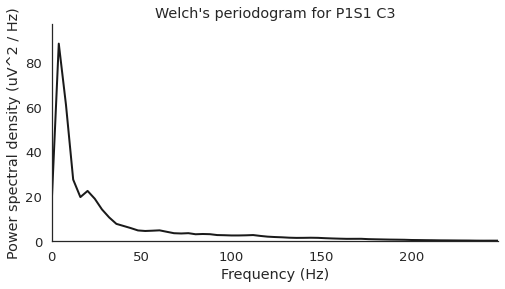

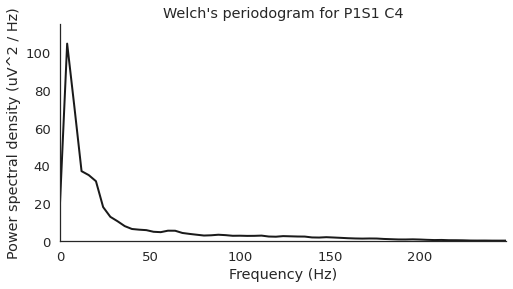

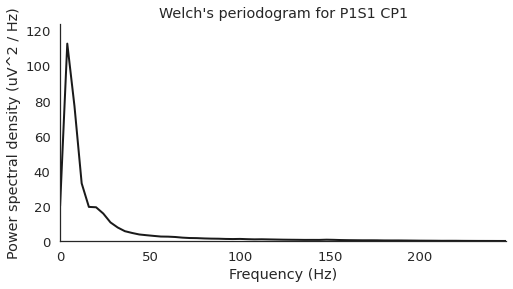

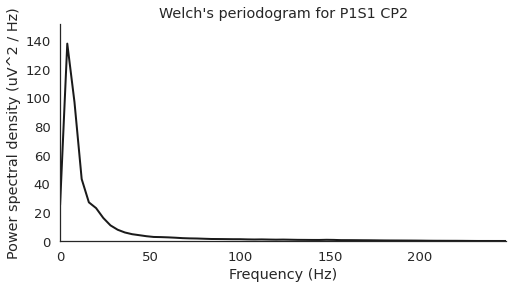

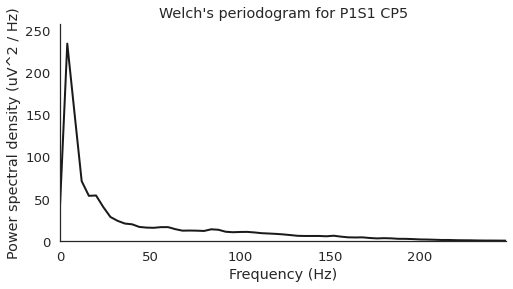

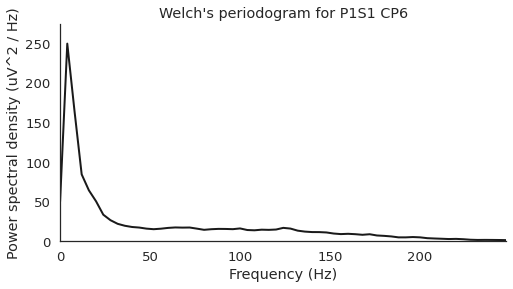

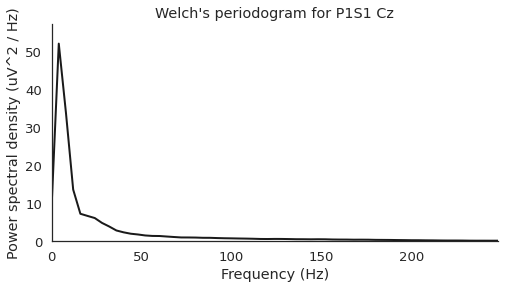

In [ ]:
from scipy import signal

# Define window length (0.25 seconds)
# Take a window sufficiently long to encompasses at least two full cycles of the lowest frequency of interest
# For Alpha frequency band, the lowest frequency of interest is 8 Hz so we choose a window of 2/8 = 0.25 Hz

win = 0.25 * sf
freqsC3, psdC3 = signal.welch(dataC3, sf, nperseg = win)
freqsC4, psdC4 = signal.welch(dataC4, sf, nperseg = win)
freqsCP1, psdCP1 = signal.welch(dataCP1, sf, nperseg = win)
freqsCP2, psdCP2 = signal.welch(dataCP2, sf, nperseg = win)
freqsCP5, psdCP5 = signal.welch(dataCP5, sf, nperseg = win)
freqsCP6, psdCP6 = signal.welch(dataCP6, sf, nperseg = win)
freqsCz, psdCz = signal.welch(dataCz, sf, nperseg = win)

# Plot the power spectrum C3
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsC3, psdC3, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdC3.max() * 1.1])
plt.title("Welch's periodogram for P1S1 C3")
plt.xlim([0, freqsC3.max()])
sns.despine()

# Plot the power spectrum C4
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsC4, psdC4, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdC4.max() * 1.1])
plt.title("Welch's periodogram for P1S1 C4")
plt.xlim([0, freqsC4.max()])
sns.despine()

# Plot the power spectrum CP1
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCP1, psdCP1, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCP1.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP1")
plt.xlim([0, freqsCP1.max()])
sns.despine()

# Plot the power spectrum CP2
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCP2, psdCP2, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCP2.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP2")
plt.xlim([0, freqsCP2.max()])
sns.despine()

# Plot the power spectrum CP5
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCP5, psdCP5, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCP5.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP5")
plt.xlim([0, freqsCP5.max()])
sns.despine()

# Plot the power spectrum CP6
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCP6, psdCP6, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCP6.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP6")
plt.xlim([0, freqsCP6.max()])
sns.despine()

# Plot the power spectrum Cz
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCz, psdCz, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCz.max() * 1.1])
plt.title("Welch's periodogram for P1S1 Cz")
plt.xlim([0, freqsCz.max()])
sns.despine()

Fill the Alpha area of Welch's periodogram for data from C3, Cz, C4, CP1, CP2, CP6, CP5 channels respectively

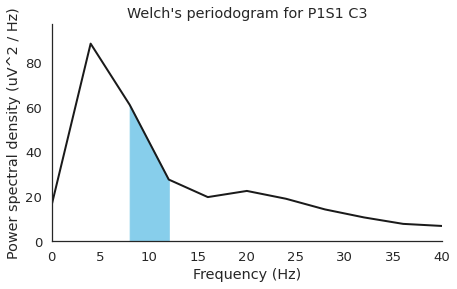

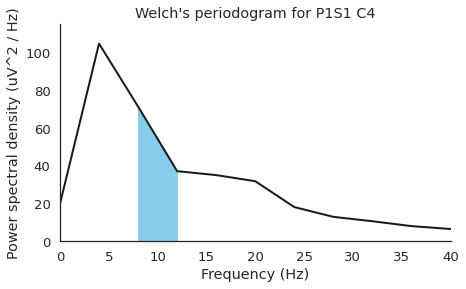

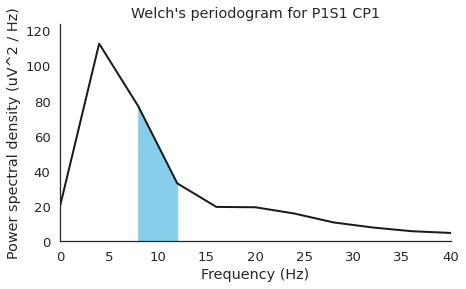

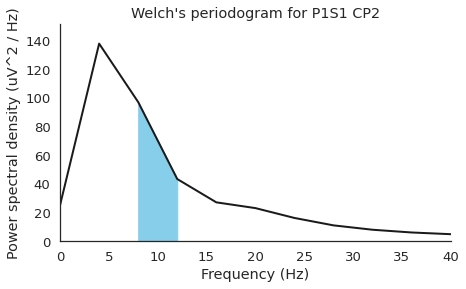

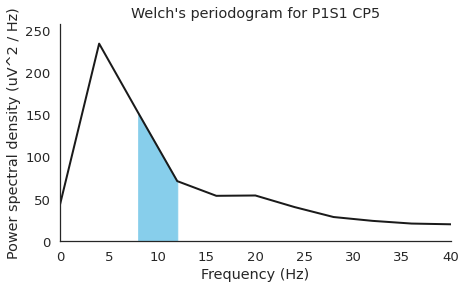

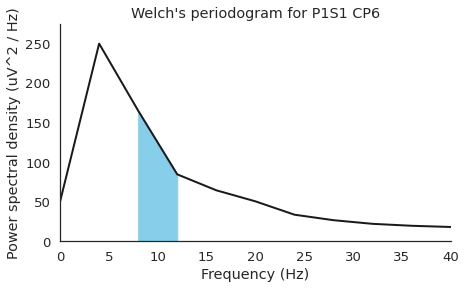

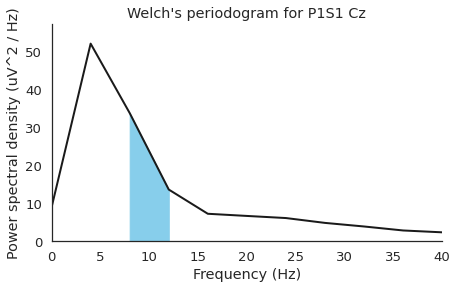

In [ ]:
# Define alpha lower and upper limits
low, high = 8, 12

# Find intersecting values in frequency vector
idx_alphaC3 = np.logical_and(freqsC3 >= low, freqsC3 <= high)
idx_alphaC4 = np.logical_and(freqsC4 >= low, freqsC4 <= high)
idx_alphaCP1 = np.logical_and(freqsCP1 >= low, freqsCP1 <= high)
idx_alphaCP2 = np.logical_and(freqsCP2 >= low, freqsCP2 <= high)
idx_alphaCP5 = np.logical_and(freqsCP5 >= low, freqsCP5 <= high)
idx_alphaCP6 = np.logical_and(freqsCP6 >= low, freqsCP6 <= high)
idx_alphaCz = np.logical_and(freqsCz >= low, freqsCz <= high)

# Plot the power spectral density and fill the alpha area C3
plt.figure(figsize = (7, 4))
plt.plot(freqsC3, psdC3, lw = 2, color = 'k')
plt.fill_between(freqsC3, psdC3, where = idx_alphaC3, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdC3.max() * 1.1])
plt.title("Welch's periodogram for P1S1 C3")
sns.despine()

# Plot the power spectral density and fill the alpha area C4
plt.figure(figsize = (7, 4))
plt.plot(freqsC4, psdC4, lw = 2, color = 'k')
plt.fill_between(freqsC4, psdC4, where = idx_alphaC4, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdC4.max() * 1.1])
plt.title("Welch's periodogram for P1S1 C4")
sns.despine()

# Plot the power spectral density and fill the alpha area CP1
plt.figure(figsize = (7, 4))
plt.plot(freqsCP1, psdCP1, lw = 2, color = 'k')
plt.fill_between(freqsCP1, psdCP1, where = idx_alphaCP1, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCP1.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP1")
sns.despine()

# Plot the power spectral density and fill the alpha area CP2
plt.figure(figsize = (7, 4))
plt.plot(freqsCP2, psdCP2, lw = 2, color = 'k')
plt.fill_between(freqsCP2, psdCP2, where = idx_alphaCP2, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCP2.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP2")
sns.despine()

# Plot the power spectral density and fill the alpha area CP5
plt.figure(figsize = (7, 4))
plt.plot(freqsCP5, psdCP5, lw = 2, color = 'k')
plt.fill_between(freqsCP5, psdCP5, where = idx_alphaCP5, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCP5.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP5")
sns.despine()

# Plot the power spectral density and fill the alpha area CP6
plt.figure(figsize = (7, 4))
plt.plot(freqsCP6, psdCP6, lw = 2, color = 'k')
plt.fill_between(freqsCP6, psdCP6, where = idx_alphaCP6, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCP6.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP6")
sns.despine()

# Plot the power spectral density and fill the alpha area Cz
plt.figure(figsize = (7, 4))
plt.plot(freqsCz, psdCz, lw = 2, color = 'k')
plt.fill_between(freqsCz, psdCz, where = idx_alphaCz, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCz.max() * 1.1])
plt.title("Welch's periodogram for P1S1 Cz")
sns.despine()

Calculate absolute Alpha power and relative Alpha power using Welch and Multitaper methods for data from C3, Cz, C4, CP1, CP2, CP6, CP5 channels respectively

In [ ]:
def bandpower(data, sf, band, method='welch', window_sec=None, relative=False):
    """Compute the average power of the signal x in a specific frequency band.

    Requires MNE-Python >= 0.14.

    Parameters
    ----------
    data : 1d-array
      Input signal in the time-domain.
    sf : float
      Sampling frequency of the data.
    band : list
      Lower and upper frequencies of the band of interest.
    method : string
      Periodogram method: 'welch' or 'multitaper'
    window_sec : float
      Length of each window in seconds. Useful only if method == 'welch'.
      If None, window_sec = (1 / min(band)) * 2.
    relative : boolean
      If True, return the relative power (= divided by the total power of the signal).
      If False (default), return the absolute power.

    Return
    ------
    bp : float
      Absolute or relative band power.
    """
    from scipy.signal import welch
    from scipy.integrate import simps
    from mne.time_frequency import psd_array_multitaper

    band = np.asarray(band)
    low, high = band

    # Compute the modified periodogram (Welch)
    if method == 'welch':
        if window_sec is not None:
            nperseg = window_sec * sf
        else:
            nperseg = (2 / low) * sf

        freqs, psd = welch(data, sf, nperseg=nperseg)

    elif method == 'multitaper':
        psd, freqs = psd_array_multitaper(data, sf, adaptive=True,
                                          normalization='full', verbose=0)

    # Frequency resolution
    freq_res = freqs[1] - freqs[0]

    # Find index of band in frequency vector
    idx_band = np.logical_and(freqs >= low, freqs <= high)

    # Integral approximation of the spectrum using parabola (Simpson's rule)
    bp = simps(psd[idx_band], dx=freq_res)

    if relative:
        bp /= simps(psd, dx=freq_res)
    return bp

In [ ]:
# Welch alpha power C3
bp_welch_C3 = bandpower(dataC3, sf, [8, 12], 'welch')
bp_rel_welch_C3 = bandpower(dataC3, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for C3: %.3f uV^2' % bp_welch_C3)
print('Relative alpha power using Welch for C3: %.3f' % bp_rel_welch_C3)

# Multitaper alpha power C3
bp_multitaper_C3 = bandpower(dataC3, sf, [8, 12], 'multitaper')
bp_rel_multitaper_C3 = bandpower(dataC3, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for C3: %.3f uV^2' % bp_multitaper_C3)
print('Relative alpha power using Multitaper for C3: %.3f' % bp_rel_multitaper_C3)
print('\n')

# Welch alpha power C4
bp_welch_C4 = bandpower(dataC4, sf, [8, 12], 'welch')
bp_rel_welch_C4 = bandpower(dataC4, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for C4: %.3f uV^2' % bp_welch_C4)
print('Relative alpha power using Welch for C4: %.3f' % bp_rel_welch_C4)

# Multitaper alpha power C4
bp_multitaper_C4 = bandpower(dataC4, sf, [8, 12], 'multitaper')
bp_rel_multitaper_C4 = bandpower(dataC4, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for C4: %.3f uV^2' % bp_multitaper_C4)
print('Relative alpha power using Multitaper for C4: %.3f' % bp_rel_multitaper_C4)
print('\n')

# Welch alpha power CP1
bp_welch_CP1 = bandpower(dataCP1, sf, [8, 12], 'welch')
bp_rel_welch_CP1 = bandpower(dataCP1, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for CP1: %.3f uV^2' % bp_welch_CP1)
print('Relative alpha power using Welch for CP1: %.3f' % bp_rel_welch_CP1)

# Multitaper alpha power CP1
bp_multitaper_CP1 = bandpower(dataCP1, sf, [8, 12], 'multitaper')
bp_rel_multitaper_CP1 = bandpower(dataCP1, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for CP1: %.3f uV^2' % bp_multitaper_CP1)
print('Relative alpha power using Multitaper for CP1: %.3f' % bp_rel_multitaper_CP1)
print('\n')

# Welch alpha power CP2
bp_welch_CP2 = bandpower(dataCP2, sf, [8, 12], 'welch')
bp_rel_welch_CP2 = bandpower(dataCP2, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for CP2: %.3f uV^2' % bp_welch_CP2)
print('Relative alpha power using Welch for CP2: %.3f' % bp_rel_welch_CP2)

# Multitaper alpha power CP2
bp_multitaper_CP2 = bandpower(dataCP2, sf, [8, 12], 'multitaper')
bp_rel_multitaper_CP2 = bandpower(dataCP2, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for CP2: %.3f uV^2' % bp_multitaper_CP2)
print('Relative alpha power using Multitaper for CP2: %.3f' % bp_rel_multitaper_CP2)
print('\n')

# Welch alpha power CP5
bp_welch_CP5 = bandpower(dataCP5, sf, [8, 12], 'welch')
bp_rel_welch_CP5 = bandpower(dataCP5, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for CP5: %.3f uV^2' % bp_welch_CP5)
print('Relative alpha power using Welch for CP5: %.3f' % bp_rel_welch_CP5)

# Multitaper alpha power CP5
bp_multitaper_CP5 = bandpower(dataCP5, sf, [8, 12], 'multitaper')
bp_rel_multitaper_CP5 = bandpower(dataCP5, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for CP5: %.3f uV^2' % bp_multitaper_CP5)
print('Relative alpha power using Multitaper for CP5: %.3f' % bp_rel_multitaper_CP5)
print('\n')

# Welch alpha power CP6
bp_welch_CP6 = bandpower(dataCP6, sf, [8, 12], 'welch')
bp_rel_welch_CP6 = bandpower(dataCP6, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for CP6: %.3f uV^2' % bp_welch_CP6)
print('Relative alpha power using Welch for CP6: %.3f' % bp_rel_welch_CP6)

# Multitaper alpha power CP6
bp_multitaper_CP6 = bandpower(dataCP6, sf, [8, 12], 'multitaper')
bp_rel_multitaper_CP6 = bandpower(dataCP6, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for CP6: %.3f uV^2' % bp_multitaper_CP6)
print('Relative alpha power using Multitaper for CP6: %.3f' % bp_rel_multitaper_CP6)
print('\n')

# Welch alpha power Cz
bp_welch_Cz = bandpower(dataCz, sf, [8, 12], 'welch')
bp_rel_welch_Cz = bandpower(dataCz, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for Cz: %.3f uV^2' % bp_welch_Cz)
print('Relative alpha power using Welch for Cz: %.3f' % bp_rel_welch_Cz)

# Multitaper alpha power Cz
bp_multitaper_Cz = bandpower(dataCz, sf, [8, 12], 'multitaper')
bp_rel_multitaper_Cz = bandpower(dataCz, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for Cz: %.3f uV^2' % bp_multitaper_Cz)
print('Relative alpha power using Multitaper for Cz: %.3f' % bp_rel_multitaper_Cz)

Absolute alpha power using Welch for C3: 177.175 uV^2
Relative alpha power using Welch for C3: 0.111
Absolute alpha power using Multitaper for C3: 139.170 uV^2
Relative alpha power using Multitaper for C3: 0.008


Absolute alpha power using Welch for C4: 217.029 uV^2
Relative alpha power using Welch for C4: 0.113
Absolute alpha power using Multitaper for C4: 193.421 uV^2
Relative alpha power using Multitaper for C4: 0.013


Absolute alpha power using Welch for CP1: 220.311 uV^2
Relative alpha power using Welch for CP1: 0.142
Absolute alpha power using Multitaper for CP1: 183.109 uV^2
Relative alpha power using Multitaper for CP1: 0.009


Absolute alpha power using Welch for CP2: 280.662 uV^2
Relative alpha power using Welch for CP2: 0.150
Absolute alpha power using Multitaper for CP2: 245.444 uV^2
Relative alpha power using Multitaper for CP2: 0.016


Absolute alpha power using Welch for CP5: 447.354 uV^2
Relative alpha power using Welch for CP5: 0.099
Absolute alpha power using Multit

# **This section focuses on the computation regarding Beta frequency band for EEG data**

Plot Welch's periodogram for data from C3, Cz, C4, CP1, CP2, CP6, CP5 channels respectively for Beta frequency band (12-30 Hz)

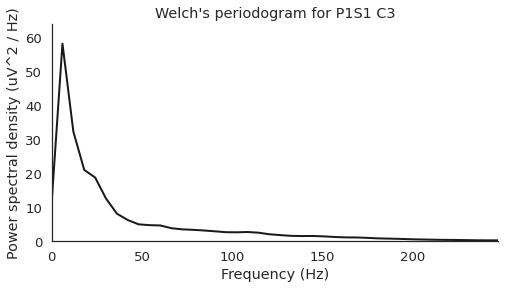

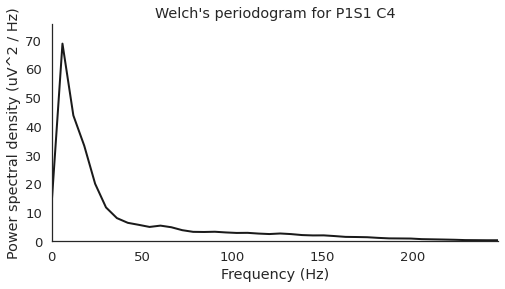

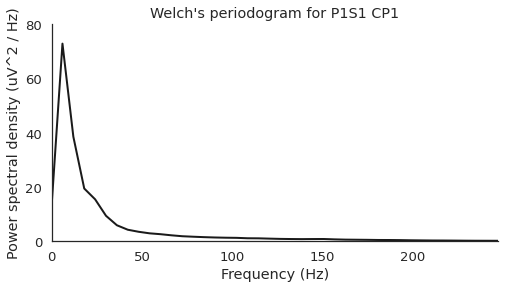

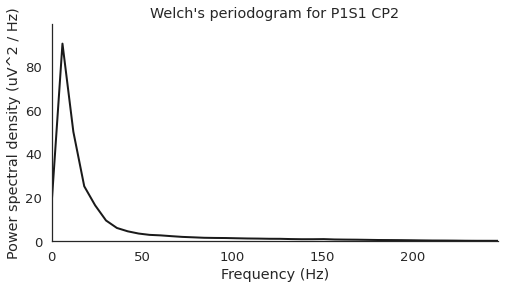

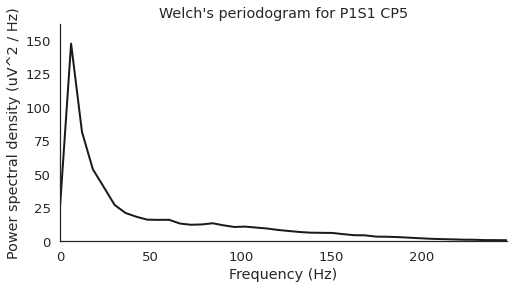

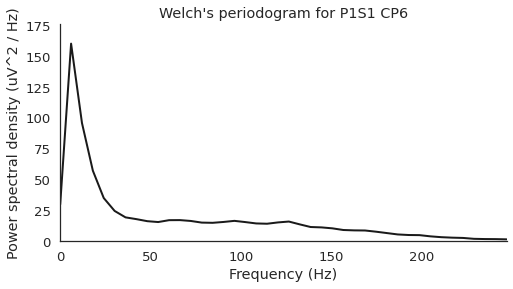

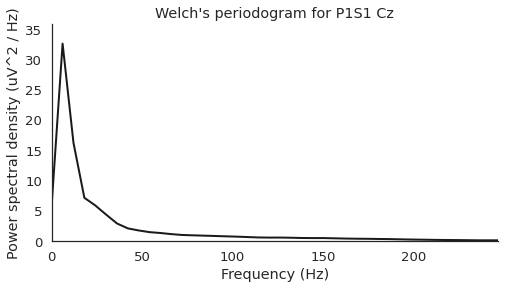

In [ ]:
from scipy import signal

# Define window length (0.167 seconds)
# Take a window sufficiently long to encompasses at least two full cycles of the lowest frequency of interest
# For Beta frequency band, the lowest frequency of interest is 12 Hz so we choose a window of 2/12 = 0.167 Hz

win = 0.167 * sf
freqsC3, psdC3 = signal.welch(dataC3, sf, nperseg = win)
freqsC4, psdC4 = signal.welch(dataC4, sf, nperseg = win)
freqsCP1, psdCP1 = signal.welch(dataCP1, sf, nperseg = win)
freqsCP2, psdCP2 = signal.welch(dataCP2, sf, nperseg = win)
freqsCP5, psdCP5 = signal.welch(dataCP5, sf, nperseg = win)
freqsCP6, psdCP6 = signal.welch(dataCP6, sf, nperseg = win)
freqsCz, psdCz = signal.welch(dataCz, sf, nperseg = win)

# Plot the power spectrum C3
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsC3, psdC3, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdC3.max() * 1.1])
plt.title("Welch's periodogram for P1S1 C3")
plt.xlim([0, freqsC3.max()])
sns.despine()

# Plot the power spectrum C4
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsC4, psdC4, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdC4.max() * 1.1])
plt.title("Welch's periodogram for P1S1 C4")
plt.xlim([0, freqsC4.max()])
sns.despine()

# Plot the power spectrum CP1
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCP1, psdCP1, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCP1.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP1")
plt.xlim([0, freqsCP1.max()])
sns.despine()

# Plot the power spectrum CP2
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCP2, psdCP2, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCP2.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP2")
plt.xlim([0, freqsCP2.max()])
sns.despine()

# Plot the power spectrum CP5
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCP5, psdCP5, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCP5.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP5")
plt.xlim([0, freqsCP5.max()])
sns.despine()

# Plot the power spectrum CP6
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCP6, psdCP6, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCP6.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP6")
plt.xlim([0, freqsCP6.max()])
sns.despine()

# Plot the power spectrum Cz
sns.set(font_scale = 1.2, style = 'white')
plt.figure(figsize = (8, 4))
plt.plot(freqsCz, psdCz, color = 'k', lw = 2)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.ylim([0, psdCz.max() * 1.1])
plt.title("Welch's periodogram for P1S1 Cz")
plt.xlim([0, freqsCz.max()])
sns.despine()

Fill the Beta area of Welch's periodogram for data from C3, Cz, C4, CP1, CP2, CP6, CP5 channels respectively

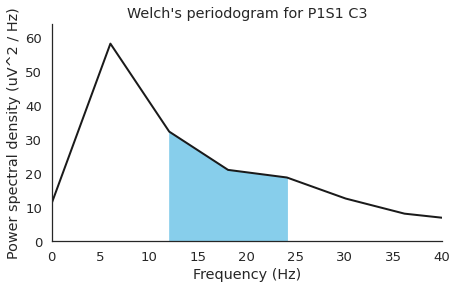

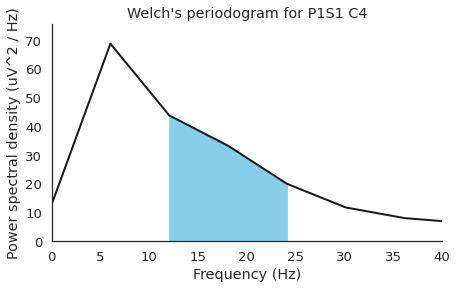

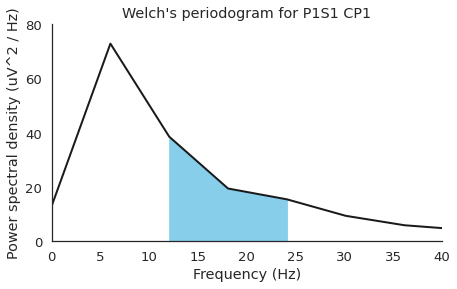

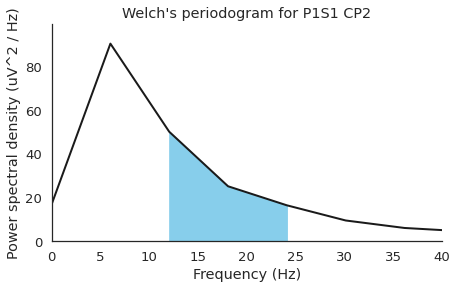

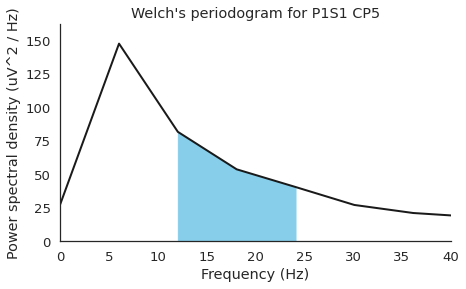

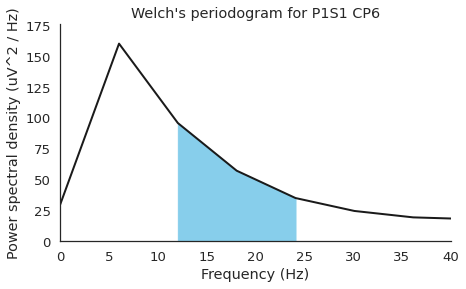

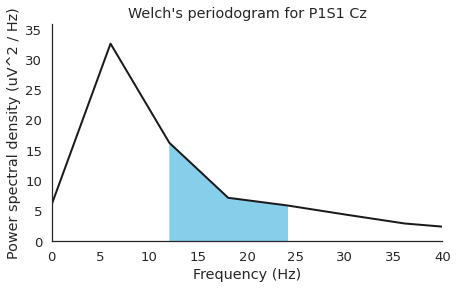

In [ ]:
# Define alpha lower and upper limits
low, high = 12, 30

# Find intersecting values in frequency vector
idx_betaC3 = np.logical_and(freqsC3 >= low, freqsC3 <= high)
idx_betaC4 = np.logical_and(freqsC4 >= low, freqsC4 <= high)
idx_betaCP1 = np.logical_and(freqsCP1 >= low, freqsCP1 <= high)
idx_betaCP2 = np.logical_and(freqsCP2 >= low, freqsCP2 <= high)
idx_betaCP5 = np.logical_and(freqsCP5 >= low, freqsCP5 <= high)
idx_betaCP6 = np.logical_and(freqsCP6 >= low, freqsCP6 <= high)
idx_betaCz = np.logical_and(freqsCz >= low, freqsCz <= high)

# Plot the power spectral density and fill the alpha area C3
plt.figure(figsize = (7, 4))
plt.plot(freqsC3, psdC3, lw = 2, color = 'k')
plt.fill_between(freqsC3, psdC3, where = idx_betaC3, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdC3.max() * 1.1])
plt.title("Welch's periodogram for P1S1 C3")
sns.despine()

# Plot the power spectral density and fill the alpha area C4
plt.figure(figsize = (7, 4))
plt.plot(freqsC4, psdC4, lw = 2, color = 'k')
plt.fill_between(freqsC4, psdC4, where = idx_betaC4, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdC4.max() * 1.1])
plt.title("Welch's periodogram for P1S1 C4")
sns.despine()

# Plot the power spectral density and fill the alpha area CP1
plt.figure(figsize = (7, 4))
plt.plot(freqsCP1, psdCP1, lw = 2, color = 'k')
plt.fill_between(freqsCP1, psdCP1, where = idx_betaCP1, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCP1.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP1")
sns.despine()

# Plot the power spectral density and fill the alpha area CP2
plt.figure(figsize = (7, 4))
plt.plot(freqsCP2, psdCP2, lw = 2, color = 'k')
plt.fill_between(freqsCP2, psdCP2, where = idx_betaCP2, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCP2.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP2")
sns.despine()

# Plot the power spectral density and fill the alpha area CP5
plt.figure(figsize = (7, 4))
plt.plot(freqsCP5, psdCP5, lw = 2, color = 'k')
plt.fill_between(freqsCP5, psdCP5, where = idx_betaCP5, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCP5.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP5")
sns.despine()

# Plot the power spectral density and fill the alpha area CP6
plt.figure(figsize = (7, 4))
plt.plot(freqsCP6, psdCP6, lw = 2, color = 'k')
plt.fill_between(freqsCP6, psdCP6, where = idx_betaCP6, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCP6.max() * 1.1])
plt.title("Welch's periodogram for P1S1 CP6")
sns.despine()

# Plot the power spectral density and fill the alpha area Cz
plt.figure(figsize = (7, 4))
plt.plot(freqsCz, psdCz, lw = 2, color = 'k')
plt.fill_between(freqsCz, psdCz, where = idx_betaCz, color = 'skyblue')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density (uV^2 / Hz)')
plt.xlim([0, 40])
plt.ylim([0, psdCz.max() * 1.1])
plt.title("Welch's periodogram for P1S1 Cz")
sns.despine()

Calculate absolute Beta power and relative Beta power using Welch and Multitaper methods for data from C3, Cz, C4, CP1, CP2, CP6, CP5 channels respectively

In [ ]:
def bandpower(data, sf, band, method='welch', window_sec=None, relative=False):
    """Compute the average power of the signal x in a specific frequency band.

    Requires MNE-Python >= 0.14.

    Parameters
    ----------
    data : 1d-array
      Input signal in the time-domain.
    sf : float
      Sampling frequency of the data.
    band : list
      Lower and upper frequencies of the band of interest.
    method : string
      Periodogram method: 'welch' or 'multitaper'
    window_sec : float
      Length of each window in seconds. Useful only if method == 'welch'.
      If None, window_sec = (1 / min(band)) * 2.
    relative : boolean
      If True, return the relative power (= divided by the total power of the signal).
      If False (default), return the absolute power.

    Return
    ------
    bp : float
      Absolute or relative band power.
    """
    from scipy.signal import welch
    from scipy.integrate import simps
    from mne.time_frequency import psd_array_multitaper

    band = np.asarray(band)
    low, high = band

    # Compute the modified periodogram (Welch)
    if method == 'welch':
        if window_sec is not None:
            nperseg = window_sec * sf
        else:
            nperseg = (2 / low) * sf

        freqs, psd = welch(data, sf, nperseg=nperseg)

    elif method == 'multitaper':
        psd, freqs = psd_array_multitaper(data, sf, adaptive=True,
                                          normalization='full', verbose=0)

    # Frequency resolution
    freq_res = freqs[1] - freqs[0]

    # Find index of band in frequency vector
    idx_band = np.logical_and(freqs >= low, freqs <= high)

    # Integral approximation of the spectrum using parabola (Simpson's rule)
    bp = simps(psd[idx_band], dx=freq_res)

    if relative:
        bp /= simps(psd, dx=freq_res)
    return bp

In [ ]:
# Welch beta power C3
bp_welch_C3 = bandpower(dataC3, sf, [12, 30], 'welch')
bp_rel_welch_C3 = bandpower(dataC3, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for C3: %.3f uV^2' % bp_welch_C3)
print('Relative beta power using Welch for C3: %.3f' % bp_rel_welch_C3)

# Multitaper beta power C3
bp_multitaper_C3 = bandpower(dataC3, sf, [12, 30], 'multitaper')
bp_rel_multitaper_C3 = bandpower(dataC3, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for C3: %.3f uV^2' % bp_multitaper_C3)
print('Relative beta power using Multitaper for C3: %.3f' % bp_rel_multitaper_C3)
print('\n')

# Welch beta power C4
bp_welch_C4 = bandpower(dataC4, sf, [12, 30], 'welch')
bp_rel_welch_C4 = bandpower(dataC4, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for C4: %.3f uV^2' % bp_welch_C4)
print('Relative beta power using Welch for C4: %.3f' % bp_rel_welch_C4)

# Multitaper beta power C4
bp_multitaper_C4 = bandpower(dataC4, sf, [12, 30], 'multitaper')
bp_rel_multitaper_C4 = bandpower(dataC4, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for C4: %.3f uV^2' % bp_multitaper_C4)
print('Relative beta power using Multitaper for C4: %.3f' % bp_rel_multitaper_C4)
print('\n')

# Welch beta power CP1
bp_welch_CP1 = bandpower(dataCP1, sf, [12, 30], 'welch')
bp_rel_welch_CP1 = bandpower(dataCP1, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for CP1: %.3f uV^2' % bp_welch_CP1)
print('Relative beta power using Welch for CP1: %.3f' % bp_rel_welch_CP1)

# Multitaper beta power CP1
bp_multitaper_CP1 = bandpower(dataCP1, sf, [12, 30], 'multitaper')
bp_rel_multitaper_CP1 = bandpower(dataCP1, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for CP1: %.3f uV^2' % bp_multitaper_CP1)
print('Relative beta power using Multitaper for CP1: %.3f' % bp_rel_multitaper_CP1)
print('\n')

# Welch beta power CP2
bp_welch_CP2 = bandpower(dataCP2, sf, [12, 30], 'welch')
bp_rel_welch_CP2 = bandpower(dataCP2, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for CP2: %.3f uV^2' % bp_welch_CP2)
print('Relative beta power using Welch for CP2: %.3f' % bp_rel_welch_CP2)

# Multitaper beta power CP2
bp_multitaper_CP2 = bandpower(dataCP2, sf, [12, 30], 'multitaper')
bp_rel_multitaper_CP2 = bandpower(dataCP2, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for CP2: %.3f uV^2' % bp_multitaper_CP2)
print('Relative beta power using Multitaper for CP2: %.3f' % bp_rel_multitaper_CP2)
print('\n')

# Welch beta power CP5
bp_welch_CP5 = bandpower(dataCP5, sf, [12, 30], 'welch')
bp_rel_welch_CP5 = bandpower(dataCP5, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for CP5: %.3f uV^2' % bp_welch_CP5)
print('Relative beta power using Welch for CP5: %.3f' % bp_rel_welch_CP5)

# Multitaper beta power CP5
bp_multitaper_CP5 = bandpower(dataCP5, sf, [12, 30], 'multitaper')
bp_rel_multitaper_CP5 = bandpower(dataCP5, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for CP5: %.3f uV^2' % bp_multitaper_CP5)
print('Relative beta power using Multitaper for CP5: %.3f' % bp_rel_multitaper_CP5)
print('\n')

# Welch beta power CP6
bp_welch_CP6 = bandpower(dataCP6, sf, [12, 30], 'welch')
bp_rel_welch_CP6 = bandpower(dataCP6, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for CP6: %.3f uV^2' % bp_welch_CP6)
print('Relative beta power using Welch for CP6: %.3f' % bp_rel_welch_CP6)

# Multitaper beta power CP6
bp_multitaper_CP6 = bandpower(dataCP6, sf, [12, 30], 'multitaper')
bp_rel_multitaper_CP6 = bandpower(dataCP6, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for CP6: %.3f uV^2' % bp_multitaper_CP6)
print('Relative beta power using Multitaper for CP6: %.3f' % bp_rel_multitaper_CP6)
print('\n')

# Welch beta power Cz
bp_welch_Cz = bandpower(dataCz, sf, [12, 30], 'welch')
bp_rel_welch_Cz = bandpower(dataCz, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for Cz: %.3f uV^2' % bp_welch_Cz)
print('Relative beta power using Welch for Cz: %.3f' % bp_rel_welch_Cz)

# Multitaper beta power Cz
bp_multitaper_Cz = bandpower(dataCz, sf, [12, 30], 'multitaper')
bp_rel_multitaper_Cz = bandpower(dataCz, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for Cz: %.3f uV^2' % bp_multitaper_Cz)
print('Relative beta power using Multitaper for Cz: %.3f' % bp_rel_multitaper_Cz)

Absolute beta power using Welch for C3: 270.775 uV^2
Relative beta power using Welch for C3: 0.197
Absolute beta power using Multitaper for C3: 336.240 uV^2
Relative beta power using Multitaper for C3: 0.019


Absolute beta power using Welch for C4: 395.183 uV^2
Relative beta power using Welch for C4: 0.236
Absolute beta power using Multitaper for C4: 447.856 uV^2
Relative beta power using Multitaper for C4: 0.030


Absolute beta power using Welch for CP1: 265.479 uV^2
Relative beta power using Welch for CP1: 0.208
Absolute beta power using Multitaper for CP1: 294.979 uV^2
Relative beta power using Multitaper for CP1: 0.015


Absolute beta power using Welch for CP2: 335.915 uV^2
Relative beta power using Welch for CP2: 0.219
Absolute beta power using Multitaper for CP2: 359.635 uV^2
Relative beta power using Multitaper for CP2: 0.023


Absolute beta power using Welch for CP5: 676.261 uV^2
Relative beta power using Welch for CP5: 0.173
Absolute beta power using Multitaper for CP5: 810.0

# **This section does Principal Component Analysis for EEG data**

This section contains three different methods of calculating PCA. By comparing the results among them, we can ensure the correctness of results

In [ ]:
# Combine data from different channels to a 2D array
combined = np.column_stack((dataC3, dataC4, dataCP1, dataCP2, dataCP5, dataCP6, dataCz))

The first method of calculating PCA with standardisation

In [ ]:
# This cell is the first method of calculating PCA with standardisation
import pandas as pd
# Creating a Pandas DataFrame of original 2D array
df = pd.DataFrame(combined, columns = ['C3', 'C4', 'CP1', 'CP2', 'CP5' , 'CP6', 'Cz'])
print(df)

# Standardise the data
from sklearn.preprocessing import StandardScaler

# Separating out the features
x = df.iloc[:, 0:7].values

# Standardizing the features
x = StandardScaler().fit_transform(x)

# PCA projection to 2D
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents, columns = ['PC1', 'PC2'])
print(principalDf, '\n')

# Explained Varience
pca.explained_variance_ratio_

          C3     C4    CP1    CP2   CP5    CP6     Cz
0      201.0  554.0  269.0  455.0  47.0  307.0  233.0
1      198.0  542.0  250.0  452.0  52.0  273.0  207.0
2      212.0  542.0  276.0  432.0  41.0  258.0  221.0
3      242.0  545.0  288.0  444.0  89.0  275.0  230.0
4      209.0  560.0  283.0  469.0  60.0  288.0  224.0
...      ...    ...    ...    ...   ...    ...    ...
51667   32.0  225.0   85.0  -50.0 -91.0  -15.0 -138.0
51668   45.0  223.0   85.0  -44.0 -60.0   21.0 -134.0
51669   78.0  218.0   93.0  -49.0 -47.0   19.0 -118.0
51670   54.0  217.0   86.0  -60.0 -77.0   -3.0 -124.0
51671   30.0  233.0   74.0  -60.0 -91.0   -9.0 -127.0

[51672 rows x 7 columns]
            PC1       PC2
0      3.128176 -1.063048
1      2.878717 -1.115900
2      2.942668 -0.982354
3      3.281471 -0.936227
4      3.207043 -1.152077
...         ...       ...
51667 -2.500931  1.343407
51668 -2.305661  1.417984
51669 -2.122104  1.503428
51670 -2.373741  1.471670
51671 -2.482088  1.391188

[51672 rows x

array([0.74974548, 0.07344397])

The second method of calculating PCA with standardisation (i.e., use to print out all the explained variences)

In [ ]:
# This cell is the second method of calculating PCA with standardisation
import pandas as pd
# Creating a Pandas DataFrame of original 2D array
combined = pd.DataFrame(combined, columns = ['C3', 'C4', 'CP1', 'CP2', 'CP5' , 'CP6', 'Cz'])

# Data scaling
from sklearn.preprocessing import StandardScaler
X_scaled = StandardScaler().fit_transform(combined)
X_scaled[:7]

#Covariance matrix
features = X_scaled.T
cov_matrix = np.cov(features)
cov_matrix[:7]

# Eigendecomposition 
values, vectors = np.linalg.eig(cov_matrix)
values[:7]
vectors[:7]

# Calculate the percentage of explained variance per principal component
explained_variances = []
for i in range(len(values)):
    explained_variances.append(values[i] / np.sum(values))
 
print(np.sum(explained_variances))
print(explained_variances)

0.9999999999999999
[0.7497454784604356, 0.012588564422724177, 0.018389744933361252, 0.07344397270232028, 0.06426667805723611, 0.036149515542794775, 0.04541604588112777]


From the above calculation, we can observe that the very first two principal components (i.e., PC1 and PC2) can provide us a relatively good approximation of the whole data set, which is about 82.3%.

The third method pf calculating PCA without standardisation (not useful, use the above two methods instead)

In [ ]:
def PCA(X , num_components):
     
    # Subtract the mean of each variable
    X_meaned = X - np.mean(X , axis = 0)
     
    # Calculate the covarience matrix
    cov_mat = np.cov(X_meaned , rowvar = False)
     
    # Compute the eigenvectors and eigenvalues
    eigen_values , eigen_vectors = np.linalg.eigh(cov_mat)
     
    # Sort eigenvalues in descending order
    sorted_index = np.argsort(eigen_values)[::-1]
    sorted_eigenvalue = eigen_values[sorted_index]
    sorted_eigenvectors = eigen_vectors[:,sorted_index]
     
    # Select a subset from the rearranged eigenvalue matrix
    # Select the first n eigenvectors, n is desired dimension of our final reduced data.
    eigenvector_subset = sorted_eigenvectors[:,0:num_components]
     
    # Transform the data
    X_reduced = np.dot(eigenvector_subset.transpose() , X_meaned.transpose() ).transpose()
     
    return X_reduced

In [ ]:
# This cell is the third method of calculating PCA without standardization 
import pandas as pd
# Creating a Pandas DataFrame of original 2D array
combined = pd.DataFrame(combined, columns = ['C3', 'C4', 'CP1', 'CP2', 'CP5' , 'CP6', 'Cz'])
print(combined, '\n')

# Prepare the data
x = combined.iloc[:, 0:7].values

data_reduced = PCA(x, 2)

# Creating a Pandas DataFrame of reduced Dataset
principal_df = pd.DataFrame(data_reduced, columns = ['PC1','PC2'])

print(principal_df)

          C3     C4    CP1    CP2   CP5    CP6     Cz
0      201.0  554.0  269.0  455.0  47.0  307.0  233.0
1      198.0  542.0  250.0  452.0  52.0  273.0  207.0
2      212.0  542.0  276.0  432.0  41.0  258.0  221.0
3      242.0  545.0  288.0  444.0  89.0  275.0  230.0
4      209.0  560.0  283.0  469.0  60.0  288.0  224.0
...      ...    ...    ...    ...   ...    ...    ...
51667   32.0  225.0   85.0  -50.0 -91.0  -15.0 -138.0
51668   45.0  223.0   85.0  -44.0 -60.0   21.0 -134.0
51669   78.0  218.0   93.0  -49.0 -47.0   19.0 -118.0
51670   54.0  217.0   86.0  -60.0 -77.0   -3.0 -124.0
51671   30.0  233.0   74.0  -60.0 -91.0   -9.0 -127.0

[51672 rows x 7 columns] 

              PC1         PC2
0     -400.660445   34.545717
1     -362.611187   53.229520
2     -360.550982   54.932050
3     -408.831532   74.544731
4     -404.533129   64.444512
...           ...         ...
51667  301.226370 -186.650636
51668  261.075618 -195.145205
51669  243.453318 -184.299293
51670  283.225219 -191.9

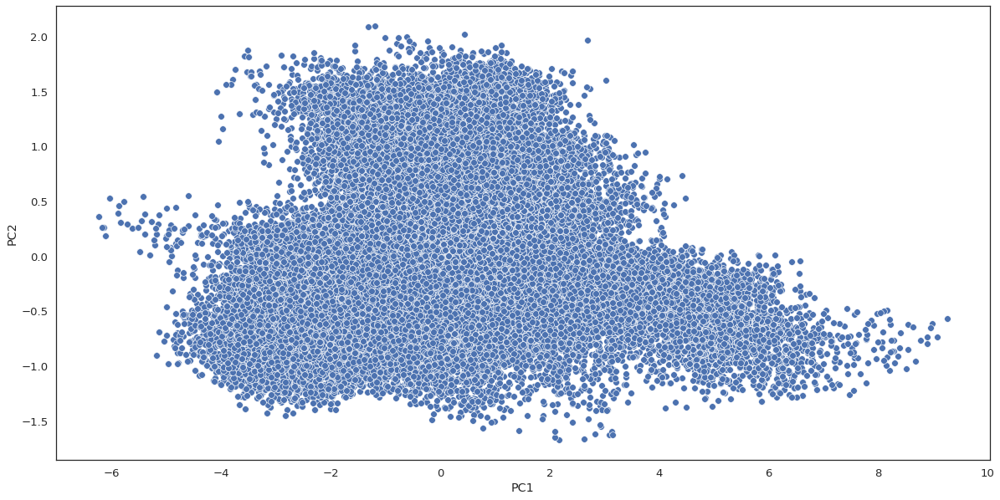

In [ ]:
# This cell is to visualise the dataset after PCA without standardisation
import seaborn as sb
import matplotlib.pyplot as plt
 
plt.figure(figsize = (20,10))
sb.scatterplot(data = principalDf , x = 'PC1',y = 'PC2', s = 60 , palette= 'icefire')

# **This section does Linear Discriminant Analysis for EEG data**

In [ ]:
# Create label for data
# For each trial, the first 2 seconds are rest (i.e., before LED is on), the following 3 - 4 seconds depending on each trial are forward
# movement and lifting (i.e., before LED is off), the remaining time is for the target to move his/her hand backward to the original position
# There are total 3 features, namely Rest, Forward and Lift and Backward 
target1 = ['Rest'] * 2000 + ['Forward and Lift'] * 2213 + ['Backward'] * (int(C3_1.size) - 4213)
target2 = ['Rest'] * 2000 + ['Forward and Lift'] * 1934 + ['Backward'] * (int(C3_2.size) - 3934)
target3 = ['Rest'] * 2000 + ['Forward and Lift'] * 1760 + ['Backward'] * (int(C3_3.size) - 3760)
target4 = ['Rest'] * 2000 + ['Forward and Lift'] * 1716 + ['Backward'] * (int(C3_4.size) - 3716)
target5 = ['Rest'] * 2000 + ['Forward and Lift'] * 1902 + ['Backward'] * (int(C3_5.size) - 3902)
target6 = ['Rest'] * 2000 + ['Forward and Lift'] * 1742 + ['Backward'] * (int(C3_6.size) - 3742)
target7 = ['Rest'] * 2000 + ['Forward and Lift'] * 1740 + ['Backward'] * (int(C3_7.size) - 3740)
target8 = ['Rest'] * 2000 + ['Forward and Lift'] * 1869 + ['Backward'] * (int(C3_8.size) - 3869)
target9 = ['Rest'] * 2000 + ['Forward and Lift'] * 1667 + ['Backward'] * (int(C3_9.size) - 3667)
target10 = ['Rest'] * 2000 + ['Forward and Lift'] * 1652 + ['Backward'] * (int(C3_10.size) - 3652)
target11 = ['Rest'] * 2000 + ['Forward and Lift'] * 1698 + ['Backward'] * (int(C3_11.size) - 3698)
target12 = ['Rest'] * 2000 + ['Forward and Lift'] * 1767 + ['Backward'] * (int(C3_12.size) - 3767)
labels = target1 + target2 + target3 + target4 + target5 + target6 + target7 + target8 + target9 + target10 + target11 + target12

# Combine data from different channels to a 2D array
combined = np.column_stack((dataC3, dataC4, dataCP1, dataCP2, dataCP5, dataCP6, dataCz, labels))

In [ ]:
# This cell is the first method of calculating PCA with standardisation
import pandas as pd
# Creating a Pandas DataFrame of original 2D array
df = pd.DataFrame(combined, columns = ['C3', 'C4', 'CP1', 'CP2', 'CP5' , 'CP6', 'Cz', 'Labels'])
print(df, '\n')

# Standardise the data
from sklearn.preprocessing import StandardScaler
features = ['C3', 'C4', 'CP1', 'CP2', 'CP5' , 'CP6', 'Cz']

# Separating out the features
x = df.loc[:, features].values
y = df.loc[:, ['Labels']].values

# Standardizing the features
x = StandardScaler().fit_transform(x)

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
lda = LDA(n_components=2)
X_lda = lda.fit_transform(x, y)
lda_Df = pd.DataFrame(data = X_lda, columns = ['LDA component 1', 'LDA component 2'])
print(lda_Df, '\n')
finalDf = pd.concat([lda_Df, df[['Labels']]], axis = 1)

print(finalDf, '\n')

# Explained Varience
lda.explained_variance_ratio_

          C3     C4    CP1    CP2    CP5    CP6      Cz    Labels
0      201.0  554.0  269.0  455.0   47.0  307.0   233.0      Rest
1      198.0  542.0  250.0  452.0   52.0  273.0   207.0      Rest
2      212.0  542.0  276.0  432.0   41.0  258.0   221.0      Rest
3      242.0  545.0  288.0  444.0   89.0  275.0   230.0      Rest
4      209.0  560.0  283.0  469.0   60.0  288.0   224.0      Rest
...      ...    ...    ...    ...    ...    ...     ...       ...
51667   32.0  225.0   85.0  -50.0  -91.0  -15.0  -138.0  Backward
51668   45.0  223.0   85.0  -44.0  -60.0   21.0  -134.0  Backward
51669   78.0  218.0   93.0  -49.0  -47.0   19.0  -118.0  Backward
51670   54.0  217.0   86.0  -60.0  -77.0   -3.0  -124.0  Backward
51671   30.0  233.0   74.0  -60.0  -91.0   -9.0  -127.0  Backward

[51672 rows x 8 columns] 



/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


       LDA component 1  LDA component 2
0            -1.098859        -1.109376
1            -0.938370        -1.045608
2            -1.185648        -0.685609
3            -0.899310        -0.836873
4            -1.098477        -1.077665
...                ...              ...
51667        -0.684830         2.062181
51668        -0.458905         1.789801
51669        -0.447032         1.897719
51670        -0.603486         2.071833
51671        -0.535945         2.213159

[51672 rows x 2 columns] 

       LDA component 1  LDA component 2    Labels
0            -1.098859        -1.109376      Rest
1            -0.938370        -1.045608      Rest
2            -1.185648        -0.685609      Rest
3            -0.899310        -0.836873      Rest
4            -1.098477        -1.077665      Rest
...                ...              ...       ...
51667        -0.684830         2.062181  Backward
51668        -0.458905         1.789801  Backward
51669        -0.447032         1.897719  B

array([0.81310434, 0.18689566])

# **Data visualisation for EMG in time domain**

Using the dataset of the results of lifting 330g objects from participant 1 series 1 (WS_P1_S1) </br>
Plot data from Brachoradial, Flexor Digitorum and Common Extensor Digitorum channels respectively

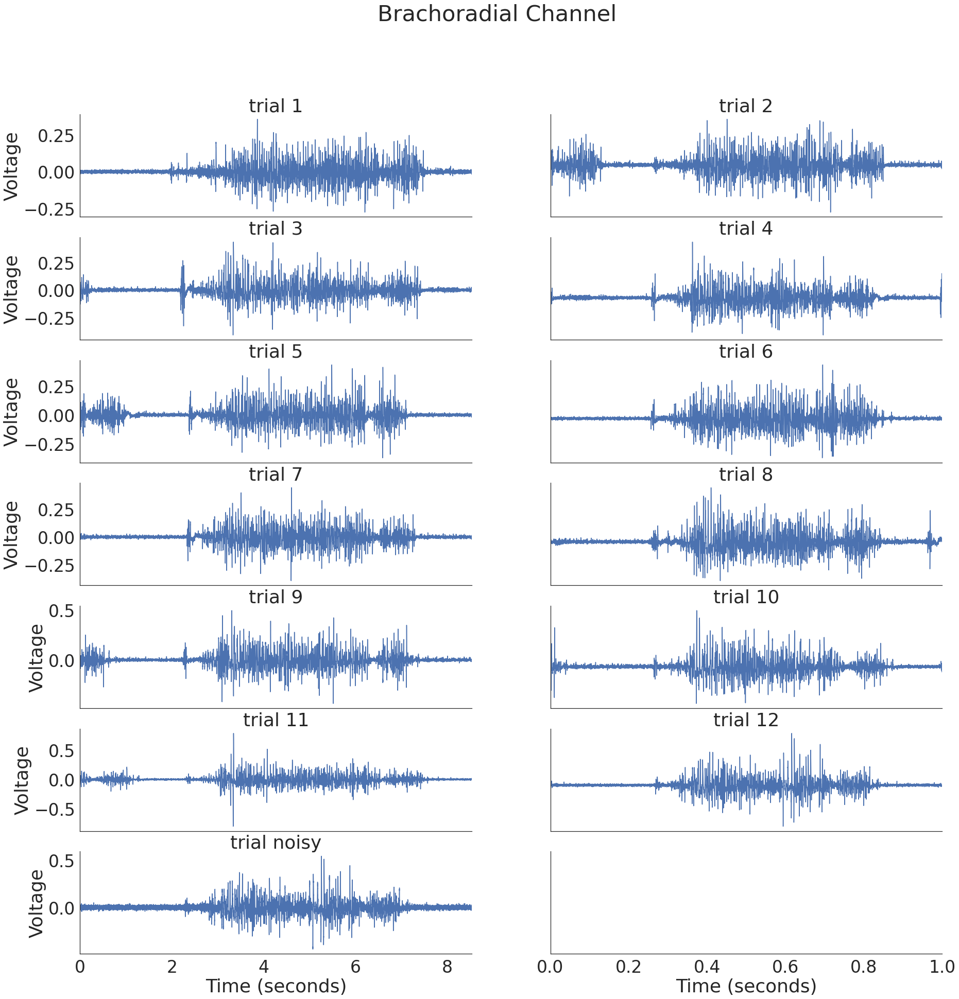

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(font_scale = 3, style = 'white')

sf = 4000.
AD = [AD_1, AD_2, AD_3, AD_4, AD_5, AD_6, AD_7, AD_8, AD_9, AD_10, AD_11, AD_12, AD_12_noisy]
B = [B_1, B_2, B_3, B_4, B_5, B_6, B_7, B_8, B_9, B_10, B_11, B_12, B_12_noisy]
FD = [FD_1, FD_2, FD_3, FD_4, FD_5, FD_6, FD_7, FD_8, FD_9, FD_10, FD_11, FD_12, FD_12_noisy]
CED = [CED_1, CED_2, CED_3, CED_4, CED_5, CED_6, CED_7, CED_8, CED_9, CED_10, CED_11, CED_12, CED_12_noisy]
FDI = [FDI_1, FDI_2, FDI_3, FDI_4, FDI_5, FDI_6, FDI_7, FDI_8, FDI_9, FDI_10, FDI_11, FDI_12, FDI_12_noisy]

time_B = []

for x in B:
  time_B.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(7, 2, figsize = (30, 30))
fig.suptitle('Brachoradial Channel')
axs[0, 0].plot(time_B[0], B[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_B[0].min(), time_B[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_B[1], B[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_B[1].min(), time_B[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_B[2], B[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_B[2].min(), time_B[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_B[3], B[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_B[3].min(), time_B[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_B[4], B[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_B[4].min(), time_B[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_B[5], B[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_B[5].min(), time_B[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_B[6], B[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_B[6].min(), time_B[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_B[7], B[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_B[7].min(), time_B[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_B[8], B[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_B[8].min(), time_B[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_B[9], B[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_B[9].min(), time_B[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_B[10], B[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_B[10].min(), time_B[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_B[11], B[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_B[11].min(), time_B[11].max()])
axs[5, 1].set_title('trial 12')
axs[6, 0].plot(time_B[12], B[12], lw = 1.5, color = 'b')
axs[6, 0].set_xlim([time_B[12].min(), time_B[12].max()])
axs[6, 0].set_title('trial noisy')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/B time domain.png')

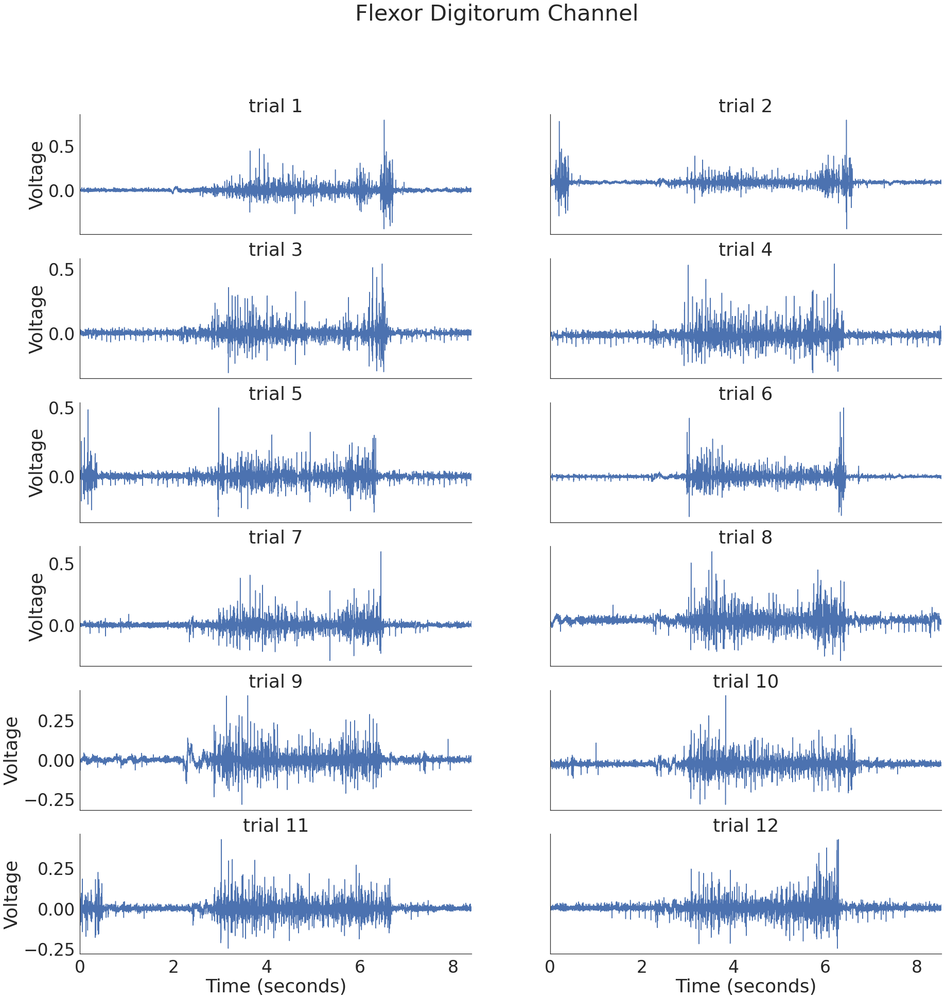

In [ ]:
time_FD = []

for x in FD:
  time_FD.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Flexor Digitorum Channel')
axs[0, 0].plot(time_FD[0], FD[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_FD[0].min(), time_FD[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_FD[1], FD[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_FD[1].min(), time_FD[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_FD[2], FD[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_FD[2].min(), time_FD[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_FD[3], FD[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_FD[3].min(), time_FD[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_FD[4], FD[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_FD[4].min(), time_FD[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_FD[5], FD[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_FD[5].min(), time_FD[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_FD[6], FD[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_FD[6].min(), time_FD[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_FD[7], FD[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_FD[7].min(), time_FD[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_FD[8], FD[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_FD[8].min(), time_FD[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_FD[9], FD[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_FD[9].min(), time_FD[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_FD[10], FD[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_FD[10].min(), time_FD[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_FD[11], FD[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_FD[11].min(), time_FD[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/FD time domain.png')

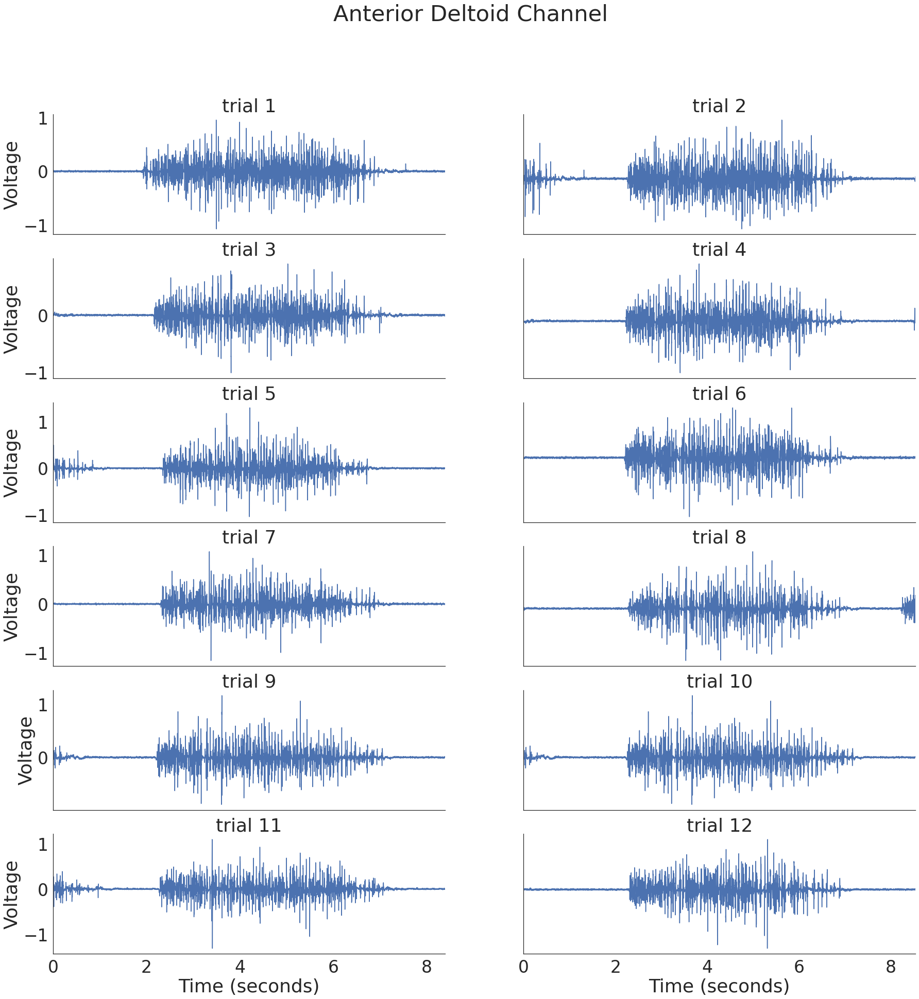

In [ ]:
time_AD = []

for x in AD:
  time_AD.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Anterior Deltoid Channel')
axs[0, 0].plot(time_AD[0], AD[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_AD[0].min(), time_AD[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_AD[1], AD[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_AD[1].min(), time_AD[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_AD[2], AD[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_AD[2].min(), time_AD[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_AD[3], AD[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_AD[3].min(), time_AD[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_AD[4], AD[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_AD[4].min(), time_AD[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_AD[5], AD[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_AD[5].min(), time_AD[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_AD[6], AD[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_AD[6].min(), time_AD[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_AD[7], AD[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_AD[7].min(), time_AD[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_AD[8], AD[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_AD[8].min(), time_AD[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_AD[9], AD[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_AD[9].min(), time_AD[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_AD[10], AD[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_AD[10].min(), time_AD[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_AD[11], AD[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_AD[11].min(), time_AD[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/AD time domain.png')

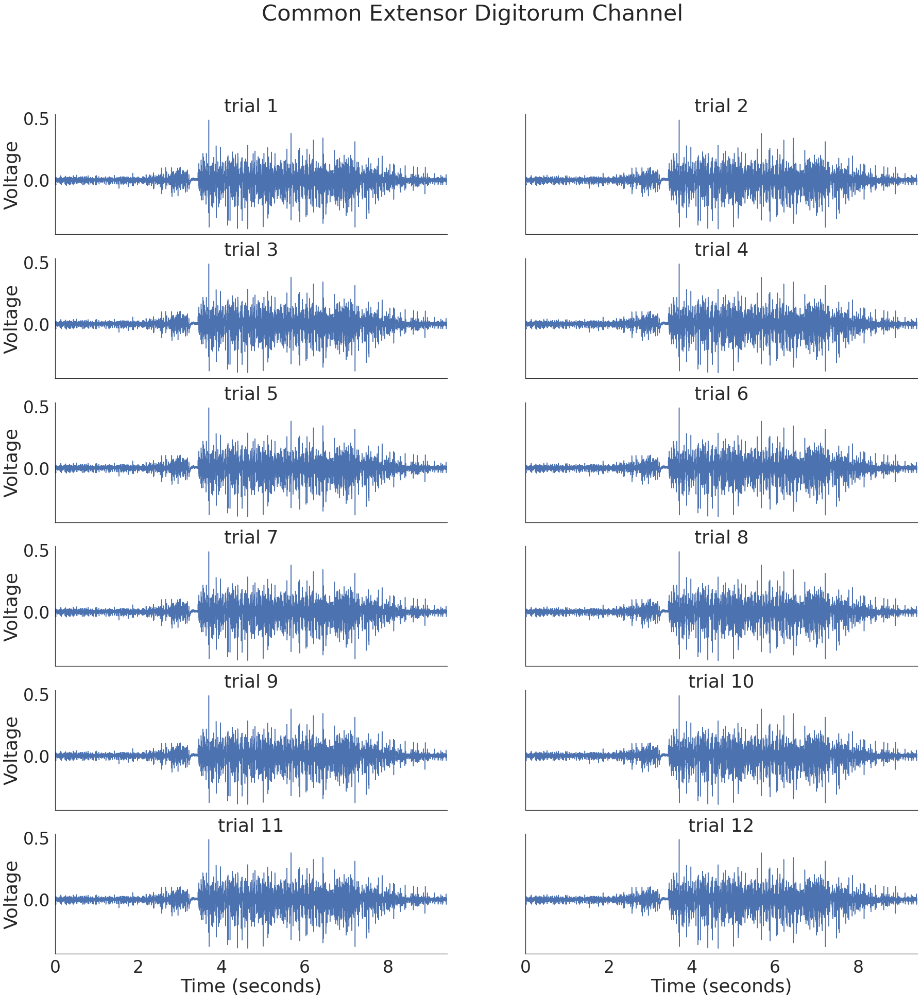

In [ ]:
time_CED = []

for x in CED:
  time_CED.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Common Extensor Digitorum Channel')
axs[0, 0].plot(time_CED[0], CED[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_CED[0].min(), time_CED[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_CED[1], CED[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_CED[1].min(), time_CED[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_CED[2], CED[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_CED[2].min(), time_CED[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_CED[3], CED[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_CED[3].min(), time_CED[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_CED[4], CED[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_CED[4].min(), time_CED[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_CED[5], CED[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_CED[5].min(), time_CED[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_CED[6], CED[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_CED[6].min(), time_CED[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_CED[7], CED[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_CED[7].min(), time_CED[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_CED[8], CED[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_CED[8].min(), time_CED[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_CED[9], CED[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_CED[9].min(), time_CED[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_CED[10], CED[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_CED[10].min(), time_CED[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_CED[11], CED[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_CED[11].min(), time_CED[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CED time domain.png')

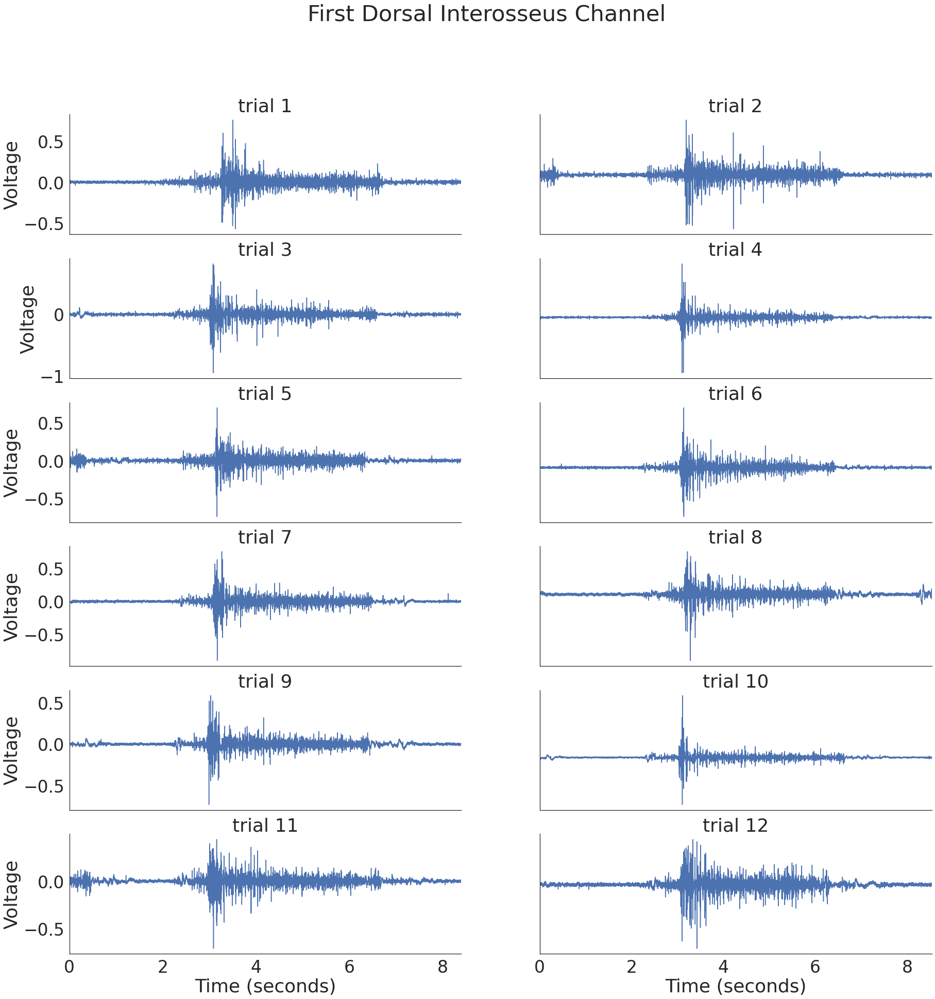

In [ ]:
time_FDI = []

for x in FDI:
  time_FDI.append(np.arange(x.size) / sf)

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('First Dorsal Interosseus Channel')
axs[0, 0].plot(time_FDI[0], FDI[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([time_FDI[0].min(), time_FDI[0].max()])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(time_FDI[1], FDI[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([time_FDI[1].min(), time_FDI[1].max()])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(time_FDI[2], FDI[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([time_FDI[2].min(), time_FDI[2].max()])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(time_FDI[3], FDI[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([time_FDI[3].min(), time_FDI[3].max()])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(time_FDI[4], FDI[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([time_FDI[4].min(), time_FDI[4].max()])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(time_FDI[5], FDI[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([time_FDI[5].min(), time_FDI[5].max()])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(time_FDI[6], FDI[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([time_FDI[6].min(), time_FDI[6].max()])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(time_FDI[7], FDI[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([time_FDI[7].min(), time_FDI[7].max()])
axs[3, 1].set_title('trial 8')
axs[4, 0].plot(time_FDI[8], FDI[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([time_FDI[8].min(), time_FDI[8].max()])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(time_FDI[9], FDI[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([time_FDI[9].min(), time_FDI[9].max()])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(time_FDI[10], FDI[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([time_FDI[10].min(), time_FDI[10].max()])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(time_FDI[11], FDI[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([time_FDI[11].min(), time_FDI[11].max()])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Time (seconds)', ylabel='Voltage')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/FDI time domain.png')

# **Data visualisation for EMG in frequency domain**

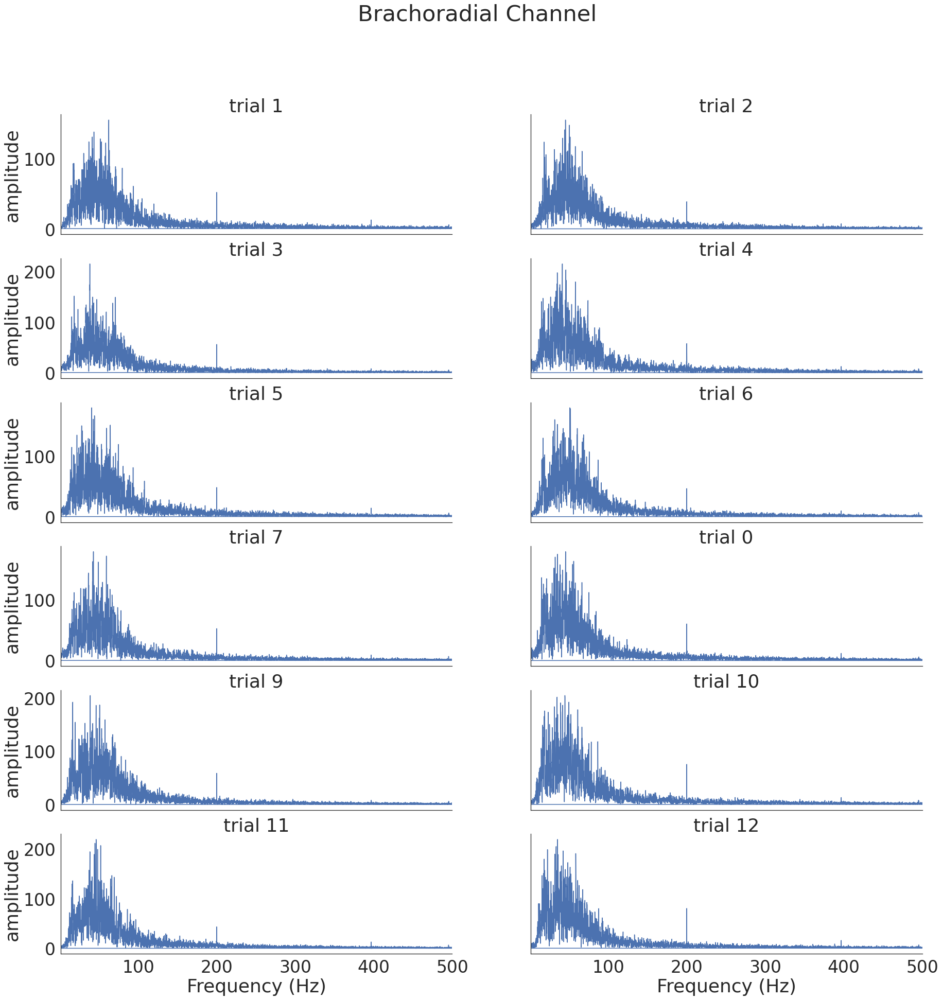

In [ ]:
from scipy.fft import fft, fftfreq

sf = 4000.
AD = [AD_1, AD_2, AD_3, AD_4, AD_5, AD_6, AD_7, AD_8, AD_9, AD_10, AD_11, AD_12]
B = [B_1, B_2, B_3, B_4, B_5, B_6, B_7, B_8, B_9, B_10, B_11, B_12]
FD = [FD_1, FD_2, FD_3, FD_4, FD_5, FD_6, FD_7, FD_8, FD_9, FD_10, FD_11, FD_12]
CED = [CED_1, CED_2, CED_3, CED_4, CED_5, CED_6, CED_7, CED_8, CED_9, CED_10, CED_11, CED_12]
FDI = [FDI_1, FDI_2, FDI_3, FDI_4, FDI_5, FDI_6, FDI_7, FDI_8, FDI_9, FDI_10, FDI_11, FDI_12]

amplitude_B = []
frequency_B = []

for x in B:
  amplitude_B.append(np.abs(fft(x)))
  frequency_B.append(fftfreq(len(x), 1/sf))

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Brachoradial Channel')
axs[0, 0].plot(frequency_B[0], amplitude_B[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 500])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_B[1], amplitude_B[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 500])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_B[2], amplitude_B[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 500])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_B[3], amplitude_B[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 500])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_B[4], amplitude_B[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 500])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_B[5], amplitude_B[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 500])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_B[6], amplitude_B[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 500])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_B[7], amplitude_B[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 500])
axs[3, 1].set_title('trial 0')
axs[4, 0].plot(frequency_B[8], amplitude_B[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 500])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_B[9], amplitude_B[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 500])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_B[10], amplitude_B[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 500])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_B[11], amplitude_B[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 500])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/B frequency domain.png')

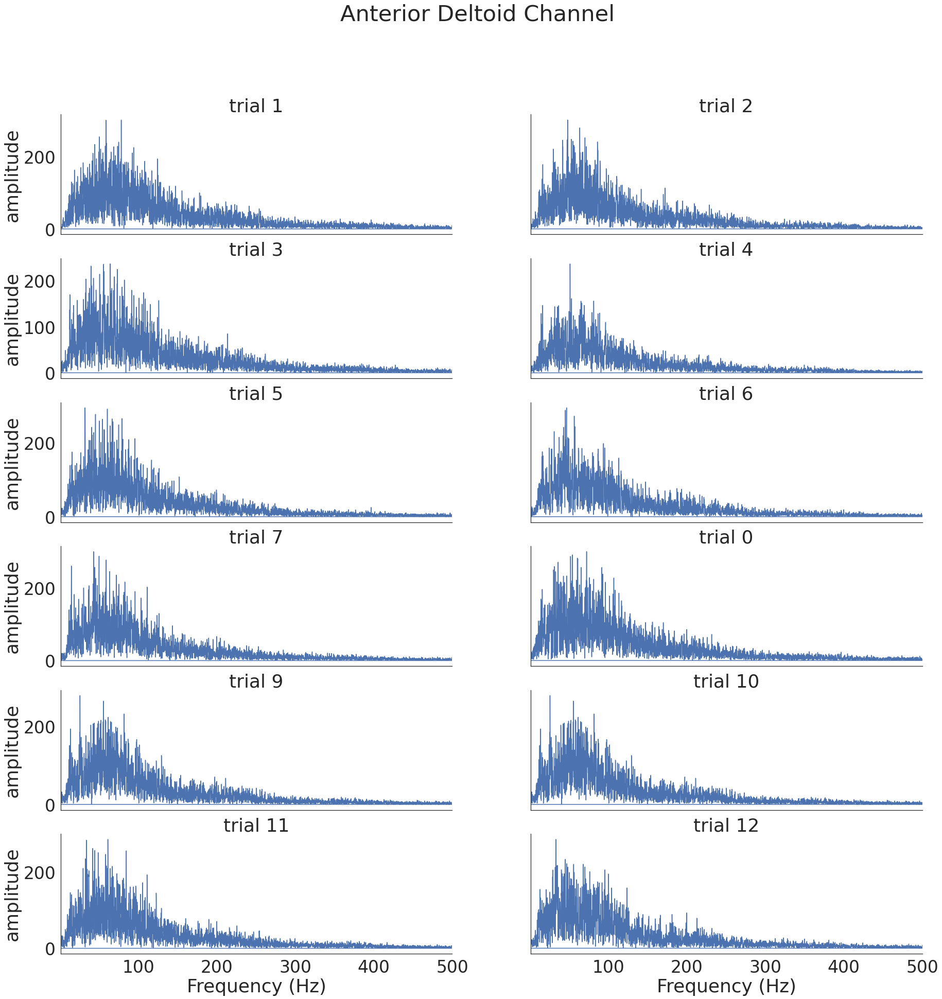

In [ ]:
amplitude_AD = []
frequency_AD = []

for x in AD:
  amplitude_AD.append(np.abs(fft(x)))
  frequency_AD.append(fftfreq(len(x), 1/sf))

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Anterior Deltoid Channel')
axs[0, 0].plot(frequency_AD[0], amplitude_AD[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 500])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_AD[1], amplitude_AD[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 500])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_AD[2], amplitude_AD[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 500])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_AD[3], amplitude_AD[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 500])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_AD[4], amplitude_AD[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 500])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_AD[5], amplitude_AD[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 500])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_AD[6], amplitude_AD[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 500])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_AD[7], amplitude_AD[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 500])
axs[3, 1].set_title('trial 0')
axs[4, 0].plot(frequency_AD[8], amplitude_AD[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 500])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_AD[9], amplitude_AD[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 500])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_AD[10], amplitude_AD[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 500])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_AD[11], amplitude_AD[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 500])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/AD frequency domain.png')

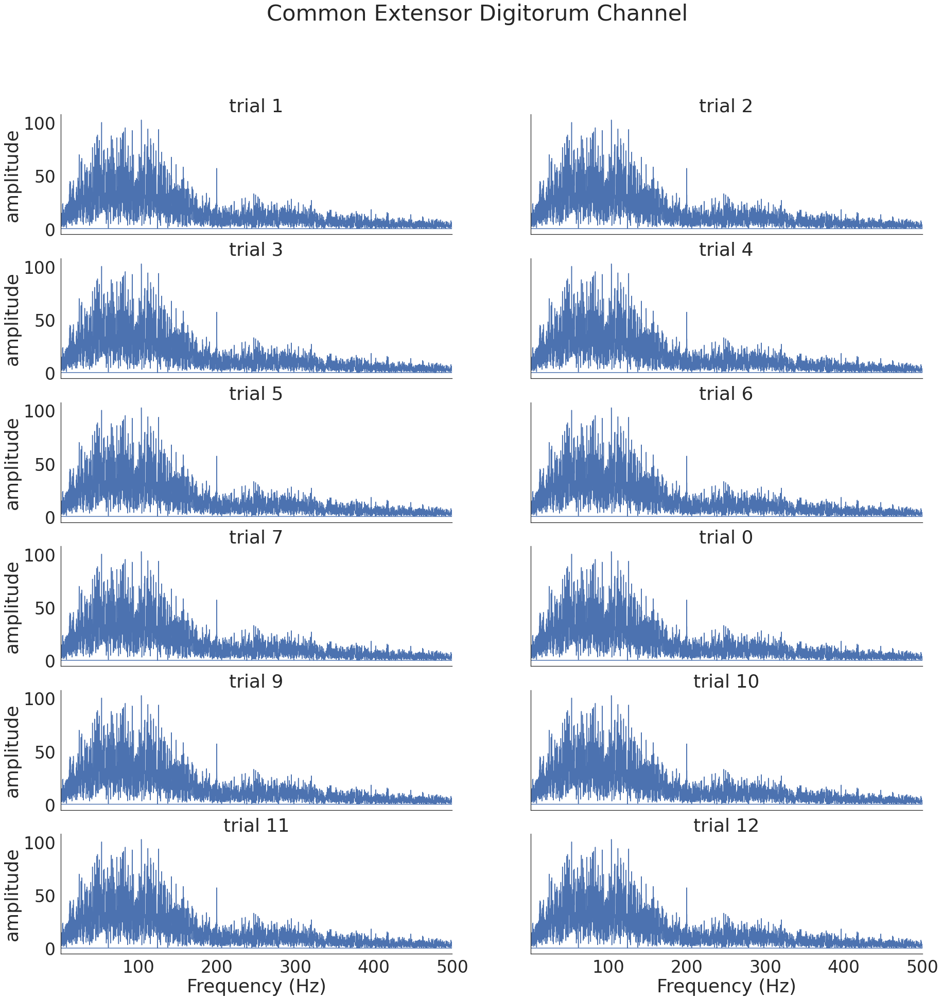

In [ ]:
amplitude_CED = []
frequency_CED = []

for x in CED:
  amplitude_CED.append(np.abs(fft(x)))
  frequency_CED.append(fftfreq(len(x), 1/sf))

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Common Extensor Digitorum Channel')
axs[0, 0].plot(frequency_CED[0], amplitude_CED[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 500])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_CED[1], amplitude_CED[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 500])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_CED[2], amplitude_CED[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 500])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_CED[3], amplitude_CED[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 500])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_CED[4], amplitude_CED[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 500])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_CED[5], amplitude_CED[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 500])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_CED[6], amplitude_CED[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 500])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_CED[7], amplitude_CED[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 500])
axs[3, 1].set_title('trial 0')
axs[4, 0].plot(frequency_CED[8], amplitude_CED[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 500])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_CED[9], amplitude_CED[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 500])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_CED[10], amplitude_CED[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 500])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_CED[11], amplitude_CED[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 500])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/CED frequency domain.png')

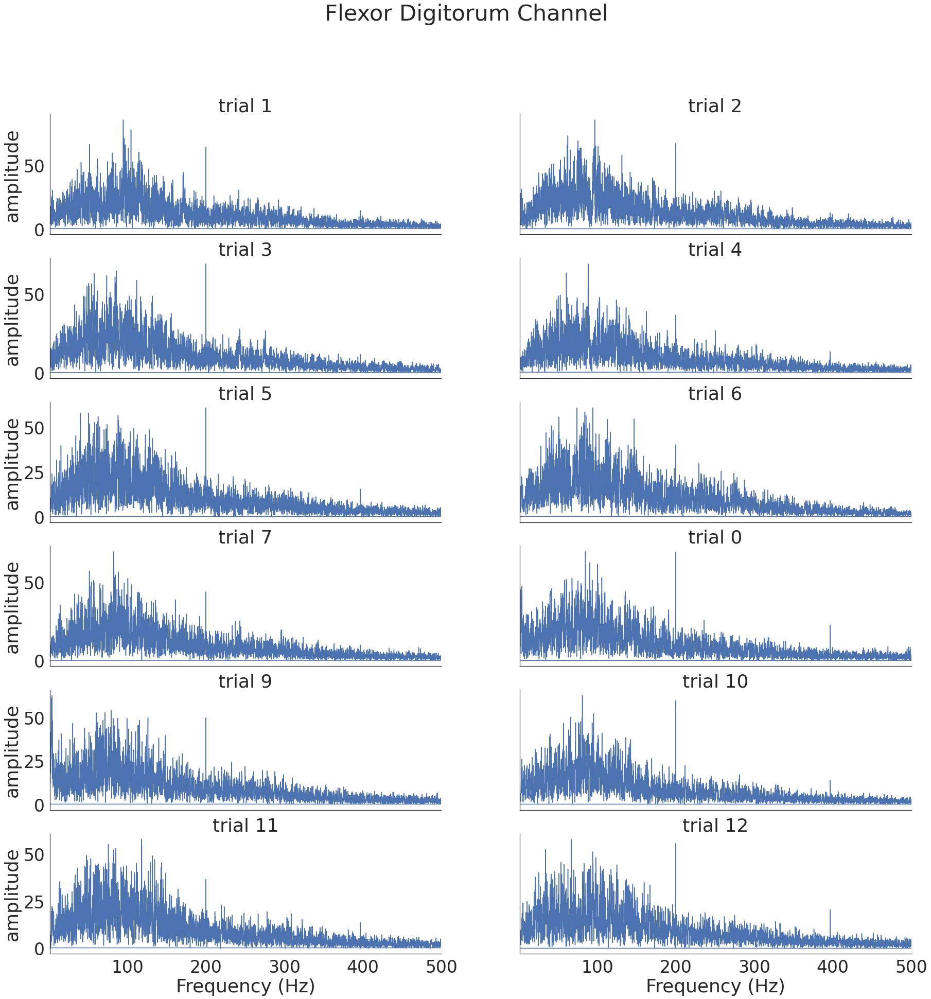

In [ ]:
amplitude_FD = []
frequency_FD = []

for x in FD:
  amplitude_FD.append(np.abs(fft(x)))
  frequency_FD.append(fftfreq(len(x), 1/sf))

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('Flexor Digitorum Channel')
axs[0, 0].plot(frequency_FD[0], amplitude_FD[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 500])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_FD[1], amplitude_FD[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 500])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_FD[2], amplitude_FD[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 500])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_FD[3], amplitude_FD[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 500])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_FD[4], amplitude_FD[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 500])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_FD[5], amplitude_FD[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 500])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_FD[6], amplitude_FD[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 500])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_FD[7], amplitude_FD[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 500])
axs[3, 1].set_title('trial 0')
axs[4, 0].plot(frequency_FD[8], amplitude_FD[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 500])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_FD[9], amplitude_FD[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 500])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_FD[10], amplitude_FD[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 500])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_FD[11], amplitude_FD[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 500])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/FD frequency domain.png')

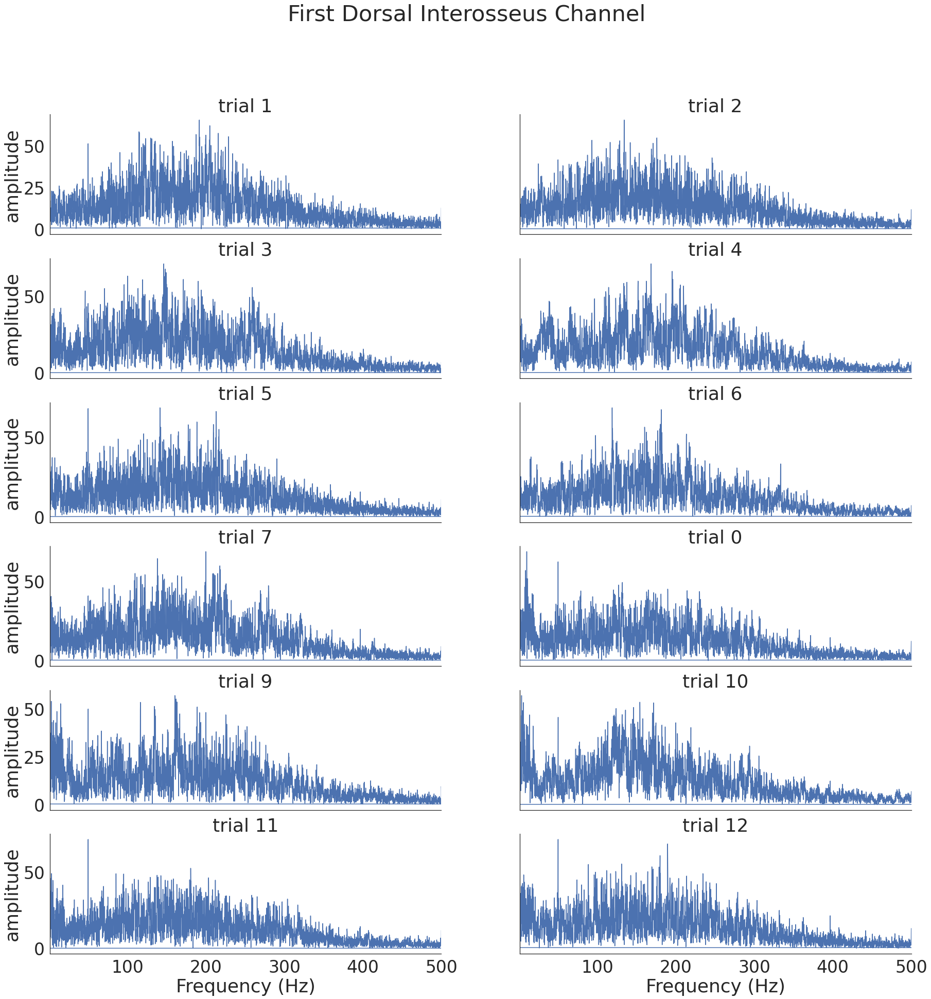

In [ ]:
amplitude_FDI = []
frequency_FDI = []

for x in FDI:
  amplitude_FDI.append(np.abs(fft(x)))
  frequency_FDI.append(fftfreq(len(x), 1/sf))

fig, axs = plt.subplots(6, 2, figsize = (30, 30))
fig.suptitle('First Dorsal Interosseus Channel')
axs[0, 0].plot(frequency_FDI[0], amplitude_FDI[0], lw = 1.5, color = 'b')
axs[0, 0].set_xlim([1, 500])
axs[0, 0].set_title('trial 1')
axs[0, 1].plot(frequency_FDI[1], amplitude_FDI[1], lw = 1.5, color = 'b')
axs[0, 1].set_xlim([1, 500])
axs[0, 1].set_title('trial 2')
axs[1, 0].plot(frequency_FDI[2], amplitude_FDI[2], lw = 1.5, color = 'b')
axs[1, 0].set_xlim([1, 500])
axs[1, 0].set_title('trial 3')
axs[1, 1].plot(frequency_FDI[3], amplitude_FDI[3], lw = 1.5, color = 'b')
axs[1, 1].set_xlim([1, 500])
axs[1, 1].set_title('trial 4')
axs[2, 0].plot(frequency_FDI[4], amplitude_FDI[4], lw = 1.5, color = 'b')
axs[2, 0].set_xlim([1, 500])
axs[2, 0].set_title('trial 5')
axs[2, 1].plot(frequency_FDI[5], amplitude_FDI[5], lw = 1.5, color = 'b')
axs[2, 1].set_xlim([1, 500])
axs[2, 1].set_title('trial 6')
axs[3, 0].plot(frequency_FDI[6], amplitude_FDI[6], lw = 1.5, color = 'b')
axs[3, 0].set_xlim([1, 500])
axs[3, 0].set_title('trial 7')
axs[3, 1].plot(frequency_FDI[7], amplitude_FDI[7], lw = 1.5, color = 'b')
axs[3, 1].set_xlim([1, 500])
axs[3, 1].set_title('trial 0')
axs[4, 0].plot(frequency_FDI[8], amplitude_FDI[8], lw = 1.5, color = 'b')
axs[4, 0].set_xlim([1, 500])
axs[4, 0].set_title('trial 9')
axs[4, 1].plot(frequency_FDI[9], amplitude_FDI[9], lw = 1.5, color = 'b')
axs[4, 1].set_xlim([1, 500])
axs[4, 1].set_title('trial 10')
axs[5, 0].plot(frequency_FDI[10], amplitude_FDI[10], lw = 1.5, color = 'b')
axs[5, 0].set_xlim([1, 500])
axs[5, 0].set_title('trial 11')
axs[5, 1].plot(frequency_FDI[11], amplitude_FDI[11], lw = 1.5, color = 'b')
axs[5, 1].set_xlim([1, 500])
axs[5, 1].set_title('trial 12')

for ax in axs.flat:
    ax.set(xlabel='Frequency (Hz)', ylabel='amplitude')

for ax in axs.flat:
    ax.label_outer()

sns.despine()
plt.savefig('/content/drive/MyDrive/UROP/plotting/FDI frequency domain.png')

# **Spectrogram for EMG**

In [ ]:
def spectrogram_plot(data, index):
  from scipy import signal
  from scipy.fft import fftshift
  import matplotlib.pyplot as plt
  fs = 4000
  x = data
  f, t, Sxx = signal.spectrogram(x, fs)
  plt.pcolormesh(t, f, Sxx, shading='gouraud')
  plt.ylabel('Frequency [Hz]')
  plt.xlabel('Time [sec]')
  plt.ylim([1, 300])
  plt.title('trial ' + str(index))
  plt.colorbar()
  plt.savefig('/content/drive/MyDrive/UROP/plotting/trail ' + str(index) + '.png')
  plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(font_scale = 1.2, style = 'white')

AD = [AD_1, AD_2, AD_3, AD_4, AD_5, AD_6, AD_7, AD_8, AD_9, AD_10, AD_11, AD_12]
B = [B_1, B_2, B_3, B_4, B_5, B_6, B_7, B_8, B_9, B_10, B_11, B_12]
FD = [FD_1, FD_2, FD_3, FD_4, FD_5, FD_6, FD_7, FD_8, FD_9, FD_10, FD_11, FD_12]
CED = [CED_1, CED_2, CED_3, CED_4, CED_5, CED_6, CED_7, CED_8, CED_9, CED_10, CED_11, CED_12]
FDI = [FDI_1, FDI_2, FDI_3, FDI_4, FDI_5, FDI_6, FDI_7, FDI_8, FDI_9, FDI_10, FDI_11, FDI_12]

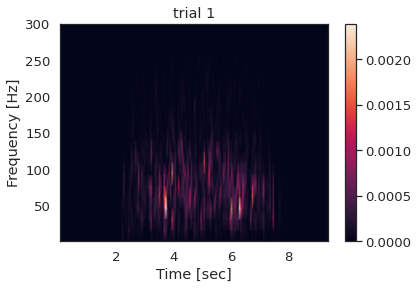

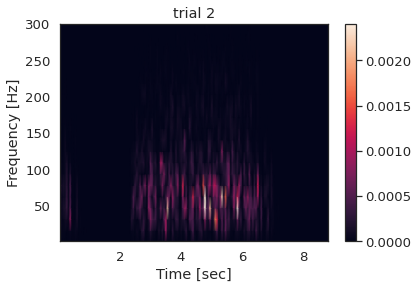

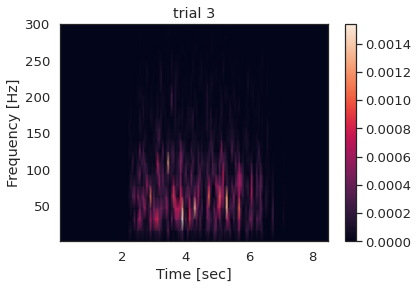

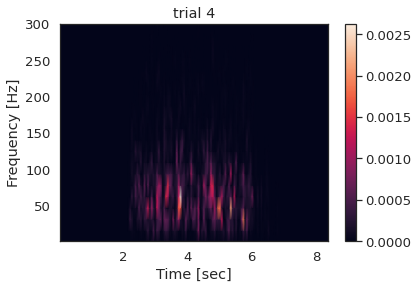

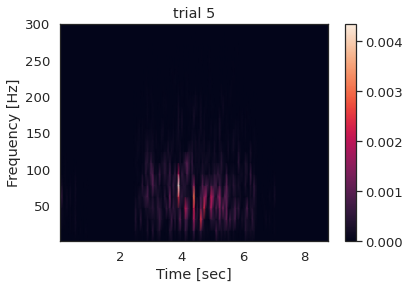

...

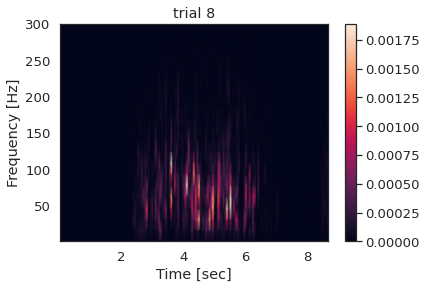

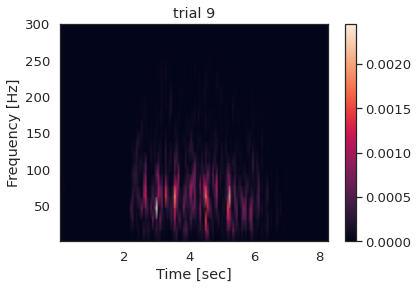

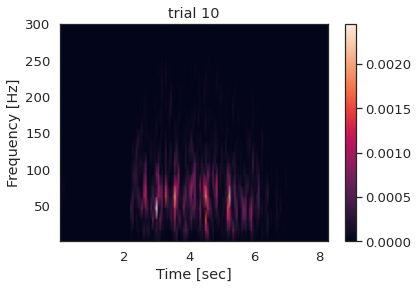

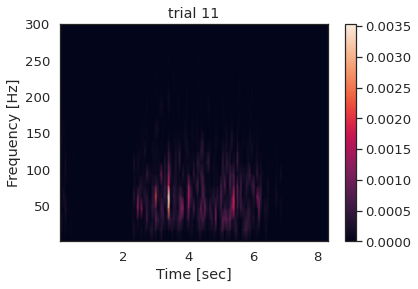

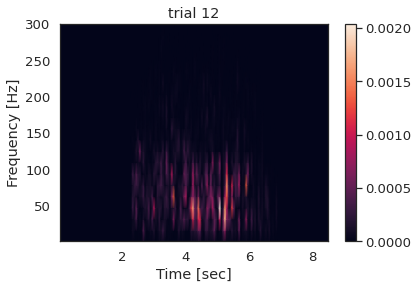

In [ ]:
for x in range(12):
  spectrogram_plot(AD[x], x+1)

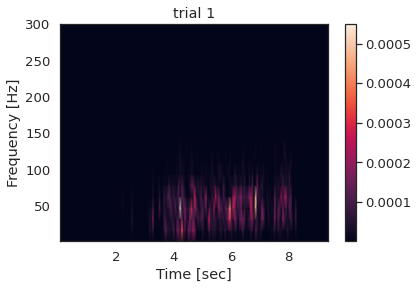

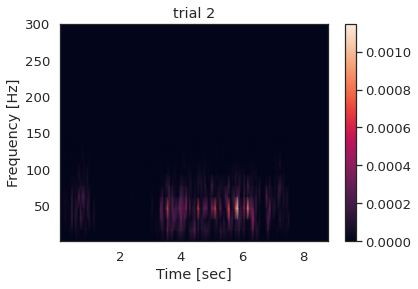

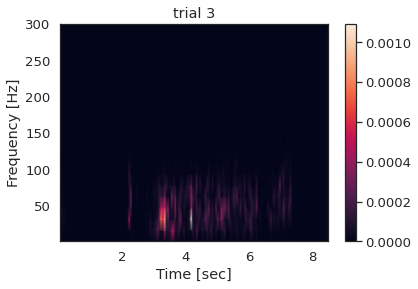

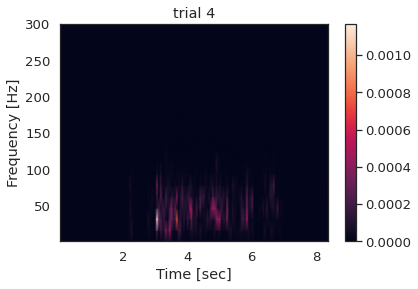

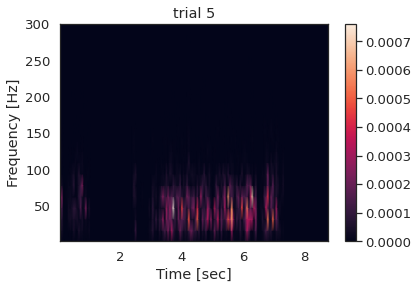

...

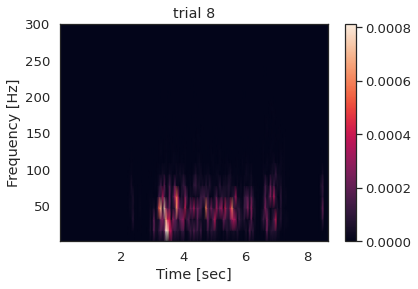

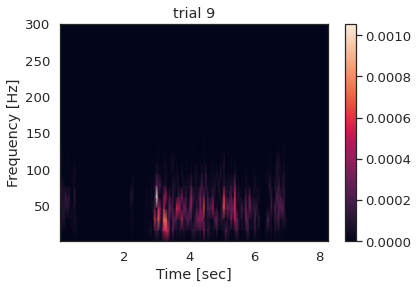

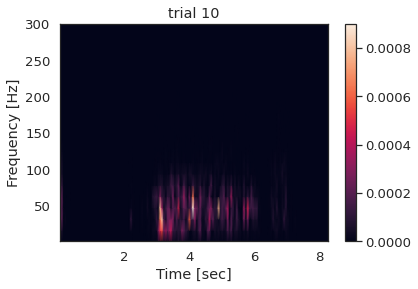

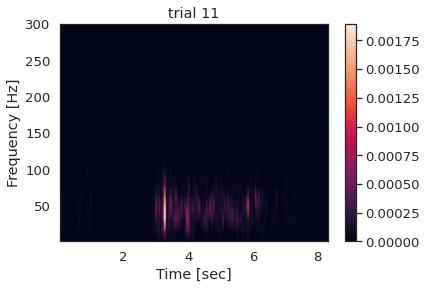

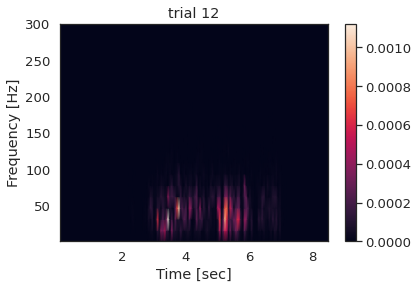

In [ ]:
for x in range(12):
  spectrogram_plot(B[x], x+1)

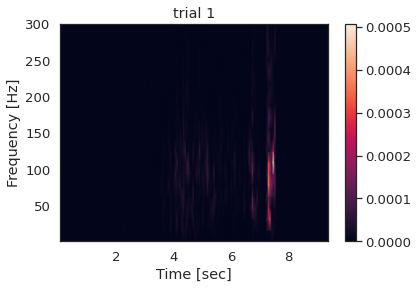

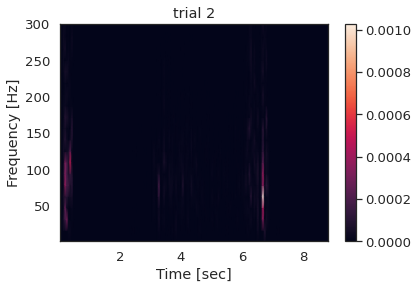

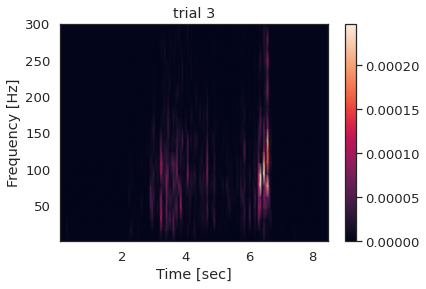

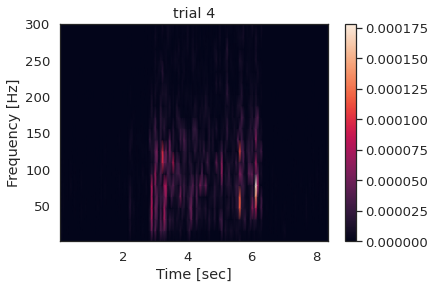

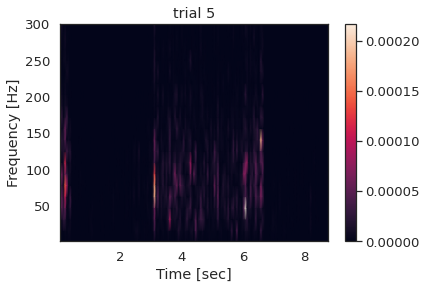

...

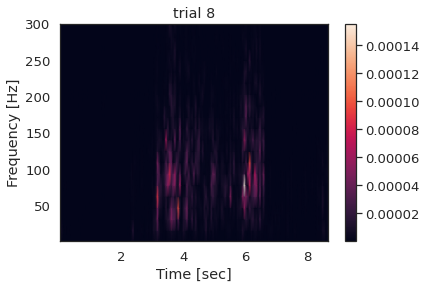

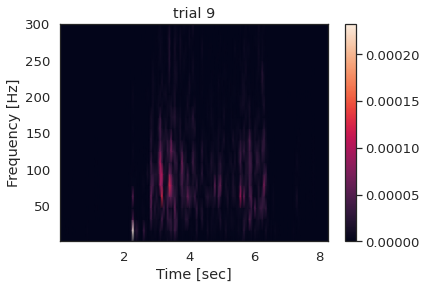

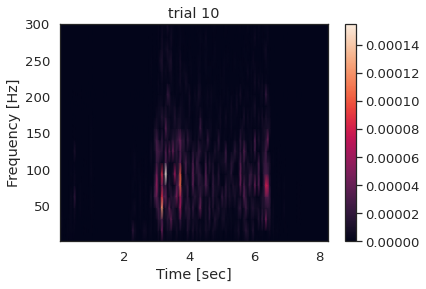

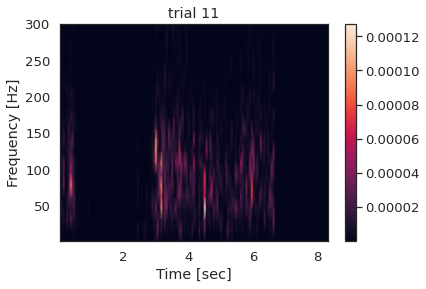

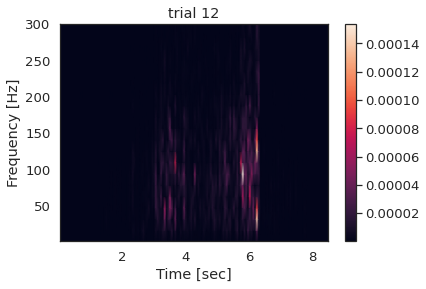

In [ ]:
for x in range(12):
  spectrogram_plot(FD[x], x+1)

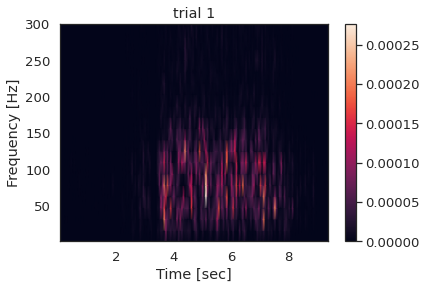

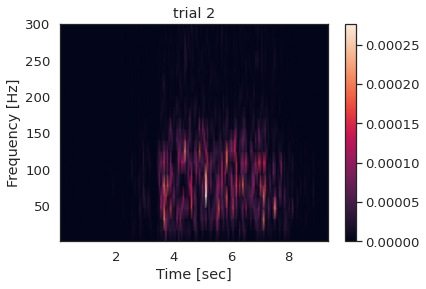

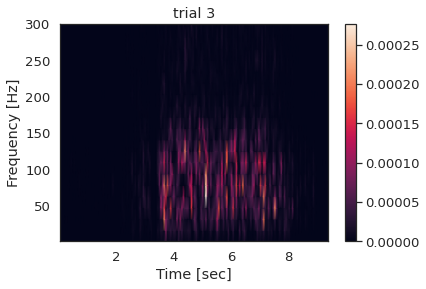

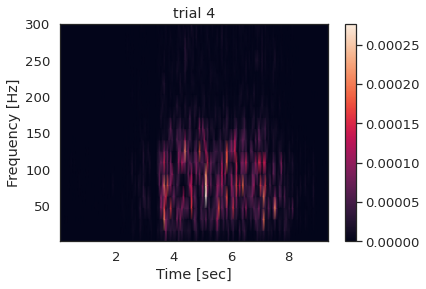

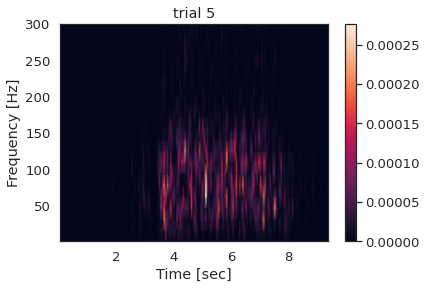

...

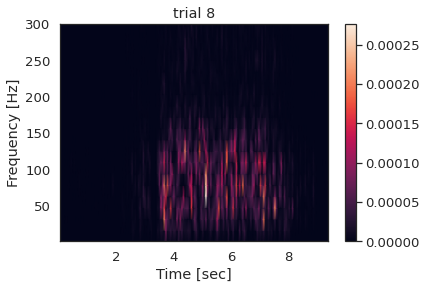

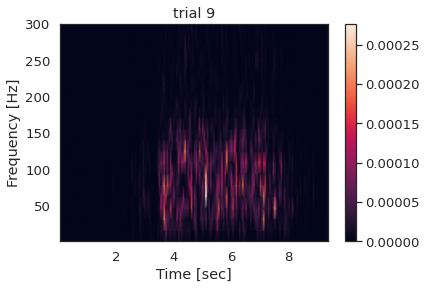

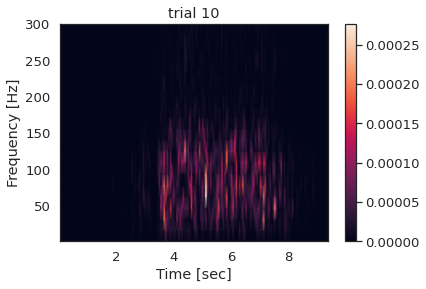

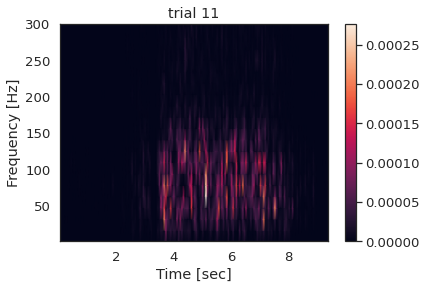

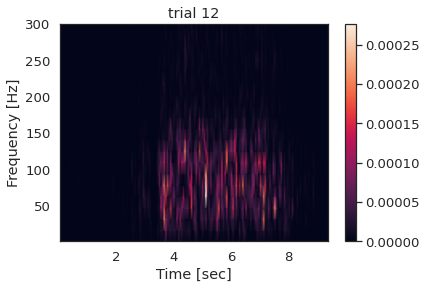

In [ ]:
for x in range(12):
  spectrogram_plot(CED[x], x+1)

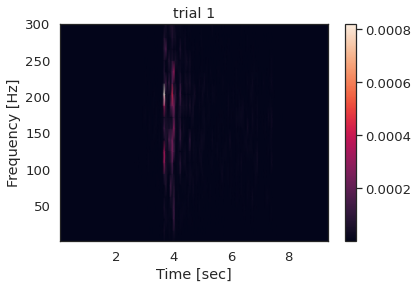

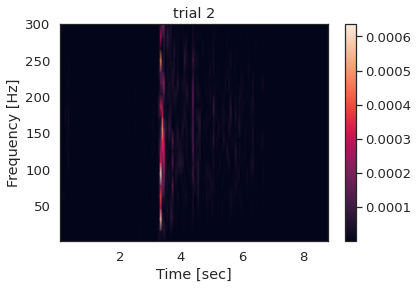

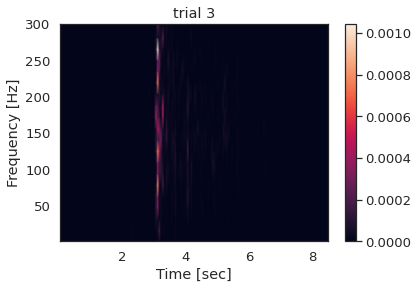

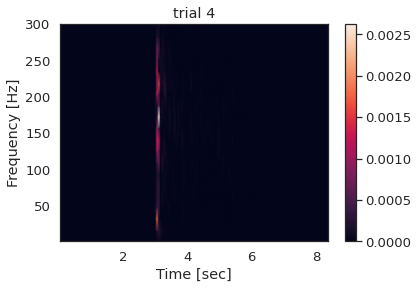

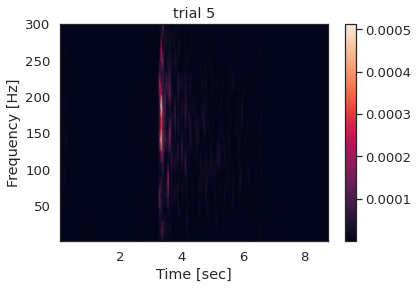

...

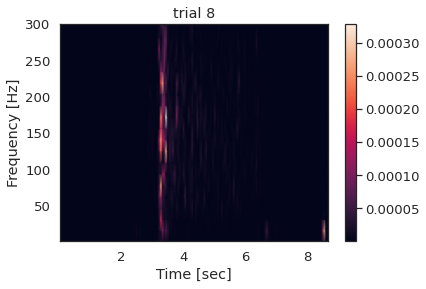

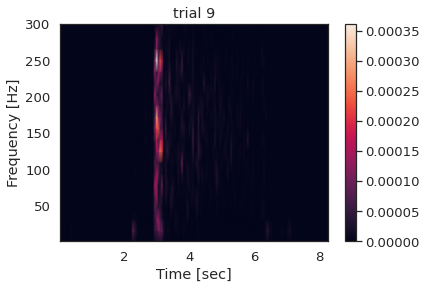

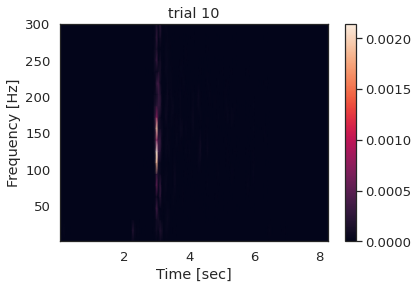

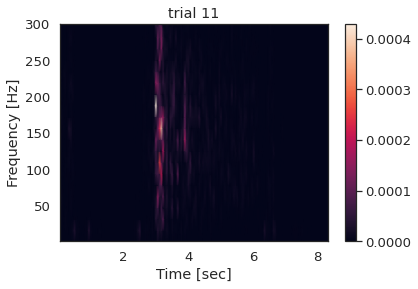

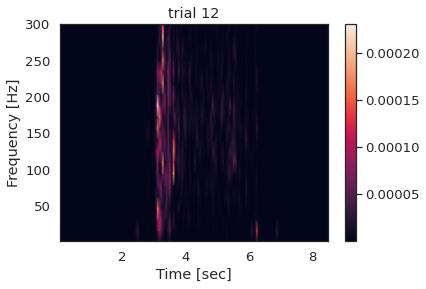

In [ ]:
for x in range(12):
  spectrogram_plot(FDI[x], x+1)

# **Time and frequency domain features for EMG**

In [ ]:
# calculate mean absolute of data in a given window size
def mean_absolute(data):
  import math
  import numpy as np
  length = len(data)
  sf = 4000
  window = int(sf * 0.2)
  overlap = 200
  length = int((length - window) / overlap)
  average = [0] * length
  i = 0
  for x in range(length):
    average[x] = np.mean(abs(data[i:i+window]))
    i = i + overlap
  return average

In [ ]:
# calculate waveform length of data in a given window size
def waveform_length(data):
  import math
  import numpy as np
  length = len(data)
  sf = 4000
  window = int(sf * 0.2)
  overlap = 200
  length = int((length - window) / overlap)
  waveform = [0] * length
  i = 0
  for x in range(length):
    temp = data[i:i+window]
    start = data[i]
    sum = 0
    for y in temp:
      sum = sum + (y - start)
      start = y
    waveform[x] = sum
    i = i + overlap
  return waveform

In [ ]:
# calculate willison amplitude of data in a given window size
def willison_amplitude(data):
  import math
  import numpy as np
  length = len(data)
  sf = 4000
  window = int(sf * 0.2)
  overlap = 200
  threshold = 0.01
  length = int((length - window) / overlap)
  willison = [0] * length
  i = 0
  for x in range(length):
    temp = data[i:i+window]
    start = data[i]
    sum = 0
    for y in temp:
      difference = y - start
      if (difference >= threshold):
        sum = sum + difference
      start = y
    willison[x] = sum
    i = i + overlap
  return willison

In [ ]:
# calculate mean absolute value slope of data in a given window size
def mean_absolute_slope(data):
  import math
  import numpy as np
  length = len(data)
  sf = 4000
  window = int(sf * 0.2)
  overlap = 200
  length = int((length - window) / overlap)
  average = [0] * length
  i = 0
  for x in range(length):
    mavslp0 = np.mean(abs(data[i:i+window-1]))
    mavslp1 = np.mean(abs(data[i:i+window]))
    average[x] = mavslp1 - mavslp0
    i = i + overlap
  return average

In [ ]:
def autoregressive_coefficient(data):
  import math
  import numpy as np
  from statsmodels.tsa.ar_model import AutoReg
  length = len(data)
  sf = 4000
  window = int(sf * 0.2)
  overlap = 200
  length = int((length - window) / overlap)
  coefficient = [0] * length
  i = 0 
  for x in range(length):
    temp = data[i:i+window]
    model = AutoReg(temp, lags=0)
    model_fit = model.fit()
    parameters = model_fit.params
    coefficient[x] = sum(parameters)
    i = i + overlap
  return coefficient

In [ ]:
# # testing cell
# temp = autoregressive_coefficient(FDI_1)
# print(len(temp))

# import matplotlib.pyplot as plt
# import seaborn as sns
# sns.set(font_scale = 3, style = 'white')
# time = np.arange(len(temp))
# fig, ax = plt.subplots(1, 1, figsize = (12, 5))
# plt.plot(time, temp, lw = 1.5, color = 'b')
# # plt.plot(time, temp1, lw = 1.5, color = 'g')
# sns.despine()

In [ ]:
AD_rest = [AD_1[0:9144], AD_2[0:9824], AD_3[0:9136], AD_4[0:9128], AD_5[0:10096], AD_6[0:9128], AD_7[0:9696], AD_8[0:9768], AD_9[0:9176], AD_10[0:9192], AD_11[0:9496], AD_12[0:9512], AD_12_noisy[0:9512]]
AD_forward = [AD_1[9144:14728], AD_2[9824:13264], AD_3[9136:12288], AD_4[9128:12176], AD_5[10096:13176], AD_6[9128:12232], AD_7[9696:12440], AD_8[9768:12960], AD_9[9176:11800], AD_10[9192:11840], AD_11[9496:11992], AD_12[9512:12320], AD_12_noisy[9512:12320]]
AD_finger = [AD_1[14728:29872], AD_2[13264:27408], AD_3[12288:26688], AD_4[12176:25312], AD_5[13176:26664], AD_6[12232:25568], AD_7[12440:26216], AD_8[12960:26360], AD_9[11800:25504], AD_10[11840:25896], AD_11[11992:26672], AD_12[12320:25384], AD_12_noisy[12320:25384]]
AD_backward = [AD_1[29872:32296], AD_2[27408:29640], AD_3[26688:29000], AD_4[25312:27480], AD_5[26664:28552], AD_6[25568:27584], AD_7[26216:28328], AD_8[26360:28776], AD_9[25504:27968], AD_10[25896:28040], AD_11[26672:28976], AD_12[25384:27760], AD_12_noisy[25384:27760]]

B_rest = [B_1[0:9144], B_2[0:9824], B_3[0:9136], B_4[0:9128], B_5[0:10096], B_6[0:9128], B_7[0:9696], B_8[0:9768], B_9[0:9176], B_10[0:9192], B_11[0:9496], B_12[0:9512], B_12_noisy[0:9512]]
B_forward = [B_1[9144:14728], B_2[9824:13264], B_3[9136:12288], B_4[9128:12176], B_5[10096:13176], B_6[9128:12232], B_7[9696:12440], B_8[9768:12960], B_9[9176:11800], B_10[9192:11840], B_11[9496:11992], B_12[9512:12320], B_12_noisy[9512:12320]]
B_finger = [B_1[14728:29872], B_2[13264:27408], B_3[12288:26688], B_4[12176:25312], B_5[13176:26664], B_6[12232:25568], B_7[12440:26216], B_8[12960:26360], B_9[11800:25504], B_10[11840:25896], B_11[11992:26672], B_12[12320:25384], B_12_noisy[12320:25384]]
B_backward = [B_1[29872:32296], B_2[27408:29640], B_3[26688:29000], B_4[25312:27480], B_5[26664:28552], B_6[25568:27584], B_7[26216:28328], B_8[26360:28776], B_9[25504:27968], B_10[25896:28040], B_11[26672:28976], B_12[25384:27760], B_12_noisy[25384:27760]]

FD_rest = [FD_1[0:9144], FD_2[0:9824], FD_3[0:9136], FD_4[0:9128], FD_5[0:10096], FD_6[0:9128], FD_7[0:9696], FD_8[0:9768], FD_9[0:9176], FD_10[0:9192], FD_11[0:9496], FD_12[0:9512], FD_12_noisy[0:9512]]
FD_forward = [FD_1[9144:14728], FD_2[9824:13264], FD_3[9136:12288], FD_4[9128:12176], FD_5[10096:13176], FD_6[9128:12232], FD_7[9696:12440], FD_8[9768:12960], FD_9[9176:11800], FD_10[9192:11840], FD_11[9496:11992], FD_12[9512:12320], FD_12_noisy[9512:12320]]
FD_finger = [FD_1[14728:29872], FD_2[13264:27408], FD_3[12288:26688], FD_4[12176:25312], FD_5[13176:26664], FD_6[12232:25568], FD_7[12440:26216], FD_8[12960:26360], FD_9[11800:25504], FD_10[11840:25896], FD_11[11992:26672], FD_12[12320:25384], FD_12_noisy[12320:25384]]
FD_backward = [FD_1[29872:32296], FD_2[27408:29640], FD_3[26688:29000], FD_4[25312:27480], FD_5[26664:28552], FD_6[25568:27584], FD_7[26216:28328], FD_8[26360:28776], FD_9[25504:27968], FD_10[25896:28040], FD_11[26672:28976], FD_12[25384:27760], FD_12_noisy[25384:27760]]

CED_rest = [CED_1[0:9144], CED_2[0:9824], CED_3[0:9136], CED_4[0:9128], CED_5[0:10096], CED_6[0:9128], CED_7[0:9696], CED_8[0:9768], CED_9[0:9176], CED_10[0:9192], CED_11[0:9496], CED_12[0:9512], CED_12_noisy[0:9512]]
CED_forward = [CED_1[9144:14728], CED_2[9824:13264], CED_3[9136:12288], CED_4[9128:12176], CED_5[10096:13176], CED_6[9128:12232], CED_7[9696:12440], CED_8[9768:12960], CED_9[9176:11800], CED_10[9192:11840], CED_11[9496:11992], CED_12[9512:12320], CED_12_noisy[9512:12320]]
CED_finger = [CED_1[14728:29872], CED_2[13264:27408], CED_3[12288:26688], CED_4[12176:25312], CED_5[13176:26664], CED_6[12232:25568], CED_7[12440:26216], CED_8[12960:26360], CED_9[11800:25504], CED_10[11840:25896], CED_11[11992:26672], CED_12[12320:25384], CED_12_noisy[12320:25384]]
CED_backward = [CED_1[29872:32296], CED_2[27408:29640], CED_3[26688:29000], CED_4[25312:27480], CED_5[26664:28552], CED_6[25568:27584], CED_7[26216:28328], CED_8[26360:28776], CED_9[25504:27968], CED_10[25896:28040], CED_11[26672:28976], CED_12[25384:27760], CED_12_noisy[25384:27760]]

FDI_rest = [FDI_1[0:9144], FDI_2[0:9824], FDI_3[0:9136], FDI_4[0:9128], FDI_5[0:10096], FDI_6[0:9128], FDI_7[0:9696], FDI_8[0:9768], FDI_9[0:9176], FDI_10[0:9192], FDI_11[0:9496], FDI_12[0:9512], FDI_12_noisy[0:9512]]
FDI_forward = [FDI_1[9144:14728], FDI_2[9824:13264], FDI_3[9136:12288], FDI_4[9128:12176], FDI_5[10096:13176], FDI_6[9128:12232], FDI_7[9696:12440], FDI_8[9768:12960], FDI_9[9176:11800], FDI_10[9192:11840], FDI_11[9496:11992], FDI_12[9512:12320], FDI_12_noisy[9512:12320]]
FDI_finger = [FDI_1[14728:29872], FDI_2[13264:27408], FDI_3[12288:26688], FDI_4[12176:25312], FDI_5[13176:26664], FDI_6[12232:25568], FDI_7[12440:26216], FDI_8[12960:26360], FDI_9[11800:25504], FDI_10[11840:25896], FDI_11[11992:26672], FDI_12[12320:25384], FDI_12_noisy[12320:25384]]
FDI_backward = [FDI_1[29872:32296], FDI_2[27408:29640], FDI_3[26688:29000], FDI_4[25312:27480], FDI_5[26664:28552], FDI_6[25568:27584], FDI_7[26216:28328], FDI_8[26360:28776], FDI_9[25504:27968], FDI_10[25896:28040], FDI_11[26672:28976], FDI_12[25384:27760], FDI_12_noisy[25384:27760]]

In [ ]:
AD_rest_mean = []
AD_forward_mean = []
AD_finger_mean = []
AD_backward_mean = []
AD_rest_wl = []
AD_forward_wl = []
AD_finger_wl = []
AD_backward_wl = []
AD_rest_wamp = []
AD_forward_wamp = []
AD_finger_wamp = []
AD_backward_wamp = []
AD_rest_wavslp = []
AD_forward_wavslp = []
AD_finger_wavslp = []
AD_backward_wavslp = []
AD_rest_auto = []
AD_forward_auto = []
AD_finger_auto = []
AD_backward_auto = []

B_rest_mean = []
B_forward_mean = []
B_finger_mean = []
B_backward_mean = []
B_rest_wl = []
B_forward_wl = []
B_finger_wl = []
B_backward_wl = []
B_rest_wamp = []
B_forward_wamp = []
B_finger_wamp = []
B_backward_wamp = []
B_rest_wavslp = []
B_forward_wavslp = []
B_finger_wavslp = []
B_backward_wavslp = []
B_rest_auto = []
B_forward_auto = []
B_finger_auto = []
B_backward_auto = []

FD_rest_mean = []
FD_forward_mean = []
FD_finger_mean = []
FD_backward_mean = []
FD_rest_wl = []
FD_forward_wl = []
FD_finger_wl = []
FD_backward_wl = []
FD_rest_wamp = []
FD_forward_wamp = []
FD_finger_wamp = []
FD_backward_wamp = []
FD_rest_wavslp = []
FD_forward_wavslp = []
FD_finger_wavslp = []
FD_backward_wavslp = []
FD_rest_auto = []
FD_forward_auto = []
FD_finger_auto = []
FD_backward_auto = []

CED_rest_mean = []
CED_forward_mean = []
CED_finger_mean = []
CED_backward_mean = []
CED_rest_wl = []
CED_forward_wl = []
CED_finger_wl = []
CED_backward_wl = []
CED_rest_wamp = []
CED_forward_wamp = []
CED_finger_wamp = []
CED_backward_wamp = []
CED_rest_wavslp = []
CED_forward_wavslp = []
CED_finger_wavslp = []
CED_backward_wavslp = []
CED_rest_auto = []
CED_forward_auto = []
CED_finger_auto = []
CED_backward_auto = []

FDI_rest_mean = []
FDI_forward_mean = []
FDI_finger_mean = []
FDI_backward_mean = []
FDI_rest_wl = []
FDI_forward_wl = []
FDI_finger_wl = []
FDI_backward_wl = []
FDI_rest_wamp = []
FDI_forward_wamp = []
FDI_finger_wamp = []
FDI_backward_wamp = []
FDI_rest_wavslp = []
FDI_forward_wavslp = []
FDI_finger_wavslp = []
FDI_backward_wavslp = []
FDI_rest_auto = []
FDI_forward_auto = []
FDI_finger_auto = []
FDI_backward_auto = []

for x in range(13):
  AD_rest_mean.extend(mean_absolute(AD_rest[x]))
  AD_forward_mean.extend(mean_absolute(AD_forward[x]))
  AD_finger_mean.extend(mean_absolute(AD_finger[x]))
  AD_backward_mean.extend(mean_absolute(AD_backward[x]))
  AD_rest_wl.extend(waveform_length(AD_rest[x]))
  AD_forward_wl.extend(waveform_length(AD_forward[x]))
  AD_finger_wl.extend(waveform_length(AD_finger[x]))
  AD_backward_wl.extend(waveform_length(AD_backward[x]))
  AD_rest_wamp.extend(willison_amplitude(AD_rest[x]))
  AD_forward_wamp.extend(willison_amplitude(AD_forward[x]))
  AD_finger_wamp.extend(willison_amplitude(AD_finger[x]))
  AD_backward_wamp.extend(willison_amplitude(AD_backward[x]))
  AD_rest_wavslp.extend(mean_absolute_slope(AD_rest[x]))
  AD_forward_wavslp.extend(mean_absolute_slope(AD_forward[x]))
  AD_finger_wavslp.extend(mean_absolute_slope(AD_finger[x]))
  AD_backward_wavslp.extend(mean_absolute_slope(AD_backward[x]))
  AD_rest_auto.extend(autoregressive_coefficient(AD_rest[x]))
  AD_forward_auto.extend(autoregressive_coefficient(AD_forward[x]))
  AD_finger_auto.extend(autoregressive_coefficient(AD_finger[x]))
  AD_backward_auto.extend(autoregressive_coefficient(AD_backward[x]))

  B_rest_mean.extend(mean_absolute(B_rest[x]))
  B_forward_mean.extend(mean_absolute(B_forward[x]))
  B_finger_mean.extend(mean_absolute(B_finger[x]))
  B_backward_mean.extend(mean_absolute(B_backward[x]))
  B_rest_wl.extend(waveform_length(B_rest[x]))
  B_forward_wl.extend(waveform_length(B_forward[x]))
  B_finger_wl.extend(waveform_length(B_finger[x]))
  B_backward_wl.extend(waveform_length(B_backward[x]))
  B_rest_wamp.extend(willison_amplitude(B_rest[x]))
  B_forward_wamp.extend(willison_amplitude(B_forward[x]))
  B_finger_wamp.extend(willison_amplitude(B_finger[x]))
  B_backward_wamp.extend(willison_amplitude(B_backward[x]))
  B_rest_wavslp.extend(mean_absolute_slope(B_rest[x]))
  B_forward_wavslp.extend(mean_absolute_slope(B_forward[x]))
  B_finger_wavslp.extend(mean_absolute_slope(B_finger[x]))
  B_backward_wavslp.extend(mean_absolute_slope(B_backward[x]))
  B_rest_auto.extend(autoregressive_coefficient(B_rest[x]))
  B_forward_auto.extend(autoregressive_coefficient(B_forward[x]))
  B_finger_auto.extend(autoregressive_coefficient(B_finger[x]))
  B_backward_auto.extend(autoregressive_coefficient(B_backward[x]))

  FD_rest_mean.extend(mean_absolute(FD_rest[x]))
  FD_forward_mean.extend(mean_absolute(FD_forward[x]))
  FD_finger_mean.extend(mean_absolute(FD_finger[x]))
  FD_backward_mean.extend(mean_absolute(FD_backward[x]))
  FD_rest_wl.extend(waveform_length(FD_rest[x]))
  FD_forward_wl.extend(waveform_length(FD_forward[x]))
  FD_finger_wl.extend(waveform_length(FD_finger[x]))
  FD_backward_wl.extend(waveform_length(FD_backward[x]))
  FD_rest_wamp.extend(willison_amplitude(FD_rest[x]))
  FD_forward_wamp.extend(willison_amplitude(FD_forward[x]))
  FD_finger_wamp.extend(willison_amplitude(FD_finger[x]))
  FD_backward_wamp.extend(willison_amplitude(FD_backward[x]))
  FD_rest_wavslp.extend(mean_absolute_slope(FD_rest[x]))
  FD_forward_wavslp.extend(mean_absolute_slope(FD_forward[x]))
  FD_finger_wavslp.extend(mean_absolute_slope(FD_finger[x]))
  FD_backward_wavslp.extend(mean_absolute_slope(FD_backward[x]))
  FD_rest_auto.extend(autoregressive_coefficient(FD_rest[x]))
  FD_forward_auto.extend(autoregressive_coefficient(FD_forward[x]))
  FD_finger_auto.extend(autoregressive_coefficient(FD_finger[x]))
  FD_backward_auto.extend(autoregressive_coefficient(FD_backward[x]))

  CED_rest_mean.extend(mean_absolute(CED_rest[x]))
  CED_forward_mean.extend(mean_absolute(CED_forward[x]))
  CED_finger_mean.extend(mean_absolute(CED_finger[x]))
  CED_backward_mean.extend(mean_absolute(CED_backward[x]))
  CED_rest_wl.extend(waveform_length(CED_rest[x]))
  CED_forward_wl.extend(waveform_length(CED_forward[x]))
  CED_finger_wl.extend(waveform_length(CED_finger[x]))
  CED_backward_wl.extend(waveform_length(CED_backward[x]))
  CED_rest_wamp.extend(willison_amplitude(CED_rest[x]))
  CED_forward_wamp.extend(willison_amplitude(CED_forward[x]))
  CED_finger_wamp.extend(willison_amplitude(CED_finger[x]))
  CED_backward_wamp.extend(willison_amplitude(CED_backward[x]))
  CED_rest_wavslp.extend(mean_absolute_slope(CED_rest[x]))
  CED_forward_wavslp.extend(mean_absolute_slope(CED_forward[x]))
  CED_finger_wavslp.extend(mean_absolute_slope(CED_finger[x]))
  CED_backward_wavslp.extend(mean_absolute_slope(CED_backward[x]))
  CED_rest_auto.extend(autoregressive_coefficient(CED_rest[x]))
  CED_forward_auto.extend(autoregressive_coefficient(CED_forward[x]))
  CED_finger_auto.extend(autoregressive_coefficient(CED_finger[x]))
  CED_backward_auto.extend(autoregressive_coefficient(CED_backward[x]))

  FDI_rest_mean.extend(mean_absolute(FDI_rest[x]))
  FDI_forward_mean.extend(mean_absolute(FDI_forward[x]))
  FDI_finger_mean.extend(mean_absolute(FDI_finger[x]))
  FDI_backward_mean.extend(mean_absolute(FDI_backward[x]))
  FDI_rest_wl.extend(waveform_length(FDI_rest[x]))
  FDI_forward_wl.extend(waveform_length(FDI_forward[x]))
  FDI_finger_wl.extend(waveform_length(FDI_finger[x]))
  FDI_backward_wl.extend(waveform_length(FDI_backward[x]))
  FDI_rest_wamp.extend(willison_amplitude(FDI_rest[x]))
  FDI_forward_wamp.extend(willison_amplitude(FDI_forward[x]))
  FDI_finger_wamp.extend(willison_amplitude(FDI_finger[x]))
  FDI_backward_wamp.extend(willison_amplitude(FDI_backward[x]))
  FDI_rest_wavslp.extend(mean_absolute_slope(FDI_rest[x]))
  FDI_forward_wavslp.extend(mean_absolute_slope(FDI_forward[x]))
  FDI_finger_wavslp.extend(mean_absolute_slope(FDI_finger[x]))
  FDI_backward_wavslp.extend(mean_absolute_slope(FDI_backward[x]))
  FDI_rest_auto.extend(autoregressive_coefficient(FDI_rest[x]))
  FDI_forward_auto.extend(autoregressive_coefficient(FDI_forward[x]))
  FDI_finger_auto.extend(autoregressive_coefficient(FDI_finger[x]))
  FDI_backward_auto.extend(autoregressive_coefficient(FDI_backward[x]))

In [ ]:
length_rest_noisy = 1351
length_forward_noisy = 409
length_finger_noisy = 778
length_backward_noisy = 81

length_rest = 1351
length_forward = 409
length_finger = 778
length_backward = 81

In [ ]:
AD_mean = np.concatenate((AD_rest_mean[0:length_rest], AD_forward_mean[0:length_forward], AD_finger_mean[0:length_finger], AD_backward_mean[0:length_backward]))
AD_wl = np.concatenate((AD_rest_wl[0:length_rest], AD_forward_wl[0:length_forward], AD_finger_wl[0:length_finger], AD_backward_wl[0:length_backward]))
AD_wamp = np.concatenate((AD_rest_wamp[0:length_rest], AD_forward_wamp[0:length_forward], AD_finger_wamp[0:length_finger], AD_backward_wamp[0:length_backward]))
AD_wavslp = np.concatenate((AD_rest_wavslp[0:length_rest], AD_forward_wavslp[0:length_forward], AD_finger_wavslp[0:length_finger], AD_backward_wavslp[0:length_backward]))
AD_auto = np.concatenate((AD_rest_auto[0:length_rest], AD_forward_auto[0:length_forward], AD_finger_auto[0:length_finger], AD_backward_auto[0:length_backward]))

B_mean = np.concatenate((B_rest_mean[0:length_rest], B_forward_mean[0:length_forward], B_finger_mean[0:length_finger], B_backward_mean[0:length_backward]))
B_wl = np.concatenate((B_rest_wl[0:length_rest], B_forward_wl[0:length_forward], B_finger_wl[0:length_finger], B_backward_wl[0:length_backward]))
B_wamp = np.concatenate((B_rest_wamp[0:length_rest], B_forward_wamp[0:length_forward], B_finger_wamp[0:length_finger], B_backward_wamp[0:length_backward]))
B_wavslp = np.concatenate((B_rest_wavslp[0:length_rest], B_forward_wavslp[0:length_forward], B_finger_wavslp[0:length_finger], B_backward_wavslp[0:length_backward]))
B_auto = np.concatenate((B_rest_auto[0:length_rest], B_forward_auto[0:length_forward], B_finger_auto[0:length_finger], B_backward_auto[0:length_backward]))

FD_mean = np.concatenate((FD_rest_mean[0:length_rest], FD_forward_mean[0:length_forward], FD_finger_mean[0:length_finger], FD_backward_mean[0:length_backward]))
FD_wl = np.concatenate((FD_rest_wl[0:length_rest], FD_forward_wl[0:length_forward], FD_finger_wl[0:length_finger], FD_backward_wl[0:length_backward]))
FD_wamp = np.concatenate((FD_rest_wamp[0:length_rest], FD_forward_wamp[0:length_forward], FD_finger_wamp[0:length_finger], FD_backward_wamp[0:length_backward]))
FD_wavslp = np.concatenate((FD_rest_wavslp[0:length_rest], FD_forward_wavslp[0:length_forward], FD_finger_wavslp[0:length_finger], FD_backward_wavslp[0:length_backward]))
FD_auto = np.concatenate((FD_rest_auto[0:length_rest], FD_forward_auto[0:length_forward], FD_finger_auto[0:length_finger], FD_backward_auto[0:length_backward]))

CED_mean = np.concatenate((CED_rest_mean[0:length_rest], CED_forward_mean[0:length_forward], CED_finger_mean[0:length_finger], CED_backward_mean[0:length_backward]))
CED_wl = np.concatenate((CED_rest_wl[0:length_rest], CED_forward_wl[0:length_forward], CED_finger_wl[0:length_finger], CED_backward_wl[0:length_backward]))
CED_wamp = np.concatenate((CED_rest_wamp[0:length_rest], CED_forward_wamp[0:length_forward], CED_finger_wamp[0:length_finger], CED_backward_wamp[0:length_backward]))
CED_wavslp = np.concatenate((CED_rest_wavslp[0:length_rest], CED_forward_wavslp[0:length_forward], CED_finger_wavslp[0:length_finger], CED_backward_wavslp[0:length_backward]))
CED_auto = np.concatenate((CED_rest_auto[0:length_rest], CED_forward_auto[0:length_forward], CED_finger_auto[0:length_finger], CED_backward_auto[0:length_backward]))

FDI_mean = np.concatenate((FDI_rest_mean[0:length_rest], FDI_forward_mean[0:length_forward], FDI_finger_mean[0:length_finger], FDI_backward_mean[0:length_backward]))
FDI_wl = np.concatenate((FDI_rest_wl[0:length_rest], FDI_forward_wl[0:length_forward], FDI_finger_wl[0:length_finger], FDI_backward_wl[0:length_backward]))
FDI_wamp = np.concatenate((FDI_rest_wamp[0:length_rest], FDI_forward_wamp[0:length_forward], FDI_finger_wamp[0:length_finger], FDI_backward_wamp[0:length_backward]))
FDI_wavslp = np.concatenate((FDI_rest_wavslp[0:length_rest], FDI_forward_wavslp[0:length_forward], FDI_finger_wavslp[0:length_finger], FDI_backward_wavslp[0:length_backward]))
FDI_auto = np.concatenate((FDI_rest_auto[0:length_rest], FDI_forward_auto[0:length_forward], FDI_finger_auto[0:length_finger], FDI_backward_auto[0:length_backward]))

In [ ]:
AD_mean_noisy = np.concatenate((AD_rest_mean[length_rest_noisy:], AD_forward_mean[length_forward_noisy:], AD_finger_mean[length_finger_noisy:], AD_backward_mean[length_backward_noisy:]))
AD_wl_noisy = np.concatenate((AD_rest_wl[length_rest_noisy:], AD_forward_wl[length_forward_noisy:], AD_finger_wl[length_finger_noisy:], AD_backward_wl[length_backward_noisy:]))
AD_wamp_noisy = np.concatenate((AD_rest_wamp[length_rest_noisy:], AD_forward_wamp[length_forward_noisy:], AD_finger_wamp[length_finger_noisy:], AD_backward_wamp[length_backward_noisy:]))
AD_wavslp_noisy = np.concatenate((AD_rest_wavslp[length_rest_noisy:], AD_forward_wavslp[length_forward_noisy:], AD_finger_wavslp[length_finger_noisy:], AD_backward_wavslp[length_backward_noisy:]))
AD_auto_noisy = np.concatenate((AD_rest_auto[length_rest_noisy:], AD_forward_auto[length_forward_noisy:], AD_finger_auto[length_finger_noisy:], AD_backward_auto[length_backward_noisy:]))

B_mean_noisy = np.concatenate((B_rest_mean[length_rest_noisy:], B_forward_mean[length_forward_noisy:], B_finger_mean[length_finger_noisy:], B_backward_mean[length_backward_noisy:]))
B_wl_noisy = np.concatenate((B_rest_wl[length_rest_noisy:], B_forward_wl[length_forward_noisy:], B_finger_wl[length_finger_noisy:], B_backward_wl[length_backward_noisy:]))
B_wamp_noisy = np.concatenate((B_rest_wamp[length_rest_noisy:], B_forward_wamp[length_forward_noisy:], B_finger_wamp[length_finger_noisy:], B_backward_wamp[length_backward_noisy:]))
B_wavslp_noisy = np.concatenate((B_rest_wavslp[length_rest_noisy:], B_forward_wavslp[length_forward_noisy:], B_finger_wavslp[length_finger_noisy:], B_backward_wavslp[length_backward_noisy:]))
B_auto_noisy = np.concatenate((B_rest_auto[length_rest_noisy:], B_forward_auto[length_forward_noisy:], B_finger_auto[length_finger_noisy:], B_backward_auto[length_backward_noisy:]))

FD_mean_noisy = np.concatenate((FD_rest_mean[length_rest_noisy:], FD_forward_mean[length_forward_noisy:], FD_finger_mean[length_finger_noisy:], FD_backward_mean[length_backward_noisy:]))
FD_wl_noisy = np.concatenate((FD_rest_wl[length_rest_noisy:], FD_forward_wl[length_forward_noisy:], FD_finger_wl[length_finger_noisy:], FD_backward_wl[length_backward_noisy:]))
FD_wamp_noisy = np.concatenate((FD_rest_wamp[length_rest_noisy:], FD_forward_wamp[length_forward_noisy:], FD_finger_wamp[length_finger_noisy:], FD_backward_wamp[length_backward_noisy:]))
FD_wavslp_noisy = np.concatenate((FD_rest_wavslp[length_rest_noisy:], FD_forward_wavslp[length_forward_noisy:], FD_finger_wavslp[length_finger_noisy:], FD_backward_wavslp[length_backward_noisy:]))
FD_auto_noisy = np.concatenate((FD_rest_auto[length_rest_noisy:], FD_forward_auto[length_forward_noisy:], FD_finger_auto[length_finger_noisy:], FD_backward_auto[length_backward_noisy:]))

CED_mean_noisy = np.concatenate((CED_rest_mean[length_rest_noisy:], CED_forward_mean[length_forward_noisy:], CED_finger_mean[length_finger_noisy:], CED_backward_mean[length_backward_noisy:]))
CED_wl_noisy = np.concatenate((CED_rest_wl[length_rest_noisy:], CED_forward_wl[length_forward_noisy:], CED_finger_wl[length_finger_noisy:], CED_backward_wl[length_backward_noisy:]))
CED_wamp_noisy = np.concatenate((CED_rest_wamp[length_rest_noisy:], CED_forward_wamp[length_forward_noisy:], CED_finger_wamp[length_finger_noisy:], CED_backward_wamp[length_backward_noisy:]))
CED_wavslp_noisy = np.concatenate((CED_rest_wavslp[length_rest_noisy:], CED_forward_wavslp[length_forward_noisy:], CED_finger_wavslp[length_finger_noisy:], CED_backward_wavslp[length_backward_noisy:]))
CED_auto_noisy = np.concatenate((CED_rest_auto[length_rest_noisy:], CED_forward_auto[length_forward_noisy:], CED_finger_auto[length_finger_noisy:], CED_backward_auto[length_backward_noisy:]))

FDI_mean_noisy = np.concatenate((FDI_rest_mean[length_rest_noisy:], FDI_forward_mean[length_forward_noisy:], FDI_finger_mean[length_finger_noisy:], FDI_backward_mean[length_backward_noisy:]))
FDI_wl_noisy = np.concatenate((FDI_rest_wl[length_rest_noisy:], FDI_forward_wl[length_forward_noisy:], FDI_finger_wl[length_finger_noisy:], FDI_backward_wl[length_backward_noisy:]))
FDI_wamp_noisy = np.concatenate((FDI_rest_wamp[length_rest_noisy:], FDI_forward_wamp[length_forward_noisy:], FDI_finger_wamp[length_finger_noisy:], FDI_backward_wamp[length_backward_noisy:]))
FDI_wavslp_noisy = np.concatenate((FDI_rest_wavslp[length_rest_noisy:], FDI_forward_wavslp[length_forward_noisy:], FDI_finger_wavslp[length_finger_noisy:], FDI_backward_wavslp[length_backward_noisy:]))
FDI_auto_noisy = np.concatenate((FDI_rest_auto[length_rest_noisy:], FDI_forward_auto[length_forward_noisy:], FDI_finger_auto[length_finger_noisy:], FDI_backward_auto[length_backward_noisy:]))

# **Classifiers using time and frequency domain features**

In [ ]:
import pandas as pd
label_f = ['stationary'] * len(FDI_rest_mean[0:length_rest]) + ['forward'] * len(FDI_forward_mean[0:length_forward]) + ['finger'] * len(FDI_finger_mean[0:length_finger]) + ['backward'] * len(FDI_backward_mean[0:length_backward])
tempData_f = np.column_stack((AD_mean, B_mean, FD_mean, CED_mean, FDI_mean, AD_wl, B_wl, FD_wl, CED_wl, FDI_wl, AD_wamp, B_wamp, FD_wamp, CED_wamp, FDI_wamp, AD_wavslp, B_wavslp, FD_wavslp, CED_wavslp, FDI_wavslp, AD_auto, B_auto, FD_auto, CED_auto, FDI_auto, label_f))
data_f = pd.DataFrame(tempData_f, columns = ['AD_mean', 'B_mean', 'FD_mean', 'CED_mean', 'FDI_mean', 'AD_wl', 'B_wl', 'FD_wl', 'CED_wl', 'FDI_wl', 'AD_wamp', 'B_wamp', 'FD_wamp', 'CED_wamp', 'FDI_wamp', 'AD_wavslp', 'B_wavslp', 'FD_wavslp', 'CED_wavslp', 'FDI_wavslp', 'AD_auto', 'B_auto', 'FD_auto', 'CED_auto', 'FDI_auto', 'status'])
pd.set_option('max_columns', None)
print(data_f)

                    AD_mean                B_mean                FD_mean  \
0      0.004588072388871999  0.004345511029090693   0.005756764372831429   
1      0.004608742195900209  0.004085533662809721   0.006412744768784416   
2      0.004500972997071579  0.004141827145371665  0.0063620550802001305   
3     0.0044825613737671565  0.004051922726776525   0.006562492949419741   
4      0.004303038093557473  0.004213516895398929   0.005728919848984548   
...                     ...                   ...                    ...   
1554    0.05162083660033979   0.04712666561046829   0.010346413447258562   
1555    0.05377911544682568   0.04643170226162537   0.011169290035407658   
1556    0.03839178382352126   0.04873236001746532   0.013884359039019478   
1557    0.04617844232598694    0.0514739091686224   0.012829308723266623   
1558    0.02662690196732463  0.056104245552341434   0.012962133576588313   

                  CED_mean               FDI_mean                   AD_wl  \
0     0.00

In [ ]:
import pandas as pd
label_f_noisy = ['stationary'] * len(FDI_rest_mean[length_rest_noisy:]) + ['forward'] * len(FDI_forward_mean[length_forward_noisy:]) + ['finger'] * len(FDI_finger_mean[length_finger_noisy:]) + ['backward'] * len(FDI_backward_mean[length_backward_noisy:])
tempData_f = np.column_stack((AD_mean_noisy, B_mean_noisy, FD_mean_noisy, CED_mean_noisy, FDI_mean_noisy, AD_wl_noisy, B_wl_noisy, FD_wl_noisy, CED_wl_noisy, FDI_wl_noisy, AD_wamp_noisy, B_wamp_noisy, FD_wamp_noisy, CED_wamp_noisy, FDI_wamp_noisy, AD_wavslp_noisy, B_wavslp_noisy, FD_wavslp_noisy, CED_wavslp_noisy, FDI_wavslp_noisy, AD_auto_noisy, B_auto_noisy, FD_auto_noisy, CED_auto_noisy, FDI_auto_noisy, label_f_noisy))
data_f_noisy = pd.DataFrame(tempData_f, columns = ['AD_mean', 'B_mean', 'FD_mean', 'CED_mean', 'FDI_mean', 'AD_wl', 'B_wl', 'FD_wl', 'CED_wl', 'FDI_wl', 'AD_wamp', 'B_wamp', 'FD_wamp', 'CED_wamp', 'FDI_wamp', 'AD_wavslp', 'B_wavslp', 'FD_wavslp', 'CED_wavslp', 'FDI_wavslp', 'AD_auto', 'B_auto', 'FD_auto', 'CED_auto', 'FDI_auto', 'status_noisy'])
pd.set_option('max_columns', None)
print(data_f_noisy)

                 AD_mean                B_mean               FD_mean  \
0    0.11900870791492554    0.0880646052583201   0.02671876904090453   
1    0.12075351834944566   0.08819436308658675  0.026769903864077335   
2     0.0887039296963134   0.08967317805408453  0.031253221356733925   
3     0.0977505468591477   0.08813345966611459  0.033036045664666475   
4    0.08962855810144792   0.09741417005758951    0.0314406673140364   
..                   ...                   ...                   ...   
63  0.053188364300472524  0.048123837635386836  0.013421539955126707   
64     0.055238178564435   0.04755946287514952   0.01390068707149787   
65   0.03963143446158677   0.04971135934823789  0.016117550003655647   
66   0.04711121248479584   0.05217492188039009  0.015305214102038438   
67   0.02807559211661835    0.0567818225039721   0.01547221087699008   

                CED_mean              FDI_mean                  AD_wl  \
0    0.02506548488162974   0.10509202647146672    -0.264280703

In [ ]:
Label = preprocessing.LabelEncoder()
status = Label.fit_transform(data_f['status'])

X_train = data_f[data_f.columns[0:25]]
y_train = data_f['status']

scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)

# Boruta algorithm
rf = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=20)

# define Boruta feature selection method
feat_selector = BorutaPy(rf, n_estimators='auto', verbose=2, random_state=1)

# find all relevant features - 5 features should be selected
feat_selector.fit(X_train, y_train)

# check selected features - first 5 features are selected
print(feat_selector.support_)

# check ranking of features
print(feat_selector.ranking_)

print(feat_selector.n_features_)

# call transform() on X to filter it down to selected features
X_filtered = feat_selector.transform(X_train)
print(X_filtered.shape)

feature_names = ['AD_mean', 'B_mean', 'FD_mean', 'CED_mean', 'FDI_mean', 'AD_wl', 'B_wl', 'FD_wl', 'CED_wl', 'FDI_wl', 'AD_wamp', 'B_wamp', 'FD_wamp', 'CED_wamp', 'FDI_wamp', 'AD_wavslp', 'B_wavslp', 'FD_wavslp', 'CED_wavslp', 'FDI_wavslp', 'AD_auto', 'B_auto', 'FD_auto', 'CED_auto', 'FDI_auto']

# print out the name of the selected features
features_boruta = [feature_names[i] for i, x in enumerate(feat_selector.support_) if x]
print(features_boruta)

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	25
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	25
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	25
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	25
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	25
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	25
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	25
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
Iteration: 	9 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
Iteration: 	10 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
Iteration: 	11 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
Iteration: 	12 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
Iteration: 	13 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
Iteration: 	14 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
Iteration: 	15 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
Iteration: 	16 / 100
Confirmed: 	17
Tentative: 	8
Rejected: 	0
I

In [ ]:
# 10-fold cross using f1
Label = preprocessing.LabelEncoder()

X = data_f[data_f.columns[0:25]]
y = data_f['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'f1_micro')
print(scores)
print("%0.3f f1-score with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring= 'f1_micro')
print(scores)
print("%0.3f f1-score with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring= 'f1_micro')
print(scores)
print("%0.3f f1-score with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring= 'f1_micro')
print(scores)
print("%0.3f f1-score with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.97350993 0.99337748 1.         1.         1.         1.
 1.         0.98666667 0.98666667 1.        ]
0.994 f1-score with a standard deviation of 0.009


[0.99337748 1.         1.         1.         1.         1.
 1.         0.99333333 0.98666667 1.        ]
0.997 f1-score with a standard deviation of 0.004


[0.95364238 1.         1.         0.99337748 0.99337748 1.
 1.         0.97333333 0.98666667 1.        ]
0.990 f1-score with a standard deviation of 0.015


[0.9205298  1.         1.         0.98675497 0.99337748 1.
 1.         0.99333333 0.98       0.99333333]
0.987 f1-score with a standard deviation of 0.023


In [ ]:
# 10-fold cross using accuracy
Label = preprocessing.LabelEncoder()

X = data_f[data_f.columns[0:25]]
y = data_f['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring= 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring= 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring= 'accuracy')
print(scores)
print("%0.3f accuracy with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.96688742 0.98675497 1.         1.         1.         1.
 1.         0.99333333 0.99333333 0.99333333]
0.993 accuracy with a standard deviation of 0.010


[0.99337748 1.         1.         1.         1.         1.
 1.         0.99333333 0.98666667 1.        ]
0.997 accuracy with a standard deviation of 0.004


[0.95364238 1.         1.         0.99337748 0.99337748 1.
 1.         0.97333333 0.98666667 1.        ]
0.990 accuracy with a standard deviation of 0.015


[0.9205298  1.         1.         0.98675497 0.99337748 1.
 1.         0.99333333 0.98       0.99333333]
0.987 accuracy with a standard deviation of 0.023


In [ ]:
# 10-fold cross using precision
Label = preprocessing.LabelEncoder()

X = data_f[data_f.columns[0:25]]
y = data_f['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'precision_micro')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring= 'precision_micro')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring= 'precision_micro')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring= 'precision_micro')
print(scores)
print("%0.3f precision with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.95364238 1.         1.         0.99337748 1.         1.
 1.         0.98666667 0.98666667 1.        ]
0.992 precision with a standard deviation of 0.014


[0.99337748 1.         1.         1.         1.         1.
 1.         0.99333333 0.98666667 1.        ]
0.997 precision with a standard deviation of 0.004


[0.95364238 1.         1.         0.99337748 0.99337748 1.
 1.         0.97333333 0.98666667 1.        ]
0.990 precision with a standard deviation of 0.015


[0.9205298  1.         1.         0.98675497 0.99337748 1.
 1.         0.99333333 0.98       0.99333333]
0.987 precision with a standard deviation of 0.023


In [ ]:
# 10-fold cross using recall
Label = preprocessing.LabelEncoder()

X = data_f[data_f.columns[0:25]]
y = data_f['status']
y = Label.fit_transform(y)

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

MLP_10folds = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
scores = cross_val_score(MLP_10folds, X, y, cv=10, scoring = 'recall_micro')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfSVM = svm.SVC(kernel = 'linear')
scores = cross_val_score(clfSVM, X, y, cv=10, scoring= 'recall_micro')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

clfRBF = svm.SVC(kernel = 'rbf')
scores = cross_val_score(clfRBF, X, y, cv=10, scoring= 'recall_micro')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))
print('\n')

neigh = KNeighborsClassifier(n_neighbors=3)
scores = cross_val_score(neigh, X, y, cv=10, scoring= 'recall_micro')
print(scores)
print("%0.3f recall with a standard deviation of %0.3f" % (scores.mean(), scores.std()))

[0.96688742 1.         1.         0.99337748 0.99337748 1.
 1.         0.99333333 0.99333333 1.        ]
0.994 recall with a standard deviation of 0.010


[0.99337748 1.         1.         1.         1.         1.
 1.         0.99333333 0.98666667 1.        ]
0.997 recall with a standard deviation of 0.004


[0.95364238 1.         1.         0.99337748 0.99337748 1.
 1.         0.97333333 0.98666667 1.        ]
0.990 recall with a standard deviation of 0.015


[0.9205298  1.         1.         0.98675497 0.99337748 1.
 1.         0.99333333 0.98       0.99333333]
0.987 recall with a standard deviation of 0.023


[[ 26   0   0   0]
 [  0 195   0   0]
 [  0   0  33   0]
 [  1   0   2 120]]
              precision    recall  f1-score   support

    backward       0.96      1.00      0.98        26
      finger       1.00      1.00      1.00       195
     forward       0.94      1.00      0.97        33
  stationary       1.00      0.98      0.99       123

    accuracy                           0.99       377
   macro avg       0.98      0.99      0.98       377
weighted avg       0.99      0.99      0.99       377

Accuracy for multilayer perceptron: 0.9920424403183024


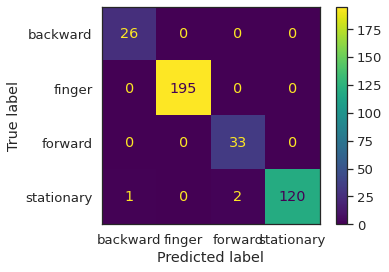

In [ ]:
# mlutilayer perceptron using time and frequency domain features
start = time.time()

Label = preprocessing.LabelEncoder()
status = Label.fit_transform(data_f['status'])

train, test = train_test_split(data_f, random_state = 42)
X_train = train[train.columns[0:25]]
y_train = train['status']
X_test = test[test.columns[0:25]]
y_test = test['status']

scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

MLP = MLPClassifier(hidden_layer_sizes = (100, 50, 70, 20), max_iter = 1000, activation = 'relu', learning_rate_init = 0.01)
MLP.fit(X_train, y_train.values.ravel())

predictions = MLP.predict(X_test)
print(confusion_matrix(y_test, predictions))
print(classification_report(y_test, predictions))
print("Accuracy for multilayer perceptron:",metrics.accuracy_score(y_test, predictions))

end = time.time()
# print(f"Runtime of multilayer perceptron for frequency domain feature is {end - start}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_test, predictions, labels=MLP.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=MLP.classes_)
disp.plot()
plt.show()

[[ 26   0   0   0]
 [  0 195   0   0]
 [  0   0  33   0]
 [  0   0   2 121]]
              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        26
      finger       1.00      1.00      1.00       195
     forward       0.94      1.00      0.97        33
  stationary       1.00      0.98      0.99       123

    accuracy                           0.99       377
   macro avg       0.99      1.00      0.99       377
weighted avg       0.99      0.99      0.99       377

Accuracy for SVM with linear kernel: 0.9946949602122016


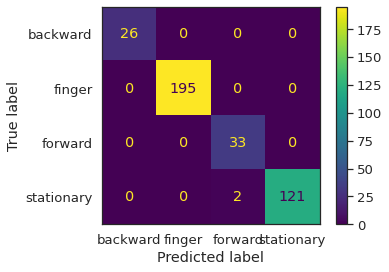

In [ ]:
# SVM with linear kernel using time and frequency domain features
startSVM = time.time()

LabelSVM = preprocessing.LabelEncoder()
statusSVM = LabelSVM.fit_transform(data_f['status'])

trainSVM, testSVM = train_test_split(data_f, random_state = 42)
X_trainSVM = trainSVM[trainSVM.columns[0:25]]
y_trainSVM = trainSVM['status']
X_testSVM = testSVM[testSVM.columns[0:25]]
y_testSVM= testSVM['status']

scalerSVM = StandardScaler()
scalerSVM.fit(X_trainSVM)
X_trainSVM = scalerSVM.transform(X_trainSVM)
X_testSVM = scalerSVM.transform(X_testSVM)

clfSVM = svm.SVC(kernel = 'linear')
clfSVM.fit(X_trainSVM, y_trainSVM.values.ravel())

predictionsSVM = clfSVM.predict(X_testSVM)
print(confusion_matrix(y_testSVM, predictionsSVM))
print(classification_report(y_testSVM, predictionsSVM))
print("Accuracy for SVM with linear kernel:",metrics.accuracy_score(y_testSVM, predictionsSVM))

endSVM = time.time()
# print(f"Runtime of SVM with linear kernel is {endSVM - startSVM}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testSVM, predictionsSVM, labels=clfSVM.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clfSVM.classes_)
disp.plot()
plt.show()

[[ 26   0   0   0]
 [  0 195   0   0]
 [  0   1  32   0]
 [  0   2   2 119]]
              precision    recall  f1-score   support

    backward       1.00      1.00      1.00        26
      finger       0.98      1.00      0.99       195
     forward       0.94      0.97      0.96        33
  stationary       1.00      0.97      0.98       123

    accuracy                           0.99       377
   macro avg       0.98      0.98      0.98       377
weighted avg       0.99      0.99      0.99       377

Accuracy for SVM with Radial Basis Function kernel: 0.986737400530504


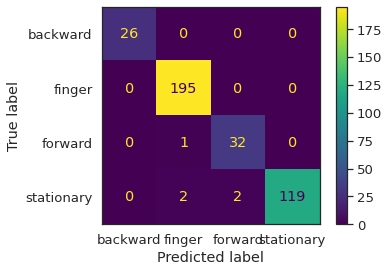

In [ ]:
# SVM with Radial Basis Function kernel using time and frequency domain features
startRBF = time.time()

LabelRBF = preprocessing.LabelEncoder()
statusRBF = LabelRBF.fit_transform(data_f['status'])

trainRBF, testRBF = train_test_split(data_f, random_state = 42)
X_trainRBF = trainRBF[trainRBF.columns[0:25]]
y_trainRBF = trainRBF['status']
X_testRBF = testRBF[testRBF.columns[0:25]]
y_testRBF = testRBF['status']

scalerRBF = StandardScaler()
scalerRBF.fit(X_trainRBF)
X_trainRBF = scalerRBF.transform(X_trainRBF)
X_testRBF = scalerRBF.transform(X_testRBF)

clfRBF = svm.SVC(kernel = 'rbf')
clfRBF.fit(X_trainRBF, y_trainRBF.values.ravel())

predictionsRBF = clfRBF.predict(X_testRBF)
print(confusion_matrix(y_testRBF, predictionsRBF))
print(classification_report(y_testRBF, predictionsRBF))
print("Accuracy for SVM with Radial Basis Function kernel:",metrics.accuracy_score(y_testRBF, predictionsRBF))

endRBF = time.time()
# print(f"Runtime of SVM with Radial Basis Function kernel is {endRBF - startRBF}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testRBF, predictionsRBF, labels=clfRBF.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clfRBF.classes_)
disp.plot()
plt.show()

[[ 26   0   0   0]
 [  0 195   0   0]
 [  0   0  33   0]
 [  1   2   2 118]]
              precision    recall  f1-score   support

    backward       0.96      1.00      0.98        26
      finger       0.99      1.00      0.99       195
     forward       0.94      1.00      0.97        33
  stationary       1.00      0.96      0.98       123

    accuracy                           0.99       377
   macro avg       0.97      0.99      0.98       377
weighted avg       0.99      0.99      0.99       377

Accuracy for kNN: 0.986737400530504


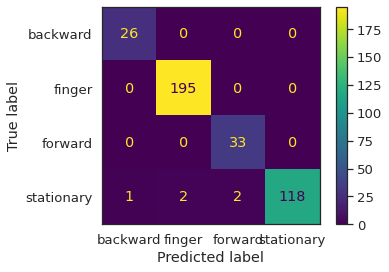

In [ ]:
# kNN using time and frequency domain features
startkNN = time.time()

LabelkNN = preprocessing.LabelEncoder()
statuskNN = LabelkNN.fit_transform(data_f['status'])

trainkNN, testkNN = train_test_split(data_f, random_state = 42)
X_trainkNN = trainkNN[trainkNN.columns[0:25]]
y_trainkNN = trainkNN['status']
X_testkNN = testkNN[testkNN.columns[0:25]]
y_testkNN = testkNN['status']

scaler = StandardScaler()
scaler.fit(X_trainkNN)
X_trainkNN = scaler.transform(X_trainkNN)
X_testkNN = scaler.transform(X_testkNN)

neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(X_trainkNN, y_trainkNN.values.ravel())

predictionskNN = neigh.predict(X_testkNN)
print(confusion_matrix(y_testkNN, predictionskNN))
print(classification_report(y_testkNN, predictionskNN))
print("Accuracy for kNN:",metrics.accuracy_score(y_testkNN, predictionskNN))

endkNN = time.time()
# print(f"Runtime of kNN is {endkNN - startkNN}")

# display confusion matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(y_testkNN, predictionskNN, labels=neigh.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=neigh.classes_)
disp.plot()
plt.show()

# **This section focuses on the computation regarding Alpha and Beta frequency bands for EMG data**

In [ ]:
def bandpower(data, sf, band, method='welch', window_sec=None, relative=False):
    """Compute the average power of the signal x in a specific frequency band.

    Requires MNE-Python >= 0.14.

    Parameters
    ----------
    data : 1d-array
      Input signal in the time-domain.
    sf : float
      Sampling frequency of the data.
    band : list
      Lower and upper frequencies of the band of interest.
    method : string
      Periodogram method: 'welch' or 'multitaper'
    window_sec : float
      Length of each window in seconds. Useful only if method == 'welch'.
      If None, window_sec = (1 / min(band)) * 2.
    relative : boolean
      If True, return the relative power (= divided by the total power of the signal).
      If False (default), return the absolute power.

    Return
    ------
    bp : float
      Absolute or relative band power.
    """
    from scipy.signal import welch
    from scipy.integrate import simps
    from mne.time_frequency import psd_array_multitaper

    band = np.asarray(band)
    low, high = band

    # Compute the modified periodogram (Welch)
    if method == 'welch':
        if window_sec is not None:
            nperseg = window_sec * sf
        else:
            nperseg = (2 / low) * sf

        freqs, psd = welch(data, sf, nperseg=nperseg)

    elif method == 'multitaper':
        psd, freqs = psd_array_multitaper(data, sf, adaptive=True,
                                          normalization='full', verbose=0)

    # Frequency resolution
    freq_res = freqs[1] - freqs[0]

    # Find index of band in frequency vector
    idx_band = np.logical_and(freqs >= low, freqs <= high)

    # Integral approximation of the spectrum using parabola (Simpson's rule)
    bp = simps(psd[idx_band], dx=freq_res)

    if relative:
        bp /= simps(psd, dx=freq_res)
    return bp

In [ ]:
from scipy.fft import fft, fftfreq
yf = fft(Cz_12_noisy)
power_noisy = np.sum(np.abs(yf)) ** 2

yf = fft(Cz_12)
power = np.sum(np.abs(yf)) ** 2

snr = 10 * np.log10(power / (power_noisy))
print(power)
print(power_noisy-power)
print(snr)

30482910949228.758
177734040697581.5
-8.34459646631186


In [ ]:
def signaltonoise_dB(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return 20*np.log10(abs(np.where(sd == 0, 0, m/sd)))

print(signaltonoise_dB(B_12))

-68.73562424592731


In [ ]:
# Welch alpha power Brachoradial
bp_welch_Brachoradial = bandpower(dataBrachoradial, sf, [8, 12], 'welch')
bp_rel_welch_Brachoradial = bandpower(dataBrachoradial, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for Brachoradial: %.6f uV^2' % bp_welch_Brachoradial)
print('Relative alpha power using Welch for Brachoradial: %.6f' % bp_rel_welch_Brachoradial)

# Multitaper alpha power Brachoradial
bp_multitaper_Brachoradial = bandpower(dataBrachoradial, sf, [8, 12], 'multitaper')
bp_rel_multitaper_Brachoradial = bandpower(dataBrachoradial, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for Brachoradial: %.6f uV^2' % bp_multitaper_Brachoradial)
print('Relative alpha power using Multitaper for Brachoradial: %.6f' % bp_rel_multitaper_Brachoradial)
print('\n')

# Welch alpha power Flexor Digitorum
bp_welch_FlexorDigitorum = bandpower(dataFlexorDigitorum, sf, [8, 12], 'welch')
bp_rel_welch_FlexorDigitorum = bandpower(dataFlexorDigitorum, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for FlexorDigitorum: %.6f uV^2' % bp_welch_FlexorDigitorum)
print('Relative alpha power using Welch for FlexorDigitorum: %.6f' % bp_rel_welch_FlexorDigitorum)

# Multitaper alpha power Flexor Digitorum
bp_multitaper_FlexorDigitorum = bandpower(dataFlexorDigitorum, sf, [8, 12], 'multitaper')
bp_rel_multitaper_FlexorDigitorum = bandpower(dataFlexorDigitorum, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for FlexorDigitorum: %.6f uV^2' % bp_multitaper_FlexorDigitorum)
print('Relative alpha power using Multitaper for FlexorDigitorum: %.6f' % bp_rel_multitaper_FlexorDigitorum)
print('\n')

# Welch alpha power Common Extensor Digitorum
bp_welch_CommonExtensorDigitorum = bandpower(dataCommonExtensorDigitorum, sf, [8, 12], 'welch')
bp_rel_welch_CommonExtensorDigitorum = bandpower(dataCommonExtensorDigitorum, sf, [8, 12], 'welch', relative=True)
print('Absolute alpha power using Welch for CommonExtensorDigitorum: %.6f uV^2' % bp_welch_CommonExtensorDigitorum)
print('Relative alpha power using Welch for CommonExtensorDigitorum: %.6f' % bp_rel_welch_CommonExtensorDigitorum)

# Multitaper alpha power Common Extensor Digitorum
bp_multitaper_CommonExtensorDigitorum = bandpower(dataCommonExtensorDigitorum, sf, [8, 12], 'multitaper')
bp_rel_multitaper_CommonExtensorDigitorum = bandpower(dataCommonExtensorDigitorum, sf, [8, 12], 'multitaper', relative=True)
print('Absolute alpha power using Multitaper for CommonExtensorDigitorum: %.6f uV^2' % bp_multitaper_CommonExtensorDigitorum)
print('Relative alpha power using Multitaper for CommonExtensorDigitorum: %.6f' % bp_rel_multitaper_CommonExtensorDigitorum)
print('\n')

Absolute alpha power using Welch for Brachoradial: 0.000045 uV^2
Relative alpha power using Welch for Brachoradial: 0.009699
Absolute alpha power using Multitaper for Brachoradial: 0.000024 uV^2
Relative alpha power using Multitaper for Brachoradial: 0.005133


Absolute alpha power using Welch for FlexorDigitorum: 0.000011 uV^2
Relative alpha power using Welch for FlexorDigitorum: 0.007577
Absolute alpha power using Multitaper for FlexorDigitorum: 0.000011 uV^2
Relative alpha power using Multitaper for FlexorDigitorum: 0.006783


Absolute alpha power using Welch for CommonExtensorDigitorum: 0.000019 uV^2
Relative alpha power using Welch for CommonExtensorDigitorum: 0.005720


<ipython-input-152-c9c5d0550e94>:46: RuntimeWarning: Iterative multi-taper PSD computation did not converge.
  normalization='full', verbose=0)


Absolute alpha power using Multitaper for CommonExtensorDigitorum: 0.000014 uV^2
Relative alpha power using Multitaper for CommonExtensorDigitorum: 0.004073




<ipython-input-152-c9c5d0550e94>:46: RuntimeWarning: Iterative multi-taper PSD computation did not converge.
  normalization='full', verbose=0)


In [ ]:
# Welch beta power Brachoradial
bp_welch_Brachoradial = bandpower(dataBrachoradial, sf, [12, 30], 'welch')
bp_rel_welch_Brachoradial = bandpower(dataBrachoradial, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for Brachoradial: %.6f uV^2' % bp_welch_Brachoradial)
print('Relative beta power using Welch for Brachoradial: %.6f' % bp_rel_welch_Brachoradial)

# Multitaper beta power Brachoradial
bp_multitaper_Brachoradial = bandpower(dataBrachoradial, sf, [12, 30], 'multitaper')
bp_rel_multitaper_Brachoradial = bandpower(dataBrachoradial, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for Brachoradial: %.6f uV^2' % bp_multitaper_Brachoradial)
print('Relative beta power using Multitaper for Brachoradial: %.6f' % bp_rel_multitaper_Brachoradial)
print('\n')

# Welch beta power Flexor Digitorum
bp_welch_FlexorDigitorum = bandpower(dataFlexorDigitorum, sf, [12, 30], 'welch')
bp_rel_welch_FlexorDigitorum = bandpower(dataFlexorDigitorum, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for FlexorDigitorum: %.6f uV^2' % bp_welch_FlexorDigitorum)
print('Relative beta power using Welch for FlexorDigitorum: %.6f' % bp_rel_welch_FlexorDigitorum)

# Multitaper beta power Flexor Digitorum
bp_multitaper_FlexorDigitorum = bandpower(dataFlexorDigitorum, sf, [12, 30], 'multitaper')
bp_rel_multitaper_FlexorDigitorum = bandpower(dataFlexorDigitorum, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for FlexorDigitrum: %.6f uV^2' % bp_multitaper_FlexorDigitorum)
print('Relative beta power using Multitaper for FlexorDigitorum: %.6f' % bp_rel_multitaper_FlexorDigitorum)
print('\n')

# Welch beta power Common Extensor Digitorum
bp_welch_CommonExtensorDigitorum = bandpower(dataCommonExtensorDigitorum, sf, [12, 30], 'welch')
bp_rel_welch_CommonExtensorDigitorum = bandpower(dataCommonExtensorDigitorum, sf, [12, 30], 'welch', relative=True)
print('Absolute beta power using Welch for CommonExtensorDigitorum: %.6f uV^2' % bp_welch_CommonExtensorDigitorum)
print('Relative beta power using Welch for CommonExtensorDigitorum: %.6f' % bp_rel_welch_CommonExtensorDigitorum)

# Multitaper beta power Common Extensor Digitorum
bp_multitaper_CommonExtensorDigitorum = bandpower(dataCommonExtensorDigitorum, sf, [12, 30], 'multitaper')
bp_rel_multitaper_CommonExtensorDigitorum = bandpower(dataCommonExtensorDigitorum, sf, [12, 30], 'multitaper', relative=True)
print('Absolute beta power using Multitaper for CommonExtensorDigitorum: %.6f uV^2' % bp_multitaper_CommonExtensorDigitorum)
print('Relative beta power using Multitaper for CommonExtensorDigitorum: %.6f' % bp_rel_multitaper_CommonExtensorDigitorum)
print('\n')

Absolute beta power using Welch for Brachoradial: 0.000560 uV^2
Relative beta power using Welch for Brachoradial: 0.122005
Absolute beta power using Multitaper for Brachoradial: 0.000885 uV^2
Relative beta power using Multitaper for Brachoradial: 0.189637


Absolute beta power using Welch for FlexorDigitorum: 0.000046 uV^2
Relative beta power using Welch for FlexorDigitorum: 0.030648
Absolute beta power using Multitaper for FlexorDigitrum: 0.000079 uV^2
Relative beta power using Multitaper for FlexorDigitorum: 0.050618


Absolute beta power using Welch for CommonExtensorDigitorum: 0.000101 uV^2
Relative beta power using Welch for CommonExtensorDigitorum: 0.031054


<ipython-input-152-c9c5d0550e94>:46: RuntimeWarning: Iterative multi-taper PSD computation did not converge.
  normalization='full', verbose=0)


Absolute beta power using Multitaper for CommonExtensorDigitorum: 0.000188 uV^2
Relative beta power using Multitaper for CommonExtensorDigitorum: 0.056211




<ipython-input-152-c9c5d0550e94>:46: RuntimeWarning: Iterative multi-taper PSD computation did not converge.
  normalization='full', verbose=0)


# **Pytorch**

In [ ]:
# Hyper-parameters
sequence_length = 1
input_size = 25
hidden_size = 128
num_layers = 2
num_classes = 4
batch_size = 1
num_epochs = 2
learning_rate = 0.01

# dataset definition
class CSVDataset(Dataset):
    # load the dataset
    def __init__(self):
        # load the csv file as a dataframe
        df = data_f
        # store the inputs and outputs
        self.X = df.values[:, :-1]
        self.y = df.values[:, -1]
        # ensure input data is floats
        self.X = self.X.astype('float32')
        # label encode target and ensure the values are floats
        self.y = LabelEncoder().fit_transform(self.y)
 
    # number of rows in the dataset
    def __len__(self):
        return len(self.X)
 
    # get a row at an index
    def __getitem__(self, idx):
        return [self.X[idx], self.y[idx]]
 
    # get indexes for train and test rows
    def get_splits(self, n_test=0.2):
        # determine sizes
        test_size = round(n_test * len(self.X))
        train_size = len(self.X) - test_size
        # calculate the split
        return random_split(self, [train_size, test_size])

# prepare the dataset
def prepare_data():
    # load the dataset
    dataset = CSVDataset()
    # calculate split
    train, test = dataset.get_splits()
    # prepare data loaders
    train_dl = DataLoader(train, batch_size=batch_size, shuffle=True)
    test_dl = DataLoader(test, batch_size=batch_size, shuffle=False)
    return train_dl, test_dl

In [ ]:
# dataset definition
class CSVDatasetNoisy(Dataset):
    # load the dataset
    def __init__(self):
        # load the csv file as a dataframe
        df = data_f_noisy
        # store the inputs and outputs
        self.X = df.values[:, :-1]
        self.y = df.values[:, -1]
        # ensure input data is floats
        self.X = self.X.astype('float32')
        # label encode target and ensure the values are floats
        self.y = LabelEncoder().fit_transform(self.y)
 
    # number of rows in the dataset
    def __len__(self):
        return len(self.X)
 
    # get a row at an index
    def __getitem__(self, idx):
        return [self.X[idx], self.y[idx]]
    
    # get indexes for train and test rows
    def get_splits(self, n_test=0):
        # determine sizes
        test_size = round(n_test * len(self.X))
        train_size = len(self.X) - test_size
        # calculate the split
        return random_split(self, [train_size, test_size])

# prepare the dataset
def prepare_data_noisy():
    # load the dataset
    dataset = CSVDatasetNoisy()
    # calculate split
    train, test = dataset.get_splits()
    # prepare data loaders
    train_dl = DataLoader(train, batch_size=batch_size, shuffle=True)
    test_dl = DataLoader(test, batch_size=batch_size, shuffle=False)
    return train_dl, test_dl

In [ ]:
# model definition
class MLP(Module):
    # define model elements
    def __init__(self, n_inputs):
        super(MLP, self).__init__()
        # input to first hidden layer
        self.hidden1 = Linear(n_inputs, 10)
        kaiming_uniform_(self.hidden1.weight, nonlinearity='relu')
        self.act1 = ReLU()
        # second hidden layer
        self.hidden2 = Linear(10, 8)
        kaiming_uniform_(self.hidden2.weight, nonlinearity='relu')
        self.act2 = ReLU()
        # third hidden layer and output
        self.hidden3 = Linear(8, 4)
        xavier_uniform_(self.hidden3.weight)
        self.act3 = Softmax(dim=1)
 
    # forward propagate input
    def forward(self, X):
        # input to first hidden layer
        X = self.hidden1(X)
        X = self.act1(X)
        # second hidden layer
        X = self.hidden2(X)
        X = self.act2(X)
        # output layer
        X = self.hidden3(X)
        X = self.act3(X)
        return X

# train the model
def train_model(train_dl, model):
    # define the optimization
    criterion = CrossEntropyLoss()
    optimizer = Adam(model.parameters(), lr=0.01)
    # enumerate epochs
    for epoch in range(500):
        print(epoch)
        # enumerate mini batches
        for i, (inputs, targets) in enumerate(train_dl):
            inputs = inputs.reshape(-1, sequence_length, input_size)
            # clear the gradients
            optimizer.zero_grad()
            # compute the model output
            yhat = model(inputs)
            # calculate loss
            loss = criterion(yhat, targets)
            # credit assignment
            loss.backward()
            # update model weights
            optimizer.step()

# evaluate the model
def evaluate_model(test_dl, model):
    predictions, actuals = list(), list()
    for i, (inputs, targets) in enumerate(test_dl):
        inputs = inputs.reshape(-1, sequence_length, input_size)
        # evaluate the model on the test set
        yhat = model(inputs)
        # retrieve numpy array
        yhat = yhat.detach().numpy()
        actual = targets.numpy()
        # convert to class labels
        yhat = argmax(yhat, axis=1)
        # reshape for stacking
        actual = actual.reshape((len(actual), 1))
        yhat = yhat.reshape((len(yhat), 1))
        # store
        predictions.append(yhat)
        actuals.append(actual)
    predictions, actuals = vstack(predictions), vstack(actuals)
    # calculate accuracy
    acc = accuracy_score(actuals, predictions)
    return acc

In [ ]:
# Recurrent neural network (many-to-one)
class RNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, num_classes):
        super(RNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, num_classes)
    
    def forward(self, x):
        # Set initial hidden and cell states 
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size) 
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size)
        
        # Forward propagate LSTM
        out, _ = self.lstm(x, (h0, c0))  # out: tensor of shape (batch_size, seq_length, hidden_size)
        
        # Decode the hidden state of the last time step
        out = self.fc(out[:, -1, :])
        return out

In [ ]:
train_loader, test_loader = prepare_data()
# define the network
# model = MLP(51)
model = RNN(input_size, hidden_size, num_layers, num_classes)
# train the model
train_model(train_loader, model)
# evaluate the model
acc = evaluate_model(test_loader, model)
print('Accuracy: %.3f' % acc)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [ ]:
torch.save(model, '/content/drive/MyDrive/UROP/signal processing python/lstm_emg')

In [ ]:
model = torch.load('/content/drive/MyDrive/UROP/signal processing python/lstm_emg')

In [ ]:
train_noisy, test_noisy = prepare_data_noisy()
acc_noisy = evaluate_model(train_noisy, model)
print(acc_noisy)

0.8970588235294118
